In [ ]:
#%%
RANDOM_SEED = 20220113

In [ ]:
%mkdir /content/trained_models

In [ ]:
%pip install braindecode
%pip install torch torchvision
%pip install mne
%pip install scipy==1.7.3
%pip install pooch
%pip install torchsummary

     |████████████████████████████████| 177 kB 8.0 MB/s 
     |████████████████████████████████| 7.4 MB 36.5 MB/s 
     |████████████████████████████████| 155 kB 74.7 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
import torch
USE_CUDA=torch.cuda.is_available()

In [ ]:
import sys
import traceback


class Suppressor(object):

    def __enter__(self):
        self.stdout = sys.stdout
        sys.stdout = self

    def __exit__(self, type, value, traceback):
        sys.stdout = self.stdout
        if type is not None:
            print(traceback)

    def write(self, x): pass


In [ ]:
import numpy as np
import torch


class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""

    def __init__(self, patience=1, verbose=False, delta=0, path='checkpoint.pt', trace_func=print):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
            path (str): Path for the checkpoint to be saved to.
                            Default: 'checkpoint.pt'
            trace_func (function): trace print function.
                            Default: print            
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.path = path
        self.trace_func = trace_func

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            self.trace_func(
                f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            self.trace_func(
                f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss


In [ ]:
import mne
from typing import Tuple
from torch.utils.data import DataLoader
from braindecode.datasets import create_from_mne_raw


def get_dataset(subjects: list, runs: list, batch_size: int) -> Tuple[DataLoader, int, int, int]:
    files = []
    for subject in subjects:
        files += mne.datasets.eegbci.load_data(
            subject, runs, path='./dataset/', update_path=False, verbose=False)
    parts = [mne.io.read_raw_edf(
        path, preload=True, stim_channel='auto', verbose=False) for path in files]
    descriptions = [{"event_code": code, "subject": subject}
                    for subject in subjects for code in runs]
    dataset = create_from_mne_raw(
        parts,
        trial_start_offset_samples=0,
        trial_stop_offset_samples=0,
        window_size_samples=450,
        window_stride_samples=450,
        drop_last_window=False,
        descriptions=descriptions,
        preload=True
    )
    n_classes = 3
    in_chans = len(dataset.datasets[0].windows.ch_names)
    window_len_samples = len(dataset.datasets[0].windows.times)
    return DataLoader(dataset, batch_size=batch_size, shuffle=False, pin_memory=False,
                      num_workers=0, worker_init_fn=None), n_classes, in_chans, window_len_samples


In [ ]:
import torch

def load_model(filename: str) -> torch.nn.Sequential:
    return torch.load(
        './trained_models/'+filename+'.pt', map_location=('cuda:'+str(torch.cuda.current_device())) if USE_CUDA else 'cpu')

In [ ]:
from braindecode.models.deep4 import Deep4Net
from braindecode.models.eegnet import EEGNetv4
from torch import nn, optim


def get_model(in_chans: int, window_len_samples: int, n_classes: int = 3, baseline: bool = True, cuda=False, pre_trained_model:str=None) -> Tuple[nn.Sequential, optim.Optimizer]:
    if baseline is True:
        model = Deep4Net(in_chans=in_chans, n_classes=n_classes,
                         final_conv_length='auto', input_window_samples=window_len_samples)
        optimizer = optim.AdamW(
            model.parameters(), lr=0.0005, weight_decay=0.0005)
    else:
        model=EEGNetv4(in_chans=in_chans, n_classes=n_classes,
                         final_conv_length='auto', input_window_samples=window_len_samples)
        optimizer=optim.AdamW(
            model.parameters(), lr=0.0005, weight_decay=0.0005)

    if cuda:
        model = model.cuda()

    if pre_trained_model is not None:
        model.load_state_dict(load_model(pre_trained_model))

    return model,optimizer


In [ ]:
import torch


def get_accuracy(y_pred, y_true) -> float:
    return ((y_true == torch.argmax(y_pred, dim=1)).sum()/y_true.size(0)).item()


In [ ]:
import numpy


def print_metrics(metrics):

    epoch = np.argmin(metrics['val_loss'])

    plt.figure()
    plt.plot(metrics['loss'], label='Training Loss')
    plt.plot(metrics['val_loss'], label='Validation Loss')
    plt.axvline(epoch, linestyle='-', color='k', label='Training Stop')
    plt.xlabel('Epoch')
    plt.ylabel('Classification loss')
    plt.title('Classification loss over epochs')
    plt.legend(loc='lower right')
    plt.show()

    plt.figure()
    plt.plot(metrics['acc'], label='Training Accuracy')
    plt.plot(metrics['val_acc'], label='Validation Accuracy')
    plt.axvline(epoch, linestyle='-', color='k', label='Training Stop')
    plt.axhline(0.3333, linestyle='-', color='k', label='Chance')
    plt.xlabel('Epoch')
    plt.ylabel('Classification accuracy')
    plt.title('Classification accuracy over epochs')
    plt.legend(loc='lower right')
    plt.show()


In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import time


def run_training(model, train_data, validation_data, loss, optimizer, n_epochs=1, cuda=False):
    epoch_loss_training = list()
    epoch_loss_validation = list()
    epoch_acc_training = list()
    epoch_acc_validation = list()
    early_stopping = EarlyStopping(patience=10, delta=0)
    for i in range(n_epochs):
        loss_vals = list()
        loss_validation = list()
        acc_vals = list()
        acc_validation = list()

        # Training
        train_batches = len(train_data)
        current_batch = 1
        epoch_start = time.time()
        for X, y, _ in train_data:
            start_time = time.time()
            model.train()
            model.zero_grad()
            y = y.long()
            if cuda:
                X, y = X.cuda(), y.cuda()
            y_pred = model(X)
            acc_val = get_accuracy(y_pred, y)
            acc_vals.append(acc_val)
            loss_val = loss(y_pred, y)
            loss_vals.append(loss_val.item())
            loss_val.backward()
            optimizer.step()

            print("Epoch %d/%d \t %d/%d Steps \t %.3fs/Step \t %.3fs/Epoch" % (i+1, n_epochs, current_batch,
                  train_batches, time.time()-start_time, time.time()-epoch_start), end='\r', flush=True)
            current_batch += 1

        # Validation
        validation_batches = len(validation_data)
        current_batch = 1
        for X, y, _ in validation_data:
            start_time = time.time()
            y = y.long()
            if cuda:
                X, y = X.cuda(), y.cuda()
            y_pred = model(X)
            loss_val = loss(y_pred, y)
            loss_validation.append(loss_val.item())
            acc_val = get_accuracy(y_pred, y)
            acc_validation.append(acc_val)

            print("Epoch %d/%d \t %d/%d Steps \t %.3fs/Step \t %.3fs/Epoch  \t Validating" % (i+1, n_epochs,
                  current_batch, validation_batches, time.time()-start_time, time.time()-epoch_start), end='\r', flush=True)
            current_batch += 1

        epoch_loss_training.append(np.mean(loss_vals))
        epoch_loss_validation.append(np.mean(loss_validation))
        epoch_acc_training.append(np.mean(acc_vals))
        epoch_acc_validation.append(np.mean(acc_validation))
        print('Epoch %d/%d %.3fs \t loss: %.4f - acc: %.4f - val_loss: %.4f - val_acc: %.4f' % (i + 1, n_epochs, time.time() -
              epoch_start, epoch_loss_training[i], epoch_acc_training[i], epoch_loss_validation[i], epoch_acc_validation[i]))

        early_stopping(epoch_loss_validation[i], model)

        if(early_stopping.early_stop):
            print('Early stopping')
            break

    model.load_state_dict(torch.load('checkpoint.pt'))
    min_epoch = np.argmin(epoch_loss_validation)
    metrics = {
        'loss': epoch_loss_training,
        'val_loss': epoch_loss_validation,
        'acc': epoch_acc_training,
        'val_acc': epoch_acc_validation,
        'best_val_loss': epoch_loss_validation[min_epoch],
        'best_val_acc': epoch_acc_validation[min_epoch]
    }

    print_metrics(metrics)

    return model, metrics,


In [ ]:
from typing import List


def subject_subset_slide(subjects, subset_size, stride) -> List[List[int]]:
    subsets = []
    i = 0
    while i < len(subjects)-subset_size:
        subsets.append(subjects[i:i+subset_size])
        i = i+stride
    return subsets


In [ ]:
import numpy as np
from typing import List


def get_statistics(data: List[float]) -> Tuple[float, float, float, float, float]:
    return (
        np.mean(data),
        np.median(data),
        np.std(data),
        np.max(data),
        np.min(data)
    )


In [ ]:
def get_statistics_pretty(data: List[float]):
    return '\tMean:\t\t%.4f\n\tMedian:\t\t%.4f\n\tStdDeviation:\t%.4f\n\tRange:\t\t%.4f-%.4f' % get_statistics(data)


In [ ]:
def print_statistics(overall_acc: List[float], overall_loss: List[float]):
    print('Total runs:\t%d' % len(overall_acc))
    print('Accuracy:\n%s' % get_statistics_pretty(overall_acc))
    print('Loss:\n%s' % get_statistics_pretty(overall_loss))


In [ ]:
import torch


def save_model(model: nn.Sequential, filename: str, path: str = './trained_models'):
    file_path = '%s/%s.pt' % (path, filename)
    torch.save(model.state_dict(), file_path)


In [ ]:
from typing import List


def get_subject_list(max_subject: int = 109) -> List[int]:
    subjects = list(range(1, max_subject+1))

    # Get rid of problematic data
    if 88 in subjects:
        subjects.remove(88)
    if 92 in subjects:
        subjects.remove(92)

    random.shuffle(subjects)  # Shuffling subjects
    return subjects


In [ ]:
import torch
import numpy
import random
from braindecode.util import set_random_seeds


def set_random_seed(random_seed: int = 0, use_cuda: bool = True):
    random.seed(random_seed)  # Repeatability
    set_random_seeds(random_seed, cuda=use_cuda)
    torch.manual_seed(random_seed)
    numpy.random.seed(random_seed)


In [ ]:
import os
import csv
import time
from typing import List


def save_results_experiment_1(baseline: bool, training_data: List[int], validation_data: List[int], trained_model_file: str, acc: float, loss: float, parameters: dict, filename: str = 'results_experiment_1.csv'):

    row = {
        'baseline': baseline,
        'data': time.time(),
        'n_dados_treinamento': len(training_data),
        'dados_treinamento': training_data,
        'dados_validacao': validation_data,
        'modelo_treinado': trained_model_file,
        'acc': acc,
        'loss': loss,
        'parametros': parameters
    }
    fields = list(row.keys())

    if not os.path.exists(filename):
        with open(filename, 'a', newline='\n') as f:
            writer = csv.DictWriter(f, fieldnames=fields)
            writer.writeheader()
            f.close()

    with open(filename, 'a', newline='\n') as f:
        writer = csv.DictWriter(f, fieldnames=fields)
        writer.writerow(row)
        f.close()


In [ ]:
import os
import csv
import time
from typing import List


def save_results_experiment_2(baseline: bool,subject:int, training_data: List[int], validation_data: List[int], trained_model_file: str, acc: float, loss: float, parameters: dict, filename: str = 'results_experiment_2.csv'):

    row = {
        'baseline': baseline,
        'data': time.time(),
        'individuo':subject,
        'n_dados_treinamento': len(training_data),
        'dados_treinamento': training_data,
        'dados_validacao': validation_data,
        'modelo_treinado': trained_model_file,
        'acc': acc,
        'loss': loss,
        'parametros': parameters
    }
    fields = list(row.keys())

    if not os.path.exists(filename):
        with open(filename, 'a', newline='\n') as f:
            writer = csv.DictWriter(f, fieldnames=fields)
            writer.writeheader()
            f.close()

    with open(filename, 'a', newline='\n') as f:
        writer = csv.DictWriter(f, fieldnames=fields)
        writer.writerow(row)
        f.close()


In [ ]:
import os
import csv
import time
from typing import List


def save_results_experiment_3(baseline: bool,subject:int, training_data: List[int], validation_data: List[int], acc: float, loss: float, parameters: dict, filename: str = 'results_experiment_3.csv'):

    row = {
        'baseline': baseline,
        'data': time.time(),
        'individuo':subject,
        'n_dados_treinamento': len(training_data),
        'dados_treinamento': training_data,
        'dados_validacao': validation_data,
        'acc': acc,
        'loss': loss,
        'parametros': parameters
    }
    fields = list(row.keys())

    if not os.path.exists(filename):
        with open(filename, 'a', newline='\n') as f:
            writer = csv.DictWriter(f, fieldnames=fields)
            writer.writeheader()
            f.close()

    with open(filename, 'a', newline='\n') as f:
        writer = csv.DictWriter(f, fieldnames=fields)
        writer.writerow(row)
        f.close()


In [ ]:
import random
import time
from braindecode.util import set_random_seeds
from sklearn.model_selection import KFold


def run_experiment_1_independent(random_seed: int = 0,
                   training_epochs: int = 50,
                   cv_fold: int = 5,
                   use_cuda: bool = True,
                   max_subject: int = 109,
                   subject_subset_size: int = 50,
                   subject_subset_stride: int = 10,
                   model_save_path: str = './trained_models/',
                   runs: List[int] = [4, 8, 12],
                   batch_size: int = 16,
                   baseline: bool = True
                   ):

    # Initialize overall score statistics array
    overall_accuracy = []
    overall_loss = []

    # Repeatability
    set_random_seed(random_seed=random_seed, use_cuda=use_cuda)

    # Get shuffled subject list
    subjects = get_subject_list(max_subject=max_subject)

    # Sliding window on subject list
    # This should make training faster, while providing good variability on data
    subsets = subject_subset_slide(
        subjects, subject_subset_size, subject_subset_stride)

    # Initialize progress indication variables
    total_runs = cv_fold*len(subsets)
    current_run = 1

    kf = KFold(n_splits=cv_fold)

    # Slide through the subsets
    for subset in subsets:

        # For testing, select subject that's not in the subset
        test_subj = random.choice(list(set(subjects)-set(subset)))

        # Cross Validation
        for train_indexes, validation_indexes in kf.split(subset):

            print('=========================================')
            print('Run\t%d/%d' % (current_run, total_runs))

            # Select train and validation subjects
            train_subjects = [subset[i] for i in train_indexes]
            validation_subjects = [subset[i] for i in validation_indexes]

            # Load data with minimal console output
            print('Will load %d subjects for training' % len(train_subjects))
            print('Will load %d subjects for validation' %
                  len(validation_subjects))
            print('Loading data')
            with Suppressor():
                train_dataset, n_classes, in_chans, window_len_samples = get_dataset(
                    train_subjects, runs, batch_size)
                validation_dataset, _, _, _ = get_dataset(
                    validation_subjects, runs, batch_size)

            # Initialize loss
            loss = torch.nn.functional.nll_loss

            print('Fetching model')
            # Fetch model
            model, optimizer = get_model(
                in_chans, window_len_samples, n_classes, baseline=baseline, cuda=use_cuda)

            # Train!
            print('Starting training')
            trained_model, metrics = run_training(
                model, train_dataset, validation_dataset, loss, optimizer, n_epochs=training_epochs, cuda=use_cuda)

            # Store best validation scores
            overall_loss.append(metrics['best_val_loss'])
            overall_accuracy.append(metrics['best_val_acc'])

            # Save model to file
            print('Saving trained model')
            model_filename = '%s_%.4f_%d' % (
                'baseline' if baseline else 'custom', metrics['best_val_acc'], time.time())
            save_model(trained_model, model_filename, path=model_save_path)

            # Save results to .csv file
            print('Saving results to .csv file')
            save_results_experiment_1(
                baseline,
                train_subjects,
                validation_subjects,
                model_filename,
                metrics['best_val_acc'],
                metrics['best_val_loss'],
                {
                    'random_seed': random_seed,
                    'training_epochs': training_epochs,
                    'cv_fold': cv_fold,
                    'max_subject': max_subject,
                    'subject_subset_size': subject_subset_size,
                    'subject_subset_stride': subject_subset_stride,
                    'model_save_path': model_save_path,
                    'batch_size': batch_size
                },
                'results_experiment_1.csv'
            )

            # Increment progress indicator
            current_run += 1
            del train_dataset, validation_dataset

    # Print overall statistics
    print_statistics(overall_accuracy, overall_loss)


In [ ]:
def run_experiment_2_transfer_learning(random_seed: int = 0,
                   training_epochs: int = 50,
                   use_cuda: bool = True,
                   runs: List[int] = [4, 8, 12],
                   batch_size: int = 16
                   ):
    all_subjects=get_subject_list(109)
    with open('results_experiment_1.csv', newline='\n') as csv_file:
        # Initialize progress indication variables
        reader = csv.DictReader(csv_file)
        for row in reader:
                # Initialize overall score statistics array
            overall_accuracy = []
            overall_loss = []
            # For testing, select subject that's not in the subset 
            validation_subjects = list(set(all_subjects)-set(list(map(lambda x: int(x), row['dados_validacao'].strip('][').split(', '))))-set(list(map(lambda x: int(x), row['dados_treinamento'].strip('][').split(', '))))) 
            baseline = row['baseline'] == 'True'
            for selected_subject in validation_subjects:
                subject = [selected_subject]
                for selected_run in runs:

                    validation_runs = [selected_run]
                    training_runs = list(set(runs)-set(validation_runs))

                    print('Loading data')
                    with Suppressor():
                        train_dataset, n_classes, in_chans, window_len_samples = get_dataset(
                                subject, training_runs, batch_size)
                        validation_dataset, _, _, _ = get_dataset(
                                subject, validation_runs, batch_size)

                    # Initialize loss
                    loss = torch.nn.functional.nll_loss

                    print('Fetching model')
                    # Fetch model
                    model, optimizer = get_model(
                        in_chans, window_len_samples, n_classes, baseline=baseline, cuda=use_cuda,pre_trained_model=row['modelo_treinado'])

                    # Train!
                    print('Starting training')
                    trained_model, metrics = run_training(model, train_dataset, validation_dataset, loss, optimizer, n_epochs=50, cuda=use_cuda)

                                # Save results to .csv file
                    print('Saving results to .csv file')
                    save_results_experiment_2(
                        baseline,
                        selected_subject,
                        training_runs,
                        validation_runs,
                        row['modelo_treinado'],
                        metrics['best_val_acc'],
                        metrics['best_val_loss'],
                        {
                            'random_seed': random_seed,
                            'training_epochs': training_epochs,
                            'batch_size': batch_size
                        },
                        'results_experiment_2.csv'
                    )

                    del train_dataset, validation_dataset,trained_model,optimizer,model,metrics,loss

In [ ]:
import random
import time
from braindecode.util import set_random_seeds


def run_experiment_3_within(random_seed: int = 0,
                   training_epochs: int = 50,
                   use_cuda: bool = True,
                   max_subject: int = 109,
                   runs: List[int] = [4, 8, 12],
                   batch_size: int = 16,
                   baseline: bool = True
                   ):

    # Repeatability
    set_random_seed(random_seed=random_seed, use_cuda=use_cuda)

    # Get shuffled subject list
    subjects = get_subject_list(max_subject=max_subject)


    # Initialize progress indication variables
    total_runs = len(subjects)*len(runs)
    current_run = 1

    # Iterate subjects
    for subject in subjects:

        # Cross Validation between runs
        for selected_run in runs:

            print('=========================================')
            print('Run\t%d/%d' % (current_run, total_runs))

            # Select train and validation runs
            validation_runs = [selected_run]
            training_runs = list(set(runs)-set(validation_runs))

            print('Loading data')
            with Suppressor():
                train_dataset, n_classes, in_chans, window_len_samples = get_dataset(
                    [subject], training_runs, batch_size)
                validation_dataset, _, _, _ = get_dataset(
                    [subject], validation_runs, batch_size)

            # Initialize loss
            loss = torch.nn.functional.nll_loss

            print('Fetching model')
            # Fetch model
            model, optimizer = get_model(
                in_chans, window_len_samples, n_classes, baseline=baseline, cuda=use_cuda)

            # Train!
            print('Starting training')
            trained_model, metrics = run_training(
                model, train_dataset, validation_dataset, loss, optimizer, n_epochs=training_epochs, cuda=use_cuda)

            # Save results to .csv file
            print('Saving results to .csv file')
            save_results_experiment_3(
                baseline,
                subject,
                training_runs,
                validation_runs,
                metrics['best_val_acc'],
                metrics['best_val_loss'],
                {
                    'random_seed': random_seed,
                    'training_epochs': training_epochs,
                    'max_subject': max_subject,
                    'batch_size': batch_size
                },
                'results_experiment_3.csv'
            )

            # Increment progress indicator
            current_run += 1
            del train_dataset, validation_dataset


In [ ]:
CV_FOLD = 5
BATCH_SIZE = 16
N_EPOCHS = 50
MAX_SUBJECT = 109
SUBJECT_SUBSET_SIZE = 80
SUBJECT_SUBSET_STRIDE = 15

run_experiment_1_independent(
    random_seed=RANDOM_SEED,
    training_epochs=N_EPOCHS,
    cv_fold=CV_FOLD,
    use_cuda=USE_CUDA,
    max_subject=MAX_SUBJECT,
    subject_subset_size=SUBJECT_SUBSET_SIZE,
    subject_subset_stride=SUBJECT_SUBSET_STRIDE,
    model_save_path='./trained_models',
    runs=[4, 8, 12],
    batch_size=BATCH_SIZE,
    baseline=False
)

In [ ]:
# Compress trained models for storage
!zip -r /content/trained_models.zip /content/trained_models
from google.colab import files
files.download('trained_models.zip')
files.download('results_experiment_1.csv') 

In [ ]:
# Fetch trained models from drive
!gdown --id 13yXqMtHQYtOtgo4xD2JzHPtuUUJSd0L0

Downloading...
From: https://drive.google.com/uc?id=13yXqMtHQYtOtgo4xD2JzHPtuUUJSd0L0
To: /content/trained_models.zip
100% 129M/129M [00:01<00:00, 96.2MB/s]


In [ ]:
# Decompress trained models
!unzip /content/trained_models.zip -d /content/trained_models

Archive:  /content/trained_models.zip
  inflating: /content/trained_models/custom_0.6212_1643553540.pt  
  inflating: /content/trained_models/custom_0.6295_1643552826.pt  
  inflating: /content/trained_models/custom_0.6295_1643556661.pt  
  inflating: /content/trained_models/custom_0.6309_1643554068.pt  
  inflating: /content/trained_models/custom_0.6330_1643557352.pt  
  inflating: /content/trained_models/baseline_0.4_1642294480.pt  
  inflating: /content/trained_models/baseline_0.4_1642294529.pt  
  inflating: /content/trained_models/baseline_0.3832_1642346622.pt  
  inflating: /content/trained_models/baseline_0.3859_1642346680.pt  
  inflating: /content/trained_models/baseline_0.4778_1642617899.pt  
  inflating: /content/trained_models/baseline_0.4972_1642616839.pt  
  inflating: /content/trained_models/baseline_0.5005_1642536074.pt  
  inflating: /content/trained_models/baseline_0.5125_1642618176.pt  
  inflating: /content/trained_models/baseline_0.5167_1642620460.pt  
  inflating:

In [ ]:
torch.cuda.get_device_name(0)

'Tesla P100-PCIE-16GB'

Loading data


Fetching model
Starting training
Epoch 1/50 0.401s 	 loss: 0.9123 - acc: 0.6016 - val_loss: 1.0277 - val_acc: 0.5677
Epoch 2/50 0.237s 	 loss: 0.8566 - acc: 0.6094 - val_loss: 0.9310 - val_acc: 0.5833
Epoch 3/50 0.237s 	 loss: 0.8072 - acc: 0.6484 - val_loss: 0.9975 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.8436 - acc: 0.6484 - val_loss: 1.0213 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.242s 	 loss: 0.7748 - acc: 0.6562 - val_loss: 1.0564 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.240s 	 loss: 0.7479 - acc: 0.7109 - val_loss: 1.0838 - val_acc: 0.4948
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.239s 	 loss: 0.7140 - acc: 0.7344 - val_loss: 1.0715 - val_acc: 0.5000
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.242s 	 loss: 0.7032 - acc: 0.7422 - val_loss: 1.0797 - val_acc: 0.5573
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.239s 	 loss: 0.6806 - acc: 0.6953 - val_loss: 1.0326 - val_acc: 0.5417
E

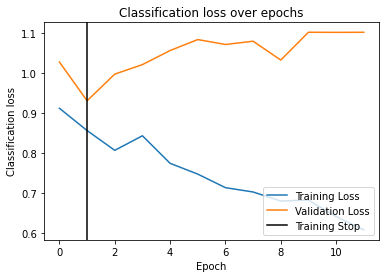

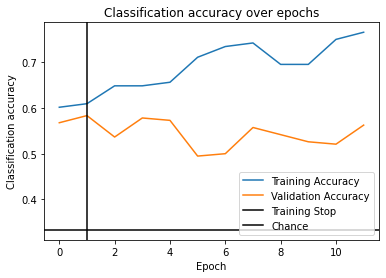

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9802 - acc: 0.5312 - val_loss: 0.9320 - val_acc: 0.5417
Epoch 2/50 0.237s 	 loss: 0.9285 - acc: 0.5312 - val_loss: 0.8986 - val_acc: 0.4844
Epoch 3/50 0.237s 	 loss: 0.9219 - acc: 0.6250 - val_loss: 0.8714 - val_acc: 0.6094
Epoch 4/50 0.236s 	 loss: 0.8433 - acc: 0.6172 - val_loss: 0.9163 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.8641 - acc: 0.6406 - val_loss: 0.9032 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.243s 	 loss: 0.8210 - acc: 0.5859 - val_loss: 0.8840 - val_acc: 0.5781
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.244s 	 loss: 0.8183 - acc: 0.6484 - val_loss: 0.8944 - val_acc: 0.5625
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.243s 	 loss: 0.7988 - acc: 0.6562 - val_loss: 0.8468 - val_acc: 0.6458
Epoch 9/50 0.238s 	 loss: 0.8097 - acc: 0.6328 - val_loss: 0.8593 - val_acc: 0.6146
EarlyStopping counter: 1 out o

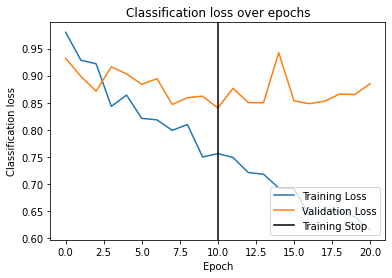

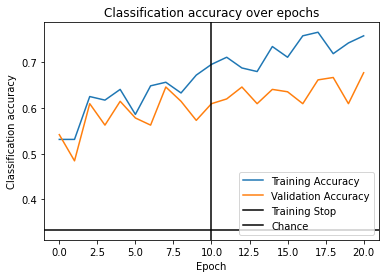

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.9824 - acc: 0.5781 - val_loss: 0.9769 - val_acc: 0.5260
Epoch 2/50 0.237s 	 loss: 0.9028 - acc: 0.6250 - val_loss: 0.9302 - val_acc: 0.5833
Epoch 3/50 0.235s 	 loss: 0.8822 - acc: 0.6094 - val_loss: 0.9396 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.8297 - acc: 0.6641 - val_loss: 0.9785 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.240s 	 loss: 0.8243 - acc: 0.6406 - val_loss: 0.9329 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.239s 	 loss: 0.8321 - acc: 0.6484 - val_loss: 0.9906 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.241s 	 loss: 0.7941 - acc: 0.6953 - val_loss: 0.9615 - val_acc: 0.5365
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.241s 	 loss: 0.7686 - acc: 0.6953 - val_loss: 0.9899 - val_acc: 0.5156
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.244s 	 loss: 0.7646 - acc: 0.67

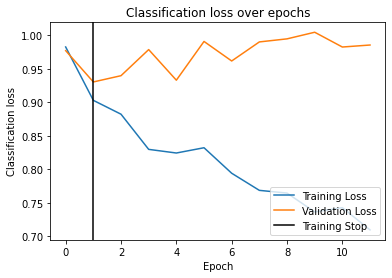

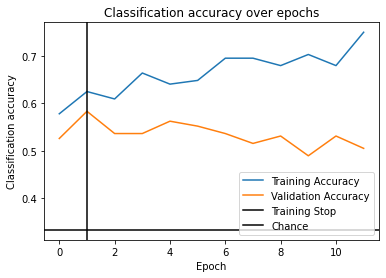

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 1.0269 - acc: 0.5312 - val_loss: 0.5928 - val_acc: 0.8385
Epoch 2/50 0.258s 	 loss: 0.8602 - acc: 0.6016 - val_loss: 0.6185 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.276s 	 loss: 0.8065 - acc: 0.6094 - val_loss: 0.6028 - val_acc: 0.7812
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.241s 	 loss: 0.7660 - acc: 0.6719 - val_loss: 0.6269 - val_acc: 0.7708
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.240s 	 loss: 0.7459 - acc: 0.6719 - val_loss: 0.5814 - val_acc: 0.7708
Epoch 6/50 0.243s 	 loss: 0.6846 - acc: 0.7422 - val_loss: 0.6324 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.6761 - acc: 0.6719 - val_loss: 0.5990 - val_acc: 0.8125
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.241s 	 loss: 0.6473 - acc: 0.7500 - val_loss: 0.6417 - val_acc: 0.7135
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.241s 	 loss: 0.6726 - acc: 0.7500 - val_loss: 0.5646 - val_acc: 0.8333
E

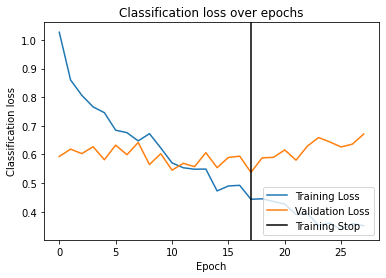

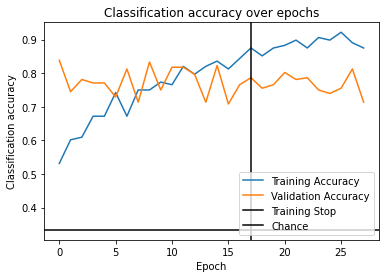

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 0.8863 - acc: 0.5938 - val_loss: 0.9675 - val_acc: 0.5469
Epoch 2/50 0.238s 	 loss: 0.7677 - acc: 0.6641 - val_loss: 0.8668 - val_acc: 0.5781
Epoch 3/50 0.238s 	 loss: 0.7490 - acc: 0.6562 - val_loss: 0.8541 - val_acc: 0.6458
Epoch 4/50 0.242s 	 loss: 0.6772 - acc: 0.6953 - val_loss: 0.8084 - val_acc: 0.6146
Epoch 5/50 0.240s 	 loss: 0.6748 - acc: 0.7266 - val_loss: 0.7544 - val_acc: 0.6510
Epoch 6/50 0.242s 	 loss: 0.6098 - acc: 0.7734 - val_loss: 0.7641 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.6674 - acc: 0.7109 - val_loss: 0.7838 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.243s 	 loss: 0.6016 - acc: 0.7734 - val_loss: 0.7819 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.236s 	 loss: 0.5838 - acc: 0.7891 - val_loss: 0.7789 - val_acc: 0.6927
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.240s 	 loss: 0.5

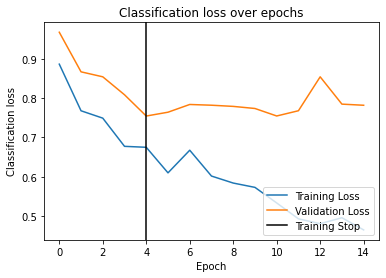

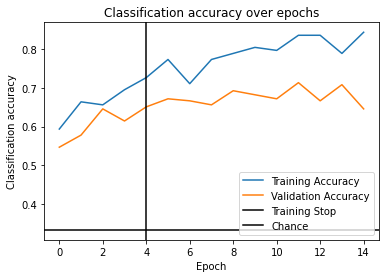

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.7810 - acc: 0.6562 - val_loss: 1.0314 - val_acc: 0.4844
Epoch 2/50 0.236s 	 loss: 0.6487 - acc: 0.7578 - val_loss: 0.9631 - val_acc: 0.5990
Epoch 3/50 0.236s 	 loss: 0.6138 - acc: 0.7500 - val_loss: 1.0174 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.5704 - acc: 0.7969 - val_loss: 0.9767 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.241s 	 loss: 0.5469 - acc: 0.8203 - val_loss: 0.9444 - val_acc: 0.6042
Epoch 6/50 0.238s 	 loss: 0.4950 - acc: 0.8359 - val_loss: 1.0420 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.246s 	 loss: 0.4559 - acc: 0.8594 - val_loss: 1.0217 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.246s 	 loss: 0.4712 - acc: 0.8516 - val_loss: 1.0145 - val_acc: 0.4896
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.241s 	 loss: 0.4285 - acc: 0.8516 - val_loss: 1.0398 - val_acc: 0.

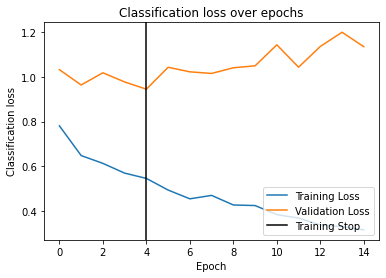

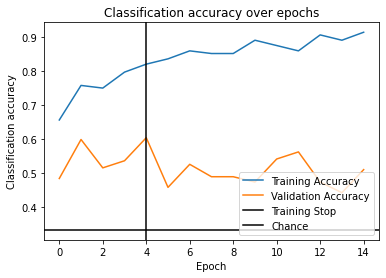

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.3634 - acc: 0.3906 - val_loss: 0.8466 - val_acc: 0.6510
Epoch 2/50 0.240s 	 loss: 1.1504 - acc: 0.5000 - val_loss: 0.8997 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 1.0070 - acc: 0.5078 - val_loss: 0.8688 - val_acc: 0.5677
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.243s 	 loss: 1.0193 - acc: 0.6094 - val_loss: 0.9379 - val_acc: 0.5781
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.243s 	 loss: 0.8815 - acc: 0.6250 - val_loss: 0.9617 - val_acc: 0.5677
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.247s 	 loss: 0.8984 - acc: 0.6250 - val_loss: 0.9383 - val_acc: 0.5469
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.243s 	 loss: 0.8421 - acc: 0.6641 - val_loss: 0.8484 - val_acc: 0.5833
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.241s 	 loss: 0.8491 - acc: 0.6250 - val_loss: 0.8835 - val_acc: 0.5938
EarlyStopping counter: 7 out of 10
Epoch 9/50 0.243s 	 loss: 0.8082 - acc: 0.6875 - v

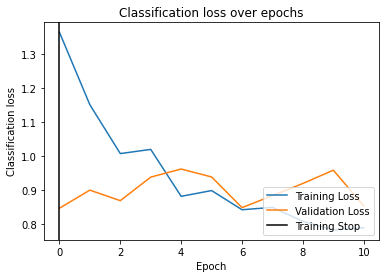

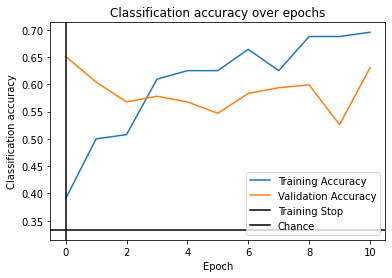

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.0314 - acc: 0.5156 - val_loss: 1.6039 - val_acc: 0.3958
Epoch 2/50 0.241s 	 loss: 0.9516 - acc: 0.5078 - val_loss: 1.4772 - val_acc: 0.3906
Epoch 3/50 0.239s 	 loss: 0.8879 - acc: 0.6016 - val_loss: 1.4345 - val_acc: 0.3490
Epoch 4/50 0.240s 	 loss: 0.7792 - acc: 0.6562 - val_loss: 1.2540 - val_acc: 0.3906
Epoch 5/50 0.244s 	 loss: 0.7919 - acc: 0.6484 - val_loss: 1.3500 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.251s 	 loss: 0.7517 - acc: 0.7109 - val_loss: 1.3126 - val_acc: 0.3802
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.239s 	 loss: 0.7104 - acc: 0.6875 - val_loss: 1.1956 - val_acc: 0.5208
Epoch 8/50 0.240s 	 loss: 0.6932 - acc: 0.7031 - val_loss: 1.1852 - val_acc: 0.4531
Epoch 9/50 0.239s 	 loss: 0.6493 - acc: 0.7578 - val_loss: 1.2679 - val_acc: 0.4167
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.246s 	 loss: 0.6495 - acc: 0.7344 - val_loss: 1.289

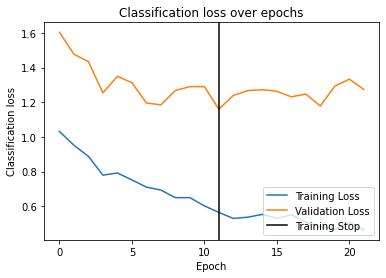

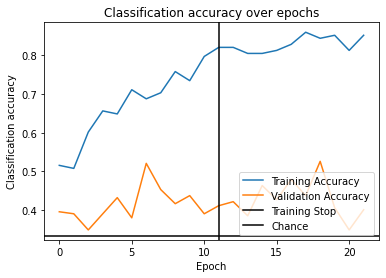

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.2180 - acc: 0.5000 - val_loss: 1.0792 - val_acc: 0.5156
Epoch 2/50 0.242s 	 loss: 1.0529 - acc: 0.5391 - val_loss: 1.0676 - val_acc: 0.4948
Epoch 3/50 0.235s 	 loss: 0.9976 - acc: 0.5859 - val_loss: 0.9099 - val_acc: 0.5417
Epoch 4/50 0.238s 	 loss: 0.9532 - acc: 0.5938 - val_loss: 0.9218 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.8878 - acc: 0.5859 - val_loss: 0.8824 - val_acc: 0.6562
Epoch 6/50 0.239s 	 loss: 0.8237 - acc: 0.6406 - val_loss: 0.8998 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.243s 	 loss: 0.8017 - acc: 0.6562 - val_loss: 0.8495 - val_acc: 0.6719
Epoch 8/50 0.241s 	 loss: 0.7631 - acc: 0.6953 - val_loss: 0.9109 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.242s 	 loss: 0.7080 - acc: 0.7578 - val_loss: 0.8222 - val_acc: 0.6146
Epoch 10/50 0.240s 	 loss: 0.6781 - acc: 0.7344 - val_loss: 0.852

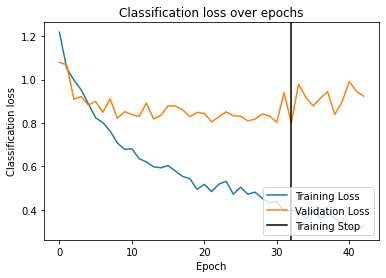

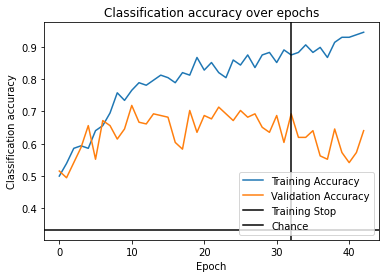

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 0.8385 - acc: 0.6172 - val_loss: 0.9303 - val_acc: 0.5938
Epoch 2/50 0.239s 	 loss: 0.7732 - acc: 0.6250 - val_loss: 0.8999 - val_acc: 0.5312
Epoch 3/50 0.240s 	 loss: 0.7173 - acc: 0.6797 - val_loss: 0.8864 - val_acc: 0.5521
Epoch 4/50 0.241s 	 loss: 0.7020 - acc: 0.6797 - val_loss: 0.8264 - val_acc: 0.6042
Epoch 5/50 0.241s 	 loss: 0.6974 - acc: 0.7266 - val_loss: 0.9108 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.6768 - acc: 0.7109 - val_loss: 0.8160 - val_acc: 0.6146
Epoch 7/50 0.239s 	 loss: 0.6603 - acc: 0.7344 - val_loss: 0.8471 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.242s 	 loss: 0.6467 - acc: 0.7031 - val_loss: 0.7660 - val_acc: 0.5990
Epoch 9/50 0.239s 	 loss: 0.6283 - acc: 0.7578 - val_loss: 0.8390 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.6600 - acc: 0.7109 - val_loss: 0.8098 - val_acc: 0.6667
EarlyStopping counter

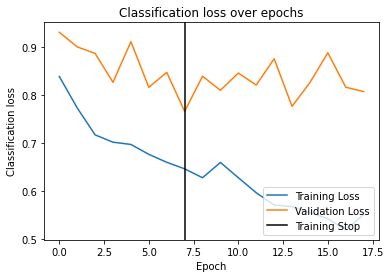

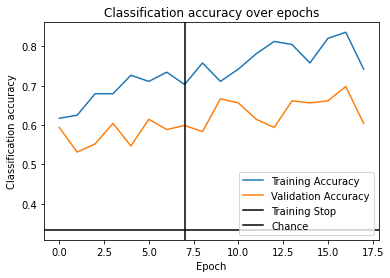

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8369 - acc: 0.6172 - val_loss: 0.8986 - val_acc: 0.5677
Epoch 2/50 0.240s 	 loss: 0.8055 - acc: 0.6016 - val_loss: 0.8866 - val_acc: 0.5729
Epoch 3/50 0.240s 	 loss: 0.7494 - acc: 0.6562 - val_loss: 0.8655 - val_acc: 0.5521
Epoch 4/50 0.241s 	 loss: 0.7687 - acc: 0.6406 - val_loss: 0.8786 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.7150 - acc: 0.6797 - val_loss: 0.8420 - val_acc: 0.6198
Epoch 6/50 0.239s 	 loss: 0.6779 - acc: 0.6797 - val_loss: 0.8565 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.7131 - acc: 0.6562 - val_loss: 0.8936 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.6497 - acc: 0.7578 - val_loss: 0.8326 - val_acc: 0.5885
Epoch 9/50 0.239s 	 loss: 0.6348 - acc: 0.7344 - val_loss: 0.8401 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.6

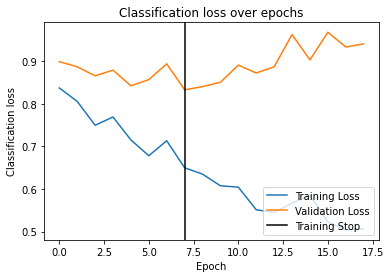

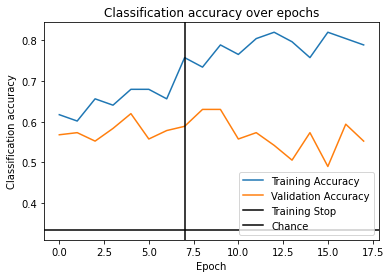

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9186 - acc: 0.5547 - val_loss: 0.7712 - val_acc: 0.7396
Epoch 2/50 0.239s 	 loss: 0.8403 - acc: 0.5391 - val_loss: 0.7487 - val_acc: 0.7500
Epoch 3/50 0.239s 	 loss: 0.8141 - acc: 0.6328 - val_loss: 0.7510 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.7524 - acc: 0.6484 - val_loss: 0.6994 - val_acc: 0.6719
Epoch 5/50 0.240s 	 loss: 0.7608 - acc: 0.6406 - val_loss: 0.7226 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.7427 - acc: 0.6406 - val_loss: 0.7380 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.241s 	 loss: 0.7412 - acc: 0.6172 - val_loss: 0.7279 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.244s 	 loss: 0.6700 - acc: 0.7266 - val_loss: 0.7318 - val_acc: 0.7188
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.242s 	 loss: 0.6633 - acc: 0.6953 - val_loss: 0.7072 - val_acc: 0.

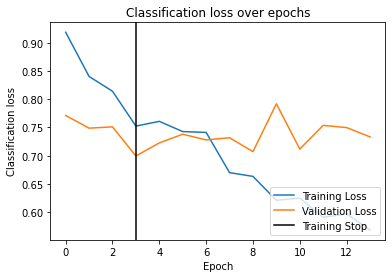

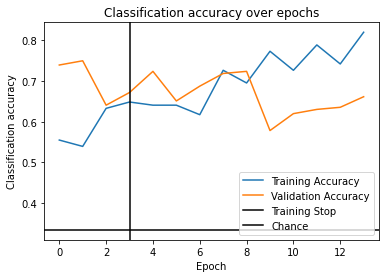

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 0.8057 - acc: 0.6641 - val_loss: 0.6647 - val_acc: 0.7448
Epoch 2/50 0.244s 	 loss: 0.7201 - acc: 0.6641 - val_loss: 0.6814 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.6701 - acc: 0.7578 - val_loss: 0.6611 - val_acc: 0.7604
Epoch 4/50 0.238s 	 loss: 0.6386 - acc: 0.7422 - val_loss: 0.6181 - val_acc: 0.7448
Epoch 5/50 0.242s 	 loss: 0.6114 - acc: 0.7969 - val_loss: 0.6125 - val_acc: 0.7760
Epoch 6/50 0.247s 	 loss: 0.5961 - acc: 0.7500 - val_loss: 0.6088 - val_acc: 0.6927
Epoch 7/50 0.240s 	 loss: 0.5980 - acc: 0.7734 - val_loss: 0.6004 - val_acc: 0.7708
Epoch 8/50 0.240s 	 loss: 0.6156 - acc: 0.7188 - val_loss: 0.5851 - val_acc: 0.7917
Epoch 9/50 0.238s 	 loss: 0.5568 - acc: 0.7656 - val_loss: 0.5710 - val_acc: 0.7708
Epoch 10/50 0.244s 	 loss: 0.5358 - acc: 0.7812 - val_loss: 0.5674 - val_acc: 0.7760
Epoch 11/50 0.244s 	 loss: 0.5171 - acc: 0.8281 - val_loss: 0.5634 - val_acc: 0.7604
Epoch 

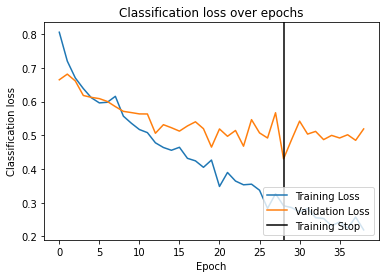

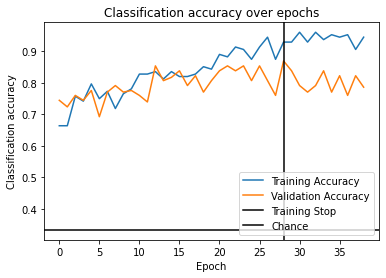

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.7186 - acc: 0.7266 - val_loss: 0.8036 - val_acc: 0.6198
Epoch 2/50 0.239s 	 loss: 0.6954 - acc: 0.6797 - val_loss: 0.8190 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.240s 	 loss: 0.6531 - acc: 0.7422 - val_loss: 0.7767 - val_acc: 0.6198
Epoch 4/50 0.241s 	 loss: 0.6363 - acc: 0.7578 - val_loss: 0.7593 - val_acc: 0.6406
Epoch 5/50 0.242s 	 loss: 0.5833 - acc: 0.7812 - val_loss: 0.7342 - val_acc: 0.6198
Epoch 6/50 0.240s 	 loss: 0.5692 - acc: 0.7734 - val_loss: 0.6834 - val_acc: 0.6875
Epoch 7/50 0.238s 	 loss: 0.5509 - acc: 0.7734 - val_loss: 0.6491 - val_acc: 0.7344
Epoch 8/50 0.239s 	 loss: 0.4998 - acc: 0.8047 - val_loss: 0.7142 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.249s 	 loss: 0.5018 - acc: 0.8359 - val_loss: 0.6541 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.249s 	 loss: 0.4960 - acc: 0.8281 - val_loss: 0.697

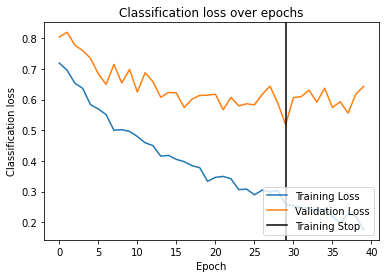

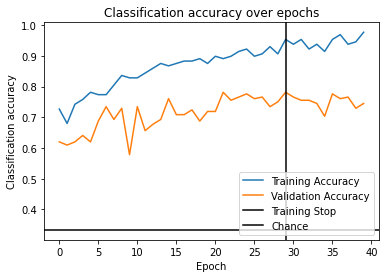

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.7386 - acc: 0.6875 - val_loss: 0.7670 - val_acc: 0.6823
Epoch 2/50 0.241s 	 loss: 0.7194 - acc: 0.6953 - val_loss: 0.7049 - val_acc: 0.6979
Epoch 3/50 0.239s 	 loss: 0.6400 - acc: 0.7344 - val_loss: 0.6924 - val_acc: 0.7604
Epoch 4/50 0.237s 	 loss: 0.5861 - acc: 0.7656 - val_loss: 0.7229 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.244s 	 loss: 0.5590 - acc: 0.7578 - val_loss: 0.6912 - val_acc: 0.6562
Epoch 6/50 0.243s 	 loss: 0.5524 - acc: 0.8203 - val_loss: 0.6926 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.245s 	 loss: 0.5045 - acc: 0.8047 - val_loss: 0.6646 - val_acc: 0.6510
Epoch 8/50 0.244s 	 loss: 0.4776 - acc: 0.8594 - val_loss: 0.6962 - val_acc: 0.6979
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.244s 	 loss: 0.4930 - acc: 0.8438 - val_loss: 0.6772 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.240s 	 loss: 0.4

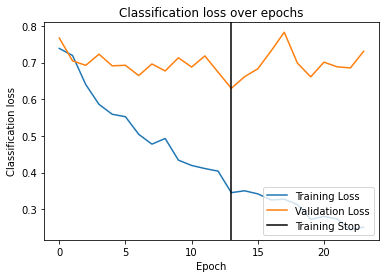

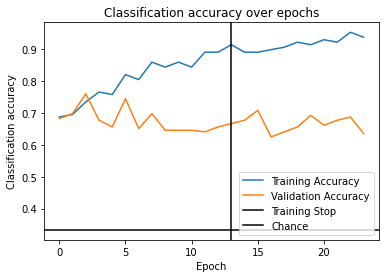

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.251s 	 loss: 0.5748 - acc: 0.7891 - val_loss: 0.4890 - val_acc: 0.8750
Epoch 2/50 0.248s 	 loss: 0.5243 - acc: 0.8125 - val_loss: 0.4103 - val_acc: 0.9062
Epoch 3/50 0.241s 	 loss: 0.4807 - acc: 0.8281 - val_loss: 0.4298 - val_acc: 0.8594
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.244s 	 loss: 0.4542 - acc: 0.8594 - val_loss: 0.3880 - val_acc: 0.9062
Epoch 5/50 0.242s 	 loss: 0.4027 - acc: 0.8594 - val_loss: 0.3676 - val_acc: 0.8750
Epoch 6/50 0.243s 	 loss: 0.3951 - acc: 0.8750 - val_loss: 0.3337 - val_acc: 0.9219
Epoch 7/50 0.242s 	 loss: 0.3674 - acc: 0.8984 - val_loss: 0.3230 - val_acc: 0.9219
Epoch 8/50 0.238s 	 loss: 0.3429 - acc: 0.8984 - val_loss: 0.3297 - val_acc: 0.9219
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.242s 	 loss: 0.3187 - acc: 0.9062 - val_loss: 0.2764 - val_acc: 0.9219
Epoch 10/50 0.233s 	 loss: 0.3145 - acc: 0.9375 - val_loss: 0.3013 - val_acc: 0.9062
EarlyStopping counter: 1 out of 10
Epoch 11/50 0.242s 	 

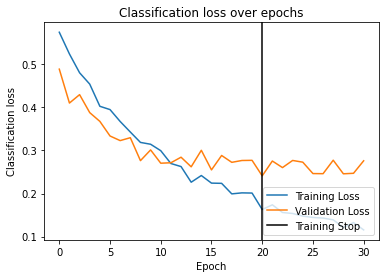

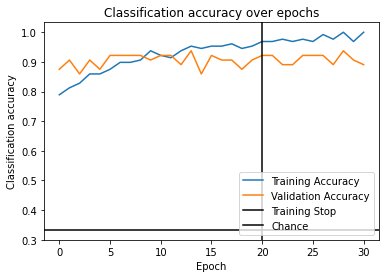

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.5438 - acc: 0.8047 - val_loss: 0.5666 - val_acc: 0.8177
Epoch 2/50 0.240s 	 loss: 0.4788 - acc: 0.8516 - val_loss: 0.5068 - val_acc: 0.8021
Epoch 3/50 0.238s 	 loss: 0.4272 - acc: 0.8906 - val_loss: 0.5181 - val_acc: 0.7760
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.245s 	 loss: 0.4123 - acc: 0.8828 - val_loss: 0.4629 - val_acc: 0.8490
Epoch 5/50 0.241s 	 loss: 0.3638 - acc: 0.9062 - val_loss: 0.4525 - val_acc: 0.8542
Epoch 6/50 0.239s 	 loss: 0.3513 - acc: 0.9141 - val_loss: 0.4320 - val_acc: 0.8385
Epoch 7/50 0.243s 	 loss: 0.3249 - acc: 0.9141 - val_loss: 0.3950 - val_acc: 0.8698
Epoch 8/50 0.242s 	 loss: 0.2990 - acc: 0.9141 - val_loss: 0.4175 - val_acc: 0.8542
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.2955 - acc: 0.9141 - val_loss: 0.4277 - val_acc: 0.8125
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.242s 	 loss: 0.2752 - acc: 0.9219 - val_loss: 0.376

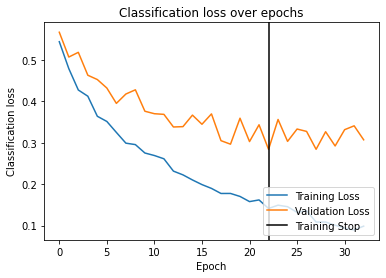

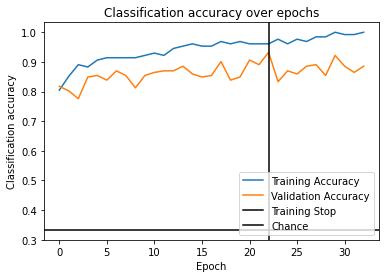

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.5533 - acc: 0.7891 - val_loss: 0.5549 - val_acc: 0.8073
Epoch 2/50 0.242s 	 loss: 0.4848 - acc: 0.8359 - val_loss: 0.5566 - val_acc: 0.8125
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.242s 	 loss: 0.4069 - acc: 0.9062 - val_loss: 0.5334 - val_acc: 0.8125
Epoch 4/50 0.240s 	 loss: 0.3974 - acc: 0.8594 - val_loss: 0.5050 - val_acc: 0.8385
Epoch 5/50 0.243s 	 loss: 0.3746 - acc: 0.8828 - val_loss: 0.4740 - val_acc: 0.8229
Epoch 6/50 0.241s 	 loss: 0.3377 - acc: 0.9141 - val_loss: 0.4442 - val_acc: 0.8229
Epoch 7/50 0.239s 	 loss: 0.3208 - acc: 0.9141 - val_loss: 0.4128 - val_acc: 0.8073
Epoch 8/50 0.244s 	 loss: 0.3110 - acc: 0.9219 - val_loss: 0.4409 - val_acc: 0.8385
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.2739 - acc: 0.9375 - val_loss: 0.4185 - val_acc: 0.8229
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.242s 	 loss: 0.2613 - acc: 0.9141 - val_loss: 0.429

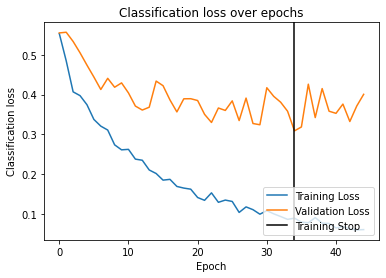

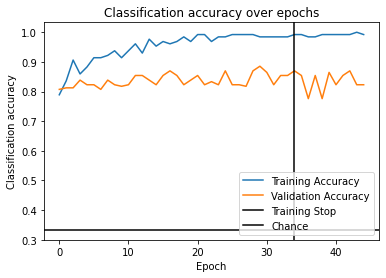

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.5667 - acc: 0.8047 - val_loss: 0.6672 - val_acc: 0.6771
Epoch 2/50 0.242s 	 loss: 0.4760 - acc: 0.8672 - val_loss: 0.6515 - val_acc: 0.6979
Epoch 3/50 0.243s 	 loss: 0.4719 - acc: 0.8672 - val_loss: 0.6314 - val_acc: 0.7292
Epoch 4/50 0.241s 	 loss: 0.4311 - acc: 0.9062 - val_loss: 0.5706 - val_acc: 0.7708
Epoch 5/50 0.242s 	 loss: 0.3939 - acc: 0.9062 - val_loss: 0.6749 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.242s 	 loss: 0.3798 - acc: 0.9141 - val_loss: 0.6355 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.241s 	 loss: 0.3366 - acc: 0.8984 - val_loss: 0.6552 - val_acc: 0.6927
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.241s 	 loss: 0.3447 - acc: 0.9219 - val_loss: 0.6312 - val_acc: 0.7083
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.244s 	 loss: 0.3109 - acc: 0.9375 - val_loss: 0.6083 - val_acc: 0.7969
EarlyStopping counter: 5 out of 10
Epoch 10/50 0.243s 	 loss: 0.3156 - 

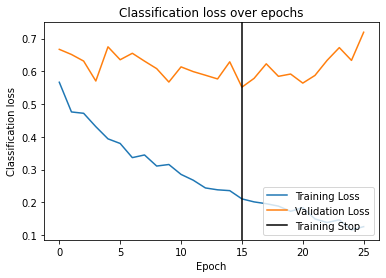

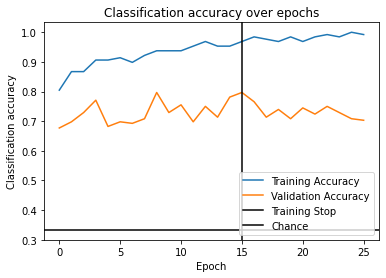

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.6017 - acc: 0.7812 - val_loss: 0.5312 - val_acc: 0.8177
Epoch 2/50 0.246s 	 loss: 0.5532 - acc: 0.7969 - val_loss: 0.5056 - val_acc: 0.8385
Epoch 3/50 0.241s 	 loss: 0.5065 - acc: 0.8125 - val_loss: 0.4778 - val_acc: 0.8750
Epoch 4/50 0.239s 	 loss: 0.5006 - acc: 0.8125 - val_loss: 0.4989 - val_acc: 0.8229
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.241s 	 loss: 0.4480 - acc: 0.8281 - val_loss: 0.4668 - val_acc: 0.8906
Epoch 6/50 0.245s 	 loss: 0.4351 - acc: 0.8516 - val_loss: 0.4668 - val_acc: 0.8229
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.4015 - acc: 0.8906 - val_loss: 0.4332 - val_acc: 0.8750
Epoch 8/50 0.241s 	 loss: 0.3962 - acc: 0.8672 - val_loss: 0.4218 - val_acc: 0.8906
Epoch 9/50 0.237s 	 loss: 0.3641 - acc: 0.9141 - val_loss: 0.4423 - val_acc: 0.8385
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.3796 - acc: 0.8906 - val_loss: 0.414

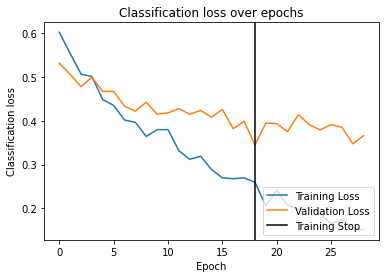

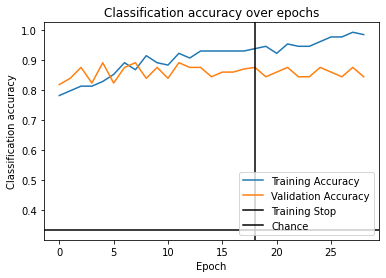

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.5756 - acc: 0.8047 - val_loss: 0.5831 - val_acc: 0.7135
Epoch 2/50 0.246s 	 loss: 0.5679 - acc: 0.7969 - val_loss: 0.5217 - val_acc: 0.8333
Epoch 3/50 0.240s 	 loss: 0.5180 - acc: 0.8047 - val_loss: 0.5476 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.4984 - acc: 0.8047 - val_loss: 0.4723 - val_acc: 0.8802
Epoch 5/50 0.241s 	 loss: 0.4740 - acc: 0.8359 - val_loss: 0.5070 - val_acc: 0.8438
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.4425 - acc: 0.8750 - val_loss: 0.4620 - val_acc: 0.8281
Epoch 7/50 0.241s 	 loss: 0.4367 - acc: 0.8828 - val_loss: 0.4809 - val_acc: 0.8281
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.4245 - acc: 0.8828 - val_loss: 0.5067 - val_acc: 0.7969
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.242s 	 loss: 0.3888 - acc: 0.8516 - val_loss: 0.4998 - val_acc: 0.8229
EarlyStopping counter: 3 out o

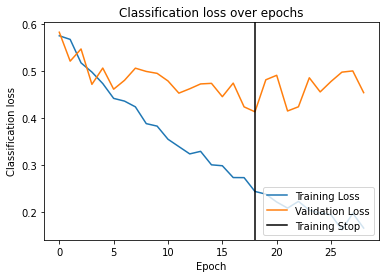

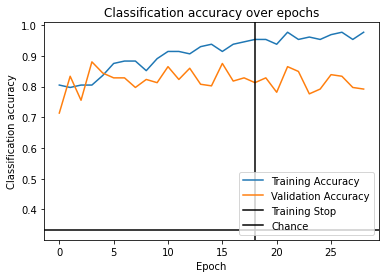

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.257s 	 loss: 1.0939 - acc: 0.5078 - val_loss: 1.0431 - val_acc: 0.5052
Epoch 2/50 0.246s 	 loss: 1.0354 - acc: 0.5312 - val_loss: 1.0136 - val_acc: 0.6094
Epoch 3/50 0.238s 	 loss: 1.0165 - acc: 0.5312 - val_loss: 1.0357 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.244s 	 loss: 0.9922 - acc: 0.5547 - val_loss: 0.9967 - val_acc: 0.5885
Epoch 5/50 0.243s 	 loss: 0.9927 - acc: 0.5469 - val_loss: 0.9863 - val_acc: 0.5833
Epoch 6/50 0.241s 	 loss: 0.9440 - acc: 0.5312 - val_loss: 0.9985 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.9547 - acc: 0.5625 - val_loss: 1.0402 - val_acc: 0.5052
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.243s 	 loss: 0.9410 - acc: 0.5703 - val_loss: 1.0243 - val_acc: 0.5417
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.246s 	 loss: 0.9356 - acc: 0.5625 - val_loss: 0.9570 - val_acc: 0.6146
Epoch 10/50 0.245s 	 loss: 0.8992 - acc: 0.5859 - val_loss: 0.9713 - va

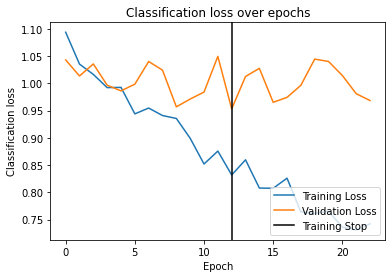

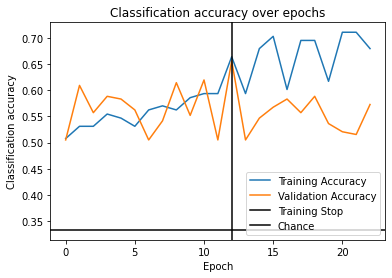

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.0610 - acc: 0.5781 - val_loss: 1.1674 - val_acc: 0.4792
Epoch 2/50 0.240s 	 loss: 1.0501 - acc: 0.5469 - val_loss: 1.0908 - val_acc: 0.4792
Epoch 3/50 0.241s 	 loss: 1.0036 - acc: 0.5547 - val_loss: 1.0649 - val_acc: 0.4583
Epoch 4/50 0.242s 	 loss: 0.9366 - acc: 0.5859 - val_loss: 1.0249 - val_acc: 0.5208
Epoch 5/50 0.240s 	 loss: 0.9481 - acc: 0.5703 - val_loss: 1.0659 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.249s 	 loss: 0.9116 - acc: 0.6094 - val_loss: 1.0500 - val_acc: 0.4896
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.247s 	 loss: 0.8818 - acc: 0.5938 - val_loss: 1.1168 - val_acc: 0.3958
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.246s 	 loss: 0.8974 - acc: 0.6094 - val_loss: 1.0460 - val_acc: 0.5104
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.244s 	 loss: 0.8475 - acc: 0.6250 - val_loss: 1.0643 - val_acc: 0.4948
EarlyStopping counter: 5 out o

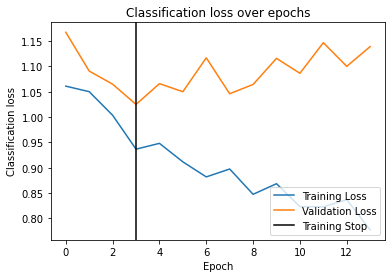

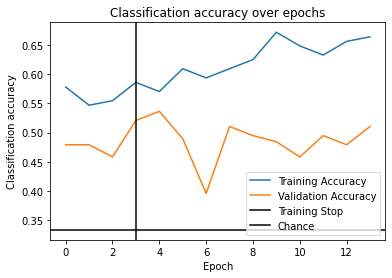

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 1.0800 - acc: 0.5078 - val_loss: 1.0511 - val_acc: 0.5365
Epoch 2/50 0.240s 	 loss: 1.0447 - acc: 0.5234 - val_loss: 1.1118 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.242s 	 loss: 0.9621 - acc: 0.5234 - val_loss: 1.0533 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.242s 	 loss: 0.9476 - acc: 0.5391 - val_loss: 1.0923 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.239s 	 loss: 0.9406 - acc: 0.5938 - val_loss: 1.0282 - val_acc: 0.4896
Epoch 6/50 0.240s 	 loss: 0.9453 - acc: 0.5234 - val_loss: 1.1214 - val_acc: 0.4531
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.8849 - acc: 0.5859 - val_loss: 1.1244 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.248s 	 loss: 0.8729 - acc: 0.6094 - val_loss: 1.1215 - val_acc: 0.4479
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.246s 	 loss: 0.8434 - acc: 0.63

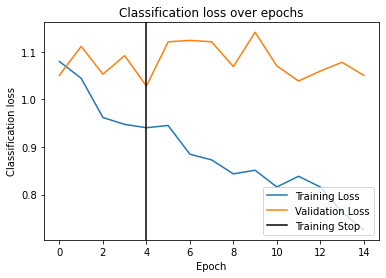

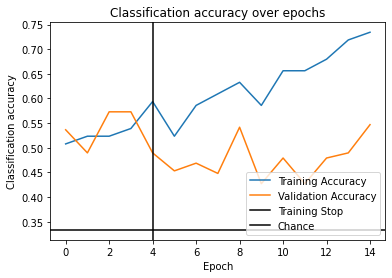

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8153 - acc: 0.6562 - val_loss: 0.9872 - val_acc: 0.5104
Epoch 2/50 0.241s 	 loss: 0.7299 - acc: 0.6953 - val_loss: 0.9864 - val_acc: 0.4583
Epoch 3/50 0.243s 	 loss: 0.6804 - acc: 0.7344 - val_loss: 0.9273 - val_acc: 0.5885
Epoch 4/50 0.242s 	 loss: 0.6940 - acc: 0.6953 - val_loss: 0.9328 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.247s 	 loss: 0.6147 - acc: 0.7422 - val_loss: 0.8587 - val_acc: 0.6510
Epoch 6/50 0.239s 	 loss: 0.6125 - acc: 0.7812 - val_loss: 0.8504 - val_acc: 0.5521
Epoch 7/50 0.241s 	 loss: 0.5248 - acc: 0.8047 - val_loss: 0.8078 - val_acc: 0.5677
Epoch 8/50 0.242s 	 loss: 0.5240 - acc: 0.7656 - val_loss: 0.8174 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.246s 	 loss: 0.4707 - acc: 0.8125 - val_loss: 0.8005 - val_acc: 0.6198
Epoch 10/50 0.240s 	 loss: 0.4358 - acc: 0.8750 - val_loss: 0.7797 - val_acc: 0.6198
Epoch 11/50 0.246s 	 loss: 0.4364 - acc: 0.8594 - val_lo

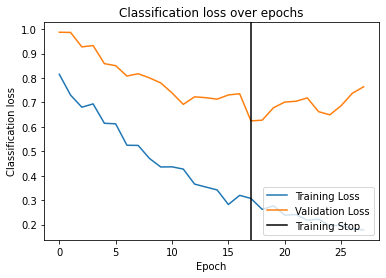

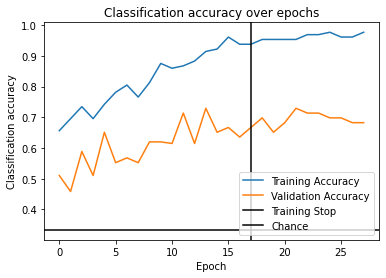

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8972 - acc: 0.5547 - val_loss: 0.7653 - val_acc: 0.6979
Epoch 2/50 0.241s 	 loss: 0.8501 - acc: 0.5469 - val_loss: 0.8004 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.7460 - acc: 0.6641 - val_loss: 0.7313 - val_acc: 0.6875
Epoch 4/50 0.247s 	 loss: 0.7498 - acc: 0.6562 - val_loss: 0.7157 - val_acc: 0.7292
Epoch 5/50 0.240s 	 loss: 0.6514 - acc: 0.7578 - val_loss: 0.7227 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.252s 	 loss: 0.6330 - acc: 0.7578 - val_loss: 0.7436 - val_acc: 0.6823
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.246s 	 loss: 0.5501 - acc: 0.7734 - val_loss: 0.6625 - val_acc: 0.7083
Epoch 8/50 0.244s 	 loss: 0.5412 - acc: 0.8203 - val_loss: 0.6121 - val_acc: 0.7708
Epoch 9/50 0.242s 	 loss: 0.5014 - acc: 0.8438 - val_loss: 0.6588 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.4

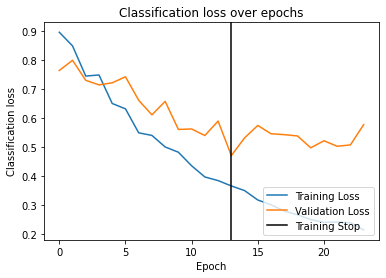

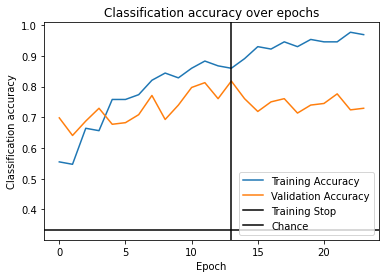

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.9017 - acc: 0.5625 - val_loss: 0.8135 - val_acc: 0.6823
Epoch 2/50 0.244s 	 loss: 0.7944 - acc: 0.6797 - val_loss: 0.8101 - val_acc: 0.6510
Epoch 3/50 0.244s 	 loss: 0.7667 - acc: 0.6562 - val_loss: 0.8041 - val_acc: 0.5833
Epoch 4/50 0.239s 	 loss: 0.7123 - acc: 0.6641 - val_loss: 0.8030 - val_acc: 0.6302
Epoch 5/50 0.242s 	 loss: 0.6387 - acc: 0.7188 - val_loss: 0.7738 - val_acc: 0.6562
Epoch 6/50 0.239s 	 loss: 0.5844 - acc: 0.7500 - val_loss: 0.7377 - val_acc: 0.6354
Epoch 7/50 0.240s 	 loss: 0.5368 - acc: 0.7812 - val_loss: 0.7608 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.245s 	 loss: 0.5435 - acc: 0.7734 - val_loss: 0.6628 - val_acc: 0.7708
Epoch 9/50 0.241s 	 loss: 0.4901 - acc: 0.8047 - val_loss: 0.6697 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.241s 	 loss: 0.4710 - acc: 0.8281 - val_loss: 0.7757 - val_acc: 0.5729
EarlyStopping c

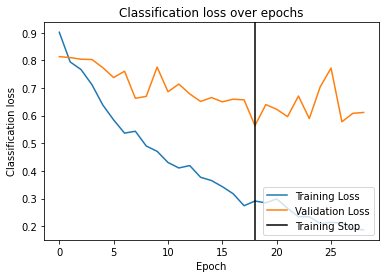

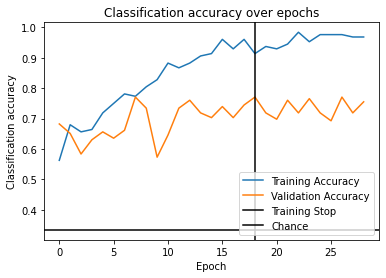

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.252s 	 loss: 0.8939 - acc: 0.6172 - val_loss: 0.7926 - val_acc: 0.6406
Epoch 2/50 0.247s 	 loss: 0.7977 - acc: 0.6484 - val_loss: 0.7863 - val_acc: 0.6823
Epoch 3/50 0.251s 	 loss: 0.8376 - acc: 0.6719 - val_loss: 0.7763 - val_acc: 0.7240
Epoch 4/50 0.243s 	 loss: 0.7938 - acc: 0.6719 - val_loss: 0.7380 - val_acc: 0.6875
Epoch 5/50 0.245s 	 loss: 0.7640 - acc: 0.6719 - val_loss: 0.8354 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.7734 - acc: 0.7031 - val_loss: 0.7579 - val_acc: 0.7500
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.243s 	 loss: 0.7827 - acc: 0.6719 - val_loss: 0.7339 - val_acc: 0.7188
Epoch 8/50 0.242s 	 loss: 0.7239 - acc: 0.7031 - val_loss: 0.7710 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.7258 - acc: 0.6719 - val_loss: 0.7519 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.243s 	 loss: 0.6428 - acc: 0.7656 - val_loss: 0.7204 - va

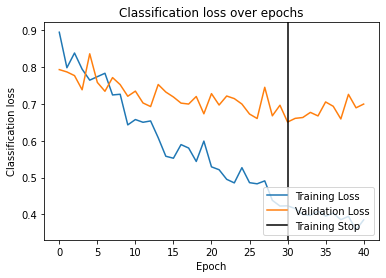

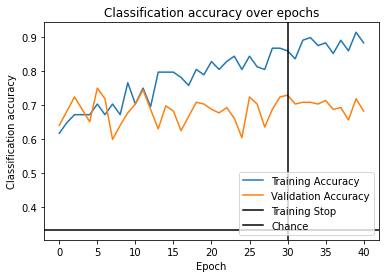

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.9012 - acc: 0.5547 - val_loss: 0.8252 - val_acc: 0.6562
Epoch 2/50 0.242s 	 loss: 0.8517 - acc: 0.6172 - val_loss: 0.7789 - val_acc: 0.6354
Epoch 3/50 0.240s 	 loss: 0.8236 - acc: 0.6250 - val_loss: 0.8002 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.243s 	 loss: 0.7837 - acc: 0.6562 - val_loss: 0.7921 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.241s 	 loss: 0.7884 - acc: 0.6953 - val_loss: 0.7952 - val_acc: 0.6510
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.245s 	 loss: 0.7708 - acc: 0.6719 - val_loss: 0.7854 - val_acc: 0.6562
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.242s 	 loss: 0.7426 - acc: 0.7109 - val_loss: 0.7499 - val_acc: 0.6562
Epoch 8/50 0.242s 	 loss: 0.7292 - acc: 0.6953 - val_loss: 0.7693 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.6976 - acc: 0.7109 - val_loss: 0.7194 - val_acc: 0.

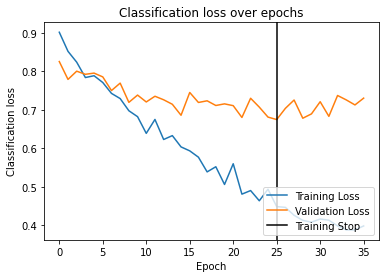

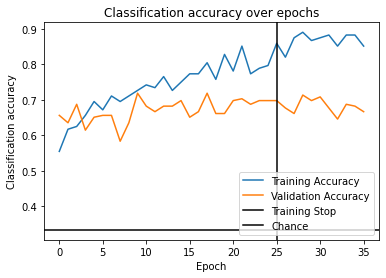

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.8190 - acc: 0.6250 - val_loss: 0.9399 - val_acc: 0.5990
Epoch 2/50 0.242s 	 loss: 0.7720 - acc: 0.6719 - val_loss: 0.9287 - val_acc: 0.5833
Epoch 3/50 0.248s 	 loss: 0.7533 - acc: 0.6953 - val_loss: 0.8784 - val_acc: 0.6250
Epoch 4/50 0.248s 	 loss: 0.7246 - acc: 0.6953 - val_loss: 0.9207 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.243s 	 loss: 0.6860 - acc: 0.7109 - val_loss: 0.8780 - val_acc: 0.6146
Epoch 6/50 0.244s 	 loss: 0.7041 - acc: 0.7344 - val_loss: 0.9441 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.6702 - acc: 0.7344 - val_loss: 0.9375 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.245s 	 loss: 0.6366 - acc: 0.6953 - val_loss: 0.9190 - val_acc: 0.6406
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.241s 	 loss: 0.6409 - acc: 0.8203 - val_loss: 0.9002 - val_acc: 0.6562
EarlyStopping counter: 4 out o

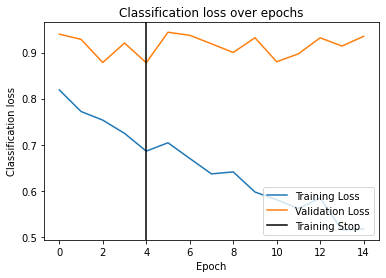

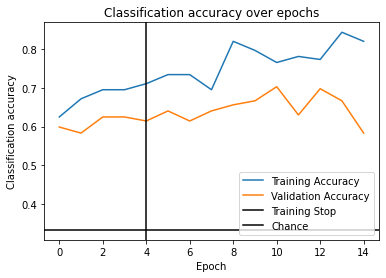

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8049 - acc: 0.6484 - val_loss: 0.9970 - val_acc: 0.5260
Epoch 2/50 0.240s 	 loss: 0.8184 - acc: 0.6016 - val_loss: 0.9261 - val_acc: 0.5469
Epoch 3/50 0.242s 	 loss: 0.7346 - acc: 0.6406 - val_loss: 0.9581 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.243s 	 loss: 0.7069 - acc: 0.6562 - val_loss: 0.9346 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.242s 	 loss: 0.6855 - acc: 0.6797 - val_loss: 0.8986 - val_acc: 0.5573
Epoch 6/50 0.243s 	 loss: 0.6782 - acc: 0.7031 - val_loss: 0.9179 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.6001 - acc: 0.7500 - val_loss: 0.9325 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.5796 - acc: 0.7734 - val_loss: 0.8904 - val_acc: 0.5521
Epoch 9/50 0.241s 	 loss: 0.5630 - acc: 0.7734 - val_loss: 0.9218 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.247s 	 loss: 0.5601 - 

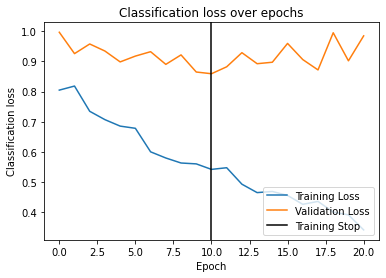

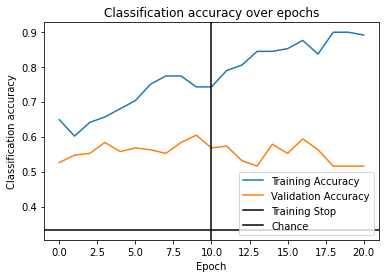

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.9207 - acc: 0.5859 - val_loss: 0.7858 - val_acc: 0.6354
Epoch 2/50 0.241s 	 loss: 0.8258 - acc: 0.6562 - val_loss: 0.8180 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.8144 - acc: 0.5859 - val_loss: 0.7983 - val_acc: 0.5417
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.239s 	 loss: 0.7539 - acc: 0.6172 - val_loss: 0.7874 - val_acc: 0.6198
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.245s 	 loss: 0.7107 - acc: 0.7031 - val_loss: 0.7469 - val_acc: 0.5990
Epoch 6/50 0.246s 	 loss: 0.6793 - acc: 0.6719 - val_loss: 0.7478 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.249s 	 loss: 0.6754 - acc: 0.7109 - val_loss: 0.7611 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.244s 	 loss: 0.6400 - acc: 0.6953 - val_loss: 0.6962 - val_acc: 0.6979
Epoch 9/50 0.243s 	 loss: 0.6368 - acc: 0.6875 - val_loss: 0.6986 - val_acc: 0.

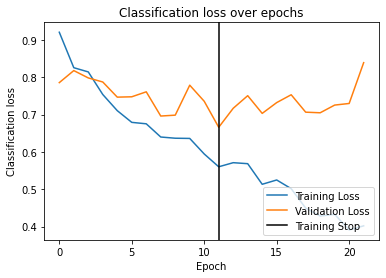

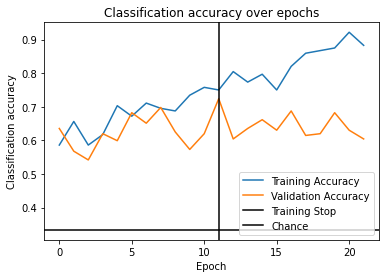

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.9116 - acc: 0.5391 - val_loss: 0.8143 - val_acc: 0.6250
Epoch 2/50 0.243s 	 loss: 0.7942 - acc: 0.6484 - val_loss: 0.8202 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.7834 - acc: 0.6484 - val_loss: 0.7726 - val_acc: 0.6406
Epoch 4/50 0.243s 	 loss: 0.7331 - acc: 0.6641 - val_loss: 0.7428 - val_acc: 0.6458
Epoch 5/50 0.238s 	 loss: 0.7159 - acc: 0.7031 - val_loss: 0.8123 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.240s 	 loss: 0.6802 - acc: 0.7031 - val_loss: 0.7857 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.243s 	 loss: 0.6614 - acc: 0.6953 - val_loss: 0.7491 - val_acc: 0.6927
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.239s 	 loss: 0.6317 - acc: 0.7109 - val_loss: 0.8103 - val_acc: 0.7031
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.249s 	 loss: 0.6066 - acc: 0.7500 - val_loss: 0.7698 - val_acc: 0.

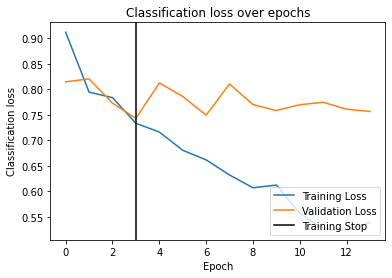

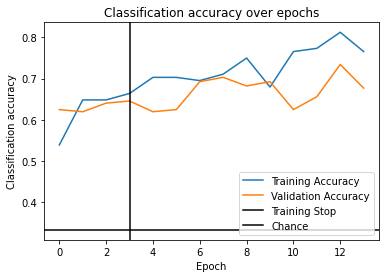

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.249s 	 loss: 0.9490 - acc: 0.5234 - val_loss: 0.7081 - val_acc: 0.6823
Epoch 2/50 0.241s 	 loss: 0.8892 - acc: 0.6016 - val_loss: 0.6574 - val_acc: 0.6979
Epoch 3/50 0.240s 	 loss: 0.8458 - acc: 0.6562 - val_loss: 0.6854 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.8053 - acc: 0.6328 - val_loss: 0.6921 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.243s 	 loss: 0.7342 - acc: 0.6797 - val_loss: 0.6807 - val_acc: 0.7031
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.248s 	 loss: 0.7388 - acc: 0.6797 - val_loss: 0.6566 - val_acc: 0.7500
Epoch 7/50 0.238s 	 loss: 0.7237 - acc: 0.6953 - val_loss: 0.6904 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.247s 	 loss: 0.6965 - acc: 0.7188 - val_loss: 0.6824 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.252s 	 loss: 0.6956 - acc: 0.7031 - val_loss: 0.6901 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
E

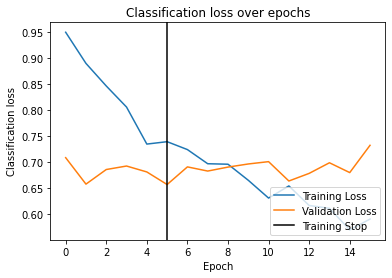

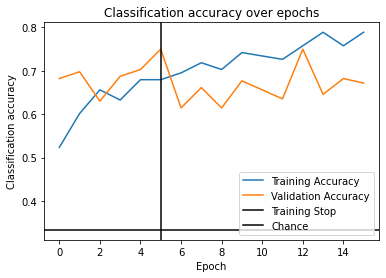

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.7880 - acc: 0.6719 - val_loss: 1.0088 - val_acc: 0.5156
Epoch 2/50 0.244s 	 loss: 0.7056 - acc: 0.7266 - val_loss: 0.9989 - val_acc: 0.4583
Epoch 3/50 0.242s 	 loss: 0.6693 - acc: 0.7188 - val_loss: 0.9876 - val_acc: 0.4948
Epoch 4/50 0.242s 	 loss: 0.6516 - acc: 0.7188 - val_loss: 1.0992 - val_acc: 0.4271
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.6359 - acc: 0.7109 - val_loss: 1.1070 - val_acc: 0.4375
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.240s 	 loss: 0.5733 - acc: 0.7734 - val_loss: 1.0673 - val_acc: 0.5365
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.243s 	 loss: 0.5709 - acc: 0.7969 - val_loss: 1.0330 - val_acc: 0.5260
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.244s 	 loss: 0.5390 - acc: 0.7656 - val_loss: 1.0274 - val_acc: 0.5260
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.247s 	 loss: 0.4659 - acc: 0.8438 - val_loss: 1.1003 - val_acc: 0.

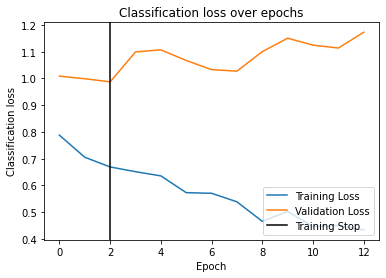

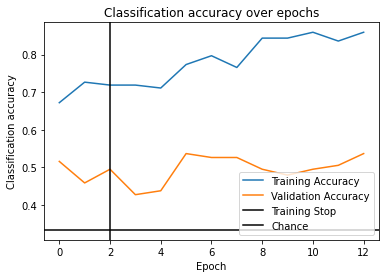

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.8375 - acc: 0.6094 - val_loss: 0.8856 - val_acc: 0.6250
Epoch 2/50 0.244s 	 loss: 0.7961 - acc: 0.6719 - val_loss: 0.8540 - val_acc: 0.6562
Epoch 3/50 0.239s 	 loss: 0.7133 - acc: 0.6562 - val_loss: 0.8499 - val_acc: 0.6927
Epoch 4/50 0.242s 	 loss: 0.7094 - acc: 0.6953 - val_loss: 0.8714 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.245s 	 loss: 0.6660 - acc: 0.7578 - val_loss: 0.9316 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.6652 - acc: 0.7266 - val_loss: 0.9150 - val_acc: 0.6198
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.244s 	 loss: 0.6358 - acc: 0.7188 - val_loss: 0.8877 - val_acc: 0.6250
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.242s 	 loss: 0.6132 - acc: 0.7500 - val_loss: 0.8821 - val_acc: 0.6719
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.242s 	 loss: 0.6160 - acc: 0.7266 - val_loss: 0.8793 - val_acc: 0.

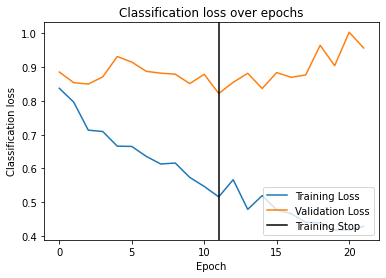

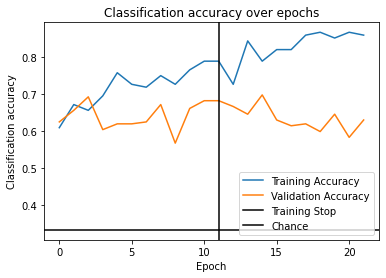

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.7649 - acc: 0.6719 - val_loss: 0.8925 - val_acc: 0.6667
Epoch 2/50 0.244s 	 loss: 0.6576 - acc: 0.7266 - val_loss: 0.8326 - val_acc: 0.6458
Epoch 3/50 0.240s 	 loss: 0.5931 - acc: 0.7656 - val_loss: 0.8173 - val_acc: 0.6719
Epoch 4/50 0.241s 	 loss: 0.5942 - acc: 0.7422 - val_loss: 0.7533 - val_acc: 0.7031
Epoch 5/50 0.244s 	 loss: 0.5258 - acc: 0.8359 - val_loss: 0.7200 - val_acc: 0.6510
Epoch 6/50 0.245s 	 loss: 0.5012 - acc: 0.7969 - val_loss: 0.7393 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.249s 	 loss: 0.4647 - acc: 0.8047 - val_loss: 0.7309 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.242s 	 loss: 0.4518 - acc: 0.8125 - val_loss: 0.7361 - val_acc: 0.7135
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.243s 	 loss: 0.4183 - acc: 0.8359 - val_loss: 0.7268 - val_acc: 0.6667
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.243s 	 loss: 0.4045 - acc: 0.8359 - val_loss: 0.6737 - va

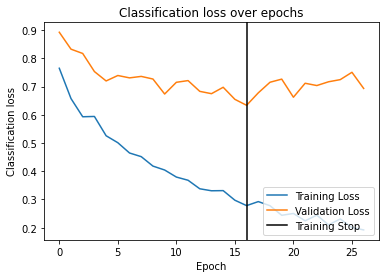

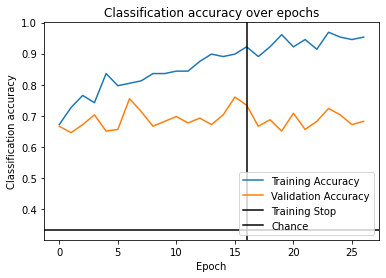

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.8546 - acc: 0.6016 - val_loss: 0.6617 - val_acc: 0.7292
Epoch 2/50 0.249s 	 loss: 0.7956 - acc: 0.6719 - val_loss: 0.5941 - val_acc: 0.7188
Epoch 3/50 0.243s 	 loss: 0.7136 - acc: 0.7031 - val_loss: 0.5757 - val_acc: 0.7552
Epoch 4/50 0.242s 	 loss: 0.6631 - acc: 0.7422 - val_loss: 0.5376 - val_acc: 0.7917
Epoch 5/50 0.243s 	 loss: 0.6543 - acc: 0.7266 - val_loss: 0.5356 - val_acc: 0.7396
Epoch 6/50 0.245s 	 loss: 0.5970 - acc: 0.7344 - val_loss: 0.5212 - val_acc: 0.7865
Epoch 7/50 0.241s 	 loss: 0.5386 - acc: 0.7812 - val_loss: 0.5277 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.244s 	 loss: 0.5244 - acc: 0.7969 - val_loss: 0.4680 - val_acc: 0.8073
Epoch 9/50 0.242s 	 loss: 0.5200 - acc: 0.7656 - val_loss: 0.4754 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.239s 	 loss: 0.4924 - acc: 0.8047 - val_loss: 0.5246 - val_acc: 0.7292
EarlyStopping c

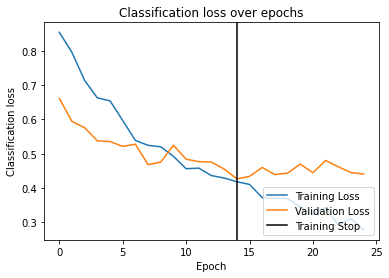

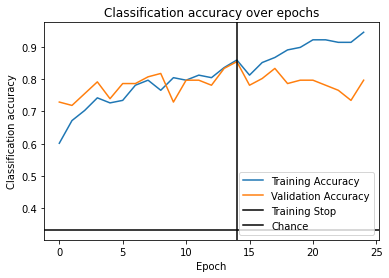

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8051 - acc: 0.6406 - val_loss: 0.7244 - val_acc: 0.6771
Epoch 2/50 0.242s 	 loss: 0.6684 - acc: 0.7344 - val_loss: 0.7470 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.242s 	 loss: 0.6149 - acc: 0.7812 - val_loss: 0.6939 - val_acc: 0.7344
Epoch 4/50 0.239s 	 loss: 0.5889 - acc: 0.7969 - val_loss: 0.6947 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.245s 	 loss: 0.5343 - acc: 0.7812 - val_loss: 0.6870 - val_acc: 0.7656
Epoch 6/50 0.241s 	 loss: 0.4842 - acc: 0.8672 - val_loss: 0.6961 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.4627 - acc: 0.8672 - val_loss: 0.6464 - val_acc: 0.7135
Epoch 8/50 0.241s 	 loss: 0.4602 - acc: 0.8047 - val_loss: 0.6415 - val_acc: 0.7292
Epoch 9/50 0.244s 	 loss: 0.4336 - acc: 0.8594 - val_loss: 0.6651 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.242s 	 loss: 0.4

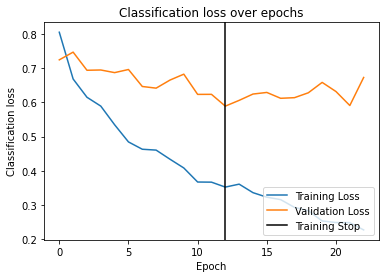

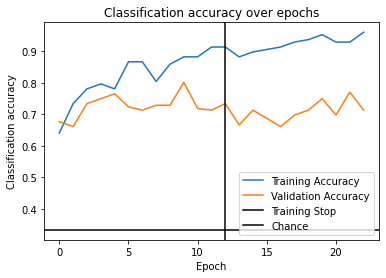

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 0.9359 - acc: 0.5703 - val_loss: 0.9035 - val_acc: 0.5573
Epoch 2/50 0.244s 	 loss: 0.8526 - acc: 0.6406 - val_loss: 0.8705 - val_acc: 0.6146
Epoch 3/50 0.250s 	 loss: 0.8272 - acc: 0.6250 - val_loss: 0.8420 - val_acc: 0.6458
Epoch 4/50 0.246s 	 loss: 0.7493 - acc: 0.6719 - val_loss: 0.8370 - val_acc: 0.5417
Epoch 5/50 0.244s 	 loss: 0.7154 - acc: 0.7188 - val_loss: 0.7983 - val_acc: 0.6354
Epoch 6/50 0.241s 	 loss: 0.7040 - acc: 0.6797 - val_loss: 0.8135 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.245s 	 loss: 0.6724 - acc: 0.7422 - val_loss: 0.7393 - val_acc: 0.6615
Epoch 8/50 0.241s 	 loss: 0.6132 - acc: 0.7500 - val_loss: 0.7294 - val_acc: 0.6719
Epoch 9/50 0.242s 	 loss: 0.6108 - acc: 0.7812 - val_loss: 0.7625 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.245s 	 loss: 0.5848 - acc: 0.7812 - val_loss: 0.7278 - val_acc: 0.7083
Epoch 11/50 0.243s 	 loss: 0.5785 - acc: 0.7812 - val_lo

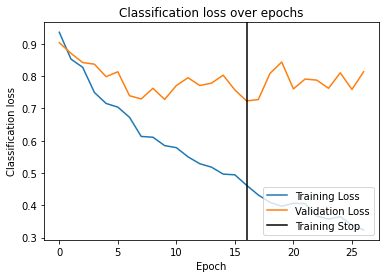

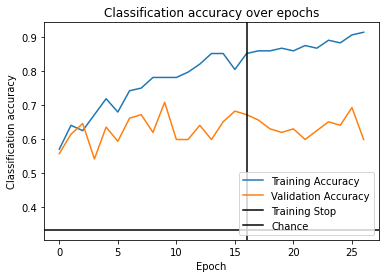

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.9015 - acc: 0.6016 - val_loss: 0.9096 - val_acc: 0.5625
Epoch 2/50 0.240s 	 loss: 0.8469 - acc: 0.6016 - val_loss: 0.9260 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.242s 	 loss: 0.8080 - acc: 0.6094 - val_loss: 0.8433 - val_acc: 0.6094
Epoch 4/50 0.240s 	 loss: 0.7502 - acc: 0.6719 - val_loss: 0.8807 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.7278 - acc: 0.6953 - val_loss: 0.8033 - val_acc: 0.5573
Epoch 6/50 0.247s 	 loss: 0.6919 - acc: 0.7344 - val_loss: 0.8542 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.247s 	 loss: 0.7023 - acc: 0.6875 - val_loss: 0.8024 - val_acc: 0.5833
Epoch 8/50 0.245s 	 loss: 0.6893 - acc: 0.6797 - val_loss: 0.8183 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.245s 	 loss: 0.6152 - acc: 0.7500 - val_loss: 0.7967 - val_acc: 0.6302
Epoch 10/50 0.238s 	 loss: 0.6

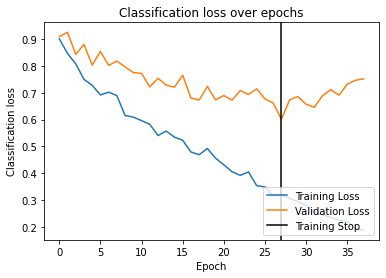

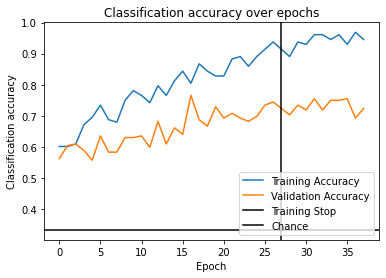

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8649 - acc: 0.6641 - val_loss: 0.8867 - val_acc: 0.6615
Epoch 2/50 0.240s 	 loss: 0.7746 - acc: 0.6875 - val_loss: 0.8406 - val_acc: 0.6198
Epoch 3/50 0.238s 	 loss: 0.7342 - acc: 0.7344 - val_loss: 0.8399 - val_acc: 0.5729
Epoch 4/50 0.242s 	 loss: 0.7103 - acc: 0.7422 - val_loss: 0.8225 - val_acc: 0.6615
Epoch 5/50 0.243s 	 loss: 0.6968 - acc: 0.7578 - val_loss: 0.7650 - val_acc: 0.6667
Epoch 6/50 0.244s 	 loss: 0.6439 - acc: 0.7734 - val_loss: 0.7600 - val_acc: 0.6823
Epoch 7/50 0.243s 	 loss: 0.6310 - acc: 0.7422 - val_loss: 0.7593 - val_acc: 0.6510
Epoch 8/50 0.245s 	 loss: 0.6052 - acc: 0.8047 - val_loss: 0.7366 - val_acc: 0.6667
Epoch 9/50 0.244s 	 loss: 0.5849 - acc: 0.7812 - val_loss: 0.7435 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.244s 	 loss: 0.5662 - acc: 0.7734 - val_loss: 0.6903 - val_acc: 0.6615
Epoch 11/50 0.242s 	 loss: 0.5562 - acc: 0.8281 - 

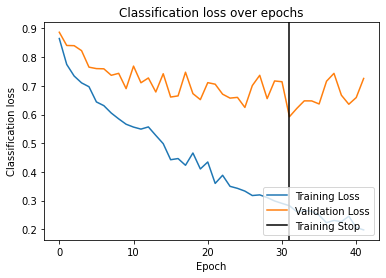

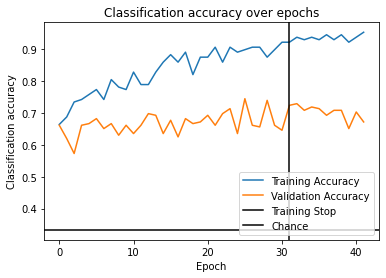

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8249 - acc: 0.5781 - val_loss: 0.8020 - val_acc: 0.6667
Epoch 2/50 0.237s 	 loss: 0.7070 - acc: 0.6875 - val_loss: 0.7126 - val_acc: 0.7344
Epoch 3/50 0.237s 	 loss: 0.6018 - acc: 0.7500 - val_loss: 0.6786 - val_acc: 0.7135
Epoch 4/50 0.240s 	 loss: 0.5717 - acc: 0.7969 - val_loss: 0.6203 - val_acc: 0.7396
Epoch 5/50 0.245s 	 loss: 0.5207 - acc: 0.8281 - val_loss: 0.6467 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.246s 	 loss: 0.5161 - acc: 0.7969 - val_loss: 0.6747 - val_acc: 0.7448
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.245s 	 loss: 0.4902 - acc: 0.8203 - val_loss: 0.6110 - val_acc: 0.7604
Epoch 8/50 0.240s 	 loss: 0.4762 - acc: 0.8516 - val_loss: 0.7135 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.248s 	 loss: 0.4192 - acc: 0.8828 - val_loss: 0.6793 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.245s 	 loss: 0.4379 - acc: 0.8359 - val_loss: 0.6658 - va

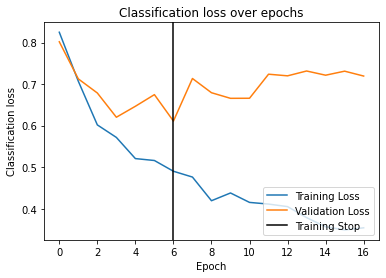

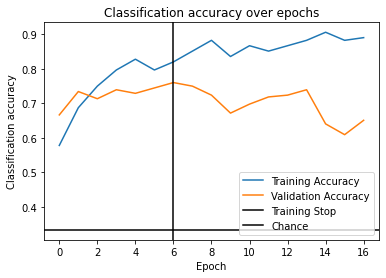

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8511 - acc: 0.6172 - val_loss: 0.6664 - val_acc: 0.7240
Epoch 2/50 0.247s 	 loss: 0.6722 - acc: 0.7266 - val_loss: 0.6661 - val_acc: 0.6354
Epoch 3/50 0.248s 	 loss: 0.6605 - acc: 0.7031 - val_loss: 0.6488 - val_acc: 0.6927
Epoch 4/50 0.241s 	 loss: 0.5992 - acc: 0.7578 - val_loss: 0.6147 - val_acc: 0.7083
Epoch 5/50 0.239s 	 loss: 0.5920 - acc: 0.7578 - val_loss: 0.6046 - val_acc: 0.7188
Epoch 6/50 0.241s 	 loss: 0.5519 - acc: 0.7812 - val_loss: 0.5351 - val_acc: 0.8021
Epoch 7/50 0.242s 	 loss: 0.5269 - acc: 0.7656 - val_loss: 0.6146 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.243s 	 loss: 0.5065 - acc: 0.8281 - val_loss: 0.5516 - val_acc: 0.8021
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.4937 - acc: 0.8047 - val_loss: 0.6726 - val_acc: 0.7083
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.240s 	 loss: 0.4544 - acc: 0.8203 - val_loss: 0.552

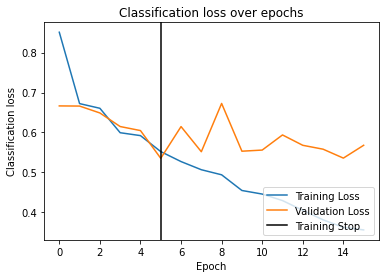

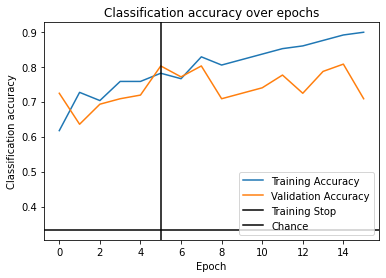

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.7817 - acc: 0.6953 - val_loss: 0.8317 - val_acc: 0.6302
Epoch 2/50 0.243s 	 loss: 0.6978 - acc: 0.7109 - val_loss: 0.8549 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.5675 - acc: 0.8125 - val_loss: 0.8484 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.242s 	 loss: 0.5489 - acc: 0.8047 - val_loss: 0.8177 - val_acc: 0.7135
Epoch 5/50 0.243s 	 loss: 0.5062 - acc: 0.8203 - val_loss: 0.8344 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.245s 	 loss: 0.4854 - acc: 0.8359 - val_loss: 0.8096 - val_acc: 0.6198
Epoch 7/50 0.240s 	 loss: 0.4502 - acc: 0.8359 - val_loss: 0.8121 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.246s 	 loss: 0.4267 - acc: 0.8516 - val_loss: 0.8128 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.244s 	 loss: 0.4078 - acc: 0.8594 - val_loss: 0.8313 - val_acc: 0.

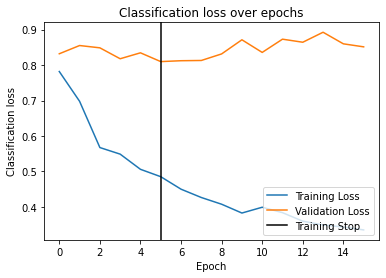

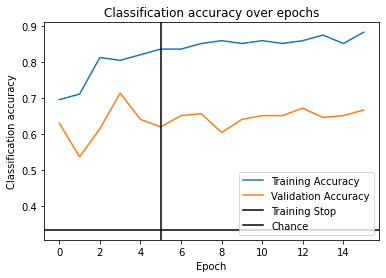

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.249s 	 loss: 0.7051 - acc: 0.7031 - val_loss: 0.7665 - val_acc: 0.6667
Epoch 2/50 0.239s 	 loss: 0.6295 - acc: 0.7500 - val_loss: 0.8523 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.247s 	 loss: 0.5655 - acc: 0.7656 - val_loss: 0.7104 - val_acc: 0.6927
Epoch 4/50 0.244s 	 loss: 0.5200 - acc: 0.8047 - val_loss: 0.7964 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.243s 	 loss: 0.4747 - acc: 0.8125 - val_loss: 0.7748 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.240s 	 loss: 0.4729 - acc: 0.8359 - val_loss: 0.7331 - val_acc: 0.6615
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.250s 	 loss: 0.4250 - acc: 0.8281 - val_loss: 0.7036 - val_acc: 0.7500
Epoch 8/50 0.241s 	 loss: 0.4285 - acc: 0.8438 - val_loss: 0.7384 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.245s 	 loss: 0.3952 - acc: 0.8594 - val_loss: 0.7447 - val_acc: 0.6823
EarlyStopping counter: 2 out of 10
E

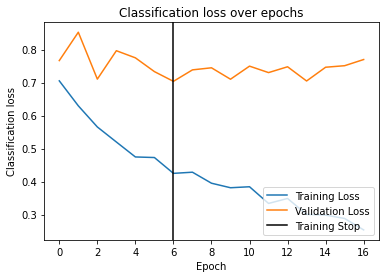

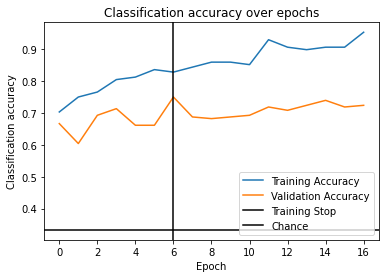

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.7058 - acc: 0.6875 - val_loss: 0.7765 - val_acc: 0.6562
Epoch 2/50 0.249s 	 loss: 0.6318 - acc: 0.7422 - val_loss: 0.7262 - val_acc: 0.6562
Epoch 3/50 0.244s 	 loss: 0.5982 - acc: 0.7891 - val_loss: 0.7469 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.245s 	 loss: 0.5253 - acc: 0.8047 - val_loss: 0.7090 - val_acc: 0.7083
Epoch 5/50 0.243s 	 loss: 0.5061 - acc: 0.8281 - val_loss: 0.7004 - val_acc: 0.7031
Epoch 6/50 0.245s 	 loss: 0.4819 - acc: 0.8359 - val_loss: 0.7296 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.243s 	 loss: 0.4671 - acc: 0.8281 - val_loss: 0.6759 - val_acc: 0.7031
Epoch 8/50 0.241s 	 loss: 0.4665 - acc: 0.8203 - val_loss: 0.7382 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.242s 	 loss: 0.3989 - acc: 0.8672 - val_loss: 0.6897 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.249s 	 loss: 0.4

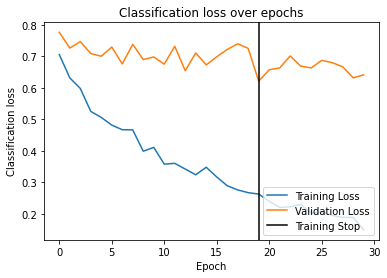

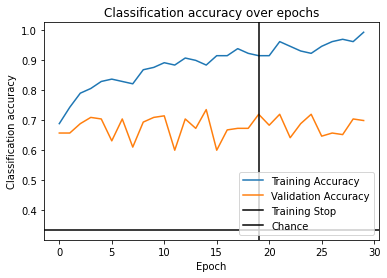

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.7626 - acc: 0.6484 - val_loss: 0.6284 - val_acc: 0.7656
Epoch 2/50 0.243s 	 loss: 0.6959 - acc: 0.7188 - val_loss: 0.6361 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.6767 - acc: 0.7031 - val_loss: 0.5874 - val_acc: 0.7917
Epoch 4/50 0.240s 	 loss: 0.6222 - acc: 0.7578 - val_loss: 0.6189 - val_acc: 0.7812
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.247s 	 loss: 0.6051 - acc: 0.7266 - val_loss: 0.6287 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.243s 	 loss: 0.5728 - acc: 0.7656 - val_loss: 0.6597 - val_acc: 0.7344
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.245s 	 loss: 0.5608 - acc: 0.8281 - val_loss: 0.6109 - val_acc: 0.8177
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.243s 	 loss: 0.4690 - acc: 0.8672 - val_loss: 0.5977 - val_acc: 0.7500
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.247s 	 loss: 0.4875 - acc: 0.82

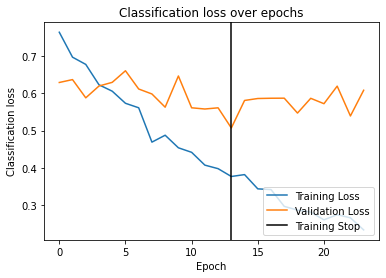

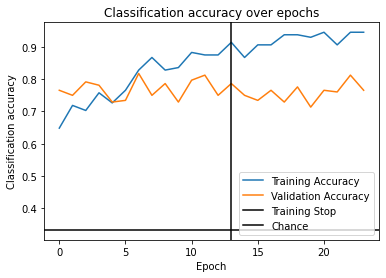

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.9719 - acc: 0.5703 - val_loss: 0.8024 - val_acc: 0.5938
Epoch 2/50 0.242s 	 loss: 0.8599 - acc: 0.6094 - val_loss: 0.8343 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.243s 	 loss: 0.8543 - acc: 0.6250 - val_loss: 0.8103 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.246s 	 loss: 0.7526 - acc: 0.6641 - val_loss: 0.8244 - val_acc: 0.6250
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.240s 	 loss: 0.7018 - acc: 0.6953 - val_loss: 0.7748 - val_acc: 0.6406
Epoch 6/50 0.241s 	 loss: 0.6630 - acc: 0.7344 - val_loss: 0.7929 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.245s 	 loss: 0.6329 - acc: 0.7500 - val_loss: 0.8359 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.243s 	 loss: 0.5671 - acc: 0.7891 - val_loss: 0.8045 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.245s 	 loss: 0.5459 - acc: 0.8125 - val_loss: 0.8243 - val_acc: 0.6302
E

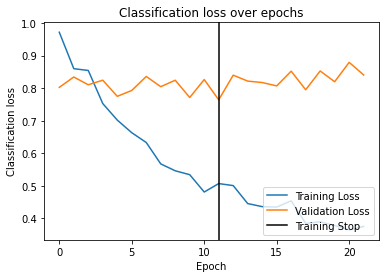

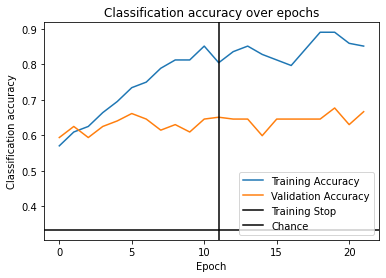

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8628 - acc: 0.6172 - val_loss: 1.0580 - val_acc: 0.5104
Epoch 2/50 0.244s 	 loss: 0.8228 - acc: 0.6641 - val_loss: 0.9306 - val_acc: 0.6771
Epoch 3/50 0.250s 	 loss: 0.7645 - acc: 0.7422 - val_loss: 0.9484 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.246s 	 loss: 0.6977 - acc: 0.7109 - val_loss: 0.9271 - val_acc: 0.5938
Epoch 5/50 0.241s 	 loss: 0.7025 - acc: 0.7188 - val_loss: 0.9335 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.245s 	 loss: 0.6654 - acc: 0.7734 - val_loss: 0.9615 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.244s 	 loss: 0.6271 - acc: 0.7656 - val_loss: 0.8802 - val_acc: 0.6146
Epoch 8/50 0.246s 	 loss: 0.5878 - acc: 0.7812 - val_loss: 0.8956 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.247s 	 loss: 0.5749 - acc: 0.7734 - val_loss: 0.9406 - val_acc: 0.5833
EarlyStopping counter: 2 out o

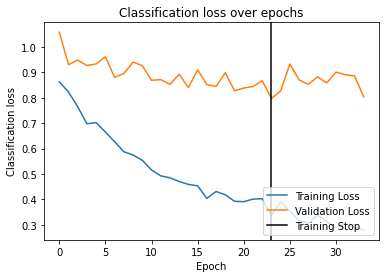

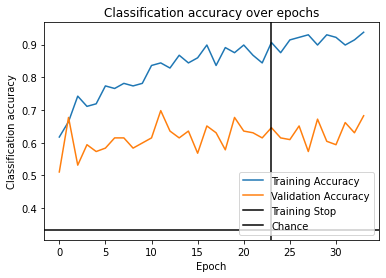

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.9157 - acc: 0.6094 - val_loss: 0.8566 - val_acc: 0.6250
Epoch 2/50 0.240s 	 loss: 0.9050 - acc: 0.5859 - val_loss: 0.8689 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.8178 - acc: 0.6875 - val_loss: 0.7855 - val_acc: 0.7083
Epoch 4/50 0.239s 	 loss: 0.7864 - acc: 0.6094 - val_loss: 0.8045 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.247s 	 loss: 0.7619 - acc: 0.7031 - val_loss: 0.7641 - val_acc: 0.6458
Epoch 6/50 0.242s 	 loss: 0.7325 - acc: 0.6953 - val_loss: 0.7557 - val_acc: 0.7344
Epoch 7/50 0.243s 	 loss: 0.7090 - acc: 0.6797 - val_loss: 0.6921 - val_acc: 0.7031
Epoch 8/50 0.241s 	 loss: 0.7353 - acc: 0.7266 - val_loss: 0.7377 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.240s 	 loss: 0.6501 - acc: 0.7500 - val_loss: 0.6528 - val_acc: 0.7656
Epoch 10/50 0.242s 	 loss: 0.6530 - acc: 0.7500 - val_loss: 0.614

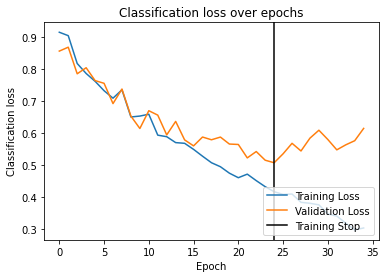

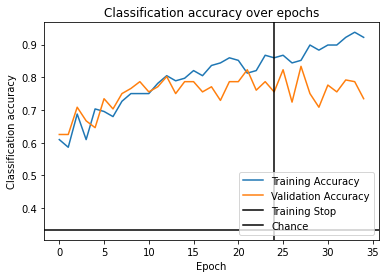

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 1.0014 - acc: 0.5391 - val_loss: 0.7189 - val_acc: 0.7240
Epoch 2/50 0.248s 	 loss: 0.9169 - acc: 0.6172 - val_loss: 0.7070 - val_acc: 0.7083
Epoch 3/50 0.241s 	 loss: 0.8914 - acc: 0.6328 - val_loss: 0.6634 - val_acc: 0.7240
Epoch 4/50 0.242s 	 loss: 0.8330 - acc: 0.6484 - val_loss: 0.7368 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.249s 	 loss: 0.8128 - acc: 0.6328 - val_loss: 0.7690 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.251s 	 loss: 0.7758 - acc: 0.6406 - val_loss: 0.7281 - val_acc: 0.6927
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.241s 	 loss: 0.7453 - acc: 0.6875 - val_loss: 0.7684 - val_acc: 0.6771
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.245s 	 loss: 0.7356 - acc: 0.6641 - val_loss: 0.7226 - val_acc: 0.7240
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.243s 	 loss: 0.7029 - acc: 0.7109 - val_loss: 0.7105 - val_acc: 0.6771
EarlyStopping counter: 6 out of 10
E

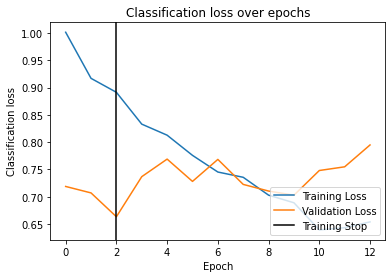

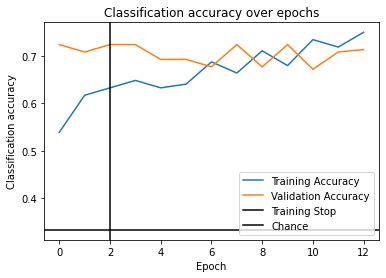

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8537 - acc: 0.6172 - val_loss: 1.1224 - val_acc: 0.4792
Epoch 2/50 0.247s 	 loss: 0.7878 - acc: 0.6797 - val_loss: 1.0474 - val_acc: 0.5521
Epoch 3/50 0.242s 	 loss: 0.7351 - acc: 0.6719 - val_loss: 0.9701 - val_acc: 0.5573
Epoch 4/50 0.240s 	 loss: 0.7080 - acc: 0.7188 - val_loss: 1.0391 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.6677 - acc: 0.7578 - val_loss: 1.0239 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.248s 	 loss: 0.6423 - acc: 0.7500 - val_loss: 0.9803 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.247s 	 loss: 0.6420 - acc: 0.7266 - val_loss: 1.0699 - val_acc: 0.5052
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.244s 	 loss: 0.6055 - acc: 0.7891 - val_loss: 0.9413 - val_acc: 0.5260
Epoch 9/50 0.241s 	 loss: 0.5718 - acc: 0.8203 - val_loss: 0.9813 - val_acc: 0.6094
EarlyStopping counter: 1 out o

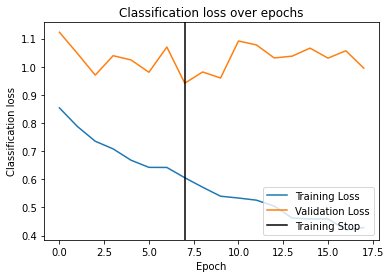

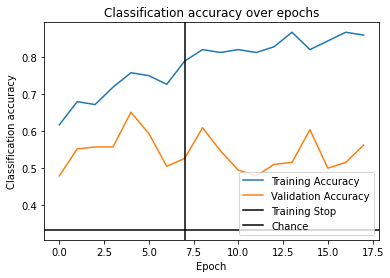

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 0.8872 - acc: 0.6641 - val_loss: 0.9959 - val_acc: 0.5104
Epoch 2/50 0.245s 	 loss: 0.8250 - acc: 0.6172 - val_loss: 1.0092 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.244s 	 loss: 0.7907 - acc: 0.6953 - val_loss: 0.9293 - val_acc: 0.5417
Epoch 4/50 0.241s 	 loss: 0.7344 - acc: 0.7031 - val_loss: 0.9584 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.244s 	 loss: 0.7244 - acc: 0.6797 - val_loss: 0.9676 - val_acc: 0.4948
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.243s 	 loss: 0.7087 - acc: 0.6875 - val_loss: 0.9156 - val_acc: 0.5885
Epoch 7/50 0.244s 	 loss: 0.6852 - acc: 0.7188 - val_loss: 0.9579 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.240s 	 loss: 0.6912 - acc: 0.7188 - val_loss: 0.9336 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.242s 	 loss: 0.6066 - acc: 0.7500 - val_loss: 0.8734 - val_acc: 0.

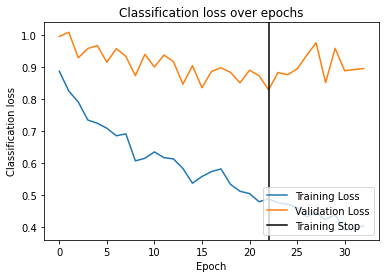

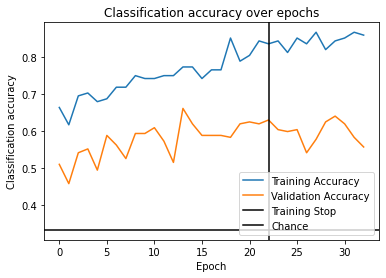

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0396 - acc: 0.5469 - val_loss: 0.7198 - val_acc: 0.7240
Epoch 2/50 0.239s 	 loss: 0.9565 - acc: 0.5703 - val_loss: 0.7161 - val_acc: 0.6510
Epoch 3/50 0.235s 	 loss: 0.9321 - acc: 0.6016 - val_loss: 0.7154 - val_acc: 0.6562
Epoch 4/50 0.236s 	 loss: 0.9301 - acc: 0.6484 - val_loss: 0.7642 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.8717 - acc: 0.6484 - val_loss: 0.7941 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.8624 - acc: 0.6484 - val_loss: 0.7915 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.8068 - acc: 0.6797 - val_loss: 0.7776 - val_acc: 0.7240
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.237s 	 loss: 0.8366 - acc: 0.6641 - val_loss: 0.7767 - val_acc: 0.6927
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.236s 	 loss: 0.8124 - acc: 0.6406 - val_loss: 0.8176 - val_acc: 0.5990
EarlyStopping counter: 6 out of 10
E

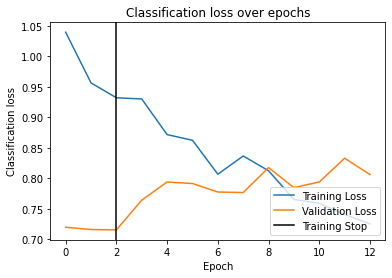

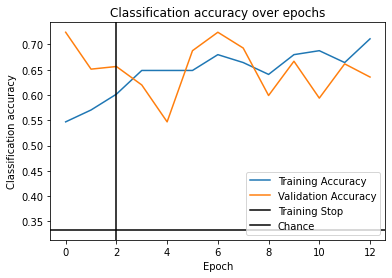

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.9798 - acc: 0.6250 - val_loss: 0.8982 - val_acc: 0.6042
Epoch 2/50 0.236s 	 loss: 0.8746 - acc: 0.6328 - val_loss: 0.8769 - val_acc: 0.6771
Epoch 3/50 0.232s 	 loss: 0.8667 - acc: 0.5938 - val_loss: 0.8752 - val_acc: 0.6250
Epoch 4/50 0.235s 	 loss: 0.8280 - acc: 0.6406 - val_loss: 0.8736 - val_acc: 0.6510
Epoch 5/50 0.236s 	 loss: 0.8452 - acc: 0.6094 - val_loss: 0.8781 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.7906 - acc: 0.6562 - val_loss: 0.9168 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.7754 - acc: 0.6797 - val_loss: 0.8093 - val_acc: 0.6719
Epoch 8/50 0.237s 	 loss: 0.7920 - acc: 0.6328 - val_loss: 0.9357 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.7364 - acc: 0.7109 - val_loss: 0.9248 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.237s 	 loss: 0.7

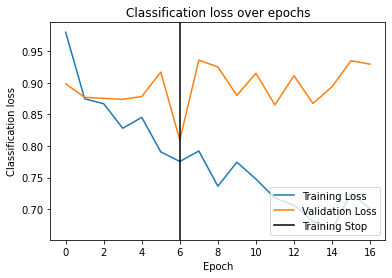

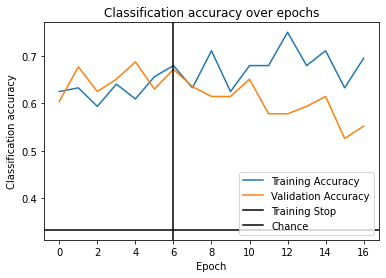

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8117 - acc: 0.6719 - val_loss: 1.1957 - val_acc: 0.5573
Epoch 2/50 0.234s 	 loss: 0.7372 - acc: 0.7344 - val_loss: 1.1912 - val_acc: 0.4740
Epoch 3/50 0.237s 	 loss: 0.7234 - acc: 0.7578 - val_loss: 1.1765 - val_acc: 0.5885
Epoch 4/50 0.238s 	 loss: 0.6691 - acc: 0.8047 - val_loss: 1.2761 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.6818 - acc: 0.7578 - val_loss: 1.1860 - val_acc: 0.5104
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.6370 - acc: 0.7969 - val_loss: 1.2811 - val_acc: 0.5052
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.233s 	 loss: 0.6140 - acc: 0.7891 - val_loss: 1.2749 - val_acc: 0.4740
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.232s 	 loss: 0.6433 - acc: 0.7734 - val_loss: 1.2495 - val_acc: 0.5052
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.234s 	 loss: 0.5862 - acc: 0.8203 - val_loss: 1.2082 - val_acc: 0.

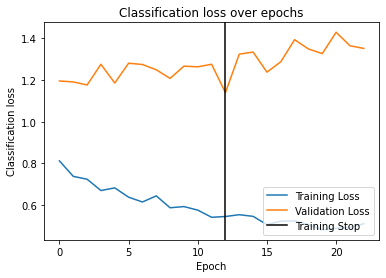

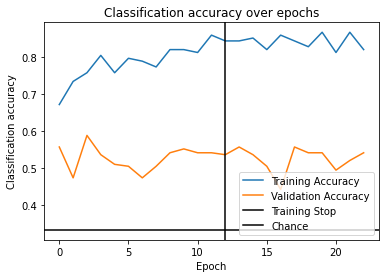

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.1033 - acc: 0.4688 - val_loss: 1.0863 - val_acc: 0.4844
Epoch 2/50 0.236s 	 loss: 1.1433 - acc: 0.4531 - val_loss: 1.0343 - val_acc: 0.4167
Epoch 3/50 0.233s 	 loss: 1.0655 - acc: 0.4766 - val_loss: 1.0655 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.9322 - acc: 0.5781 - val_loss: 1.0469 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.9550 - acc: 0.5234 - val_loss: 1.0409 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.239s 	 loss: 0.9242 - acc: 0.5391 - val_loss: 0.9821 - val_acc: 0.5156
Epoch 7/50 0.236s 	 loss: 0.8871 - acc: 0.5469 - val_loss: 1.0626 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.8546 - acc: 0.5859 - val_loss: 1.0729 - val_acc: 0.5052
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.236s 	 loss: 0.8609 - acc: 0.6016 - val_loss: 1.0772 - val_acc: 0.5312
EarlyStopping counter: 3 out of 10
E

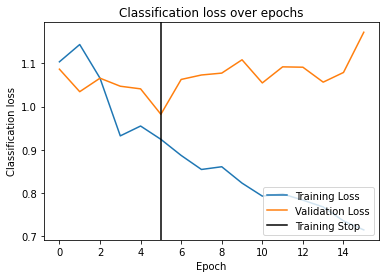

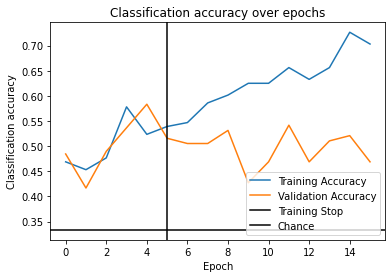

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0424 - acc: 0.4453 - val_loss: 1.1943 - val_acc: 0.4219
Epoch 2/50 0.232s 	 loss: 1.0205 - acc: 0.5000 - val_loss: 1.1574 - val_acc: 0.3802
Epoch 3/50 0.232s 	 loss: 0.9841 - acc: 0.5391 - val_loss: 1.1298 - val_acc: 0.4271
Epoch 4/50 0.233s 	 loss: 0.9607 - acc: 0.5469 - val_loss: 1.0822 - val_acc: 0.5417
Epoch 5/50 0.233s 	 loss: 0.8914 - acc: 0.5703 - val_loss: 1.1000 - val_acc: 0.4167
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.9372 - acc: 0.5547 - val_loss: 1.0489 - val_acc: 0.5156
Epoch 7/50 0.233s 	 loss: 0.9037 - acc: 0.6016 - val_loss: 1.1012 - val_acc: 0.4792
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.8935 - acc: 0.5625 - val_loss: 1.0891 - val_acc: 0.4323
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.8315 - acc: 0.6641 - val_loss: 1.0508 - val_acc: 0.4844
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.238s 	 loss: 0.8

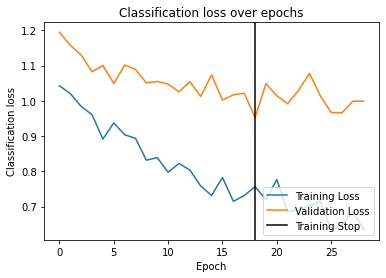

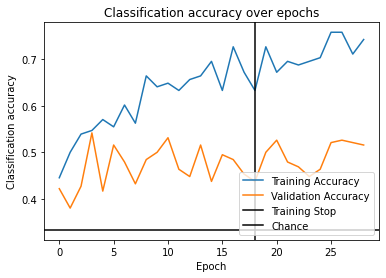

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1090 - acc: 0.4688 - val_loss: 1.1017 - val_acc: 0.4844
Epoch 2/50 0.234s 	 loss: 1.0442 - acc: 0.5156 - val_loss: 1.0963 - val_acc: 0.4635
Epoch 3/50 0.235s 	 loss: 0.9666 - acc: 0.5078 - val_loss: 1.1007 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.9333 - acc: 0.5078 - val_loss: 1.0530 - val_acc: 0.4479
Epoch 5/50 0.232s 	 loss: 0.8882 - acc: 0.5625 - val_loss: 1.0123 - val_acc: 0.5156
Epoch 6/50 0.232s 	 loss: 0.8632 - acc: 0.5859 - val_loss: 1.0926 - val_acc: 0.4792
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.232s 	 loss: 0.8333 - acc: 0.6328 - val_loss: 1.0701 - val_acc: 0.4583
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.8189 - acc: 0.5859 - val_loss: 1.0921 - val_acc: 0.4427
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.232s 	 loss: 0.7825 - acc: 0.6328 - val_loss: 1.0787 - val_acc: 0.4844
EarlyStopping counter: 4 out o

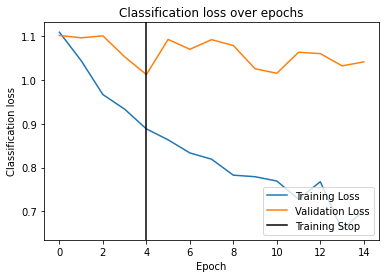

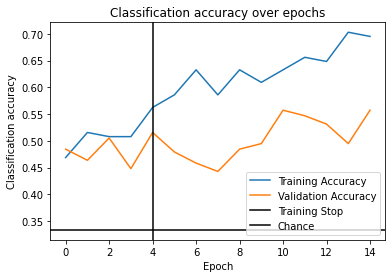

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.0598 - acc: 0.4766 - val_loss: 1.1574 - val_acc: 0.4948
Epoch 2/50 0.232s 	 loss: 0.9633 - acc: 0.5625 - val_loss: 1.1477 - val_acc: 0.5052
Epoch 3/50 0.233s 	 loss: 0.9613 - acc: 0.5469 - val_loss: 1.1027 - val_acc: 0.5365
Epoch 4/50 0.233s 	 loss: 0.9385 - acc: 0.5625 - val_loss: 0.9883 - val_acc: 0.6146
Epoch 5/50 0.233s 	 loss: 0.8668 - acc: 0.6250 - val_loss: 1.0749 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.8918 - acc: 0.5781 - val_loss: 1.0663 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.237s 	 loss: 0.8937 - acc: 0.6016 - val_loss: 0.9853 - val_acc: 0.5990
Epoch 8/50 0.232s 	 loss: 0.8201 - acc: 0.6641 - val_loss: 0.9859 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.8170 - acc: 0.6562 - val_loss: 0.9490 - val_acc: 0.6198
Epoch 10/50 0.233s 	 loss: 0.8009 - acc: 0.6953 - val_loss: 0.9760 - val_acc: 0.6354
EarlyStopping counter

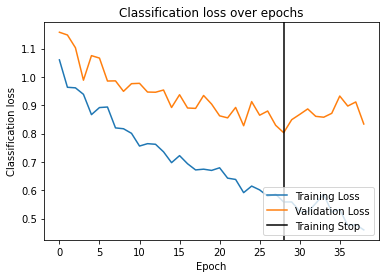

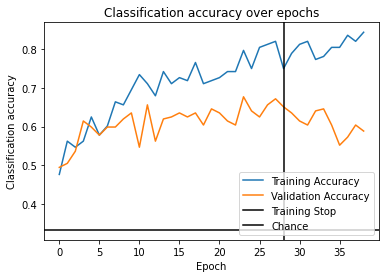

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.1616 - acc: 0.4922 - val_loss: 0.9982 - val_acc: 0.5521
Epoch 2/50 0.232s 	 loss: 1.0543 - acc: 0.5078 - val_loss: 0.9401 - val_acc: 0.5521
Epoch 3/50 0.234s 	 loss: 1.0052 - acc: 0.5625 - val_loss: 0.9260 - val_acc: 0.6510
Epoch 4/50 0.234s 	 loss: 0.9426 - acc: 0.6016 - val_loss: 0.9458 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.9397 - acc: 0.6328 - val_loss: 0.9326 - val_acc: 0.4948
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.9200 - acc: 0.6016 - val_loss: 0.9233 - val_acc: 0.6094
Epoch 7/50 0.233s 	 loss: 0.9251 - acc: 0.6250 - val_loss: 0.9438 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.8975 - acc: 0.6250 - val_loss: 0.8962 - val_acc: 0.5208
Epoch 9/50 0.232s 	 loss: 0.7962 - acc: 0.6719 - val_loss: 0.9014 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.8

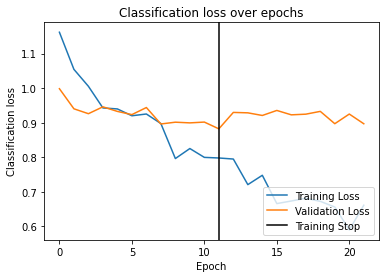

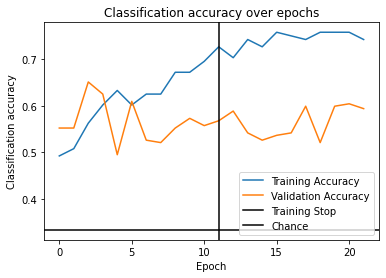

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.245s 	 loss: 1.0395 - acc: 0.4922 - val_loss: 1.1040 - val_acc: 0.4844
Epoch 2/50 0.238s 	 loss: 1.0177 - acc: 0.5234 - val_loss: 1.0836 - val_acc: 0.4531
Epoch 3/50 0.234s 	 loss: 0.9153 - acc: 0.5938 - val_loss: 1.0866 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.8764 - acc: 0.6172 - val_loss: 1.0432 - val_acc: 0.5781
Epoch 5/50 0.235s 	 loss: 0.8826 - acc: 0.5859 - val_loss: 1.0805 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.8825 - acc: 0.5859 - val_loss: 1.1102 - val_acc: 0.4740
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.241s 	 loss: 0.7809 - acc: 0.6094 - val_loss: 1.0110 - val_acc: 0.5573
Epoch 8/50 0.237s 	 loss: 0.7693 - acc: 0.6797 - val_loss: 1.0616 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.7538 - acc: 0.6875 - val_loss: 1.0341 - val_acc: 0.4792
EarlyStopping counter: 2 out o

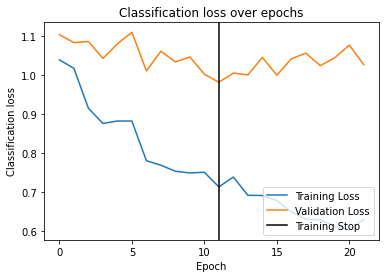

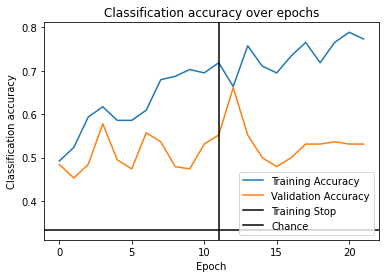

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8119 - acc: 0.6250 - val_loss: 0.7876 - val_acc: 0.6615
Epoch 2/50 0.236s 	 loss: 0.7435 - acc: 0.6641 - val_loss: 0.7803 - val_acc: 0.6927
Epoch 3/50 0.234s 	 loss: 0.7077 - acc: 0.6797 - val_loss: 0.7544 - val_acc: 0.7448
Epoch 4/50 0.234s 	 loss: 0.6757 - acc: 0.7266 - val_loss: 0.8396 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.6461 - acc: 0.7344 - val_loss: 0.7757 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.6345 - acc: 0.7422 - val_loss: 0.7699 - val_acc: 0.6719
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.239s 	 loss: 0.5876 - acc: 0.7969 - val_loss: 0.8342 - val_acc: 0.6562
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.235s 	 loss: 0.5553 - acc: 0.8281 - val_loss: 0.7334 - val_acc: 0.7552
Epoch 9/50 0.236s 	 loss: 0.5178 - acc: 0.8516 - val_loss: 0.7107 - val_acc: 0.6875
Epoch 10/50 0.233s 	 loss: 0.5460 - acc: 0.8359 - val_loss: 0.7362 - va

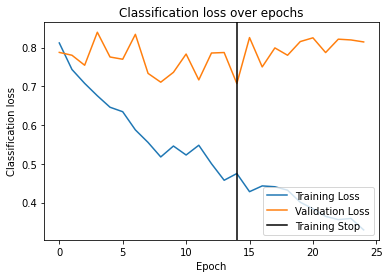

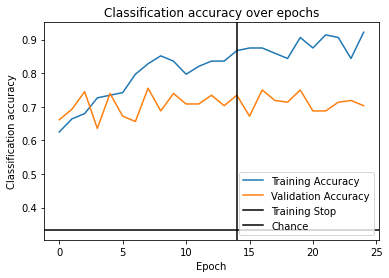

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7752 - acc: 0.6641 - val_loss: 0.8520 - val_acc: 0.5521
Epoch 2/50 0.236s 	 loss: 0.7198 - acc: 0.7578 - val_loss: 0.8508 - val_acc: 0.5677
Epoch 3/50 0.234s 	 loss: 0.6517 - acc: 0.7656 - val_loss: 0.7924 - val_acc: 0.5938
Epoch 4/50 0.233s 	 loss: 0.6300 - acc: 0.7734 - val_loss: 0.7779 - val_acc: 0.5781
Epoch 5/50 0.233s 	 loss: 0.6411 - acc: 0.7578 - val_loss: 0.7965 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.5663 - acc: 0.8203 - val_loss: 0.7308 - val_acc: 0.6406
Epoch 7/50 0.235s 	 loss: 0.5641 - acc: 0.8125 - val_loss: 0.7937 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.5304 - acc: 0.8438 - val_loss: 0.7700 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.236s 	 loss: 0.5115 - acc: 0.8359 - val_loss: 0.7972 - val_acc: 0.6615
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.233s 	 loss: 0.5

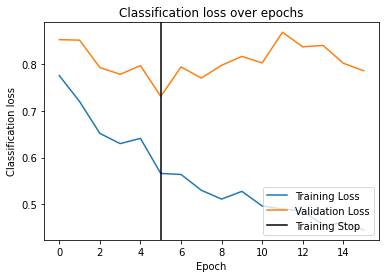

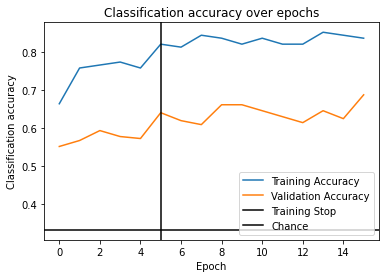

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8680 - acc: 0.5625 - val_loss: 0.7578 - val_acc: 0.6927
Epoch 2/50 0.238s 	 loss: 0.8266 - acc: 0.6328 - val_loss: 0.7149 - val_acc: 0.7656
Epoch 3/50 0.231s 	 loss: 0.8006 - acc: 0.6406 - val_loss: 0.6791 - val_acc: 0.7500
Epoch 4/50 0.235s 	 loss: 0.7782 - acc: 0.5938 - val_loss: 0.6191 - val_acc: 0.8177
Epoch 5/50 0.236s 	 loss: 0.7146 - acc: 0.7109 - val_loss: 0.6188 - val_acc: 0.7812
Epoch 6/50 0.238s 	 loss: 0.7298 - acc: 0.6484 - val_loss: 0.6123 - val_acc: 0.7552
Epoch 7/50 0.237s 	 loss: 0.6989 - acc: 0.7109 - val_loss: 0.5795 - val_acc: 0.7969
Epoch 8/50 0.243s 	 loss: 0.6916 - acc: 0.7344 - val_loss: 0.5701 - val_acc: 0.7500
Epoch 9/50 0.235s 	 loss: 0.6794 - acc: 0.6719 - val_loss: 0.5500 - val_acc: 0.8177
Epoch 10/50 0.234s 	 loss: 0.6444 - acc: 0.7266 - val_loss: 0.5709 - val_acc: 0.8333
EarlyStopping counter: 1 out of 10
Epoch 11/50 0.237s 	 loss: 0.6579 - acc: 0.7422 - 

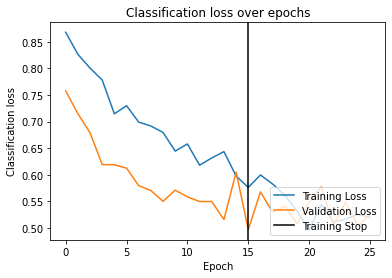

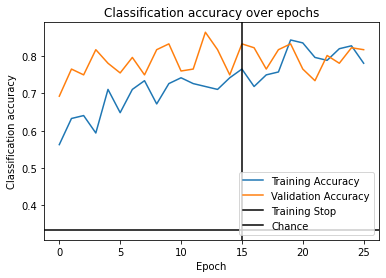

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.248s 	 loss: 1.0093 - acc: 0.5156 - val_loss: 0.8776 - val_acc: 0.6302
Epoch 2/50 0.235s 	 loss: 0.8891 - acc: 0.6016 - val_loss: 0.9679 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8302 - acc: 0.6250 - val_loss: 0.8375 - val_acc: 0.5573
Epoch 4/50 0.235s 	 loss: 0.7774 - acc: 0.6641 - val_loss: 0.8548 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.241s 	 loss: 0.6928 - acc: 0.7188 - val_loss: 0.8536 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.6822 - acc: 0.6875 - val_loss: 0.8045 - val_acc: 0.5573
Epoch 7/50 0.236s 	 loss: 0.6387 - acc: 0.7109 - val_loss: 0.8681 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.6121 - acc: 0.7031 - val_loss: 0.8723 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.240s 	 loss: 0.5789 - acc: 0.7656 - val_loss: 0.8654 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
E

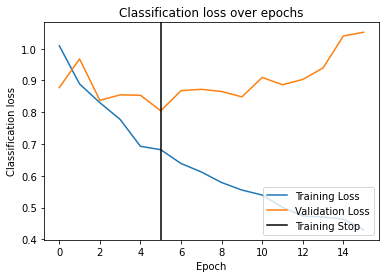

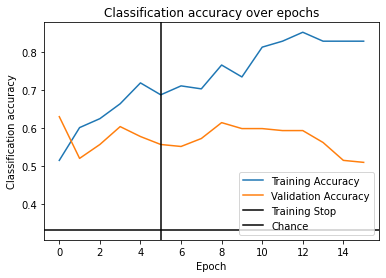

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.0491 - acc: 0.5391 - val_loss: 1.0009 - val_acc: 0.5156
Epoch 2/50 0.233s 	 loss: 0.9549 - acc: 0.6016 - val_loss: 0.9297 - val_acc: 0.5365
Epoch 3/50 0.240s 	 loss: 0.8468 - acc: 0.6094 - val_loss: 0.8785 - val_acc: 0.5729
Epoch 4/50 0.237s 	 loss: 0.7770 - acc: 0.6641 - val_loss: 0.8921 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7281 - acc: 0.6953 - val_loss: 0.8637 - val_acc: 0.5573
Epoch 6/50 0.234s 	 loss: 0.7375 - acc: 0.6719 - val_loss: 0.8476 - val_acc: 0.5938
Epoch 7/50 0.237s 	 loss: 0.6374 - acc: 0.7500 - val_loss: 0.8222 - val_acc: 0.6302
Epoch 8/50 0.237s 	 loss: 0.6376 - acc: 0.7422 - val_loss: 0.8243 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.6584 - acc: 0.7422 - val_loss: 0.7661 - val_acc: 0.6510
Epoch 10/50 0.231s 	 loss: 0.6278 - acc: 0.7344 - val_loss: 0.8329 - val_acc: 0.5833
EarlyStopping c

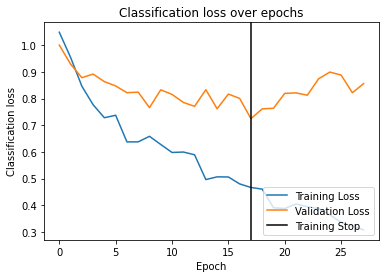

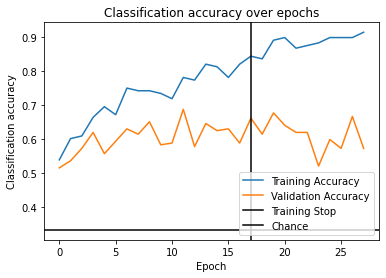

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.9826 - acc: 0.5234 - val_loss: 1.1999 - val_acc: 0.4688
Epoch 2/50 0.237s 	 loss: 0.8424 - acc: 0.5938 - val_loss: 1.0439 - val_acc: 0.5000
Epoch 3/50 0.234s 	 loss: 0.7609 - acc: 0.6562 - val_loss: 1.0426 - val_acc: 0.5104
Epoch 4/50 0.240s 	 loss: 0.6746 - acc: 0.7656 - val_loss: 0.9487 - val_acc: 0.4792
Epoch 5/50 0.238s 	 loss: 0.6516 - acc: 0.7422 - val_loss: 0.9462 - val_acc: 0.5312
Epoch 6/50 0.242s 	 loss: 0.6130 - acc: 0.7188 - val_loss: 0.9576 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.5776 - acc: 0.8047 - val_loss: 0.9313 - val_acc: 0.5573
Epoch 8/50 0.240s 	 loss: 0.5698 - acc: 0.7734 - val_loss: 0.9280 - val_acc: 0.5469
Epoch 9/50 0.234s 	 loss: 0.5273 - acc: 0.7812 - val_loss: 0.9404 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.238s 	 loss: 0.4994 - acc: 0.8359 - val_loss: 0.9484 - val_acc: 0.5729
EarlyStopping c

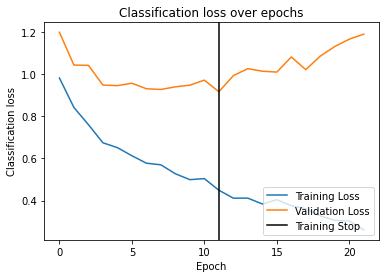

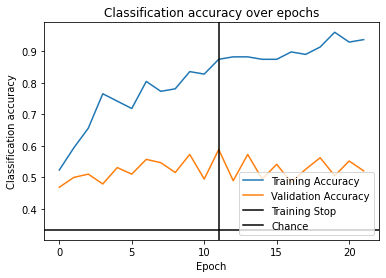

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6980 - acc: 0.6953 - val_loss: 0.8937 - val_acc: 0.6042
Epoch 2/50 0.235s 	 loss: 0.6369 - acc: 0.6875 - val_loss: 0.8005 - val_acc: 0.5729
Epoch 3/50 0.236s 	 loss: 0.6245 - acc: 0.7109 - val_loss: 0.8167 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.5936 - acc: 0.7656 - val_loss: 0.7819 - val_acc: 0.6302
Epoch 5/50 0.235s 	 loss: 0.5561 - acc: 0.8281 - val_loss: 0.7169 - val_acc: 0.6510
Epoch 6/50 0.233s 	 loss: 0.5134 - acc: 0.8203 - val_loss: 0.6772 - val_acc: 0.7031
Epoch 7/50 0.239s 	 loss: 0.4801 - acc: 0.8438 - val_loss: 0.7358 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.5134 - acc: 0.8359 - val_loss: 0.7296 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.242s 	 loss: 0.4719 - acc: 0.8516 - val_loss: 0.7318 - val_acc: 0.6354
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.240s 	 loss: 0.4563 - acc: 0.8750 - val_loss: 0.7407 - va

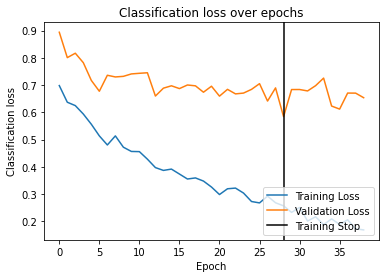

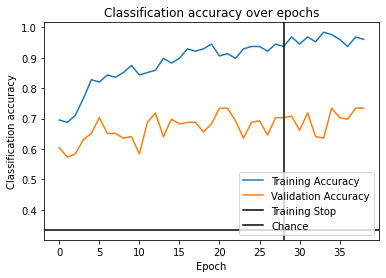

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.6811 - acc: 0.7266 - val_loss: 0.8993 - val_acc: 0.5677
Epoch 2/50 0.242s 	 loss: 0.6117 - acc: 0.7422 - val_loss: 0.8738 - val_acc: 0.5833
Epoch 3/50 0.235s 	 loss: 0.5457 - acc: 0.7812 - val_loss: 0.8465 - val_acc: 0.5938
Epoch 4/50 0.234s 	 loss: 0.5165 - acc: 0.7812 - val_loss: 0.8234 - val_acc: 0.6823
Epoch 5/50 0.238s 	 loss: 0.5247 - acc: 0.7812 - val_loss: 0.7904 - val_acc: 0.6979
Epoch 6/50 0.236s 	 loss: 0.4707 - acc: 0.7969 - val_loss: 0.8057 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.4541 - acc: 0.8125 - val_loss: 0.8356 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.4127 - acc: 0.8516 - val_loss: 0.8275 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.239s 	 loss: 0.4156 - acc: 0.8594 - val_loss: 0.7841 - val_acc: 0.6719
Epoch 10/50 0.233s 	 loss: 0.4157 - acc: 0.8281 - val_loss: 0.838

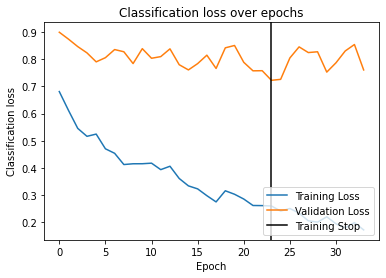

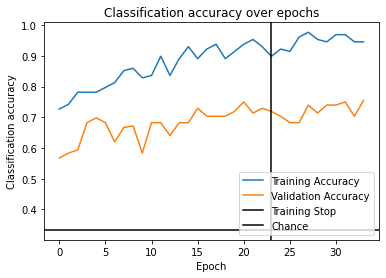

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8321 - acc: 0.5781 - val_loss: 0.4875 - val_acc: 0.8021
Epoch 2/50 0.236s 	 loss: 0.7599 - acc: 0.6797 - val_loss: 0.4872 - val_acc: 0.8177
Epoch 3/50 0.240s 	 loss: 0.7539 - acc: 0.6328 - val_loss: 0.4684 - val_acc: 0.8854
Epoch 4/50 0.243s 	 loss: 0.6795 - acc: 0.7422 - val_loss: 0.4825 - val_acc: 0.8542
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.6574 - acc: 0.7500 - val_loss: 0.5001 - val_acc: 0.8333
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.240s 	 loss: 0.6015 - acc: 0.7422 - val_loss: 0.5017 - val_acc: 0.8125
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.237s 	 loss: 0.5546 - acc: 0.7656 - val_loss: 0.4837 - val_acc: 0.8958
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.234s 	 loss: 0.5245 - acc: 0.7656 - val_loss: 0.4624 - val_acc: 0.8438
Epoch 9/50 0.239s 	 loss: 0.5346 - acc: 0.7969 - val_loss: 0.5431 - val_acc: 0.8021
EarlyStopping counter: 1 out o

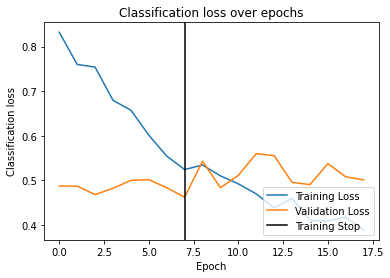

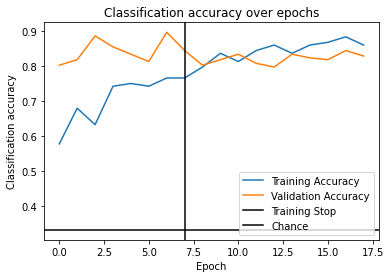

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 0.9886 - acc: 0.5781 - val_loss: 0.8134 - val_acc: 0.6354
Epoch 2/50 0.237s 	 loss: 0.8695 - acc: 0.6250 - val_loss: 0.8232 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8646 - acc: 0.6172 - val_loss: 0.8083 - val_acc: 0.6667
Epoch 4/50 0.235s 	 loss: 0.8352 - acc: 0.6797 - val_loss: 0.7439 - val_acc: 0.7188
Epoch 5/50 0.233s 	 loss: 0.8023 - acc: 0.6875 - val_loss: 0.7932 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.7787 - acc: 0.6484 - val_loss: 0.7360 - val_acc: 0.6875
Epoch 7/50 0.233s 	 loss: 0.7718 - acc: 0.6562 - val_loss: 0.7701 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.7089 - acc: 0.6719 - val_loss: 0.7258 - val_acc: 0.6927
Epoch 9/50 0.235s 	 loss: 0.7133 - acc: 0.6953 - val_loss: 0.7418 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.7405 - acc: 0.6562 - val_loss: 0.7047 - va

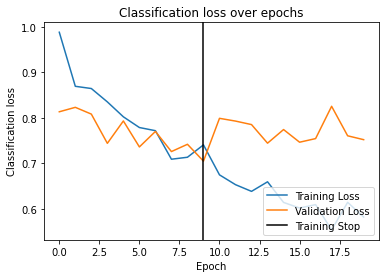

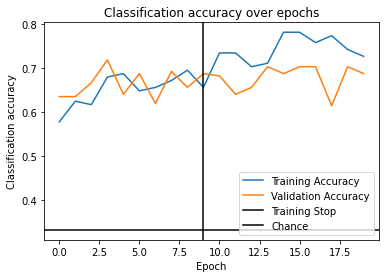

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9299 - acc: 0.5859 - val_loss: 0.8626 - val_acc: 0.6302
Epoch 2/50 0.237s 	 loss: 0.8810 - acc: 0.5938 - val_loss: 0.8611 - val_acc: 0.5885
Epoch 3/50 0.233s 	 loss: 0.8096 - acc: 0.6250 - val_loss: 0.8281 - val_acc: 0.6510
Epoch 4/50 0.236s 	 loss: 0.7889 - acc: 0.6641 - val_loss: 0.9061 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.7395 - acc: 0.6562 - val_loss: 0.8040 - val_acc: 0.6302
Epoch 6/50 0.236s 	 loss: 0.7409 - acc: 0.6875 - val_loss: 0.8385 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.6855 - acc: 0.6953 - val_loss: 0.8076 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.6730 - acc: 0.7344 - val_loss: 0.7767 - val_acc: 0.6771
Epoch 9/50 0.235s 	 loss: 0.6192 - acc: 0.7422 - val_loss: 0.8108 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.238s 	 loss: 0.6

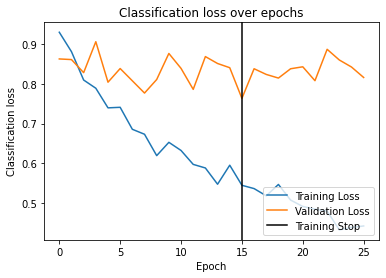

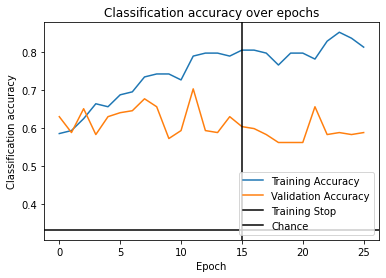

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.8750 - acc: 0.6250 - val_loss: 1.0731 - val_acc: 0.5521
Epoch 2/50 0.238s 	 loss: 0.8038 - acc: 0.6641 - val_loss: 1.0720 - val_acc: 0.5521
Epoch 3/50 0.233s 	 loss: 0.7255 - acc: 0.6953 - val_loss: 1.1825 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.6867 - acc: 0.6797 - val_loss: 1.0966 - val_acc: 0.4844
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.6469 - acc: 0.7031 - val_loss: 1.0682 - val_acc: 0.5365
Epoch 6/50 0.233s 	 loss: 0.6340 - acc: 0.7188 - val_loss: 1.0938 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.6400 - acc: 0.7578 - val_loss: 1.0932 - val_acc: 0.5052
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.6147 - acc: 0.7656 - val_loss: 1.1397 - val_acc: 0.5052
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.231s 	 loss: 0.5653 - acc: 0.7656 - val_loss: 1.0495 - val_acc: 0.

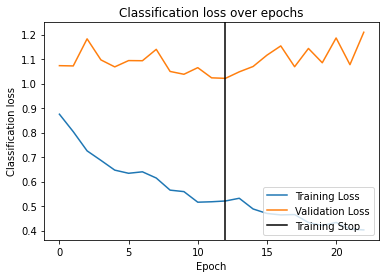

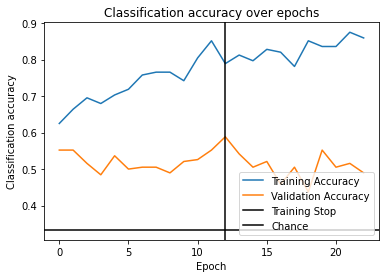

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0550 - acc: 0.5078 - val_loss: 0.8658 - val_acc: 0.6198
Epoch 2/50 0.237s 	 loss: 0.9521 - acc: 0.5859 - val_loss: 0.8326 - val_acc: 0.6406
Epoch 3/50 0.241s 	 loss: 0.9297 - acc: 0.5859 - val_loss: 0.8494 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.9218 - acc: 0.5703 - val_loss: 0.8463 - val_acc: 0.5990
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.241s 	 loss: 0.8435 - acc: 0.6484 - val_loss: 0.8246 - val_acc: 0.5885
Epoch 6/50 0.238s 	 loss: 0.8660 - acc: 0.6094 - val_loss: 0.8576 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.7758 - acc: 0.6719 - val_loss: 0.8137 - val_acc: 0.7083
Epoch 8/50 0.233s 	 loss: 0.8255 - acc: 0.6875 - val_loss: 0.7898 - val_acc: 0.6354
Epoch 9/50 0.232s 	 loss: 0.7946 - acc: 0.6953 - val_loss: 0.8420 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.7640 - acc: 0.6875 - val_loss: 0.7818 - va

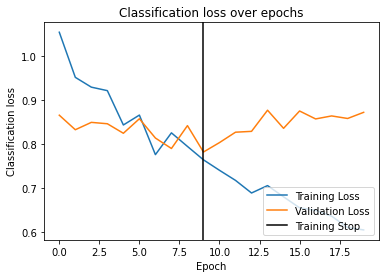

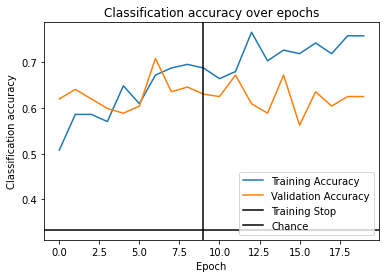

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.0062 - acc: 0.5859 - val_loss: 0.8053 - val_acc: 0.6042
Epoch 2/50 0.231s 	 loss: 0.9764 - acc: 0.5859 - val_loss: 0.8119 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.9220 - acc: 0.5938 - val_loss: 0.8898 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.8642 - acc: 0.6484 - val_loss: 0.9011 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.239s 	 loss: 0.8111 - acc: 0.6406 - val_loss: 0.8486 - val_acc: 0.6562
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.235s 	 loss: 0.8099 - acc: 0.6328 - val_loss: 0.8579 - val_acc: 0.6406
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.240s 	 loss: 0.8278 - acc: 0.6484 - val_loss: 0.8645 - val_acc: 0.6771
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.234s 	 loss: 0.7755 - acc: 0.6719 - val_loss: 0.9285 - val_acc: 0.5521
EarlyStopping counter: 7 out of 10
Epoch 9/5

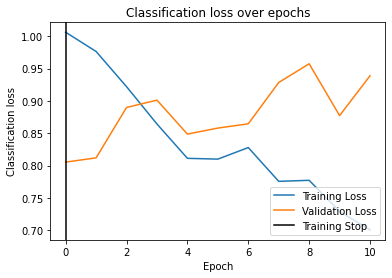

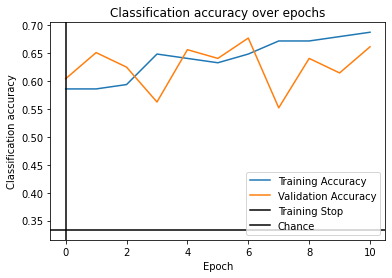

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8481 - acc: 0.5859 - val_loss: 1.0914 - val_acc: 0.4635
Epoch 2/50 0.233s 	 loss: 0.8039 - acc: 0.6172 - val_loss: 1.1331 - val_acc: 0.4635
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7565 - acc: 0.6797 - val_loss: 1.1240 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.7389 - acc: 0.6797 - val_loss: 1.1478 - val_acc: 0.5312
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.237s 	 loss: 0.7105 - acc: 0.7266 - val_loss: 1.1399 - val_acc: 0.4531
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.236s 	 loss: 0.7063 - acc: 0.6953 - val_loss: 1.1768 - val_acc: 0.5104
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.235s 	 loss: 0.6946 - acc: 0.7656 - val_loss: 1.1369 - val_acc: 0.5000
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.238s 	 loss: 0.6790 - acc: 0.7344 - val_loss: 1.2524 - val_acc: 0.4583
EarlyStopping counter: 7 out of 10
Epoch 9/5

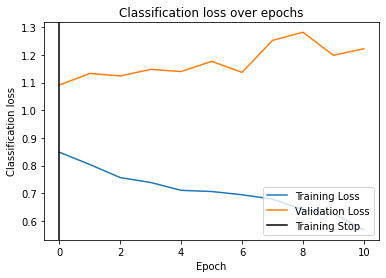

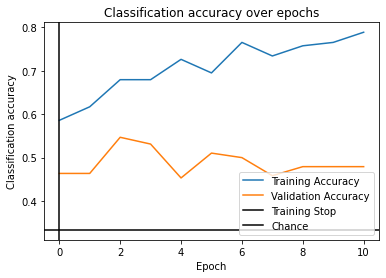

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8789 - acc: 0.5469 - val_loss: 0.6246 - val_acc: 0.7396
Epoch 2/50 0.238s 	 loss: 0.7846 - acc: 0.6328 - val_loss: 0.5811 - val_acc: 0.7708
Epoch 3/50 0.237s 	 loss: 0.7323 - acc: 0.6797 - val_loss: 0.5860 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7101 - acc: 0.6406 - val_loss: 0.5604 - val_acc: 0.7708
Epoch 5/50 0.233s 	 loss: 0.6700 - acc: 0.7031 - val_loss: 0.5316 - val_acc: 0.8333
Epoch 6/50 0.230s 	 loss: 0.5823 - acc: 0.7500 - val_loss: 0.5900 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.232s 	 loss: 0.5935 - acc: 0.7578 - val_loss: 0.5479 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.5719 - acc: 0.7812 - val_loss: 0.5557 - val_acc: 0.7552
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.237s 	 loss: 0.5681 - acc: 0.7891 - val_loss: 0.5504 - val_acc: 0.8021
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.237s 	 loss: 0.5627 - 

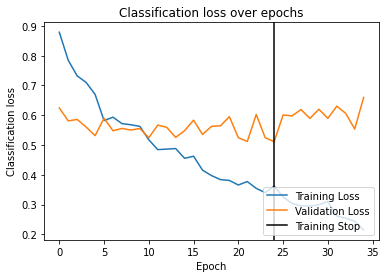

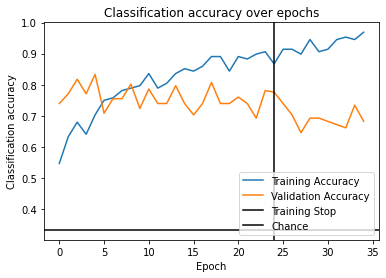

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8020 - acc: 0.6172 - val_loss: 0.7463 - val_acc: 0.7135
Epoch 2/50 0.234s 	 loss: 0.7473 - acc: 0.6328 - val_loss: 0.7348 - val_acc: 0.6979
Epoch 3/50 0.236s 	 loss: 0.6807 - acc: 0.6797 - val_loss: 0.6778 - val_acc: 0.7448
Epoch 4/50 0.235s 	 loss: 0.6396 - acc: 0.6953 - val_loss: 0.6903 - val_acc: 0.6979
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.5923 - acc: 0.8047 - val_loss: 0.6490 - val_acc: 0.7552
Epoch 6/50 0.234s 	 loss: 0.5520 - acc: 0.7812 - val_loss: 0.6915 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.5405 - acc: 0.7969 - val_loss: 0.6158 - val_acc: 0.7917
Epoch 8/50 0.240s 	 loss: 0.5027 - acc: 0.8438 - val_loss: 0.6160 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.4723 - acc: 0.8438 - val_loss: 0.6056 - val_acc: 0.6615
Epoch 10/50 0.235s 	 loss: 0.5073 - acc: 0.7969 - val_loss: 0.606

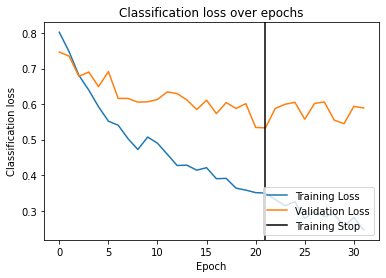

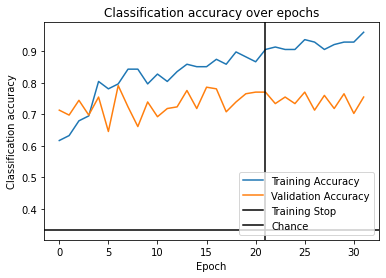

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.6672 - acc: 0.6875 - val_loss: 0.9701 - val_acc: 0.5469
Epoch 2/50 0.233s 	 loss: 0.6207 - acc: 0.7266 - val_loss: 0.9655 - val_acc: 0.4583
Epoch 3/50 0.235s 	 loss: 0.6119 - acc: 0.7188 - val_loss: 0.9316 - val_acc: 0.5521
Epoch 4/50 0.236s 	 loss: 0.5336 - acc: 0.8203 - val_loss: 0.8753 - val_acc: 0.4792
Epoch 5/50 0.234s 	 loss: 0.5332 - acc: 0.8047 - val_loss: 0.8165 - val_acc: 0.6094
Epoch 6/50 0.232s 	 loss: 0.5031 - acc: 0.7969 - val_loss: 0.8592 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.4618 - acc: 0.8906 - val_loss: 0.7728 - val_acc: 0.5990
Epoch 8/50 0.236s 	 loss: 0.4667 - acc: 0.8438 - val_loss: 0.7251 - val_acc: 0.6354
Epoch 9/50 0.233s 	 loss: 0.4407 - acc: 0.8906 - val_loss: 0.7559 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.239s 	 loss: 0.4362 - acc: 0.8672 - val_loss: 0.7634 - val_acc: 0.5885
EarlyStopping c

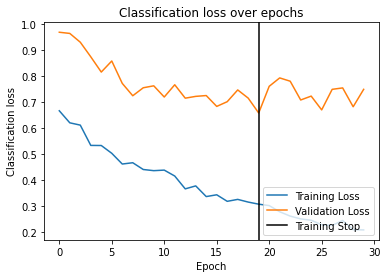

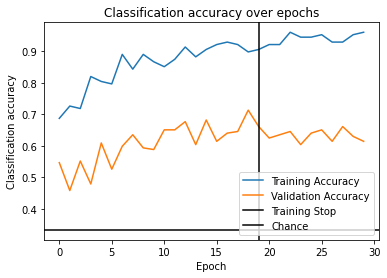

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9047 - acc: 0.5703 - val_loss: 1.0603 - val_acc: 0.4583
Epoch 2/50 0.237s 	 loss: 0.8925 - acc: 0.6016 - val_loss: 1.0587 - val_acc: 0.4635
Epoch 3/50 0.233s 	 loss: 0.8428 - acc: 0.6094 - val_loss: 1.1121 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.7740 - acc: 0.6484 - val_loss: 1.0525 - val_acc: 0.5469
Epoch 5/50 0.238s 	 loss: 0.7382 - acc: 0.6562 - val_loss: 1.1363 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.7106 - acc: 0.6875 - val_loss: 1.1331 - val_acc: 0.5312
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.241s 	 loss: 0.6945 - acc: 0.7031 - val_loss: 1.0877 - val_acc: 0.4948
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.7069 - acc: 0.6797 - val_loss: 1.1695 - val_acc: 0.5104
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.234s 	 loss: 0.6601 - acc: 0.7422 - val_loss: 1.1973 - val_acc: 0.

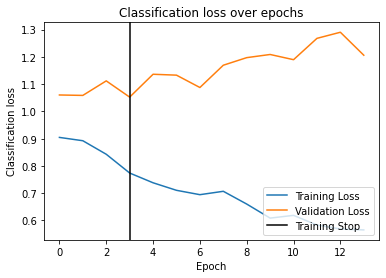

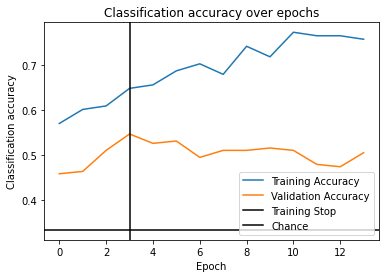

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 1.0248 - acc: 0.4922 - val_loss: 0.9301 - val_acc: 0.6510
Epoch 2/50 0.232s 	 loss: 0.9127 - acc: 0.5859 - val_loss: 0.9001 - val_acc: 0.6458
Epoch 3/50 0.234s 	 loss: 0.8705 - acc: 0.6016 - val_loss: 0.9209 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.8925 - acc: 0.6016 - val_loss: 0.8963 - val_acc: 0.6094
Epoch 5/50 0.230s 	 loss: 0.8551 - acc: 0.6172 - val_loss: 0.9108 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.8040 - acc: 0.6094 - val_loss: 0.9343 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.7815 - acc: 0.6406 - val_loss: 0.8526 - val_acc: 0.6198
Epoch 8/50 0.234s 	 loss: 0.8244 - acc: 0.6172 - val_loss: 0.9155 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.7939 - acc: 0.6484 - val_loss: 0.9219 - val_acc: 0.5885
EarlyStopping counter: 2 out o

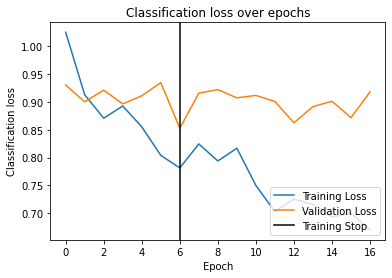

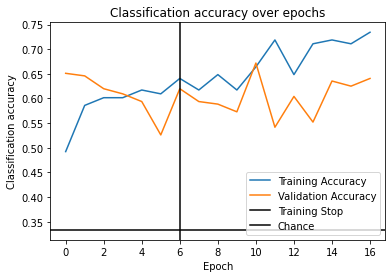

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0077 - acc: 0.5859 - val_loss: 0.9109 - val_acc: 0.5365
Epoch 2/50 0.239s 	 loss: 0.9436 - acc: 0.6016 - val_loss: 0.9403 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.9135 - acc: 0.6250 - val_loss: 0.9255 - val_acc: 0.5990
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.8966 - acc: 0.5938 - val_loss: 0.9124 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.240s 	 loss: 0.8521 - acc: 0.6250 - val_loss: 0.9559 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.237s 	 loss: 0.8245 - acc: 0.6484 - val_loss: 0.8841 - val_acc: 0.5885
Epoch 7/50 0.234s 	 loss: 0.8103 - acc: 0.6562 - val_loss: 0.9379 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.231s 	 loss: 0.7975 - acc: 0.6875 - val_loss: 0.9640 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.8250 - acc: 0.63

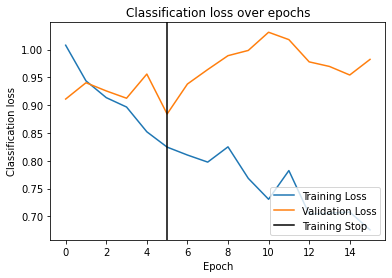

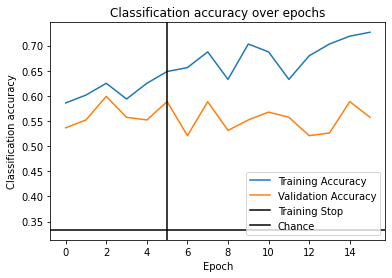

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.9835 - acc: 0.5469 - val_loss: 0.5817 - val_acc: 0.7917
Epoch 2/50 0.235s 	 loss: 0.8570 - acc: 0.5703 - val_loss: 0.5937 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.8383 - acc: 0.5469 - val_loss: 0.5845 - val_acc: 0.8177
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.8136 - acc: 0.6094 - val_loss: 0.5507 - val_acc: 0.8177
Epoch 5/50 0.237s 	 loss: 0.7178 - acc: 0.6953 - val_loss: 0.5734 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.7048 - acc: 0.6875 - val_loss: 0.5781 - val_acc: 0.8073
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.6495 - acc: 0.7344 - val_loss: 0.6137 - val_acc: 0.7708
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.234s 	 loss: 0.6203 - acc: 0.7500 - val_loss: 0.5774 - val_acc: 0.8125
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.243s 	 loss: 0.6420 - acc: 0.72

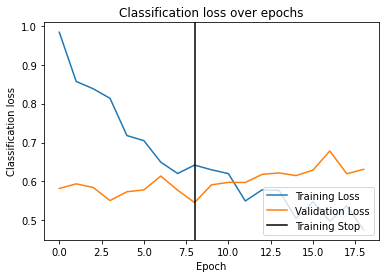

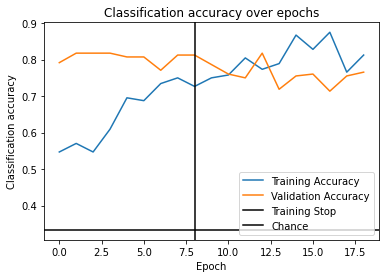

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8346 - acc: 0.5859 - val_loss: 0.9342 - val_acc: 0.5781
Epoch 2/50 0.239s 	 loss: 0.8064 - acc: 0.6328 - val_loss: 0.9627 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7165 - acc: 0.7344 - val_loss: 0.8070 - val_acc: 0.6302
Epoch 4/50 0.238s 	 loss: 0.7300 - acc: 0.6953 - val_loss: 0.8082 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.6581 - acc: 0.7578 - val_loss: 0.8183 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.6350 - acc: 0.7500 - val_loss: 0.8674 - val_acc: 0.5260
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.233s 	 loss: 0.6038 - acc: 0.7734 - val_loss: 0.8479 - val_acc: 0.5990
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.240s 	 loss: 0.6171 - acc: 0.7188 - val_loss: 0.8361 - val_acc: 0.5729
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.235s 	 loss: 0.5754 - acc: 0.77

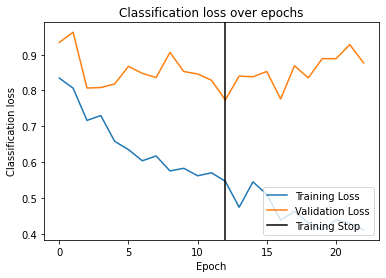

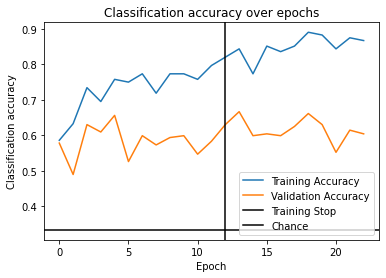

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.7406 - acc: 0.6953 - val_loss: 1.0640 - val_acc: 0.5156
Epoch 2/50 0.235s 	 loss: 0.6827 - acc: 0.7188 - val_loss: 1.0445 - val_acc: 0.5104
Epoch 3/50 0.231s 	 loss: 0.6234 - acc: 0.7656 - val_loss: 0.9627 - val_acc: 0.5885
Epoch 4/50 0.233s 	 loss: 0.5709 - acc: 0.7266 - val_loss: 0.9998 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.5366 - acc: 0.7891 - val_loss: 0.9692 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.5164 - acc: 0.8203 - val_loss: 1.0320 - val_acc: 0.6094
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.235s 	 loss: 0.4804 - acc: 0.8438 - val_loss: 0.9847 - val_acc: 0.6094
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.237s 	 loss: 0.4447 - acc: 0.8750 - val_loss: 1.1173 - val_acc: 0.5417
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.254s 	 loss: 0.4355 - acc: 0.8438 - val_loss: 0.9876 - val_acc: 0.

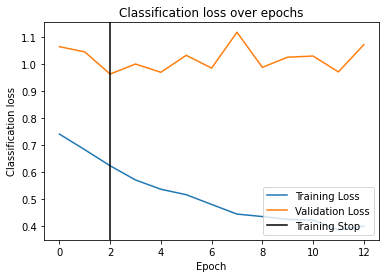

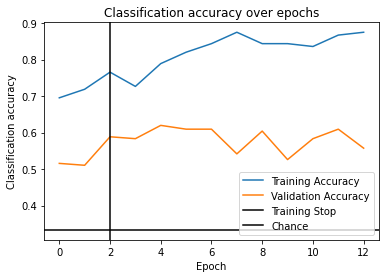

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.2323 - acc: 0.4688 - val_loss: 0.9114 - val_acc: 0.6354
Epoch 2/50 0.236s 	 loss: 1.1048 - acc: 0.4531 - val_loss: 0.9601 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.9540 - acc: 0.5938 - val_loss: 0.9575 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.9106 - acc: 0.6094 - val_loss: 1.0141 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.232s 	 loss: 0.8565 - acc: 0.6484 - val_loss: 0.9540 - val_acc: 0.5729
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.236s 	 loss: 0.8354 - acc: 0.6172 - val_loss: 1.0723 - val_acc: 0.5938
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.238s 	 loss: 0.7949 - acc: 0.6562 - val_loss: 0.9896 - val_acc: 0.5885
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.238s 	 loss: 0.7754 - acc: 0.6641 - val_loss: 0.9335 - val_acc: 0.6094
EarlyStopping counter: 7 out of 10
Epoch 9/5

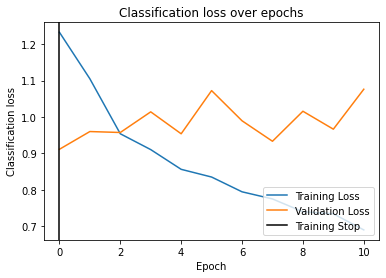

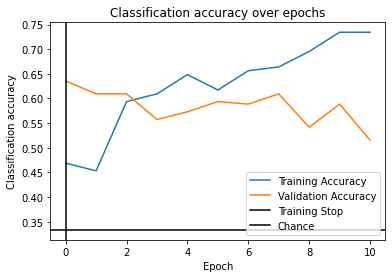

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9637 - acc: 0.6094 - val_loss: 1.4462 - val_acc: 0.4271
Epoch 2/50 0.233s 	 loss: 0.8661 - acc: 0.5781 - val_loss: 1.3295 - val_acc: 0.4531
Epoch 3/50 0.236s 	 loss: 0.8224 - acc: 0.6484 - val_loss: 1.4106 - val_acc: 0.3542
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.7874 - acc: 0.6250 - val_loss: 1.3208 - val_acc: 0.3542
Epoch 5/50 0.238s 	 loss: 0.7395 - acc: 0.6797 - val_loss: 1.3081 - val_acc: 0.3750
Epoch 6/50 0.233s 	 loss: 0.7025 - acc: 0.6641 - val_loss: 1.2655 - val_acc: 0.4062
Epoch 7/50 0.235s 	 loss: 0.6424 - acc: 0.7656 - val_loss: 1.2792 - val_acc: 0.3750
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.6581 - acc: 0.7422 - val_loss: 1.2816 - val_acc: 0.3021
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.6188 - acc: 0.7500 - val_loss: 1.3392 - val_acc: 0.4375
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

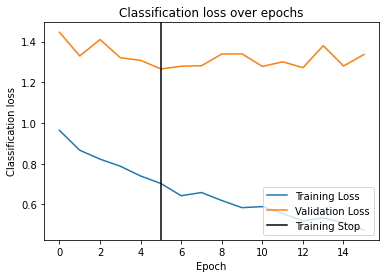

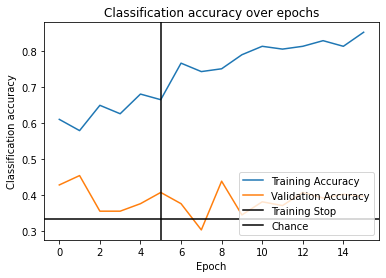

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 1.1589 - acc: 0.5391 - val_loss: 1.0332 - val_acc: 0.4844
Epoch 2/50 0.239s 	 loss: 1.0496 - acc: 0.5625 - val_loss: 0.8976 - val_acc: 0.6354
Epoch 3/50 0.233s 	 loss: 0.9697 - acc: 0.5859 - val_loss: 0.9068 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.8797 - acc: 0.6016 - val_loss: 0.8923 - val_acc: 0.5729
Epoch 5/50 0.234s 	 loss: 0.9059 - acc: 0.5469 - val_loss: 0.8697 - val_acc: 0.6146
Epoch 6/50 0.236s 	 loss: 0.8633 - acc: 0.6094 - val_loss: 0.8786 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.8104 - acc: 0.6484 - val_loss: 0.7978 - val_acc: 0.6406
Epoch 8/50 0.235s 	 loss: 0.7552 - acc: 0.6641 - val_loss: 0.8275 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.7454 - acc: 0.6641 - val_loss: 0.9874 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.235s 	 loss: 0.7

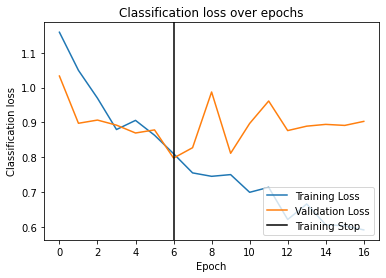

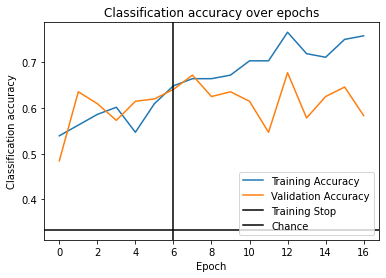

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8423 - acc: 0.5938 - val_loss: 0.9078 - val_acc: 0.5521
Epoch 2/50 0.236s 	 loss: 0.8178 - acc: 0.6016 - val_loss: 0.8707 - val_acc: 0.5938
Epoch 3/50 0.237s 	 loss: 0.7487 - acc: 0.6641 - val_loss: 0.8376 - val_acc: 0.6146
Epoch 4/50 0.237s 	 loss: 0.7079 - acc: 0.6562 - val_loss: 0.8659 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.6978 - acc: 0.7266 - val_loss: 0.8419 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.6820 - acc: 0.7422 - val_loss: 0.7913 - val_acc: 0.6979
Epoch 7/50 0.233s 	 loss: 0.6618 - acc: 0.7500 - val_loss: 0.8584 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.6061 - acc: 0.7656 - val_loss: 0.8331 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.6552 - acc: 0.7500 - val_loss: 0.8357 - val_acc: 0.6146
EarlyStopping counter: 3 out o

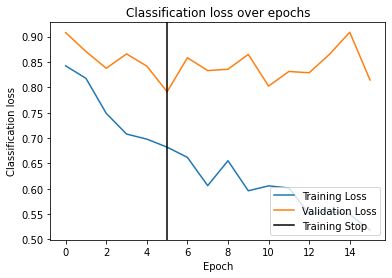

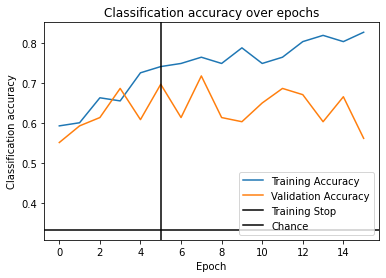

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8488 - acc: 0.5703 - val_loss: 0.9568 - val_acc: 0.5677
Epoch 2/50 0.236s 	 loss: 0.7550 - acc: 0.6406 - val_loss: 0.9623 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.7474 - acc: 0.6719 - val_loss: 0.9645 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.7113 - acc: 0.6797 - val_loss: 0.9983 - val_acc: 0.4740
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.6802 - acc: 0.6875 - val_loss: 0.9349 - val_acc: 0.5573
Epoch 6/50 0.232s 	 loss: 0.6780 - acc: 0.7031 - val_loss: 0.9202 - val_acc: 0.5885
Epoch 7/50 0.236s 	 loss: 0.6719 - acc: 0.7188 - val_loss: 0.9161 - val_acc: 0.6615
Epoch 8/50 0.235s 	 loss: 0.6346 - acc: 0.7422 - val_loss: 0.9106 - val_acc: 0.5417
Epoch 9/50 0.241s 	 loss: 0.5591 - acc: 0.7734 - val_loss: 0.9068 - val_acc: 0.6719
Epoch 10/50 0.230s 	 loss: 0.5716 - acc: 0.8203 - val_loss: 0.920

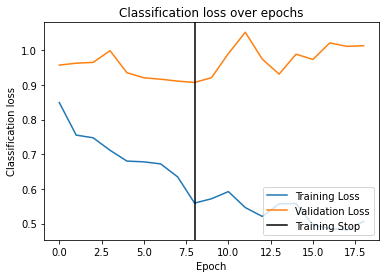

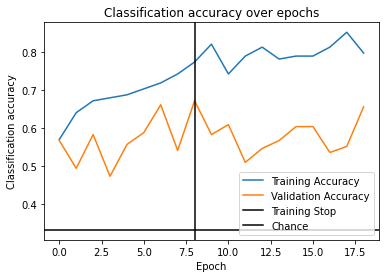

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9501 - acc: 0.5703 - val_loss: 0.6801 - val_acc: 0.7083
Epoch 2/50 0.232s 	 loss: 0.8900 - acc: 0.5703 - val_loss: 0.6754 - val_acc: 0.6927
Epoch 3/50 0.232s 	 loss: 0.8256 - acc: 0.5938 - val_loss: 0.6914 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.7766 - acc: 0.6016 - val_loss: 0.6721 - val_acc: 0.7760
Epoch 5/50 0.240s 	 loss: 0.7653 - acc: 0.6406 - val_loss: 0.7191 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.7397 - acc: 0.6484 - val_loss: 0.7118 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.238s 	 loss: 0.6930 - acc: 0.7344 - val_loss: 0.6272 - val_acc: 0.7500
Epoch 8/50 0.236s 	 loss: 0.6935 - acc: 0.7344 - val_loss: 0.6730 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.6603 - acc: 0.7422 - val_loss: 0.6923 - val_acc: 0.7240
EarlyStopping counter: 2 out o

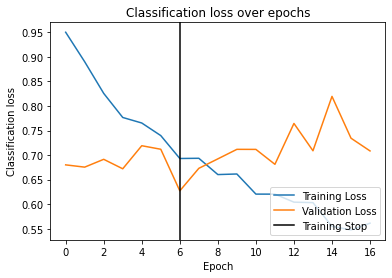

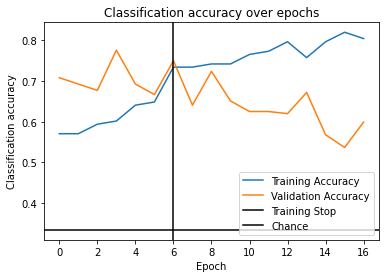

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.7839 - acc: 0.6797 - val_loss: 0.6535 - val_acc: 0.7760
Epoch 2/50 0.232s 	 loss: 0.6940 - acc: 0.7031 - val_loss: 0.6660 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.6599 - acc: 0.7188 - val_loss: 0.6515 - val_acc: 0.7396
Epoch 4/50 0.232s 	 loss: 0.6227 - acc: 0.7734 - val_loss: 0.6409 - val_acc: 0.7083
Epoch 5/50 0.238s 	 loss: 0.5850 - acc: 0.7734 - val_loss: 0.6133 - val_acc: 0.7552
Epoch 6/50 0.234s 	 loss: 0.5581 - acc: 0.7578 - val_loss: 0.5708 - val_acc: 0.7708
Epoch 7/50 0.238s 	 loss: 0.5498 - acc: 0.7344 - val_loss: 0.6218 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.5326 - acc: 0.7500 - val_loss: 0.5709 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.4739 - acc: 0.8203 - val_loss: 0.5918 - val_acc: 0.7344
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.235s 	 loss: 0.4

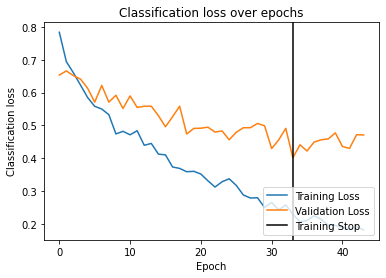

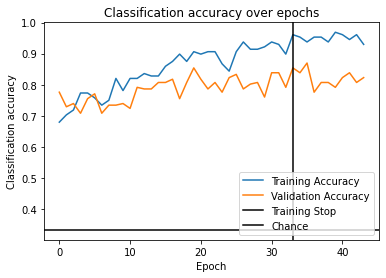

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7273 - acc: 0.6641 - val_loss: 0.8445 - val_acc: 0.5781
Epoch 2/50 0.238s 	 loss: 0.6290 - acc: 0.7344 - val_loss: 0.8340 - val_acc: 0.5521
Epoch 3/50 0.237s 	 loss: 0.6248 - acc: 0.7812 - val_loss: 0.7757 - val_acc: 0.6250
Epoch 4/50 0.234s 	 loss: 0.5788 - acc: 0.7500 - val_loss: 0.7476 - val_acc: 0.6562
Epoch 5/50 0.235s 	 loss: 0.5557 - acc: 0.7578 - val_loss: 0.7149 - val_acc: 0.6562
Epoch 6/50 0.238s 	 loss: 0.5217 - acc: 0.8047 - val_loss: 0.6924 - val_acc: 0.7031
Epoch 7/50 0.237s 	 loss: 0.5030 - acc: 0.8281 - val_loss: 0.6844 - val_acc: 0.6719
Epoch 8/50 0.239s 	 loss: 0.4956 - acc: 0.7969 - val_loss: 0.6868 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.4659 - acc: 0.8203 - val_loss: 0.6090 - val_acc: 0.7083
Epoch 10/50 0.233s 	 loss: 0.4467 - acc: 0.8594 - val_loss: 0.6976 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 11/50 0.2

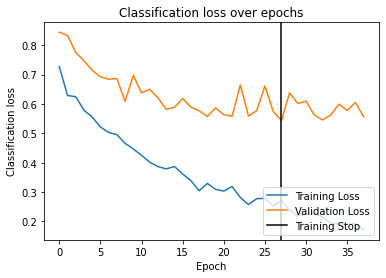

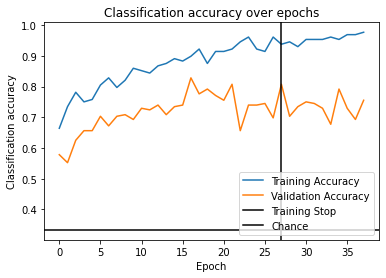

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.7514 - acc: 0.6328 - val_loss: 0.6771 - val_acc: 0.7396
Epoch 2/50 0.239s 	 loss: 0.6521 - acc: 0.7422 - val_loss: 0.7018 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.6501 - acc: 0.6875 - val_loss: 0.6925 - val_acc: 0.7083
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.239s 	 loss: 0.6006 - acc: 0.7734 - val_loss: 0.6619 - val_acc: 0.7031
Epoch 5/50 0.234s 	 loss: 0.5927 - acc: 0.7656 - val_loss: 0.6317 - val_acc: 0.7552
Epoch 6/50 0.236s 	 loss: 0.5311 - acc: 0.8516 - val_loss: 0.6808 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.4981 - acc: 0.8516 - val_loss: 0.6147 - val_acc: 0.7604
Epoch 8/50 0.235s 	 loss: 0.4509 - acc: 0.8359 - val_loss: 0.6139 - val_acc: 0.6927
Epoch 9/50 0.238s 	 loss: 0.4352 - acc: 0.8281 - val_loss: 0.6526 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.250s 	 loss: 0.4

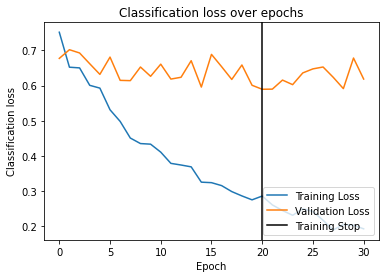

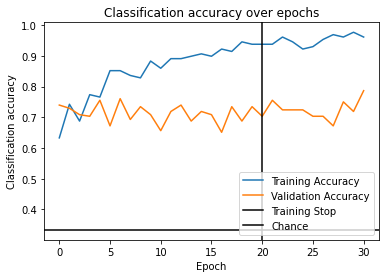

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.6038 - acc: 0.7734 - val_loss: 0.4771 - val_acc: 0.8125
Epoch 2/50 0.239s 	 loss: 0.5296 - acc: 0.8359 - val_loss: 0.3907 - val_acc: 0.8906
Epoch 3/50 0.234s 	 loss: 0.4805 - acc: 0.8203 - val_loss: 0.3641 - val_acc: 0.8906
Epoch 4/50 0.232s 	 loss: 0.4080 - acc: 0.8281 - val_loss: 0.3607 - val_acc: 0.9219
Epoch 5/50 0.236s 	 loss: 0.3875 - acc: 0.8672 - val_loss: 0.3305 - val_acc: 0.9375
Epoch 6/50 0.233s 	 loss: 0.3542 - acc: 0.8984 - val_loss: 0.3003 - val_acc: 0.9688
Epoch 7/50 0.235s 	 loss: 0.3255 - acc: 0.9219 - val_loss: 0.3004 - val_acc: 0.8750
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.232s 	 loss: 0.3246 - acc: 0.9375 - val_loss: 0.2889 - val_acc: 0.9219
Epoch 9/50 0.232s 	 loss: 0.2833 - acc: 0.9297 - val_loss: 0.2869 - val_acc: 0.8906
Epoch 10/50 0.238s 	 loss: 0.2808 - acc: 0.9141 - val_loss: 0.2552 - val_acc: 0.9375
Epoch 11/50 0.234s 	 loss: 0.2672 - acc: 0.9219 - 

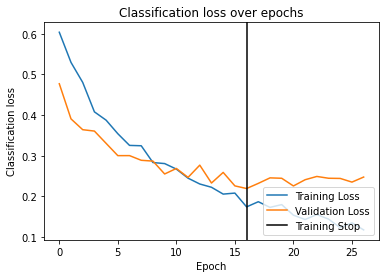

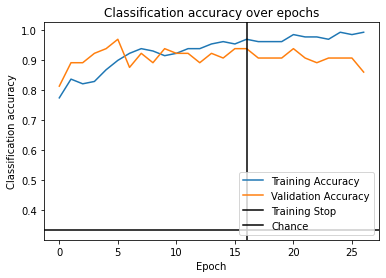

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.5399 - acc: 0.7891 - val_loss: 0.6091 - val_acc: 0.7760
Epoch 2/50 0.236s 	 loss: 0.4805 - acc: 0.8359 - val_loss: 0.5360 - val_acc: 0.8229
Epoch 3/50 0.236s 	 loss: 0.4132 - acc: 0.8828 - val_loss: 0.4595 - val_acc: 0.8490
Epoch 4/50 0.233s 	 loss: 0.3743 - acc: 0.9141 - val_loss: 0.4626 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.3553 - acc: 0.8984 - val_loss: 0.4020 - val_acc: 0.8646
Epoch 6/50 0.235s 	 loss: 0.3269 - acc: 0.9062 - val_loss: 0.3640 - val_acc: 0.8698
Epoch 7/50 0.243s 	 loss: 0.3060 - acc: 0.9141 - val_loss: 0.3710 - val_acc: 0.8698
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.2741 - acc: 0.9219 - val_loss: 0.3462 - val_acc: 0.8854
Epoch 9/50 0.237s 	 loss: 0.2665 - acc: 0.9375 - val_loss: 0.3718 - val_acc: 0.8698
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.246s 	 loss: 0.2553 - acc: 0.9219 - val_loss: 0.357

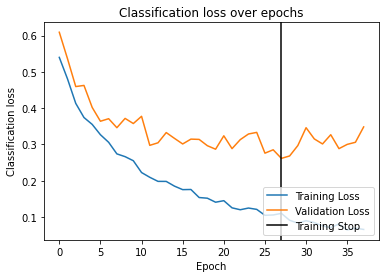

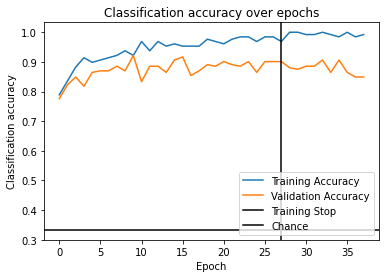

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.5245 - acc: 0.8281 - val_loss: 0.6529 - val_acc: 0.7031
Epoch 2/50 0.233s 	 loss: 0.4376 - acc: 0.8672 - val_loss: 0.5685 - val_acc: 0.7500
Epoch 3/50 0.238s 	 loss: 0.4070 - acc: 0.8594 - val_loss: 0.5118 - val_acc: 0.7969
Epoch 4/50 0.238s 	 loss: 0.3497 - acc: 0.8750 - val_loss: 0.4598 - val_acc: 0.8333
Epoch 5/50 0.237s 	 loss: 0.3276 - acc: 0.8906 - val_loss: 0.4277 - val_acc: 0.8333
Epoch 6/50 0.237s 	 loss: 0.3037 - acc: 0.9375 - val_loss: 0.4194 - val_acc: 0.8385
Epoch 7/50 0.240s 	 loss: 0.2617 - acc: 0.9766 - val_loss: 0.4157 - val_acc: 0.8333
Epoch 8/50 0.234s 	 loss: 0.2480 - acc: 0.9453 - val_loss: 0.4081 - val_acc: 0.8802
Epoch 9/50 0.236s 	 loss: 0.2381 - acc: 0.9531 - val_loss: 0.4045 - val_acc: 0.8854
Epoch 10/50 0.233s 	 loss: 0.2231 - acc: 0.9609 - val_loss: 0.3576 - val_acc: 0.8646
Epoch 11/50 0.236s 	 loss: 0.2178 - acc: 0.9609 - val_loss: 0.3575 - val_acc: 0.8854


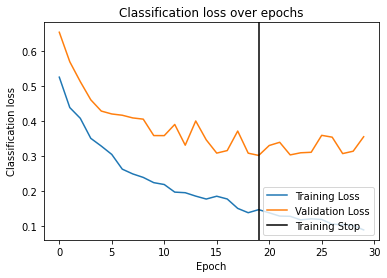

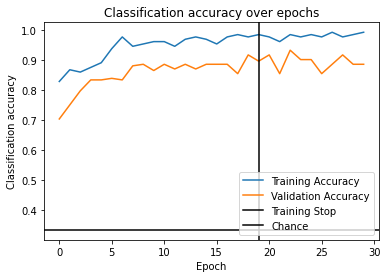

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5319 - acc: 0.8125 - val_loss: 0.6550 - val_acc: 0.7083
Epoch 2/50 0.238s 	 loss: 0.4850 - acc: 0.8359 - val_loss: 0.6574 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.238s 	 loss: 0.4253 - acc: 0.8828 - val_loss: 0.6179 - val_acc: 0.7448
Epoch 4/50 0.233s 	 loss: 0.4197 - acc: 0.8594 - val_loss: 0.6322 - val_acc: 0.6979
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.4087 - acc: 0.8750 - val_loss: 0.6053 - val_acc: 0.7656
Epoch 6/50 0.233s 	 loss: 0.3664 - acc: 0.9219 - val_loss: 0.6124 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.3494 - acc: 0.9062 - val_loss: 0.6289 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.3085 - acc: 0.9297 - val_loss: 0.6498 - val_acc: 0.7448
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.235s 	 loss: 0.3122 - acc: 0.9297 - val_loss: 0.6365 - val_acc: 0.

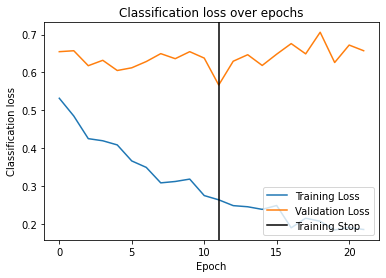

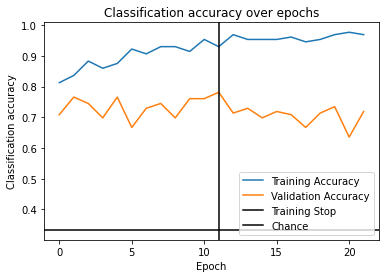

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.6071 - acc: 0.7500 - val_loss: 0.4953 - val_acc: 0.8594
Epoch 2/50 0.240s 	 loss: 0.5443 - acc: 0.8281 - val_loss: 0.4637 - val_acc: 0.8750
Epoch 3/50 0.242s 	 loss: 0.5194 - acc: 0.8438 - val_loss: 0.4382 - val_acc: 0.8906
Epoch 4/50 0.237s 	 loss: 0.5016 - acc: 0.8047 - val_loss: 0.4744 - val_acc: 0.8281
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.4709 - acc: 0.8594 - val_loss: 0.4869 - val_acc: 0.8750
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.4352 - acc: 0.8594 - val_loss: 0.4360 - val_acc: 0.8594
Epoch 7/50 0.234s 	 loss: 0.4130 - acc: 0.8438 - val_loss: 0.4527 - val_acc: 0.8594
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.4146 - acc: 0.8281 - val_loss: 0.4270 - val_acc: 0.8750
Epoch 9/50 0.235s 	 loss: 0.3986 - acc: 0.8672 - val_loss: 0.4302 - val_acc: 0.8438
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.3

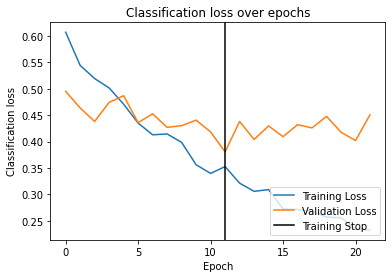

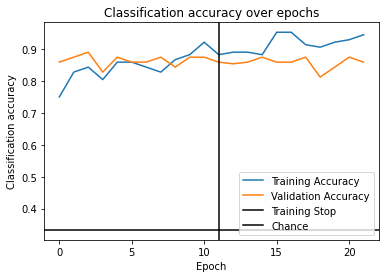

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.6383 - acc: 0.7656 - val_loss: 0.4973 - val_acc: 0.8177
Epoch 2/50 0.236s 	 loss: 0.5491 - acc: 0.7969 - val_loss: 0.4958 - val_acc: 0.8281
Epoch 3/50 0.234s 	 loss: 0.4936 - acc: 0.8516 - val_loss: 0.5222 - val_acc: 0.8438
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.242s 	 loss: 0.4905 - acc: 0.8359 - val_loss: 0.4852 - val_acc: 0.8594
Epoch 5/50 0.235s 	 loss: 0.4544 - acc: 0.8359 - val_loss: 0.4674 - val_acc: 0.7865
Epoch 6/50 0.236s 	 loss: 0.4535 - acc: 0.8594 - val_loss: 0.4993 - val_acc: 0.8594
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.4073 - acc: 0.8906 - val_loss: 0.4814 - val_acc: 0.8802
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.3933 - acc: 0.8750 - val_loss: 0.4987 - val_acc: 0.8438
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.239s 	 loss: 0.3815 - acc: 0.8828 - val_loss: 0.4675 - val_acc: 0.8802
EarlyStopping counter: 4 out o

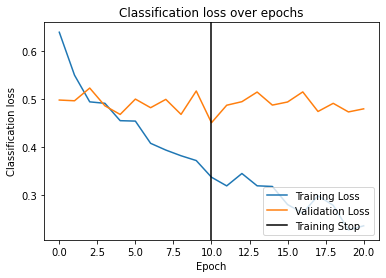

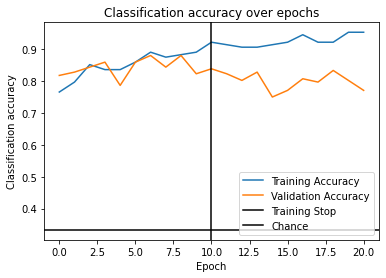

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.0912 - acc: 0.5156 - val_loss: 1.0581 - val_acc: 0.5208
Epoch 2/50 0.235s 	 loss: 1.0476 - acc: 0.5391 - val_loss: 0.9963 - val_acc: 0.5521
Epoch 3/50 0.239s 	 loss: 1.0251 - acc: 0.5156 - val_loss: 1.0440 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.9627 - acc: 0.5781 - val_loss: 0.9966 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.9514 - acc: 0.5859 - val_loss: 0.9865 - val_acc: 0.5625
Epoch 6/50 0.241s 	 loss: 0.9693 - acc: 0.5781 - val_loss: 1.0767 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.8815 - acc: 0.6094 - val_loss: 0.9363 - val_acc: 0.5833
Epoch 8/50 0.234s 	 loss: 0.8885 - acc: 0.6406 - val_loss: 0.9908 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.8565 - acc: 0.6406 - val_loss: 0.9330 - val_acc: 0.5521
Epoch 10/50 0.237s 	 loss: 0.8

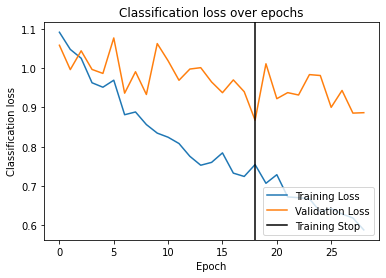

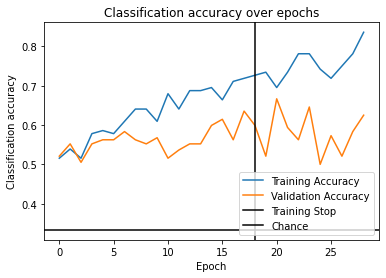

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 1.1137 - acc: 0.5156 - val_loss: 1.0816 - val_acc: 0.4792
Epoch 2/50 0.230s 	 loss: 1.0216 - acc: 0.5391 - val_loss: 1.0309 - val_acc: 0.5469
Epoch 3/50 0.235s 	 loss: 0.9797 - acc: 0.5703 - val_loss: 0.9876 - val_acc: 0.5156
Epoch 4/50 0.235s 	 loss: 0.9506 - acc: 0.5859 - val_loss: 1.0167 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.9217 - acc: 0.6172 - val_loss: 1.0287 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.239s 	 loss: 0.9014 - acc: 0.6094 - val_loss: 1.0346 - val_acc: 0.5885
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.8926 - acc: 0.6250 - val_loss: 1.0604 - val_acc: 0.5052
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.240s 	 loss: 0.8631 - acc: 0.6328 - val_loss: 1.0127 - val_acc: 0.5260
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.239s 	 loss: 0.8378 - acc: 0.6562 - val_loss: 1.0057 - val_acc: 0.

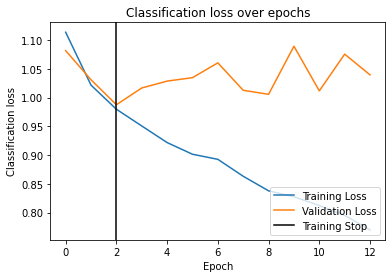

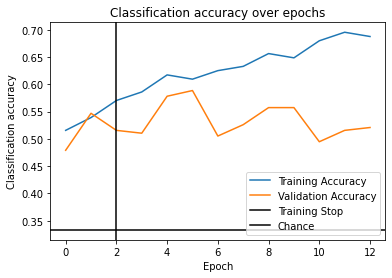

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0685 - acc: 0.5703 - val_loss: 1.1461 - val_acc: 0.5156
Epoch 2/50 0.235s 	 loss: 0.9573 - acc: 0.5703 - val_loss: 1.0954 - val_acc: 0.5365
Epoch 3/50 0.236s 	 loss: 0.9857 - acc: 0.5156 - val_loss: 1.1192 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.9618 - acc: 0.5547 - val_loss: 1.0509 - val_acc: 0.5260
Epoch 5/50 0.232s 	 loss: 0.8878 - acc: 0.6328 - val_loss: 1.1205 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.231s 	 loss: 0.8451 - acc: 0.5859 - val_loss: 1.0485 - val_acc: 0.5417
Epoch 7/50 0.241s 	 loss: 0.8387 - acc: 0.6016 - val_loss: 1.0359 - val_acc: 0.5000
Epoch 8/50 0.234s 	 loss: 0.8408 - acc: 0.6484 - val_loss: 1.0774 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.8325 - acc: 0.6250 - val_loss: 1.0903 - val_acc: 0.5000
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.234s 	 loss: 0.8

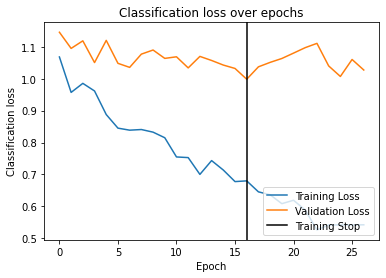

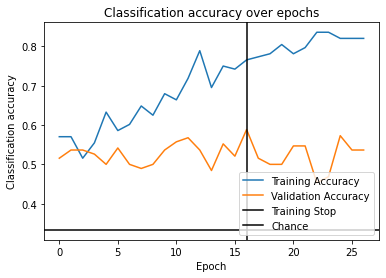

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7726 - acc: 0.6406 - val_loss: 0.9633 - val_acc: 0.4896
Epoch 2/50 0.235s 	 loss: 0.7372 - acc: 0.6797 - val_loss: 0.8860 - val_acc: 0.5208
Epoch 3/50 0.233s 	 loss: 0.6905 - acc: 0.7266 - val_loss: 0.9142 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.5762 - acc: 0.7578 - val_loss: 0.7701 - val_acc: 0.5990
Epoch 5/50 0.234s 	 loss: 0.5713 - acc: 0.7422 - val_loss: 0.7944 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.5102 - acc: 0.7969 - val_loss: 0.8291 - val_acc: 0.5990
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.243s 	 loss: 0.4765 - acc: 0.8047 - val_loss: 0.7746 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.4166 - acc: 0.8750 - val_loss: 0.7386 - val_acc: 0.6302
Epoch 9/50 0.237s 	 loss: 0.4081 - acc: 0.8281 - val_loss: 0.8149 - val_acc: 0.6615
EarlyStopping counter: 1 out o

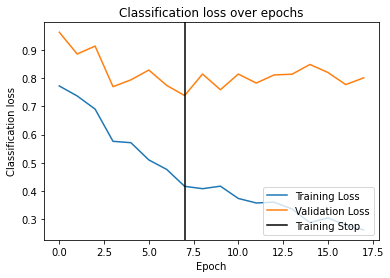

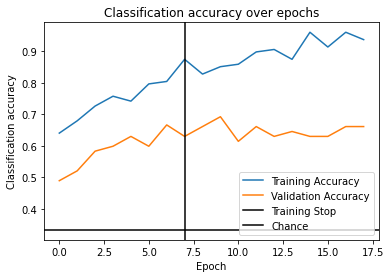

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8836 - acc: 0.5547 - val_loss: 0.7922 - val_acc: 0.6667
Epoch 2/50 0.238s 	 loss: 0.8041 - acc: 0.6094 - val_loss: 0.7340 - val_acc: 0.6771
Epoch 3/50 0.234s 	 loss: 0.7379 - acc: 0.6484 - val_loss: 0.6862 - val_acc: 0.6615
Epoch 4/50 0.235s 	 loss: 0.7020 - acc: 0.6562 - val_loss: 0.6784 - val_acc: 0.7031
Epoch 5/50 0.236s 	 loss: 0.5958 - acc: 0.7578 - val_loss: 0.6534 - val_acc: 0.7083
Epoch 6/50 0.239s 	 loss: 0.5688 - acc: 0.7969 - val_loss: 0.6643 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.5671 - acc: 0.7656 - val_loss: 0.5912 - val_acc: 0.7396
Epoch 8/50 0.232s 	 loss: 0.4858 - acc: 0.8359 - val_loss: 0.6225 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.231s 	 loss: 0.4959 - acc: 0.8047 - val_loss: 0.5886 - val_acc: 0.7552
Epoch 10/50 0.235s 	 loss: 0.4355 - acc: 0.8750 - val_loss: 0.5775 - val_acc: 0.8177
Epoch 11/50 0.2

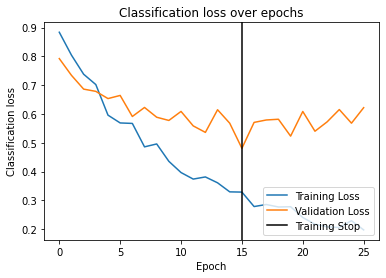

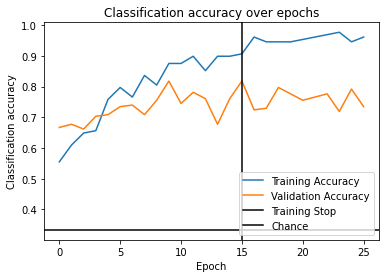

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8612 - acc: 0.6172 - val_loss: 0.7677 - val_acc: 0.6458
Epoch 2/50 0.234s 	 loss: 0.7997 - acc: 0.5938 - val_loss: 0.7217 - val_acc: 0.6823
Epoch 3/50 0.232s 	 loss: 0.7065 - acc: 0.6641 - val_loss: 0.7317 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.6642 - acc: 0.7422 - val_loss: 0.7369 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.6238 - acc: 0.7266 - val_loss: 0.7164 - val_acc: 0.6458
Epoch 6/50 0.236s 	 loss: 0.5349 - acc: 0.7812 - val_loss: 0.7798 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.5301 - acc: 0.8125 - val_loss: 0.7146 - val_acc: 0.6771
Epoch 8/50 0.236s 	 loss: 0.4990 - acc: 0.8516 - val_loss: 0.6127 - val_acc: 0.6719
Epoch 9/50 0.235s 	 loss: 0.4857 - acc: 0.8047 - val_loss: 0.6245 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.241s 	 loss: 0.4

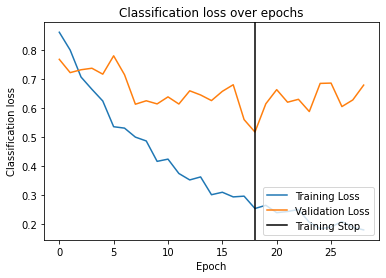

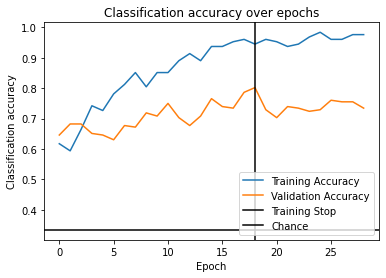

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8368 - acc: 0.6250 - val_loss: 0.7963 - val_acc: 0.6198
Epoch 2/50 0.236s 	 loss: 0.8332 - acc: 0.6094 - val_loss: 0.7365 - val_acc: 0.7396
Epoch 3/50 0.236s 	 loss: 0.7772 - acc: 0.6641 - val_loss: 0.6909 - val_acc: 0.7083
Epoch 4/50 0.232s 	 loss: 0.7483 - acc: 0.6641 - val_loss: 0.7585 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7622 - acc: 0.6484 - val_loss: 0.6991 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.7039 - acc: 0.7109 - val_loss: 0.6715 - val_acc: 0.7344
Epoch 7/50 0.237s 	 loss: 0.6821 - acc: 0.7109 - val_loss: 0.6795 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.6736 - acc: 0.7031 - val_loss: 0.6580 - val_acc: 0.7969
Epoch 9/50 0.236s 	 loss: 0.6217 - acc: 0.7344 - val_loss: 0.6986 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.6

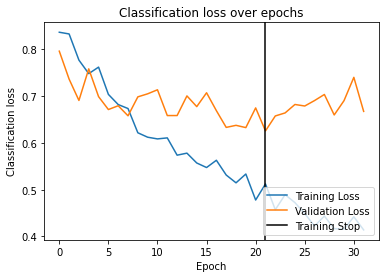

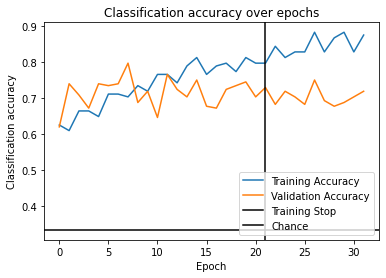

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8238 - acc: 0.6797 - val_loss: 0.7416 - val_acc: 0.6354
Epoch 2/50 0.233s 	 loss: 0.8118 - acc: 0.6250 - val_loss: 0.7628 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.245s 	 loss: 0.7649 - acc: 0.6641 - val_loss: 0.7706 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.7993 - acc: 0.6094 - val_loss: 0.7217 - val_acc: 0.6510
Epoch 5/50 0.234s 	 loss: 0.7605 - acc: 0.6172 - val_loss: 0.7680 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.7165 - acc: 0.7266 - val_loss: 0.7036 - val_acc: 0.6823
Epoch 7/50 0.233s 	 loss: 0.7054 - acc: 0.7188 - val_loss: 0.6836 - val_acc: 0.6979
Epoch 8/50 0.234s 	 loss: 0.6534 - acc: 0.7578 - val_loss: 0.6282 - val_acc: 0.8073
Epoch 9/50 0.242s 	 loss: 0.6761 - acc: 0.7188 - val_loss: 0.6884 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.6

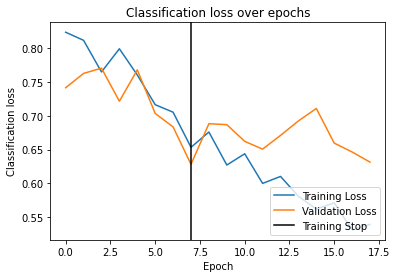

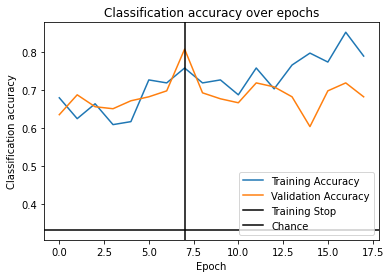

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.7532 - acc: 0.6797 - val_loss: 0.8660 - val_acc: 0.5833
Epoch 2/50 0.234s 	 loss: 0.7182 - acc: 0.7188 - val_loss: 0.8568 - val_acc: 0.5990
Epoch 3/50 0.241s 	 loss: 0.7054 - acc: 0.7500 - val_loss: 0.8471 - val_acc: 0.6198
Epoch 4/50 0.234s 	 loss: 0.7007 - acc: 0.7344 - val_loss: 0.8003 - val_acc: 0.6042
Epoch 5/50 0.239s 	 loss: 0.6633 - acc: 0.6953 - val_loss: 0.8641 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.5972 - acc: 0.7812 - val_loss: 0.8774 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.5931 - acc: 0.7891 - val_loss: 0.8406 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.234s 	 loss: 0.5838 - acc: 0.8125 - val_loss: 0.9738 - val_acc: 0.5729
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.233s 	 loss: 0.5719 - acc: 0.7734 - val_loss: 0.8964 - val_acc: 0.5521
EarlyStopping counter: 5 out o

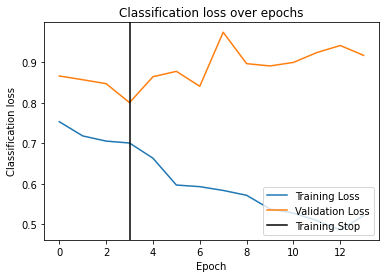

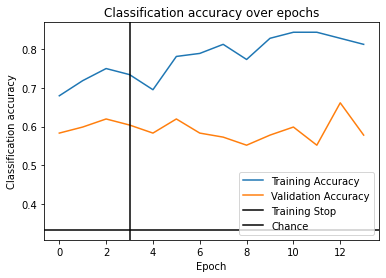

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8017 - acc: 0.6250 - val_loss: 1.0751 - val_acc: 0.4844
Epoch 2/50 0.240s 	 loss: 0.7259 - acc: 0.6953 - val_loss: 0.8968 - val_acc: 0.6094
Epoch 3/50 0.234s 	 loss: 0.7001 - acc: 0.6875 - val_loss: 0.9742 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.243s 	 loss: 0.6564 - acc: 0.6562 - val_loss: 0.8912 - val_acc: 0.5833
Epoch 5/50 0.235s 	 loss: 0.6323 - acc: 0.7266 - val_loss: 0.9241 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6275 - acc: 0.7344 - val_loss: 0.9353 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.5864 - acc: 0.7422 - val_loss: 0.9066 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.233s 	 loss: 0.5049 - acc: 0.8281 - val_loss: 0.8370 - val_acc: 0.5781
Epoch 9/50 0.239s 	 loss: 0.5014 - acc: 0.8203 - val_loss: 0.8723 - val_acc: 0.5833
EarlyStopping counter: 1 out o

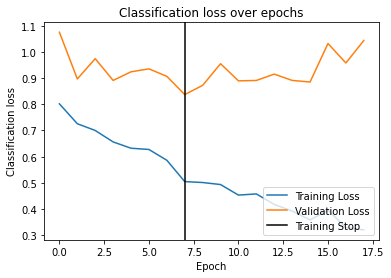

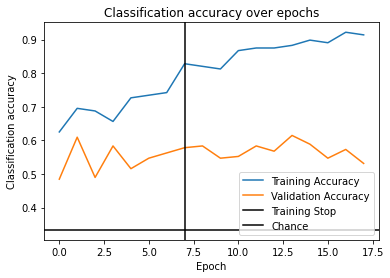

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9730 - acc: 0.5469 - val_loss: 0.7322 - val_acc: 0.6667
Epoch 2/50 0.234s 	 loss: 0.8241 - acc: 0.5938 - val_loss: 0.7103 - val_acc: 0.6146
Epoch 3/50 0.235s 	 loss: 0.7952 - acc: 0.6016 - val_loss: 0.7003 - val_acc: 0.5885
Epoch 4/50 0.237s 	 loss: 0.7850 - acc: 0.6172 - val_loss: 0.7223 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.6839 - acc: 0.6953 - val_loss: 0.7327 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.6818 - acc: 0.7031 - val_loss: 0.7069 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.6677 - acc: 0.6953 - val_loss: 0.7002 - val_acc: 0.5781
Epoch 8/50 0.234s 	 loss: 0.6273 - acc: 0.7109 - val_loss: 0.6314 - val_acc: 0.7604
Epoch 9/50 0.233s 	 loss: 0.5949 - acc: 0.7656 - val_loss: 0.7619 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.6

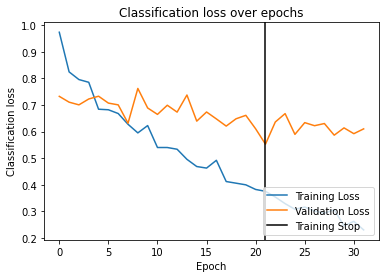

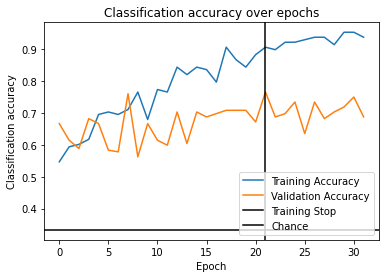

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.8254 - acc: 0.5781 - val_loss: 0.9046 - val_acc: 0.5729
Epoch 2/50 0.235s 	 loss: 0.8230 - acc: 0.6328 - val_loss: 0.8298 - val_acc: 0.6146
Epoch 3/50 0.240s 	 loss: 0.7511 - acc: 0.6094 - val_loss: 0.7529 - val_acc: 0.6823
Epoch 4/50 0.232s 	 loss: 0.7000 - acc: 0.6719 - val_loss: 0.8463 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.6805 - acc: 0.6719 - val_loss: 0.7810 - val_acc: 0.7083
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.6325 - acc: 0.6719 - val_loss: 0.7410 - val_acc: 0.6771
Epoch 7/50 0.235s 	 loss: 0.6293 - acc: 0.7031 - val_loss: 0.7944 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.5212 - acc: 0.7812 - val_loss: 0.8050 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.5448 - acc: 0.7734 - val_loss: 0.7991 - val_acc: 0.6042
EarlyStopping counter: 3 out o

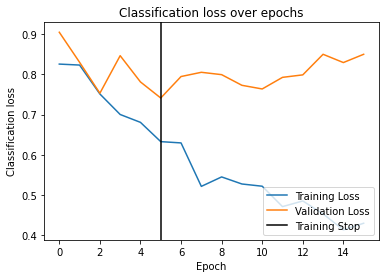

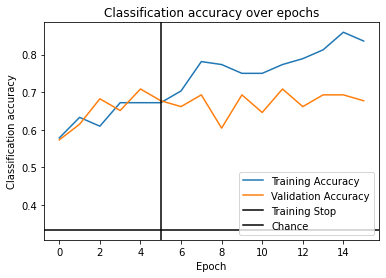

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.9882 - acc: 0.5312 - val_loss: 0.7247 - val_acc: 0.6510
Epoch 2/50 0.235s 	 loss: 0.8932 - acc: 0.5703 - val_loss: 0.6794 - val_acc: 0.7240
Epoch 3/50 0.235s 	 loss: 0.8119 - acc: 0.6562 - val_loss: 0.6648 - val_acc: 0.6354
Epoch 4/50 0.233s 	 loss: 0.8309 - acc: 0.6094 - val_loss: 0.6896 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.8081 - acc: 0.6562 - val_loss: 0.6615 - val_acc: 0.6562
Epoch 6/50 0.235s 	 loss: 0.7683 - acc: 0.7031 - val_loss: 0.6811 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.7279 - acc: 0.6953 - val_loss: 0.7125 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.232s 	 loss: 0.6924 - acc: 0.6875 - val_loss: 0.6542 - val_acc: 0.7031
Epoch 9/50 0.237s 	 loss: 0.6861 - acc: 0.7188 - val_loss: 0.6981 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.6

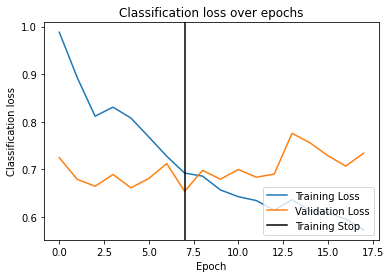

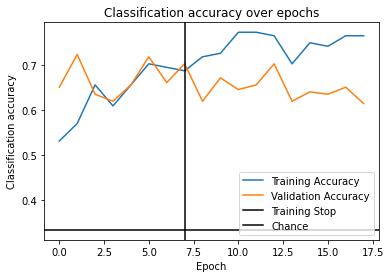

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7883 - acc: 0.6328 - val_loss: 1.1072 - val_acc: 0.4479
Epoch 2/50 0.240s 	 loss: 0.7564 - acc: 0.6328 - val_loss: 1.1183 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.240s 	 loss: 0.6580 - acc: 0.7266 - val_loss: 1.1091 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.6233 - acc: 0.7266 - val_loss: 1.0960 - val_acc: 0.4479
Epoch 5/50 0.233s 	 loss: 0.6239 - acc: 0.7109 - val_loss: 1.1287 - val_acc: 0.4219
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.240s 	 loss: 0.5774 - acc: 0.7578 - val_loss: 1.1645 - val_acc: 0.4531
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.240s 	 loss: 0.5690 - acc: 0.7344 - val_loss: 1.0742 - val_acc: 0.5000
Epoch 8/50 0.234s 	 loss: 0.5402 - acc: 0.7344 - val_loss: 1.0542 - val_acc: 0.5104
Epoch 9/50 0.235s 	 loss: 0.5347 - acc: 0.7188 - val_loss: 1.1475 - val_acc: 0.5260
EarlyStopping counter: 1 out o

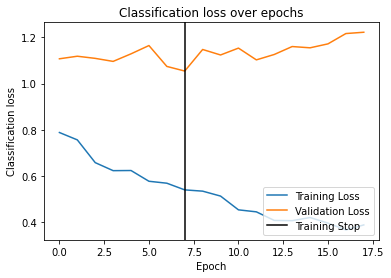

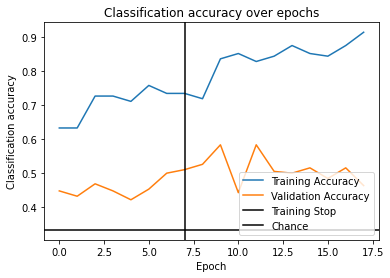

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8910 - acc: 0.5234 - val_loss: 0.9936 - val_acc: 0.5573
Epoch 2/50 0.235s 	 loss: 0.8382 - acc: 0.6094 - val_loss: 0.9202 - val_acc: 0.5885
Epoch 3/50 0.236s 	 loss: 0.7974 - acc: 0.5938 - val_loss: 0.8844 - val_acc: 0.5885
Epoch 4/50 0.235s 	 loss: 0.7135 - acc: 0.7031 - val_loss: 0.8274 - val_acc: 0.6458
Epoch 5/50 0.234s 	 loss: 0.6924 - acc: 0.7266 - val_loss: 0.8869 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6669 - acc: 0.7734 - val_loss: 0.9658 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.240s 	 loss: 0.6906 - acc: 0.7422 - val_loss: 0.8698 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.239s 	 loss: 0.6668 - acc: 0.7266 - val_loss: 0.8852 - val_acc: 0.6354
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.237s 	 loss: 0.6469 - acc: 0.7266 - val_loss: 0.8799 - val_acc: 0.6146
EarlyStopping counter: 5 out o

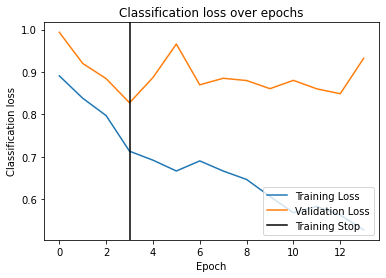

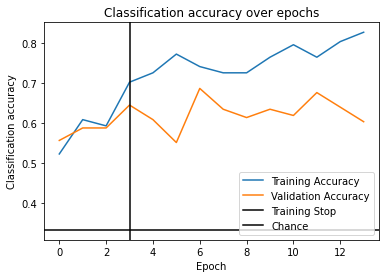

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.6883 - acc: 0.7344 - val_loss: 1.0405 - val_acc: 0.5781
Epoch 2/50 0.236s 	 loss: 0.5931 - acc: 0.7812 - val_loss: 0.9476 - val_acc: 0.6354
Epoch 3/50 0.234s 	 loss: 0.5740 - acc: 0.7500 - val_loss: 0.8480 - val_acc: 0.6146
Epoch 4/50 0.232s 	 loss: 0.5226 - acc: 0.8203 - val_loss: 0.8284 - val_acc: 0.6250
Epoch 5/50 0.234s 	 loss: 0.4922 - acc: 0.7734 - val_loss: 0.8018 - val_acc: 0.6510
Epoch 6/50 0.244s 	 loss: 0.4297 - acc: 0.8438 - val_loss: 0.8050 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.4195 - acc: 0.8516 - val_loss: 0.8387 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.4297 - acc: 0.8359 - val_loss: 0.7472 - val_acc: 0.7135
Epoch 9/50 0.233s 	 loss: 0.3994 - acc: 0.8359 - val_loss: 0.8376 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.233s 	 loss: 0.3742 - acc: 0.8672 - val_loss: 0.821

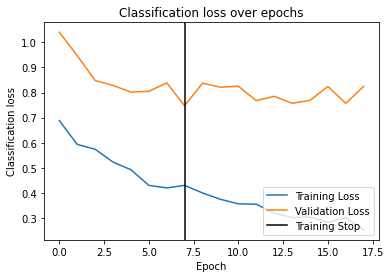

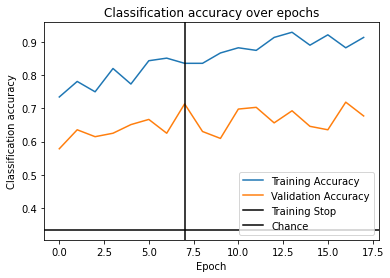

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.8951 - acc: 0.6406 - val_loss: 0.6374 - val_acc: 0.7812
Epoch 2/50 0.235s 	 loss: 0.7614 - acc: 0.6953 - val_loss: 0.5805 - val_acc: 0.7812
Epoch 3/50 0.244s 	 loss: 0.7174 - acc: 0.6797 - val_loss: 0.5648 - val_acc: 0.7344
Epoch 4/50 0.233s 	 loss: 0.6616 - acc: 0.6875 - val_loss: 0.5488 - val_acc: 0.7292
Epoch 5/50 0.242s 	 loss: 0.5882 - acc: 0.7344 - val_loss: 0.5507 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.5434 - acc: 0.7734 - val_loss: 0.5495 - val_acc: 0.7812
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.5246 - acc: 0.7500 - val_loss: 0.4822 - val_acc: 0.8125
Epoch 8/50 0.232s 	 loss: 0.4878 - acc: 0.7578 - val_loss: 0.5426 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.4719 - acc: 0.8047 - val_loss: 0.5255 - val_acc: 0.7708
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.235s 	 loss: 0.4

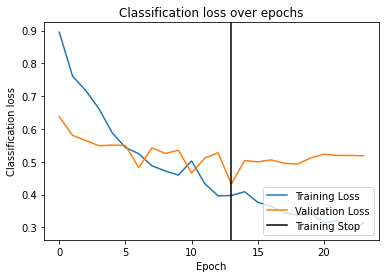

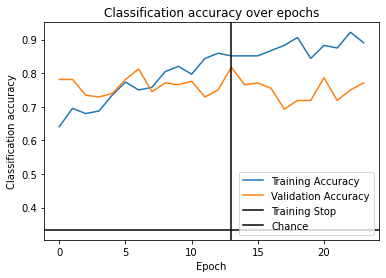

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8254 - acc: 0.6562 - val_loss: 0.7895 - val_acc: 0.6875
Epoch 2/50 0.233s 	 loss: 0.6782 - acc: 0.7031 - val_loss: 0.7186 - val_acc: 0.6719
Epoch 3/50 0.239s 	 loss: 0.6274 - acc: 0.7266 - val_loss: 0.7056 - val_acc: 0.6823
Epoch 4/50 0.234s 	 loss: 0.5372 - acc: 0.7812 - val_loss: 0.6539 - val_acc: 0.6719
Epoch 5/50 0.235s 	 loss: 0.5542 - acc: 0.7656 - val_loss: 0.6699 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.5105 - acc: 0.7734 - val_loss: 0.6986 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.4489 - acc: 0.8438 - val_loss: 0.6216 - val_acc: 0.7083
Epoch 8/50 0.231s 	 loss: 0.4211 - acc: 0.8438 - val_loss: 0.6247 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.246s 	 loss: 0.4215 - acc: 0.8359 - val_loss: 0.5828 - val_acc: 0.7552
Epoch 10/50 0.240s 	 loss: 0.4095 - acc: 0.8672 - val_loss: 0.624

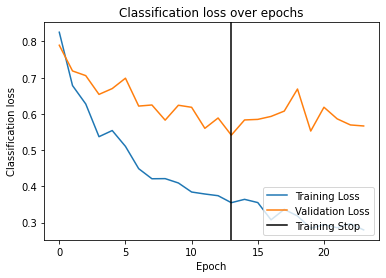

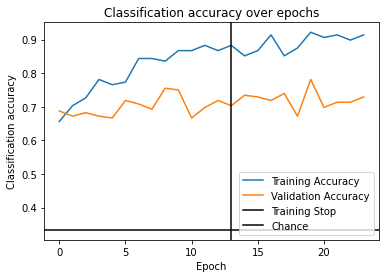

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8961 - acc: 0.5703 - val_loss: 0.8417 - val_acc: 0.6458
Epoch 2/50 0.233s 	 loss: 0.8371 - acc: 0.7109 - val_loss: 0.7767 - val_acc: 0.6302
Epoch 3/50 0.234s 	 loss: 0.7765 - acc: 0.6875 - val_loss: 0.8513 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.7711 - acc: 0.6641 - val_loss: 0.7805 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.239s 	 loss: 0.6832 - acc: 0.7031 - val_loss: 0.8169 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.6635 - acc: 0.7344 - val_loss: 0.7604 - val_acc: 0.6875
Epoch 7/50 0.235s 	 loss: 0.6543 - acc: 0.7422 - val_loss: 0.7846 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.242s 	 loss: 0.5964 - acc: 0.7500 - val_loss: 0.7603 - val_acc: 0.6406
Epoch 9/50 0.230s 	 loss: 0.6093 - acc: 0.6953 - val_loss: 0.7787 - val_acc: 0.6146
EarlyStopping counter: 1 out o

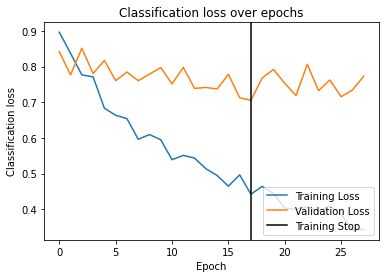

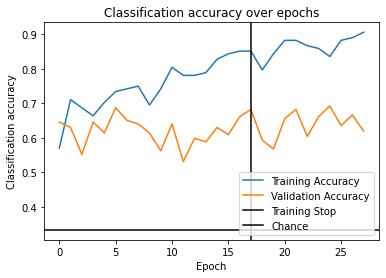

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9257 - acc: 0.5469 - val_loss: 0.9212 - val_acc: 0.5469
Epoch 2/50 0.235s 	 loss: 0.8318 - acc: 0.6797 - val_loss: 0.8677 - val_acc: 0.5729
Epoch 3/50 0.236s 	 loss: 0.7768 - acc: 0.6797 - val_loss: 0.7915 - val_acc: 0.6042
Epoch 4/50 0.242s 	 loss: 0.7394 - acc: 0.6719 - val_loss: 0.8228 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7394 - acc: 0.6641 - val_loss: 0.7533 - val_acc: 0.6042
Epoch 6/50 0.233s 	 loss: 0.6509 - acc: 0.7266 - val_loss: 0.7651 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.241s 	 loss: 0.6741 - acc: 0.7188 - val_loss: 0.7660 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.6307 - acc: 0.7578 - val_loss: 0.7775 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.237s 	 loss: 0.6445 - acc: 0.7422 - val_loss: 0.7178 - val_acc: 0.6302
Epoch 10/50 0.235s 	 loss: 0.6

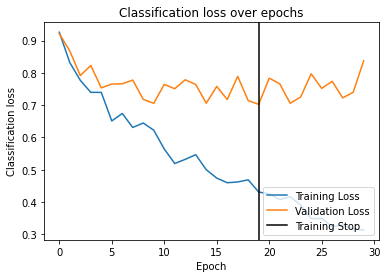

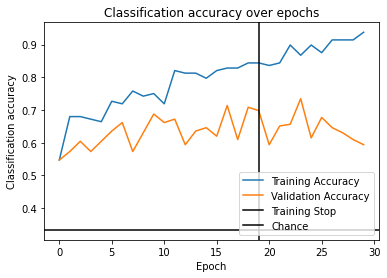

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8902 - acc: 0.5781 - val_loss: 0.9492 - val_acc: 0.6302
Epoch 2/50 0.234s 	 loss: 0.8094 - acc: 0.6406 - val_loss: 0.8998 - val_acc: 0.6302
Epoch 3/50 0.231s 	 loss: 0.7416 - acc: 0.6641 - val_loss: 0.8565 - val_acc: 0.6146
Epoch 4/50 0.238s 	 loss: 0.6804 - acc: 0.6875 - val_loss: 0.8555 - val_acc: 0.5781
Epoch 5/50 0.238s 	 loss: 0.6617 - acc: 0.7578 - val_loss: 0.8389 - val_acc: 0.6042
Epoch 6/50 0.239s 	 loss: 0.6464 - acc: 0.7188 - val_loss: 0.7080 - val_acc: 0.6979
Epoch 7/50 0.244s 	 loss: 0.6766 - acc: 0.7188 - val_loss: 0.7575 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.244s 	 loss: 0.6346 - acc: 0.7500 - val_loss: 0.7721 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.236s 	 loss: 0.6100 - acc: 0.7734 - val_loss: 0.7489 - val_acc: 0.7292
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.241s 	 loss: 0.5870 - acc: 0.7656 - val_loss: 0.734

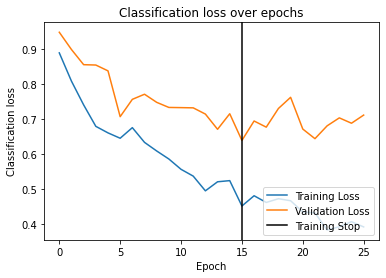

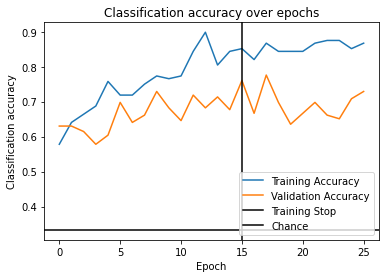

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.7769 - acc: 0.6484 - val_loss: 0.8065 - val_acc: 0.6667
Epoch 2/50 0.231s 	 loss: 0.6570 - acc: 0.7422 - val_loss: 0.6790 - val_acc: 0.7240
Epoch 3/50 0.236s 	 loss: 0.5997 - acc: 0.7812 - val_loss: 0.6628 - val_acc: 0.7135
Epoch 4/50 0.243s 	 loss: 0.5373 - acc: 0.7969 - val_loss: 0.6567 - val_acc: 0.7135
Epoch 5/50 0.239s 	 loss: 0.5099 - acc: 0.8125 - val_loss: 0.6592 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.240s 	 loss: 0.4892 - acc: 0.8516 - val_loss: 0.6331 - val_acc: 0.7656
Epoch 7/50 0.233s 	 loss: 0.4376 - acc: 0.8750 - val_loss: 0.6465 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.4712 - acc: 0.8359 - val_loss: 0.6892 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.232s 	 loss: 0.4164 - acc: 0.8516 - val_loss: 0.6622 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.244s 	 loss: 0.4

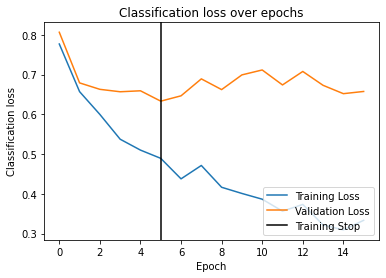

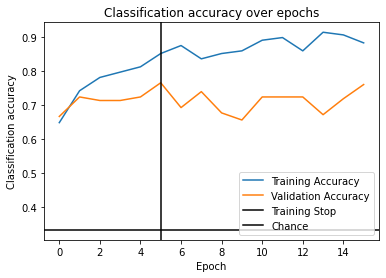

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8035 - acc: 0.6562 - val_loss: 0.7068 - val_acc: 0.6354
Epoch 2/50 0.235s 	 loss: 0.6926 - acc: 0.7422 - val_loss: 0.6071 - val_acc: 0.8021
Epoch 3/50 0.236s 	 loss: 0.6593 - acc: 0.7422 - val_loss: 0.6234 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.5460 - acc: 0.7891 - val_loss: 0.5691 - val_acc: 0.8177
Epoch 5/50 0.237s 	 loss: 0.5630 - acc: 0.8125 - val_loss: 0.6255 - val_acc: 0.7812
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.5446 - acc: 0.7734 - val_loss: 0.5889 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.5462 - acc: 0.7812 - val_loss: 0.5563 - val_acc: 0.7708
Epoch 8/50 0.231s 	 loss: 0.5207 - acc: 0.7578 - val_loss: 0.6287 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.239s 	 loss: 0.5051 - acc: 0.7812 - val_loss: 0.5326 - val_acc: 0.7708
Epoch 10/50 0.232s 	 loss: 0.4

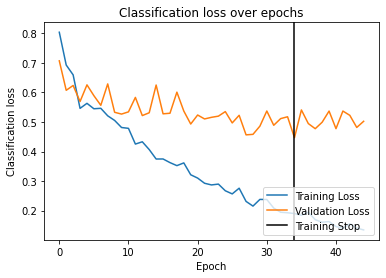

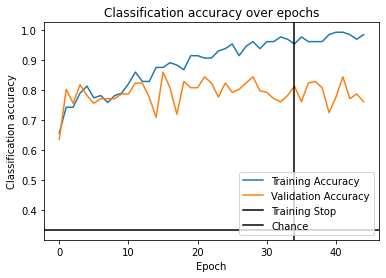

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7669 - acc: 0.7109 - val_loss: 0.8826 - val_acc: 0.6406
Epoch 2/50 0.233s 	 loss: 0.6420 - acc: 0.7500 - val_loss: 0.7972 - val_acc: 0.6250
Epoch 3/50 0.234s 	 loss: 0.5843 - acc: 0.7891 - val_loss: 0.8374 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.5789 - acc: 0.7891 - val_loss: 0.7787 - val_acc: 0.6562
Epoch 5/50 0.230s 	 loss: 0.4659 - acc: 0.8359 - val_loss: 0.8905 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.4737 - acc: 0.8281 - val_loss: 0.7701 - val_acc: 0.6406
Epoch 7/50 0.238s 	 loss: 0.4777 - acc: 0.8203 - val_loss: 0.7603 - val_acc: 0.6458
Epoch 8/50 0.232s 	 loss: 0.4085 - acc: 0.8828 - val_loss: 0.8244 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.4297 - acc: 0.8281 - val_loss: 0.8175 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.237s 	 loss: 0.4

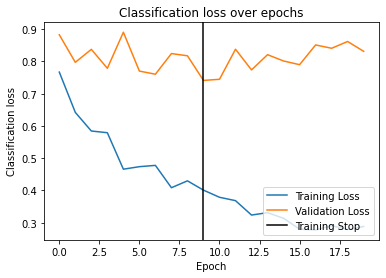

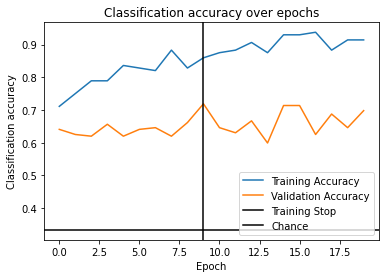

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7252 - acc: 0.6875 - val_loss: 0.8592 - val_acc: 0.5677
Epoch 2/50 0.230s 	 loss: 0.6199 - acc: 0.7422 - val_loss: 0.8161 - val_acc: 0.6823
Epoch 3/50 0.232s 	 loss: 0.6094 - acc: 0.7656 - val_loss: 0.7469 - val_acc: 0.6823
Epoch 4/50 0.233s 	 loss: 0.5451 - acc: 0.7969 - val_loss: 0.7747 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.5081 - acc: 0.8281 - val_loss: 0.8082 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.4669 - acc: 0.8281 - val_loss: 0.7848 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.240s 	 loss: 0.4898 - acc: 0.7812 - val_loss: 0.7447 - val_acc: 0.6510
Epoch 8/50 0.235s 	 loss: 0.4567 - acc: 0.8438 - val_loss: 0.7976 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.4267 - acc: 0.8594 - val_loss: 0.7061 - val_acc: 0.7083
Epoch 10/50 0.241s 	 loss: 0.4

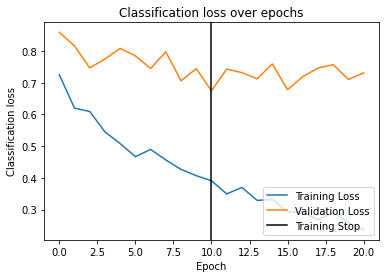

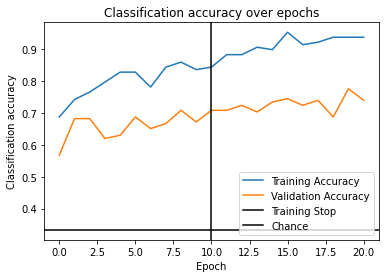

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7200 - acc: 0.7188 - val_loss: 0.8145 - val_acc: 0.6198
Epoch 2/50 0.235s 	 loss: 0.6236 - acc: 0.7500 - val_loss: 0.8244 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.5728 - acc: 0.7812 - val_loss: 0.7699 - val_acc: 0.6406
Epoch 4/50 0.231s 	 loss: 0.5411 - acc: 0.8203 - val_loss: 0.8127 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.4992 - acc: 0.8359 - val_loss: 0.7648 - val_acc: 0.6146
Epoch 6/50 0.234s 	 loss: 0.5263 - acc: 0.8516 - val_loss: 0.6726 - val_acc: 0.7135
Epoch 7/50 0.231s 	 loss: 0.4462 - acc: 0.8906 - val_loss: 0.7145 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.4491 - acc: 0.8516 - val_loss: 0.7331 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.236s 	 loss: 0.4157 - acc: 0.8984 - val_loss: 0.7123 - val_acc: 0.6562
EarlyStopping counter: 3 out o

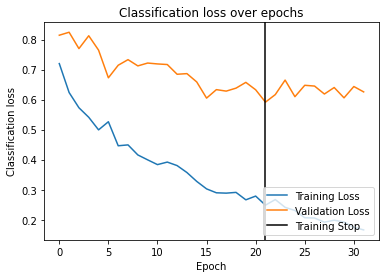

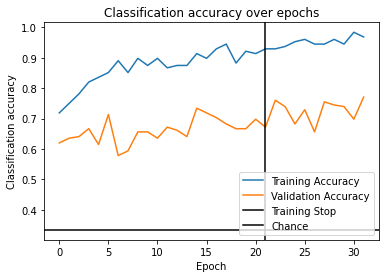

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8130 - acc: 0.6641 - val_loss: 0.6526 - val_acc: 0.7240
Epoch 2/50 0.240s 	 loss: 0.7556 - acc: 0.6641 - val_loss: 0.6463 - val_acc: 0.7708
Epoch 3/50 0.241s 	 loss: 0.6715 - acc: 0.7422 - val_loss: 0.6050 - val_acc: 0.7448
Epoch 4/50 0.237s 	 loss: 0.6033 - acc: 0.7344 - val_loss: 0.6126 - val_acc: 0.7917
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.5754 - acc: 0.7422 - val_loss: 0.6226 - val_acc: 0.8073
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.245s 	 loss: 0.5094 - acc: 0.8516 - val_loss: 0.5823 - val_acc: 0.8281
Epoch 7/50 0.234s 	 loss: 0.4916 - acc: 0.8594 - val_loss: 0.5901 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.4844 - acc: 0.8281 - val_loss: 0.6267 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.4477 - acc: 0.8359 - val_loss: 0.6430 - val_acc: 0.7292
EarlyStopping counter: 3 out o

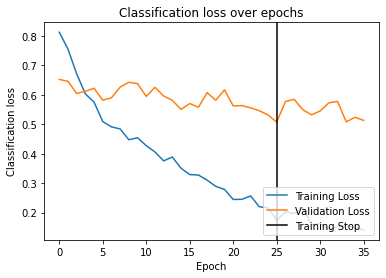

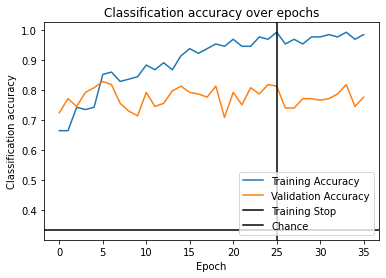

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9146 - acc: 0.6016 - val_loss: 0.7781 - val_acc: 0.6562
Epoch 2/50 0.234s 	 loss: 0.8111 - acc: 0.6641 - val_loss: 0.7309 - val_acc: 0.6979
Epoch 3/50 0.241s 	 loss: 0.7481 - acc: 0.6641 - val_loss: 0.7796 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7137 - acc: 0.6875 - val_loss: 0.7993 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.6851 - acc: 0.7031 - val_loss: 0.8057 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.234s 	 loss: 0.6912 - acc: 0.7109 - val_loss: 0.8311 - val_acc: 0.6250
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.238s 	 loss: 0.6311 - acc: 0.7734 - val_loss: 0.7604 - val_acc: 0.6667
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.236s 	 loss: 0.6101 - acc: 0.7500 - val_loss: 0.7577 - val_acc: 0.7135
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.238s 	 loss: 0.5999 - acc: 0.71

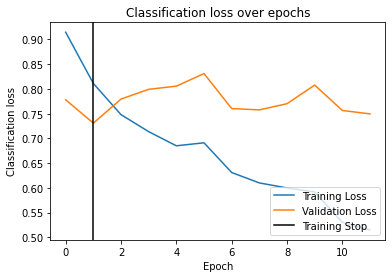

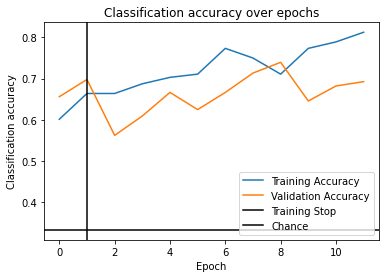

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8289 - acc: 0.6250 - val_loss: 0.9852 - val_acc: 0.5781
Epoch 2/50 0.234s 	 loss: 0.7731 - acc: 0.6797 - val_loss: 0.9363 - val_acc: 0.5938
Epoch 3/50 0.244s 	 loss: 0.7261 - acc: 0.6406 - val_loss: 1.0117 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7121 - acc: 0.7266 - val_loss: 0.8777 - val_acc: 0.6406
Epoch 5/50 0.233s 	 loss: 0.6533 - acc: 0.7344 - val_loss: 0.9569 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.6206 - acc: 0.7812 - val_loss: 0.9117 - val_acc: 0.6771
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.237s 	 loss: 0.5851 - acc: 0.7578 - val_loss: 0.8732 - val_acc: 0.6458
Epoch 8/50 0.235s 	 loss: 0.5706 - acc: 0.7734 - val_loss: 0.9662 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5291 - acc: 0.8203 - val_loss: 0.8573 - val_acc: 0.6667
Epoch 10/50 0.232s 	 loss: 0.5

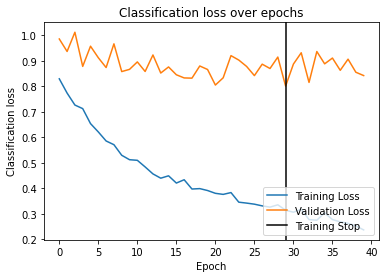

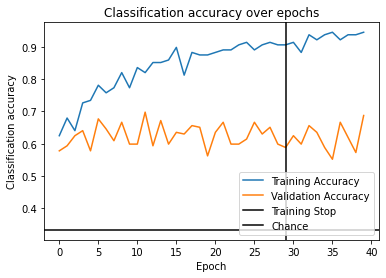

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8745 - acc: 0.6016 - val_loss: 0.8254 - val_acc: 0.6042
Epoch 2/50 0.233s 	 loss: 0.8313 - acc: 0.6484 - val_loss: 0.7912 - val_acc: 0.6719
Epoch 3/50 0.234s 	 loss: 0.7945 - acc: 0.6250 - val_loss: 0.8161 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.7498 - acc: 0.7188 - val_loss: 0.7544 - val_acc: 0.7240
Epoch 5/50 0.233s 	 loss: 0.7296 - acc: 0.7266 - val_loss: 0.7099 - val_acc: 0.7552
Epoch 6/50 0.233s 	 loss: 0.6983 - acc: 0.7344 - val_loss: 0.6769 - val_acc: 0.7500
Epoch 7/50 0.232s 	 loss: 0.7003 - acc: 0.7266 - val_loss: 0.6505 - val_acc: 0.7865
Epoch 8/50 0.243s 	 loss: 0.7182 - acc: 0.6953 - val_loss: 0.6736 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.6590 - acc: 0.7188 - val_loss: 0.6820 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.237s 	 loss: 0.6511 - acc: 0.7422 - val_loss: 0.645

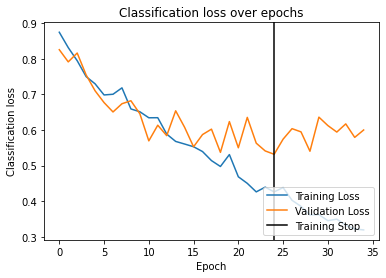

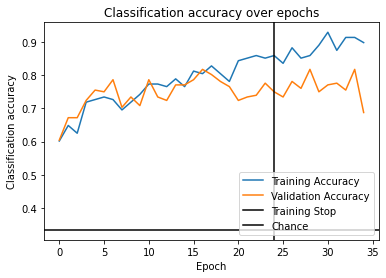

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9851 - acc: 0.5391 - val_loss: 0.7051 - val_acc: 0.7031
Epoch 2/50 0.233s 	 loss: 0.8479 - acc: 0.6797 - val_loss: 0.6774 - val_acc: 0.6719
Epoch 3/50 0.234s 	 loss: 0.7882 - acc: 0.6641 - val_loss: 0.7510 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.8206 - acc: 0.6719 - val_loss: 0.7346 - val_acc: 0.7031
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.247s 	 loss: 0.7669 - acc: 0.6953 - val_loss: 0.7537 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.234s 	 loss: 0.7256 - acc: 0.6797 - val_loss: 0.7438 - val_acc: 0.7083
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.6991 - acc: 0.7578 - val_loss: 0.7779 - val_acc: 0.6875
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.234s 	 loss: 0.6906 - acc: 0.6953 - val_loss: 0.7887 - val_acc: 0.6719
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.235s 	 loss: 0.6595 - acc: 0.75

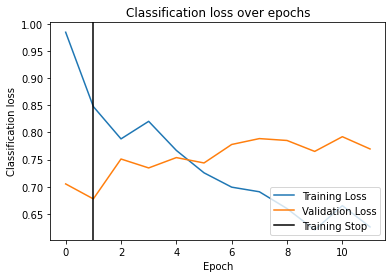

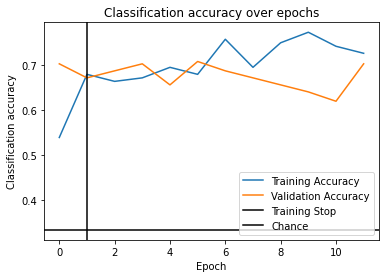

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7768 - acc: 0.6953 - val_loss: 1.0140 - val_acc: 0.5885
Epoch 2/50 0.232s 	 loss: 0.7772 - acc: 0.6797 - val_loss: 1.0035 - val_acc: 0.5729
Epoch 3/50 0.235s 	 loss: 0.7342 - acc: 0.6641 - val_loss: 1.0249 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.6647 - acc: 0.7422 - val_loss: 1.0094 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.244s 	 loss: 0.6418 - acc: 0.7422 - val_loss: 1.0360 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.237s 	 loss: 0.6196 - acc: 0.7812 - val_loss: 1.0191 - val_acc: 0.5156
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.6103 - acc: 0.7578 - val_loss: 0.9893 - val_acc: 0.5052
Epoch 8/50 0.239s 	 loss: 0.5564 - acc: 0.7891 - val_loss: 1.0576 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.5566 - acc: 0.8125 - val_loss: 1.0714 - val_acc: 0.

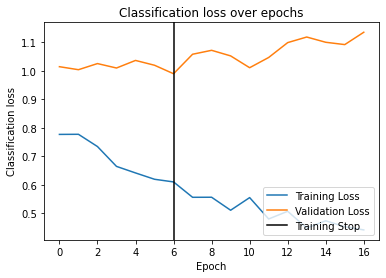

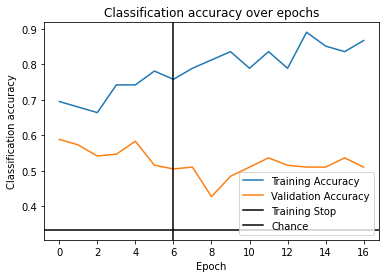

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8615 - acc: 0.6328 - val_loss: 0.8979 - val_acc: 0.5938
Epoch 2/50 0.233s 	 loss: 0.7759 - acc: 0.6875 - val_loss: 0.9500 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.7636 - acc: 0.6797 - val_loss: 0.9369 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.237s 	 loss: 0.7378 - acc: 0.6797 - val_loss: 0.9239 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.239s 	 loss: 0.7211 - acc: 0.6953 - val_loss: 0.9436 - val_acc: 0.5729
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.237s 	 loss: 0.6845 - acc: 0.7266 - val_loss: 0.9203 - val_acc: 0.5885
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.233s 	 loss: 0.6825 - acc: 0.7656 - val_loss: 0.8659 - val_acc: 0.6406
Epoch 8/50 0.232s 	 loss: 0.6987 - acc: 0.6719 - val_loss: 0.8790 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.6508 - acc: 0.74

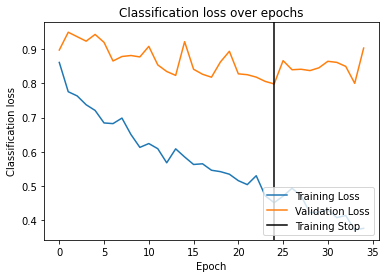

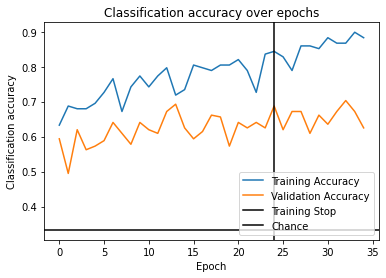

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0447 - acc: 0.5391 - val_loss: 0.7018 - val_acc: 0.6823
Epoch 2/50 0.234s 	 loss: 1.0041 - acc: 0.5469 - val_loss: 0.6881 - val_acc: 0.7552
Epoch 3/50 0.232s 	 loss: 0.9344 - acc: 0.6484 - val_loss: 0.7248 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.8908 - acc: 0.6250 - val_loss: 0.6913 - val_acc: 0.7031
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.8424 - acc: 0.6172 - val_loss: 0.7827 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.238s 	 loss: 0.8628 - acc: 0.6094 - val_loss: 0.7317 - val_acc: 0.6771
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.237s 	 loss: 0.8515 - acc: 0.6719 - val_loss: 0.7091 - val_acc: 0.6719
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.237s 	 loss: 0.7701 - acc: 0.7031 - val_loss: 0.7416 - val_acc: 0.6771
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.237s 	 loss: 0.7582 - acc: 0.71

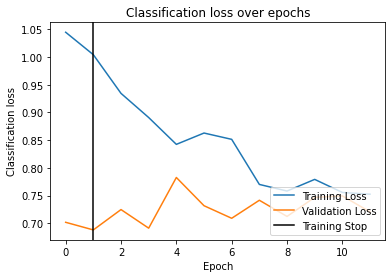

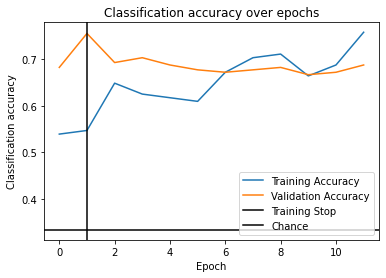

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.9461 - acc: 0.5469 - val_loss: 0.8962 - val_acc: 0.5885
Epoch 2/50 0.238s 	 loss: 0.9104 - acc: 0.6172 - val_loss: 0.9071 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8662 - acc: 0.6172 - val_loss: 0.8530 - val_acc: 0.6719
Epoch 4/50 0.234s 	 loss: 0.8162 - acc: 0.6953 - val_loss: 0.8887 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.7958 - acc: 0.6562 - val_loss: 0.8772 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.7622 - acc: 0.7031 - val_loss: 0.8328 - val_acc: 0.6042
Epoch 7/50 0.235s 	 loss: 0.7813 - acc: 0.7031 - val_loss: 0.9188 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.240s 	 loss: 0.7504 - acc: 0.7109 - val_loss: 0.8783 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.241s 	 loss: 0.7560 - acc: 0.6953 - val_loss: 0.8475 - val_acc: 0.

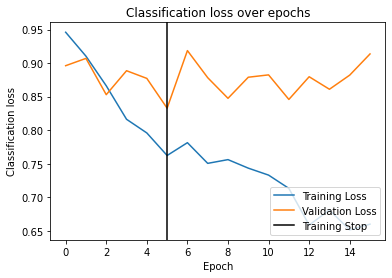

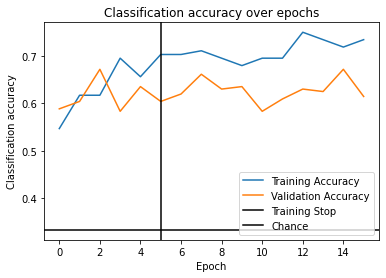

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8103 - acc: 0.6562 - val_loss: 1.2216 - val_acc: 0.4271
Epoch 2/50 0.240s 	 loss: 0.7482 - acc: 0.6953 - val_loss: 1.1294 - val_acc: 0.4740
Epoch 3/50 0.245s 	 loss: 0.7109 - acc: 0.7344 - val_loss: 1.1465 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.6547 - acc: 0.7500 - val_loss: 1.1614 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.5908 - acc: 0.8047 - val_loss: 1.2733 - val_acc: 0.5052
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.6380 - acc: 0.7500 - val_loss: 1.2435 - val_acc: 0.5208
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.236s 	 loss: 0.6048 - acc: 0.8125 - val_loss: 1.2206 - val_acc: 0.5365
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.244s 	 loss: 0.6068 - acc: 0.7578 - val_loss: 1.2266 - val_acc: 0.5208
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.236s 	 loss: 0.5468 - acc: 0.84

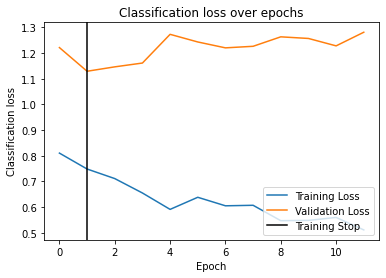

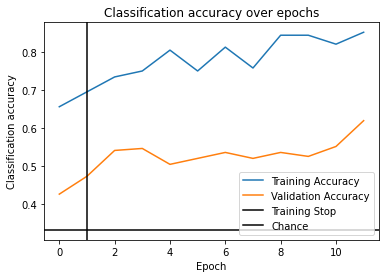

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.1662 - acc: 0.4297 - val_loss: 1.0613 - val_acc: 0.4688
Epoch 2/50 0.236s 	 loss: 1.0370 - acc: 0.5234 - val_loss: 1.0402 - val_acc: 0.4948
Epoch 3/50 0.236s 	 loss: 0.9967 - acc: 0.5469 - val_loss: 1.1230 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.242s 	 loss: 0.9439 - acc: 0.5156 - val_loss: 1.0439 - val_acc: 0.4948
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.9386 - acc: 0.5625 - val_loss: 1.0827 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.238s 	 loss: 0.8789 - acc: 0.6328 - val_loss: 1.0664 - val_acc: 0.4948
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.8721 - acc: 0.5938 - val_loss: 1.0665 - val_acc: 0.5052
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.235s 	 loss: 0.8613 - acc: 0.6172 - val_loss: 1.1016 - val_acc: 0.4740
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.239s 	 loss: 0.8450 - acc: 0.61

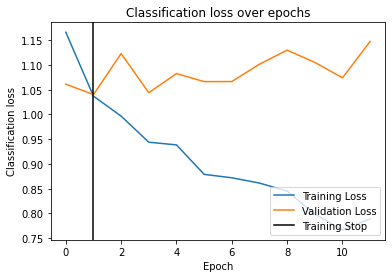

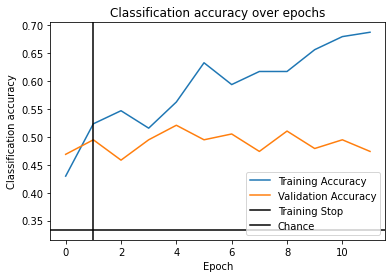

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0678 - acc: 0.5234 - val_loss: 1.1769 - val_acc: 0.4740
Epoch 2/50 0.236s 	 loss: 1.0182 - acc: 0.4922 - val_loss: 1.2313 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.9512 - acc: 0.5781 - val_loss: 1.1413 - val_acc: 0.4635
Epoch 4/50 0.236s 	 loss: 0.9749 - acc: 0.5469 - val_loss: 1.1666 - val_acc: 0.3958
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.9703 - acc: 0.5391 - val_loss: 1.0648 - val_acc: 0.5208
Epoch 6/50 0.235s 	 loss: 0.8793 - acc: 0.5938 - val_loss: 1.1460 - val_acc: 0.4479
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.242s 	 loss: 0.8830 - acc: 0.6016 - val_loss: 1.0930 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.237s 	 loss: 0.8822 - acc: 0.5469 - val_loss: 1.0818 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.237s 	 loss: 0.7917 - acc: 0.6797 - val_loss: 1.0725 - val_acc: 0.

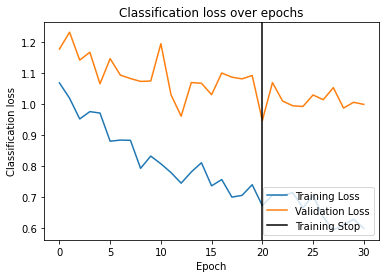

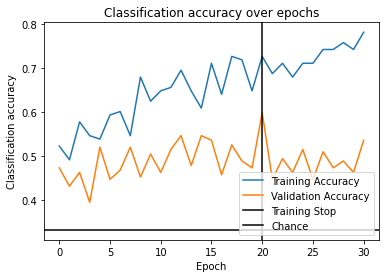

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0851 - acc: 0.5391 - val_loss: 1.1379 - val_acc: 0.4323
Epoch 2/50 0.233s 	 loss: 0.9981 - acc: 0.5312 - val_loss: 1.0737 - val_acc: 0.4635
Epoch 3/50 0.235s 	 loss: 0.9850 - acc: 0.5547 - val_loss: 1.1075 - val_acc: 0.4479
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.9142 - acc: 0.6172 - val_loss: 1.0333 - val_acc: 0.5156
Epoch 5/50 0.237s 	 loss: 0.9309 - acc: 0.5469 - val_loss: 1.0956 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.9026 - acc: 0.5625 - val_loss: 1.0829 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.9002 - acc: 0.5938 - val_loss: 1.1065 - val_acc: 0.4323
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.8606 - acc: 0.6172 - val_loss: 1.1161 - val_acc: 0.5052
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.236s 	 loss: 0.8238 - acc: 0.6406 - val_loss: 1.0982 - val_acc: 0.

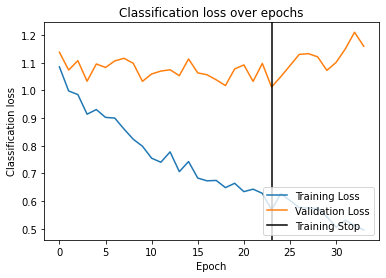

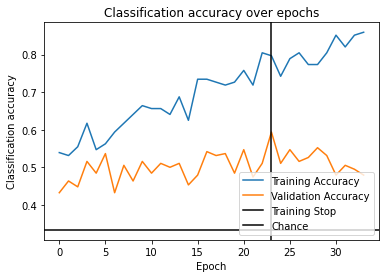

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0829 - acc: 0.5078 - val_loss: 1.2160 - val_acc: 0.4740
Epoch 2/50 0.232s 	 loss: 0.9895 - acc: 0.5703 - val_loss: 1.0755 - val_acc: 0.5469
Epoch 3/50 0.234s 	 loss: 0.9464 - acc: 0.5781 - val_loss: 1.0772 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.9056 - acc: 0.6172 - val_loss: 1.0202 - val_acc: 0.5938
Epoch 5/50 0.236s 	 loss: 0.8930 - acc: 0.6094 - val_loss: 0.9514 - val_acc: 0.6198
Epoch 6/50 0.234s 	 loss: 0.8432 - acc: 0.6562 - val_loss: 0.9878 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.8157 - acc: 0.6172 - val_loss: 0.9291 - val_acc: 0.5781
Epoch 8/50 0.237s 	 loss: 0.7956 - acc: 0.6641 - val_loss: 0.9485 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.7812 - acc: 0.6562 - val_loss: 0.9256 - val_acc: 0.6354
Epoch 10/50 0.235s 	 loss: 0.7685 - acc: 0.7031 - val_loss: 0.942

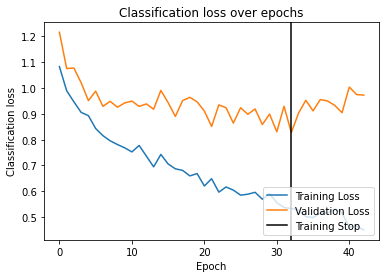

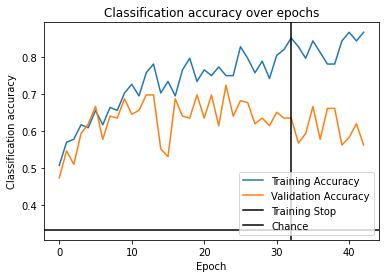

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1837 - acc: 0.4531 - val_loss: 0.9312 - val_acc: 0.5521
Epoch 2/50 0.234s 	 loss: 1.0707 - acc: 0.4922 - val_loss: 0.9653 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.9997 - acc: 0.4922 - val_loss: 0.9466 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.232s 	 loss: 0.9353 - acc: 0.5703 - val_loss: 0.9093 - val_acc: 0.5469
Epoch 5/50 0.231s 	 loss: 0.8672 - acc: 0.6719 - val_loss: 0.9495 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.8446 - acc: 0.6406 - val_loss: 0.8904 - val_acc: 0.5729
Epoch 7/50 0.233s 	 loss: 0.8917 - acc: 0.6250 - val_loss: 0.9348 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.236s 	 loss: 0.8512 - acc: 0.7031 - val_loss: 0.9131 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.240s 	 loss: 0.7847 - acc: 0.6797 - val_loss: 0.9574 - val_acc: 0.

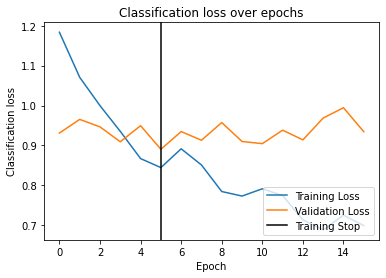

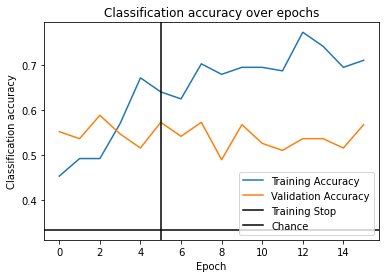

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.1085 - acc: 0.4922 - val_loss: 1.1507 - val_acc: 0.4688
Epoch 2/50 0.234s 	 loss: 1.0138 - acc: 0.5078 - val_loss: 1.1201 - val_acc: 0.4688
Epoch 3/50 0.232s 	 loss: 0.9360 - acc: 0.5781 - val_loss: 1.0858 - val_acc: 0.5000
Epoch 4/50 0.235s 	 loss: 0.8788 - acc: 0.6016 - val_loss: 0.9831 - val_acc: 0.5260
Epoch 5/50 0.235s 	 loss: 0.8700 - acc: 0.5938 - val_loss: 1.0480 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.8167 - acc: 0.6328 - val_loss: 1.0289 - val_acc: 0.5104
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.7968 - acc: 0.6797 - val_loss: 1.0144 - val_acc: 0.5417
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.234s 	 loss: 0.7623 - acc: 0.6484 - val_loss: 0.9778 - val_acc: 0.5521
Epoch 9/50 0.234s 	 loss: 0.7580 - acc: 0.6484 - val_loss: 1.0435 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.232s 	 loss: 0.7

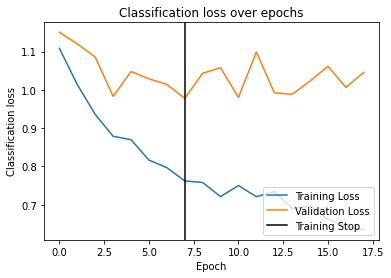

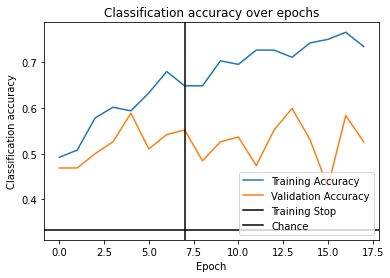

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.7783 - acc: 0.6641 - val_loss: 0.8268 - val_acc: 0.6771
Epoch 2/50 0.234s 	 loss: 0.7084 - acc: 0.6719 - val_loss: 0.7599 - val_acc: 0.6771
Epoch 3/50 0.235s 	 loss: 0.6483 - acc: 0.6953 - val_loss: 0.7838 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.6270 - acc: 0.7266 - val_loss: 0.7132 - val_acc: 0.6719
Epoch 5/50 0.237s 	 loss: 0.5920 - acc: 0.7656 - val_loss: 0.7097 - val_acc: 0.7240
Epoch 6/50 0.234s 	 loss: 0.5636 - acc: 0.8203 - val_loss: 0.7150 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.5391 - acc: 0.8047 - val_loss: 0.6991 - val_acc: 0.7760
Epoch 8/50 0.233s 	 loss: 0.5233 - acc: 0.8125 - val_loss: 0.7715 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.5035 - acc: 0.8359 - val_loss: 0.7577 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.238s 	 loss: 0.4

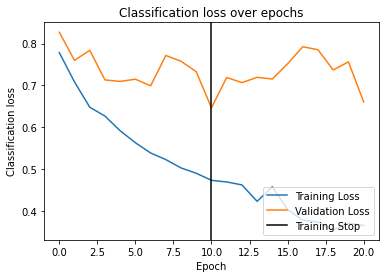

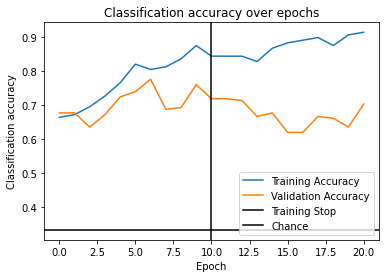

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.7520 - acc: 0.7188 - val_loss: 0.8075 - val_acc: 0.6354
Epoch 2/50 0.234s 	 loss: 0.6617 - acc: 0.7812 - val_loss: 0.7477 - val_acc: 0.6667
Epoch 3/50 0.240s 	 loss: 0.6342 - acc: 0.7891 - val_loss: 0.8134 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.232s 	 loss: 0.5847 - acc: 0.7734 - val_loss: 0.7866 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.240s 	 loss: 0.6026 - acc: 0.7656 - val_loss: 0.7701 - val_acc: 0.6250
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.242s 	 loss: 0.5498 - acc: 0.8047 - val_loss: 0.7770 - val_acc: 0.6354
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.236s 	 loss: 0.5411 - acc: 0.8281 - val_loss: 0.7913 - val_acc: 0.6354
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.236s 	 loss: 0.5275 - acc: 0.8438 - val_loss: 0.7954 - val_acc: 0.6354
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.242s 	 loss: 0.4875 - acc: 0.80

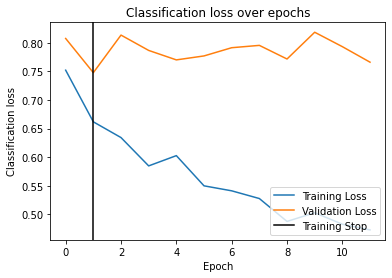

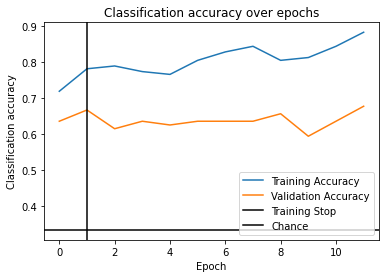

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8066 - acc: 0.6250 - val_loss: 0.7281 - val_acc: 0.6823
Epoch 2/50 0.232s 	 loss: 0.7936 - acc: 0.6172 - val_loss: 0.6443 - val_acc: 0.7344
Epoch 3/50 0.236s 	 loss: 0.7685 - acc: 0.6484 - val_loss: 0.6249 - val_acc: 0.7344
Epoch 4/50 0.234s 	 loss: 0.7172 - acc: 0.6953 - val_loss: 0.6038 - val_acc: 0.7812
Epoch 5/50 0.234s 	 loss: 0.6646 - acc: 0.7109 - val_loss: 0.6301 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.6658 - acc: 0.7422 - val_loss: 0.5777 - val_acc: 0.7917
Epoch 7/50 0.236s 	 loss: 0.6613 - acc: 0.7109 - val_loss: 0.5664 - val_acc: 0.7500
Epoch 8/50 0.236s 	 loss: 0.6309 - acc: 0.7578 - val_loss: 0.5741 - val_acc: 0.7760
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.6373 - acc: 0.7188 - val_loss: 0.5597 - val_acc: 0.7604
Epoch 10/50 0.232s 	 loss: 0.6196 - acc: 0.7500 - val_loss: 0.5595 - val_acc: 0.7500
Epoch 11/50 0.2

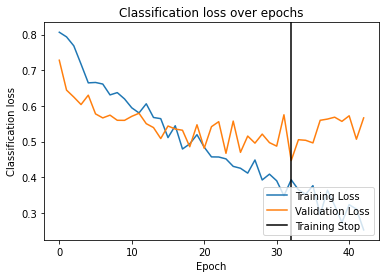

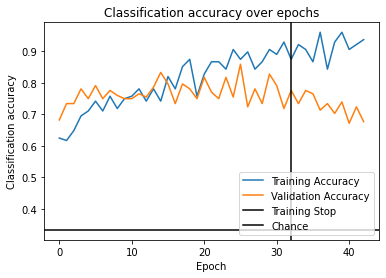

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0128 - acc: 0.5234 - val_loss: 0.9604 - val_acc: 0.5365
Epoch 2/50 0.234s 	 loss: 0.8738 - acc: 0.5859 - val_loss: 0.9351 - val_acc: 0.5573
Epoch 3/50 0.234s 	 loss: 0.7763 - acc: 0.6562 - val_loss: 0.9656 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.6960 - acc: 0.6797 - val_loss: 0.9168 - val_acc: 0.5312
Epoch 5/50 0.229s 	 loss: 0.6602 - acc: 0.7109 - val_loss: 0.8964 - val_acc: 0.6094
Epoch 6/50 0.232s 	 loss: 0.6405 - acc: 0.6953 - val_loss: 0.9004 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.5953 - acc: 0.7734 - val_loss: 0.9043 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.5776 - acc: 0.7734 - val_loss: 0.9287 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.250s 	 loss: 0.5375 - acc: 0.7656 - val_loss: 0.9083 - val_acc: 0.5938
EarlyStopping counter: 4 out o

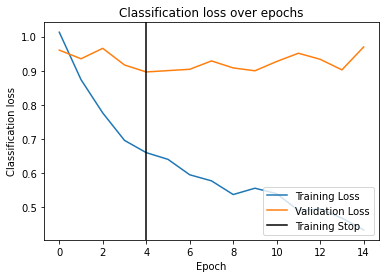

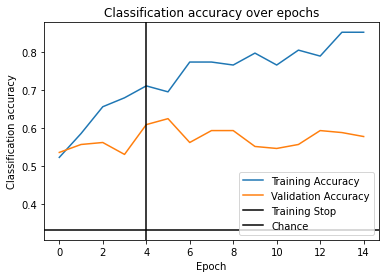

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0968 - acc: 0.5156 - val_loss: 1.0139 - val_acc: 0.4115
Epoch 2/50 0.239s 	 loss: 0.9187 - acc: 0.6016 - val_loss: 0.9050 - val_acc: 0.5156
Epoch 3/50 0.236s 	 loss: 0.8684 - acc: 0.6484 - val_loss: 0.8554 - val_acc: 0.5469
Epoch 4/50 0.236s 	 loss: 0.7686 - acc: 0.6719 - val_loss: 0.8691 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7761 - acc: 0.6875 - val_loss: 0.7929 - val_acc: 0.5938
Epoch 6/50 0.231s 	 loss: 0.6661 - acc: 0.7031 - val_loss: 0.8034 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.6672 - acc: 0.7109 - val_loss: 0.8348 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.6649 - acc: 0.6953 - val_loss: 0.8170 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.236s 	 loss: 0.6070 - acc: 0.7500 - val_loss: 0.8008 - val_acc: 0.6406
EarlyStopping counter: 4 out o

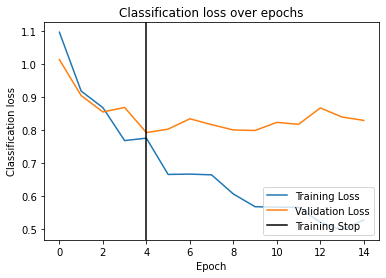

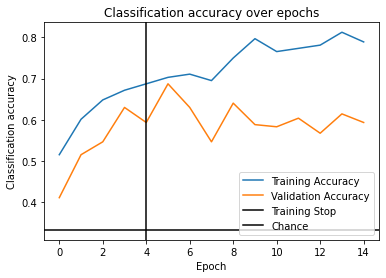

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9620 - acc: 0.5391 - val_loss: 1.0616 - val_acc: 0.4740
Epoch 2/50 0.234s 	 loss: 0.7929 - acc: 0.6797 - val_loss: 1.0783 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.7542 - acc: 0.6953 - val_loss: 0.9677 - val_acc: 0.5781
Epoch 4/50 0.241s 	 loss: 0.7206 - acc: 0.6875 - val_loss: 0.9774 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.6293 - acc: 0.7109 - val_loss: 0.9500 - val_acc: 0.5573
Epoch 6/50 0.233s 	 loss: 0.5914 - acc: 0.7422 - val_loss: 0.9813 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.6019 - acc: 0.7422 - val_loss: 0.9399 - val_acc: 0.5729
Epoch 8/50 0.234s 	 loss: 0.5495 - acc: 0.7969 - val_loss: 1.0399 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.231s 	 loss: 0.5877 - acc: 0.7500 - val_loss: 0.9543 - val_acc: 0.5729
EarlyStopping counter: 2 out o

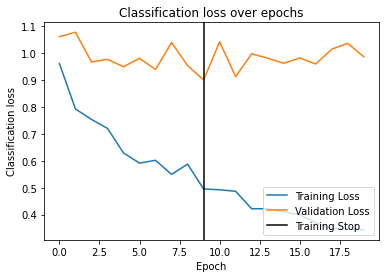

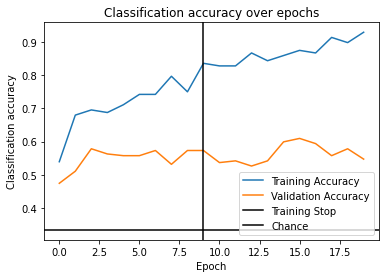

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.6648 - acc: 0.7500 - val_loss: 0.9015 - val_acc: 0.5885
Epoch 2/50 0.232s 	 loss: 0.6055 - acc: 0.7734 - val_loss: 0.8628 - val_acc: 0.5573
Epoch 3/50 0.233s 	 loss: 0.5569 - acc: 0.7812 - val_loss: 0.8551 - val_acc: 0.5833
Epoch 4/50 0.236s 	 loss: 0.5535 - acc: 0.8047 - val_loss: 0.7675 - val_acc: 0.6667
Epoch 5/50 0.238s 	 loss: 0.5221 - acc: 0.8047 - val_loss: 0.8166 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.243s 	 loss: 0.4944 - acc: 0.7891 - val_loss: 0.7384 - val_acc: 0.6510
Epoch 7/50 0.235s 	 loss: 0.4467 - acc: 0.8594 - val_loss: 0.7620 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.4550 - acc: 0.8359 - val_loss: 0.7100 - val_acc: 0.6927
Epoch 9/50 0.235s 	 loss: 0.4227 - acc: 0.8672 - val_loss: 0.7509 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.239s 	 loss: 0.4364 - acc: 0.8203 - val_loss: 0.807

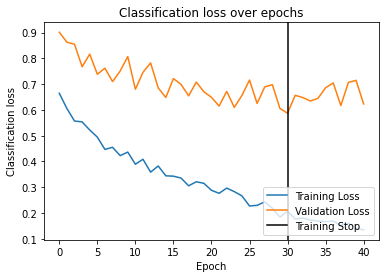

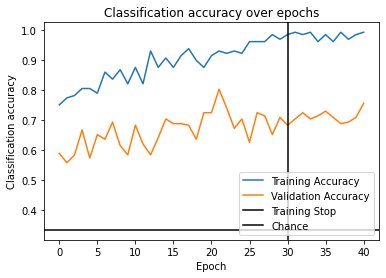

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.6720 - acc: 0.7266 - val_loss: 0.9371 - val_acc: 0.5625
Epoch 2/50 0.233s 	 loss: 0.5958 - acc: 0.7734 - val_loss: 0.8414 - val_acc: 0.6406
Epoch 3/50 0.233s 	 loss: 0.5876 - acc: 0.7656 - val_loss: 0.8237 - val_acc: 0.6510
Epoch 4/50 0.238s 	 loss: 0.5310 - acc: 0.7812 - val_loss: 0.8100 - val_acc: 0.6667
Epoch 5/50 0.235s 	 loss: 0.5290 - acc: 0.8047 - val_loss: 0.8380 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.4723 - acc: 0.8203 - val_loss: 0.7633 - val_acc: 0.6719
Epoch 7/50 0.232s 	 loss: 0.4719 - acc: 0.8281 - val_loss: 0.8414 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.4737 - acc: 0.8281 - val_loss: 0.8394 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.4098 - acc: 0.8672 - val_loss: 0.7731 - val_acc: 0.6979
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.242s 	 loss: 0.4

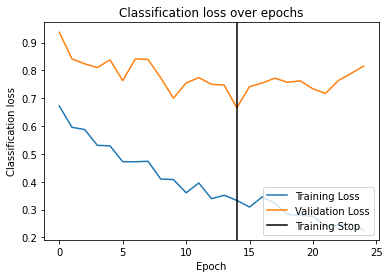

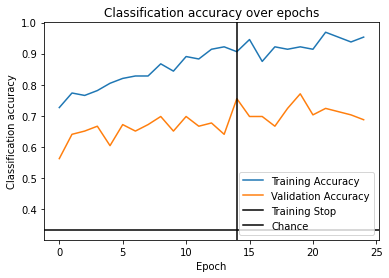

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8675 - acc: 0.5547 - val_loss: 0.4525 - val_acc: 0.8958
Epoch 2/50 0.245s 	 loss: 0.7951 - acc: 0.6719 - val_loss: 0.4546 - val_acc: 0.8802
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.7063 - acc: 0.6875 - val_loss: 0.4506 - val_acc: 0.9062
Epoch 4/50 0.234s 	 loss: 0.6540 - acc: 0.7031 - val_loss: 0.4376 - val_acc: 0.9375
Epoch 5/50 0.239s 	 loss: 0.6165 - acc: 0.7578 - val_loss: 0.4754 - val_acc: 0.8646
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.5963 - acc: 0.7656 - val_loss: 0.4961 - val_acc: 0.8073
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.5311 - acc: 0.8281 - val_loss: 0.4462 - val_acc: 0.8542
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.5364 - acc: 0.8438 - val_loss: 0.4613 - val_acc: 0.8750
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.231s 	 loss: 0.5171 - acc: 0.8047 - val_loss: 0.4998 - val_acc: 0.

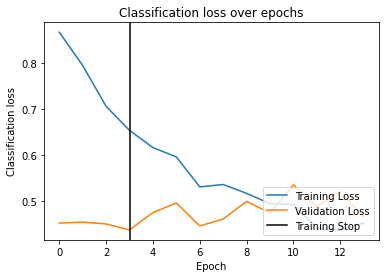

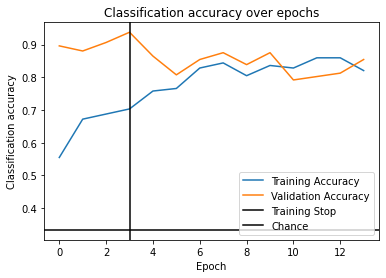

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9269 - acc: 0.6328 - val_loss: 0.7861 - val_acc: 0.6458
Epoch 2/50 0.234s 	 loss: 0.8702 - acc: 0.6641 - val_loss: 0.7515 - val_acc: 0.6667
Epoch 3/50 0.234s 	 loss: 0.8241 - acc: 0.6562 - val_loss: 0.7357 - val_acc: 0.7031
Epoch 4/50 0.236s 	 loss: 0.8048 - acc: 0.6484 - val_loss: 0.7650 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7465 - acc: 0.7031 - val_loss: 0.7174 - val_acc: 0.7344
Epoch 6/50 0.232s 	 loss: 0.7015 - acc: 0.7344 - val_loss: 0.6862 - val_acc: 0.7344
Epoch 7/50 0.231s 	 loss: 0.6968 - acc: 0.7422 - val_loss: 0.7276 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.6643 - acc: 0.7109 - val_loss: 0.6730 - val_acc: 0.7135
Epoch 9/50 0.249s 	 loss: 0.6702 - acc: 0.6875 - val_loss: 0.7028 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.239s 	 loss: 0.5985 - acc: 0.7812 - val_loss: 0.685

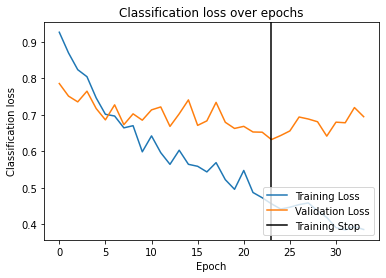

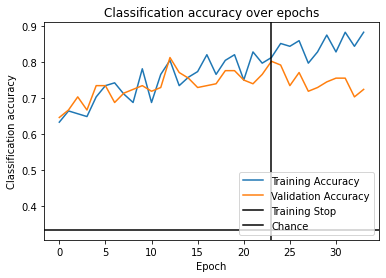

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8571 - acc: 0.6484 - val_loss: 0.8539 - val_acc: 0.6615
Epoch 2/50 0.235s 	 loss: 0.8403 - acc: 0.7109 - val_loss: 0.7960 - val_acc: 0.6771
Epoch 3/50 0.238s 	 loss: 0.7405 - acc: 0.6875 - val_loss: 0.8610 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.7246 - acc: 0.7031 - val_loss: 0.8800 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.250s 	 loss: 0.7118 - acc: 0.6953 - val_loss: 0.8663 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.233s 	 loss: 0.6900 - acc: 0.7031 - val_loss: 0.8146 - val_acc: 0.6354
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.236s 	 loss: 0.6092 - acc: 0.7891 - val_loss: 0.7619 - val_acc: 0.6771
Epoch 8/50 0.236s 	 loss: 0.6377 - acc: 0.7656 - val_loss: 0.8289 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.5890 - acc: 0.7578 - val_loss: 0.8129 - val_acc: 0.

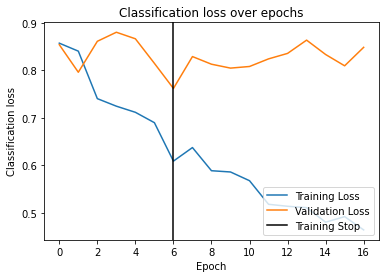

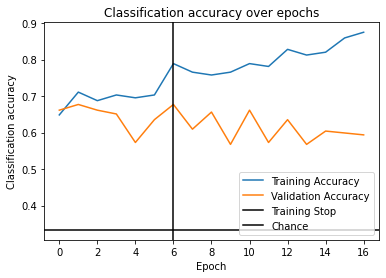

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7853 - acc: 0.6641 - val_loss: 1.0138 - val_acc: 0.5677
Epoch 2/50 0.233s 	 loss: 0.7344 - acc: 0.7031 - val_loss: 0.9697 - val_acc: 0.6667
Epoch 3/50 0.235s 	 loss: 0.6771 - acc: 0.7188 - val_loss: 1.0459 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.6733 - acc: 0.6875 - val_loss: 1.0270 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.6002 - acc: 0.7891 - val_loss: 0.9743 - val_acc: 0.5521
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.240s 	 loss: 0.6002 - acc: 0.7656 - val_loss: 0.9874 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.238s 	 loss: 0.5702 - acc: 0.8125 - val_loss: 0.9622 - val_acc: 0.5833
Epoch 8/50 0.232s 	 loss: 0.5088 - acc: 0.8125 - val_loss: 0.9820 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5150 - acc: 0.8359 - val_loss: 1.0070 - val_acc: 0.

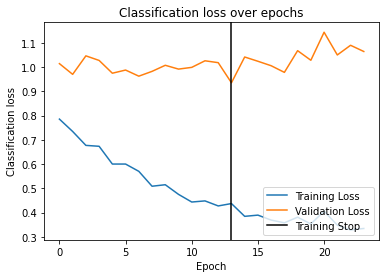

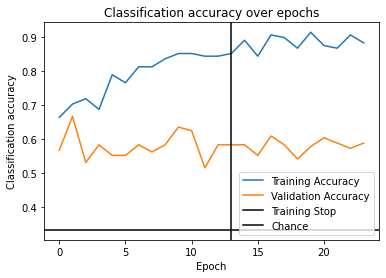

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9659 - acc: 0.5703 - val_loss: 0.8449 - val_acc: 0.6302
Epoch 2/50 0.240s 	 loss: 0.9642 - acc: 0.5703 - val_loss: 0.8611 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8809 - acc: 0.5781 - val_loss: 0.8599 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.8721 - acc: 0.5859 - val_loss: 0.8181 - val_acc: 0.6719
Epoch 5/50 0.233s 	 loss: 0.8776 - acc: 0.6250 - val_loss: 0.8130 - val_acc: 0.6667
Epoch 6/50 0.233s 	 loss: 0.8198 - acc: 0.6562 - val_loss: 0.9065 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.242s 	 loss: 0.8025 - acc: 0.6953 - val_loss: 0.8835 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.234s 	 loss: 0.7938 - acc: 0.6406 - val_loss: 0.8506 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.7818 - acc: 0.6953 - val_loss: 0.8957 - val_acc: 0.

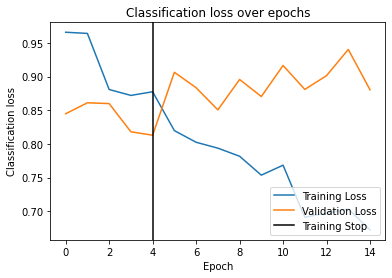

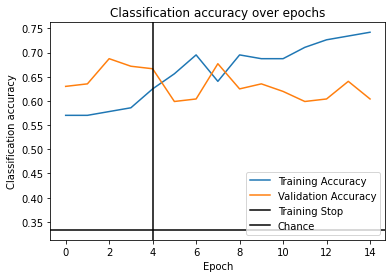

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 1.0238 - acc: 0.5156 - val_loss: 0.7891 - val_acc: 0.7135
Epoch 2/50 0.237s 	 loss: 0.9188 - acc: 0.6016 - val_loss: 0.7811 - val_acc: 0.6875
Epoch 3/50 0.235s 	 loss: 0.9027 - acc: 0.6328 - val_loss: 0.8120 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.8462 - acc: 0.6250 - val_loss: 0.8601 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.8419 - acc: 0.6562 - val_loss: 0.8538 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.237s 	 loss: 0.8171 - acc: 0.6406 - val_loss: 0.9105 - val_acc: 0.5573
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.240s 	 loss: 0.7530 - acc: 0.7109 - val_loss: 0.9275 - val_acc: 0.6458
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.237s 	 loss: 0.7515 - acc: 0.6797 - val_loss: 0.9129 - val_acc: 0.6146
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.235s 	 loss: 0.7609 - acc: 0.73

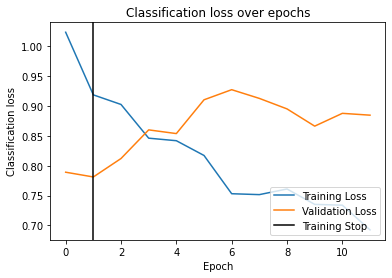

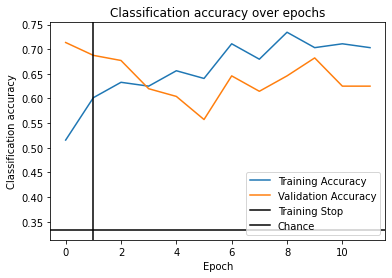

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8343 - acc: 0.6172 - val_loss: 1.1701 - val_acc: 0.4948
Epoch 2/50 0.232s 	 loss: 0.7550 - acc: 0.6953 - val_loss: 1.1430 - val_acc: 0.4844
Epoch 3/50 0.238s 	 loss: 0.7565 - acc: 0.6797 - val_loss: 1.1189 - val_acc: 0.4583
Epoch 4/50 0.239s 	 loss: 0.7295 - acc: 0.6875 - val_loss: 1.1812 - val_acc: 0.3906
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.7029 - acc: 0.7031 - val_loss: 1.2177 - val_acc: 0.3958
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.6973 - acc: 0.6953 - val_loss: 1.1551 - val_acc: 0.5000
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.6612 - acc: 0.7188 - val_loss: 1.2355 - val_acc: 0.4688
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.242s 	 loss: 0.6321 - acc: 0.7344 - val_loss: 1.2772 - val_acc: 0.4375
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.235s 	 loss: 0.6224 - acc: 0.7500 - val_loss: 1.1701 - val_acc: 0.

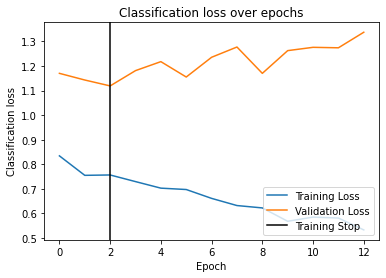

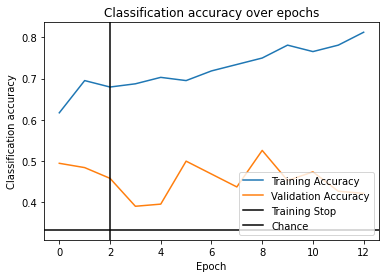

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8350 - acc: 0.5859 - val_loss: 0.6267 - val_acc: 0.7344
Epoch 2/50 0.242s 	 loss: 0.7647 - acc: 0.6406 - val_loss: 0.6427 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.6352 - acc: 0.7812 - val_loss: 0.6009 - val_acc: 0.7188
Epoch 4/50 0.232s 	 loss: 0.6447 - acc: 0.7188 - val_loss: 0.6863 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.5942 - acc: 0.7812 - val_loss: 0.5940 - val_acc: 0.7344
Epoch 6/50 0.234s 	 loss: 0.6046 - acc: 0.7969 - val_loss: 0.6414 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.5525 - acc: 0.7734 - val_loss: 0.6184 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.238s 	 loss: 0.5420 - acc: 0.8047 - val_loss: 0.6674 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.5359 - acc: 0.8047 - val_loss: 0.6987 - val_acc: 0.

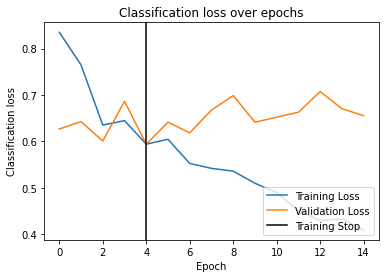

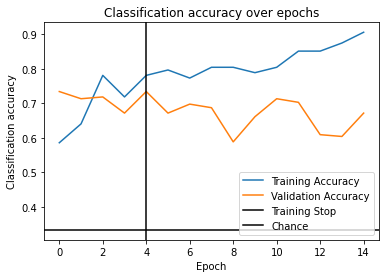

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8609 - acc: 0.6094 - val_loss: 0.7268 - val_acc: 0.6771
Epoch 2/50 0.235s 	 loss: 0.7330 - acc: 0.6484 - val_loss: 0.6519 - val_acc: 0.7031
Epoch 3/50 0.234s 	 loss: 0.6979 - acc: 0.6719 - val_loss: 0.6509 - val_acc: 0.7083
Epoch 4/50 0.236s 	 loss: 0.6329 - acc: 0.7109 - val_loss: 0.6497 - val_acc: 0.7396
Epoch 5/50 0.233s 	 loss: 0.6058 - acc: 0.7500 - val_loss: 0.6709 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.6122 - acc: 0.7422 - val_loss: 0.5839 - val_acc: 0.7656
Epoch 7/50 0.235s 	 loss: 0.5766 - acc: 0.7500 - val_loss: 0.6476 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.5562 - acc: 0.7500 - val_loss: 0.5605 - val_acc: 0.7344
Epoch 9/50 0.244s 	 loss: 0.5386 - acc: 0.7734 - val_loss: 0.6460 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.231s 	 loss: 0.4947 - acc: 0.8203 - val_loss: 0.659

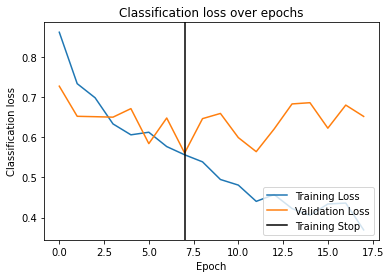

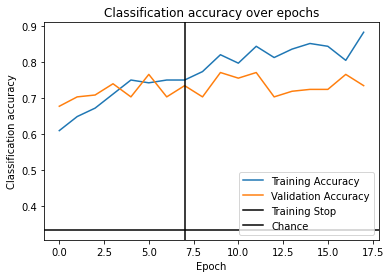

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.245s 	 loss: 0.6797 - acc: 0.7109 - val_loss: 0.9644 - val_acc: 0.5000
Epoch 2/50 0.233s 	 loss: 0.6107 - acc: 0.7188 - val_loss: 1.0250 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.5530 - acc: 0.7734 - val_loss: 1.0049 - val_acc: 0.4635
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.5305 - acc: 0.8047 - val_loss: 0.9377 - val_acc: 0.5000
Epoch 5/50 0.232s 	 loss: 0.4886 - acc: 0.8203 - val_loss: 0.9488 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.4586 - acc: 0.8594 - val_loss: 0.8755 - val_acc: 0.5833
Epoch 7/50 0.238s 	 loss: 0.4781 - acc: 0.8203 - val_loss: 0.9326 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.4567 - acc: 0.8516 - val_loss: 0.8890 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.4556 - acc: 0.8438 - val_loss: 0.8249 - val_acc: 0.

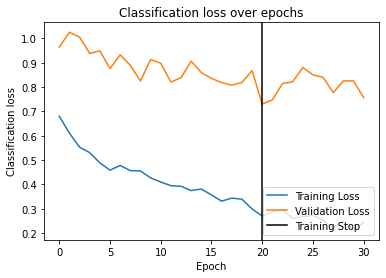

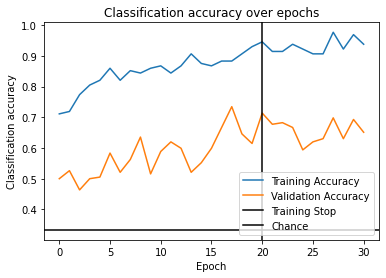

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.9298 - acc: 0.5391 - val_loss: 1.0407 - val_acc: 0.5156
Epoch 2/50 0.237s 	 loss: 0.8933 - acc: 0.5703 - val_loss: 0.9871 - val_acc: 0.5729
Epoch 3/50 0.231s 	 loss: 0.8189 - acc: 0.6406 - val_loss: 1.0588 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.232s 	 loss: 0.7895 - acc: 0.6562 - val_loss: 0.9877 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.7662 - acc: 0.6172 - val_loss: 1.0602 - val_acc: 0.5052
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.7683 - acc: 0.6562 - val_loss: 1.0873 - val_acc: 0.4896
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.233s 	 loss: 0.7241 - acc: 0.6797 - val_loss: 1.1375 - val_acc: 0.4896
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.236s 	 loss: 0.7038 - acc: 0.6719 - val_loss: 1.0915 - val_acc: 0.5938
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.237s 	 loss: 0.6450 - acc: 0.70

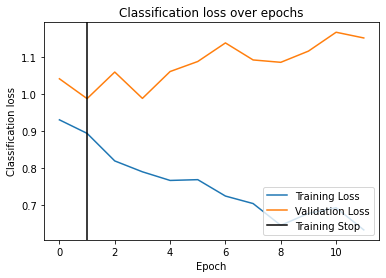

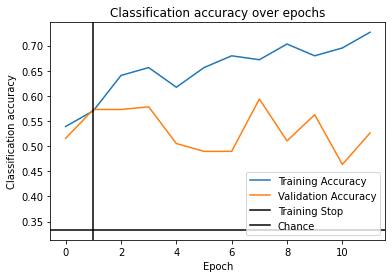

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9878 - acc: 0.5078 - val_loss: 0.9630 - val_acc: 0.5938
Epoch 2/50 0.232s 	 loss: 0.9346 - acc: 0.5469 - val_loss: 0.9579 - val_acc: 0.4792
Epoch 3/50 0.232s 	 loss: 0.9487 - acc: 0.5469 - val_loss: 0.9068 - val_acc: 0.6094
Epoch 4/50 0.234s 	 loss: 0.8612 - acc: 0.6016 - val_loss: 0.8021 - val_acc: 0.5938
Epoch 5/50 0.233s 	 loss: 0.8893 - acc: 0.5625 - val_loss: 0.8815 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.8273 - acc: 0.6406 - val_loss: 0.8607 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.8214 - acc: 0.6406 - val_loss: 0.9104 - val_acc: 0.6094
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.7909 - acc: 0.6484 - val_loss: 0.8842 - val_acc: 0.6146
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.233s 	 loss: 0.8226 - acc: 0.6250 - val_loss: 0.8876 - val_acc: 0.6094
EarlyStopping counter: 5 out o

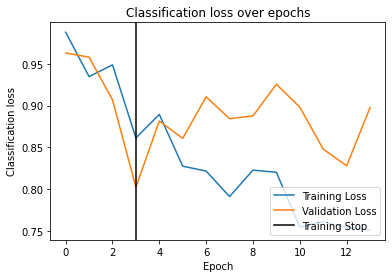

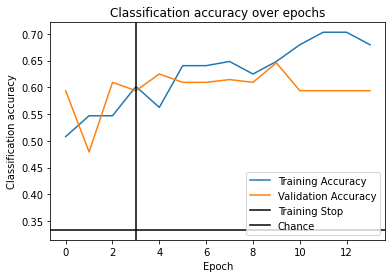

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.0136 - acc: 0.5234 - val_loss: 0.9394 - val_acc: 0.5781
Epoch 2/50 0.234s 	 loss: 0.9676 - acc: 0.5156 - val_loss: 0.9601 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.9370 - acc: 0.5625 - val_loss: 0.9858 - val_acc: 0.5208
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.8915 - acc: 0.5703 - val_loss: 0.9440 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.8910 - acc: 0.6016 - val_loss: 0.8958 - val_acc: 0.5573
Epoch 6/50 0.237s 	 loss: 0.8651 - acc: 0.6250 - val_loss: 0.9576 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.8458 - acc: 0.6484 - val_loss: 0.9959 - val_acc: 0.5208
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.240s 	 loss: 0.8290 - acc: 0.6641 - val_loss: 0.9718 - val_acc: 0.5156
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.7927 - acc: 0.65

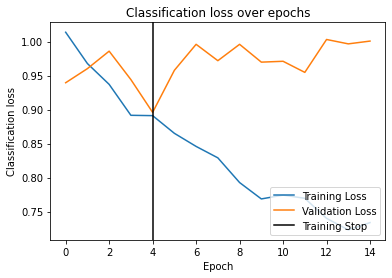

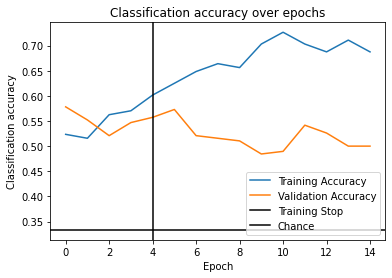

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.230s 	 loss: 1.0147 - acc: 0.5312 - val_loss: 0.6344 - val_acc: 0.7500
Epoch 2/50 0.235s 	 loss: 0.8790 - acc: 0.5781 - val_loss: 0.5854 - val_acc: 0.8021
Epoch 3/50 0.238s 	 loss: 0.8191 - acc: 0.6484 - val_loss: 0.5895 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.8314 - acc: 0.6328 - val_loss: 0.6097 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.249s 	 loss: 0.7545 - acc: 0.6484 - val_loss: 0.5978 - val_acc: 0.7969
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.234s 	 loss: 0.7300 - acc: 0.6719 - val_loss: 0.6219 - val_acc: 0.7552
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.242s 	 loss: 0.6568 - acc: 0.6641 - val_loss: 0.5996 - val_acc: 0.7708
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.233s 	 loss: 0.6728 - acc: 0.7109 - val_loss: 0.6031 - val_acc: 0.7344
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.234s 	 loss: 0.6473 - acc: 0.70

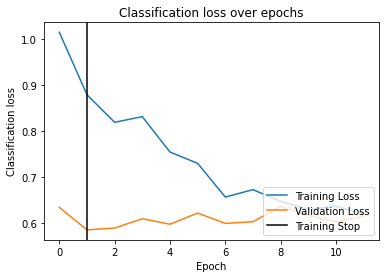

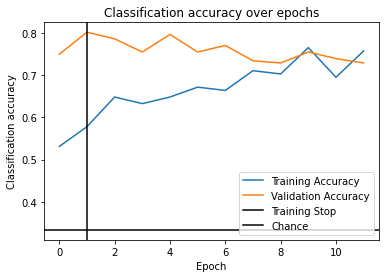

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8901 - acc: 0.5859 - val_loss: 0.9234 - val_acc: 0.5885
Epoch 2/50 0.233s 	 loss: 0.8226 - acc: 0.6328 - val_loss: 0.8649 - val_acc: 0.5938
Epoch 3/50 0.231s 	 loss: 0.7700 - acc: 0.6562 - val_loss: 0.8489 - val_acc: 0.6562
Epoch 4/50 0.236s 	 loss: 0.7448 - acc: 0.6562 - val_loss: 0.7524 - val_acc: 0.6562
Epoch 5/50 0.235s 	 loss: 0.6566 - acc: 0.7109 - val_loss: 0.8364 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.6305 - acc: 0.7188 - val_loss: 0.8154 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.6159 - acc: 0.7422 - val_loss: 0.7490 - val_acc: 0.6615
Epoch 8/50 0.237s 	 loss: 0.5925 - acc: 0.7656 - val_loss: 0.8604 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.6117 - acc: 0.7422 - val_loss: 0.8051 - val_acc: 0.7031
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.241s 	 loss: 0.5

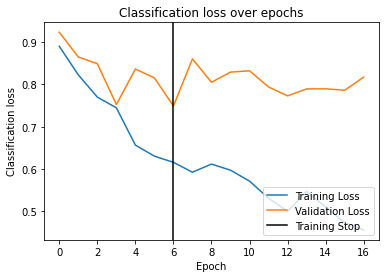

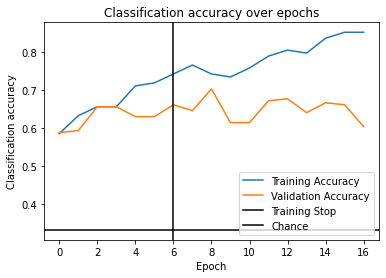

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.7785 - acc: 0.6719 - val_loss: 1.0250 - val_acc: 0.5000
Epoch 2/50 0.234s 	 loss: 0.6837 - acc: 0.6953 - val_loss: 1.0240 - val_acc: 0.4844
Epoch 3/50 0.237s 	 loss: 0.6226 - acc: 0.7344 - val_loss: 1.0264 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.5701 - acc: 0.7969 - val_loss: 0.9809 - val_acc: 0.5312
Epoch 5/50 0.234s 	 loss: 0.5710 - acc: 0.7812 - val_loss: 0.9369 - val_acc: 0.5469
Epoch 6/50 0.238s 	 loss: 0.5530 - acc: 0.7812 - val_loss: 0.9611 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.5113 - acc: 0.8125 - val_loss: 0.9543 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.234s 	 loss: 0.4954 - acc: 0.8281 - val_loss: 0.9979 - val_acc: 0.5312
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.4442 - acc: 0.8750 - val_loss: 1.0018 - val_acc: 0.5469
EarlyStopping counter: 4 out o

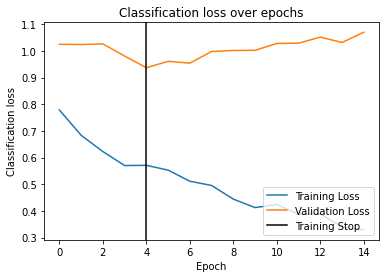

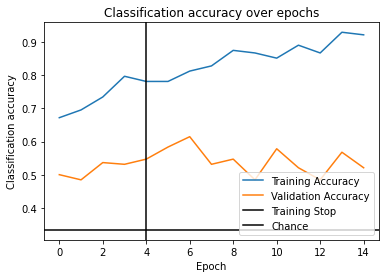

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.2415 - acc: 0.4688 - val_loss: 0.8590 - val_acc: 0.6042
Epoch 2/50 0.236s 	 loss: 1.0140 - acc: 0.4453 - val_loss: 0.8323 - val_acc: 0.6302
Epoch 3/50 0.238s 	 loss: 0.8828 - acc: 0.5859 - val_loss: 0.8238 - val_acc: 0.6615
Epoch 4/50 0.232s 	 loss: 0.8479 - acc: 0.6250 - val_loss: 0.9018 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.7730 - acc: 0.6953 - val_loss: 0.8351 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.240s 	 loss: 0.8064 - acc: 0.6172 - val_loss: 0.9151 - val_acc: 0.5312
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.7760 - acc: 0.6562 - val_loss: 0.8468 - val_acc: 0.5938
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.234s 	 loss: 0.7502 - acc: 0.7031 - val_loss: 0.8891 - val_acc: 0.5625
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.233s 	 loss: 0.7714 - acc: 0.6641 - val_loss: 0.8156 - val_acc: 0.

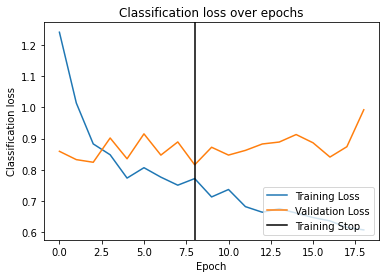

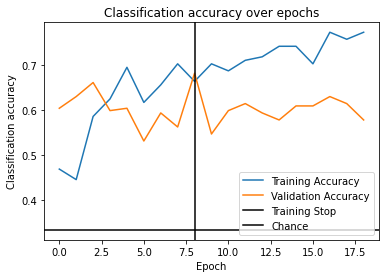

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9721 - acc: 0.5391 - val_loss: 1.4163 - val_acc: 0.4115
Epoch 2/50 0.232s 	 loss: 0.8429 - acc: 0.6250 - val_loss: 1.3403 - val_acc: 0.4167
Epoch 3/50 0.235s 	 loss: 0.8524 - acc: 0.5859 - val_loss: 1.2460 - val_acc: 0.4427
Epoch 4/50 0.249s 	 loss: 0.7472 - acc: 0.6719 - val_loss: 1.2164 - val_acc: 0.4896
Epoch 5/50 0.236s 	 loss: 0.7420 - acc: 0.6875 - val_loss: 1.1585 - val_acc: 0.4323
Epoch 6/50 0.237s 	 loss: 0.6722 - acc: 0.7109 - val_loss: 1.1229 - val_acc: 0.5052
Epoch 7/50 0.236s 	 loss: 0.6502 - acc: 0.7422 - val_loss: 1.1470 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.6497 - acc: 0.7266 - val_loss: 1.1237 - val_acc: 0.4635
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.6205 - acc: 0.7734 - val_loss: 1.0683 - val_acc: 0.5000
Epoch 10/50 0.235s 	 loss: 0.5919 - acc: 0.7578 - val_loss: 1.1290 - val_acc: 0.5260
EarlyStopping c

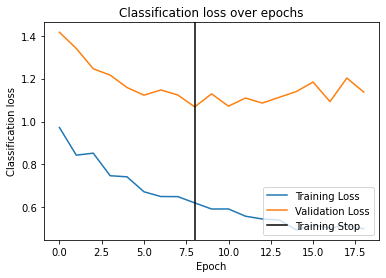

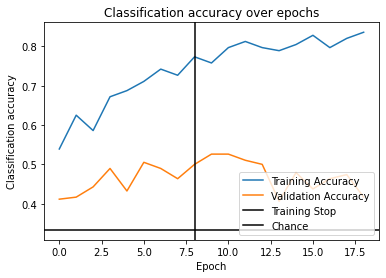

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.1435 - acc: 0.5000 - val_loss: 0.9483 - val_acc: 0.5625
Epoch 2/50 0.234s 	 loss: 0.9356 - acc: 0.6016 - val_loss: 0.8986 - val_acc: 0.5625
Epoch 3/50 0.232s 	 loss: 0.8923 - acc: 0.5859 - val_loss: 0.8475 - val_acc: 0.5573
Epoch 4/50 0.233s 	 loss: 0.8840 - acc: 0.5703 - val_loss: 0.8189 - val_acc: 0.6667
Epoch 5/50 0.236s 	 loss: 0.8165 - acc: 0.6562 - val_loss: 0.8258 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.7832 - acc: 0.6875 - val_loss: 0.7929 - val_acc: 0.7500
Epoch 7/50 0.232s 	 loss: 0.7505 - acc: 0.7188 - val_loss: 0.8126 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.248s 	 loss: 0.7247 - acc: 0.6875 - val_loss: 0.8641 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.234s 	 loss: 0.6777 - acc: 0.7266 - val_loss: 0.7831 - val_acc: 0.6406
Epoch 10/50 0.237s 	 loss: 0.6603 - acc: 0.7812 - val_loss: 0.852

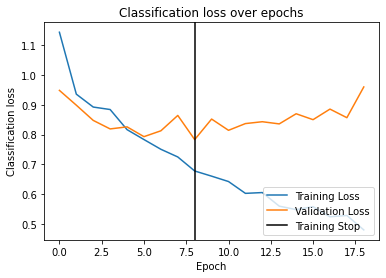

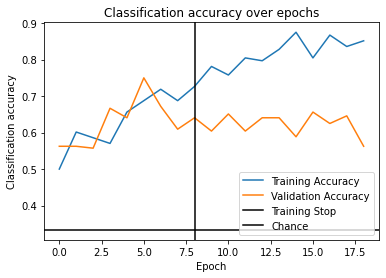

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8401 - acc: 0.5938 - val_loss: 0.8808 - val_acc: 0.5365
Epoch 2/50 0.237s 	 loss: 0.7817 - acc: 0.6250 - val_loss: 0.8937 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.7758 - acc: 0.6250 - val_loss: 0.8468 - val_acc: 0.5990
Epoch 4/50 0.233s 	 loss: 0.7317 - acc: 0.6875 - val_loss: 0.8793 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7034 - acc: 0.6797 - val_loss: 0.8561 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.7044 - acc: 0.7266 - val_loss: 0.9517 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.6614 - acc: 0.7500 - val_loss: 0.8298 - val_acc: 0.6354
Epoch 8/50 0.240s 	 loss: 0.6542 - acc: 0.6797 - val_loss: 0.8733 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.6571 - acc: 0.7266 - val_loss: 0.8836 - val_acc: 0.

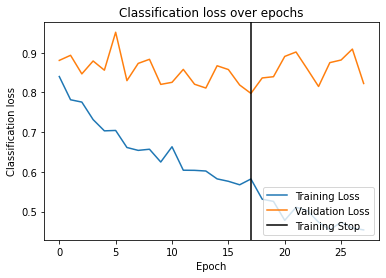

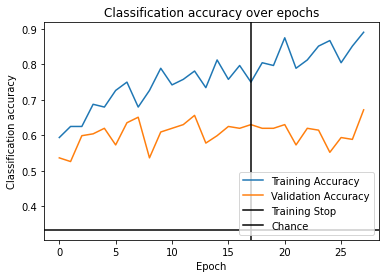

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8501 - acc: 0.6094 - val_loss: 0.8971 - val_acc: 0.5573
Epoch 2/50 0.232s 	 loss: 0.7841 - acc: 0.6484 - val_loss: 0.9005 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.8007 - acc: 0.6172 - val_loss: 0.8967 - val_acc: 0.5365
Epoch 4/50 0.235s 	 loss: 0.7323 - acc: 0.6953 - val_loss: 0.9372 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7249 - acc: 0.6641 - val_loss: 0.9528 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.239s 	 loss: 0.6797 - acc: 0.7109 - val_loss: 0.9103 - val_acc: 0.5885
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.235s 	 loss: 0.6471 - acc: 0.7344 - val_loss: 0.9007 - val_acc: 0.5990
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.239s 	 loss: 0.6507 - acc: 0.7656 - val_loss: 0.8746 - val_acc: 0.5781
Epoch 9/50 0.234s 	 loss: 0.6487 - acc: 0.7578 - val_loss: 0.9027 - val_acc: 0.

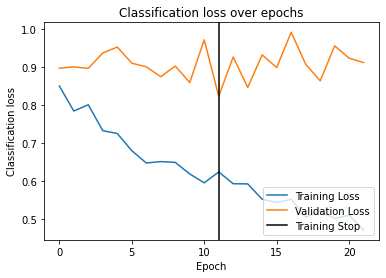

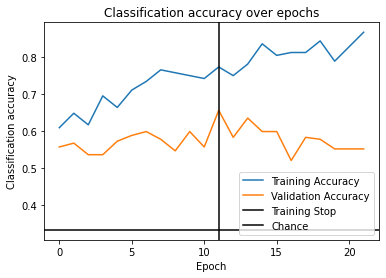

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8936 - acc: 0.5625 - val_loss: 0.7552 - val_acc: 0.7031
Epoch 2/50 0.232s 	 loss: 0.8832 - acc: 0.5547 - val_loss: 0.8311 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8202 - acc: 0.5859 - val_loss: 0.7665 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.237s 	 loss: 0.7799 - acc: 0.6406 - val_loss: 0.7737 - val_acc: 0.6354
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.238s 	 loss: 0.7717 - acc: 0.6406 - val_loss: 0.7499 - val_acc: 0.6875
Epoch 6/50 0.236s 	 loss: 0.7494 - acc: 0.6797 - val_loss: 0.7897 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.7077 - acc: 0.6797 - val_loss: 0.8209 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.240s 	 loss: 0.6982 - acc: 0.7031 - val_loss: 0.7773 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.6696 - acc: 0.75

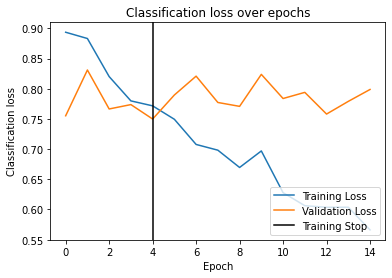

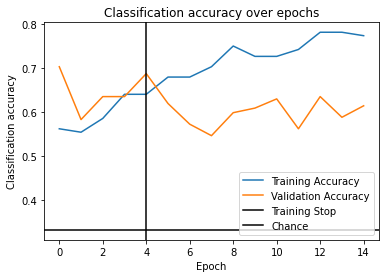

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8012 - acc: 0.7031 - val_loss: 0.7484 - val_acc: 0.6823
Epoch 2/50 0.232s 	 loss: 0.7471 - acc: 0.6875 - val_loss: 0.7187 - val_acc: 0.6719
Epoch 3/50 0.233s 	 loss: 0.6661 - acc: 0.6797 - val_loss: 0.7003 - val_acc: 0.7344
Epoch 4/50 0.241s 	 loss: 0.6799 - acc: 0.7266 - val_loss: 0.6619 - val_acc: 0.7760
Epoch 5/50 0.231s 	 loss: 0.6660 - acc: 0.7109 - val_loss: 0.6200 - val_acc: 0.8021
Epoch 6/50 0.235s 	 loss: 0.6173 - acc: 0.7734 - val_loss: 0.6374 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.248s 	 loss: 0.6031 - acc: 0.7656 - val_loss: 0.6218 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.231s 	 loss: 0.5801 - acc: 0.7500 - val_loss: 0.6312 - val_acc: 0.7240
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.235s 	 loss: 0.5624 - acc: 0.7969 - val_loss: 0.5410 - val_acc: 0.7760
Epoch 10/50 0.232s 	 loss: 0.5508 - acc: 0.7891 - val_loss: 0.640

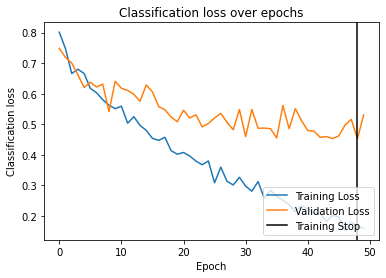

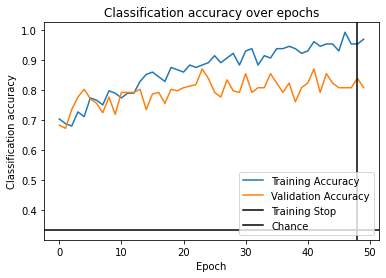

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7899 - acc: 0.6328 - val_loss: 0.9001 - val_acc: 0.5208
Epoch 2/50 0.237s 	 loss: 0.7105 - acc: 0.6797 - val_loss: 0.8012 - val_acc: 0.6406
Epoch 3/50 0.236s 	 loss: 0.6591 - acc: 0.7422 - val_loss: 0.8095 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.244s 	 loss: 0.6270 - acc: 0.7812 - val_loss: 0.7725 - val_acc: 0.6927
Epoch 5/50 0.239s 	 loss: 0.6310 - acc: 0.7422 - val_loss: 0.7316 - val_acc: 0.6615
Epoch 6/50 0.238s 	 loss: 0.5933 - acc: 0.7734 - val_loss: 0.7684 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.241s 	 loss: 0.5719 - acc: 0.7578 - val_loss: 0.7084 - val_acc: 0.6927
Epoch 8/50 0.247s 	 loss: 0.5502 - acc: 0.7969 - val_loss: 0.6754 - val_acc: 0.7292
Epoch 9/50 0.233s 	 loss: 0.5238 - acc: 0.8359 - val_loss: 0.6698 - val_acc: 0.7344
Epoch 10/50 0.237s 	 loss: 0.5004 - acc: 0.8125 - val_loss: 0.7053 - val_acc: 0.6823
EarlyStopping c

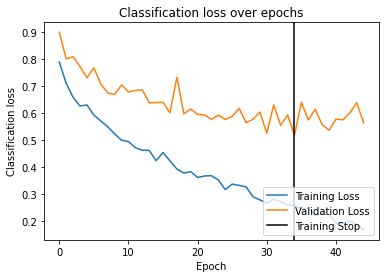

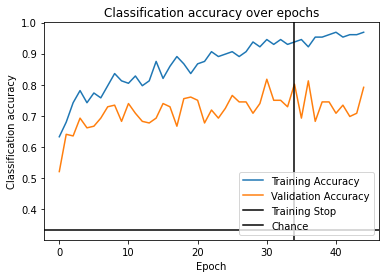

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8009 - acc: 0.6562 - val_loss: 0.7883 - val_acc: 0.6771
Epoch 2/50 0.229s 	 loss: 0.7136 - acc: 0.6953 - val_loss: 0.7314 - val_acc: 0.7135
Epoch 3/50 0.234s 	 loss: 0.6398 - acc: 0.7344 - val_loss: 0.7535 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.6406 - acc: 0.7031 - val_loss: 0.7091 - val_acc: 0.6562
Epoch 5/50 0.238s 	 loss: 0.5780 - acc: 0.7891 - val_loss: 0.6830 - val_acc: 0.6927
Epoch 6/50 0.236s 	 loss: 0.5420 - acc: 0.8281 - val_loss: 0.7132 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.5293 - acc: 0.8203 - val_loss: 0.7066 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.240s 	 loss: 0.5068 - acc: 0.8359 - val_loss: 0.7022 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.235s 	 loss: 0.4745 - acc: 0.8516 - val_loss: 0.6773 - val_acc: 0.7448
Epoch 10/50 0.234s 	 loss: 0.4

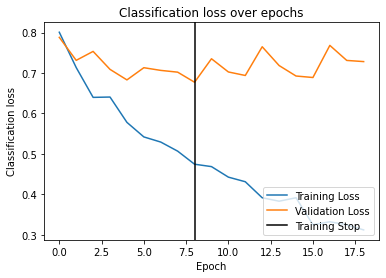

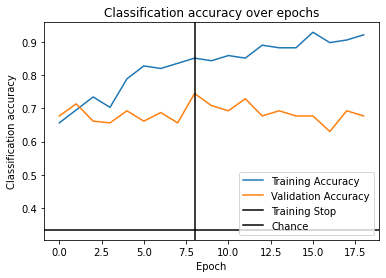

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.5992 - acc: 0.7734 - val_loss: 0.4655 - val_acc: 0.8750
Epoch 2/50 0.235s 	 loss: 0.5175 - acc: 0.8125 - val_loss: 0.3931 - val_acc: 0.9062
Epoch 3/50 0.235s 	 loss: 0.4898 - acc: 0.8438 - val_loss: 0.3723 - val_acc: 0.9375
Epoch 4/50 0.233s 	 loss: 0.4458 - acc: 0.8359 - val_loss: 0.3502 - val_acc: 0.9219
Epoch 5/50 0.234s 	 loss: 0.4220 - acc: 0.8828 - val_loss: 0.3386 - val_acc: 0.9375
Epoch 6/50 0.239s 	 loss: 0.3917 - acc: 0.8906 - val_loss: 0.3246 - val_acc: 0.9062
Epoch 7/50 0.239s 	 loss: 0.3695 - acc: 0.9062 - val_loss: 0.3182 - val_acc: 0.9375
Epoch 8/50 0.234s 	 loss: 0.3357 - acc: 0.8828 - val_loss: 0.2912 - val_acc: 0.9375
Epoch 9/50 0.231s 	 loss: 0.3394 - acc: 0.8906 - val_loss: 0.2581 - val_acc: 0.9531
Epoch 10/50 0.233s 	 loss: 0.2979 - acc: 0.9141 - val_loss: 0.2348 - val_acc: 0.9531
Epoch 11/50 0.237s 	 loss: 0.2930 - acc: 0.9297 - val_loss: 0.2670 - val_acc: 0.9375


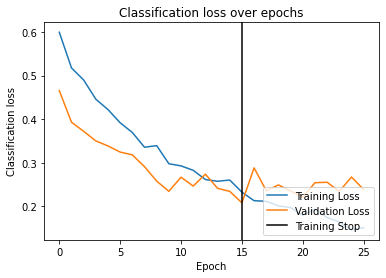

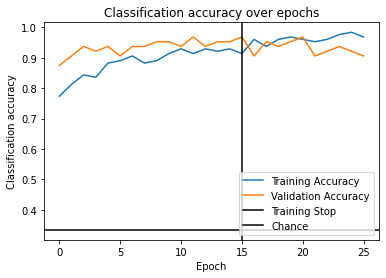

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.5465 - acc: 0.8125 - val_loss: 0.5677 - val_acc: 0.8125
Epoch 2/50 0.235s 	 loss: 0.5016 - acc: 0.8203 - val_loss: 0.4857 - val_acc: 0.8177
Epoch 3/50 0.234s 	 loss: 0.4695 - acc: 0.8516 - val_loss: 0.4948 - val_acc: 0.8385
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.4354 - acc: 0.8438 - val_loss: 0.4555 - val_acc: 0.8333
Epoch 5/50 0.246s 	 loss: 0.3750 - acc: 0.9062 - val_loss: 0.4685 - val_acc: 0.8333
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.3455 - acc: 0.9141 - val_loss: 0.4142 - val_acc: 0.8490
Epoch 7/50 0.231s 	 loss: 0.3329 - acc: 0.9297 - val_loss: 0.4397 - val_acc: 0.8542
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.2860 - acc: 0.9297 - val_loss: 0.3942 - val_acc: 0.8854
Epoch 9/50 0.237s 	 loss: 0.2707 - acc: 0.9297 - val_loss: 0.3688 - val_acc: 0.8490
Epoch 10/50 0.231s 	 loss: 0.2713 - acc: 0.9297 - val_loss: 0.363

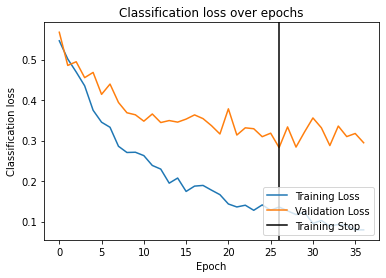

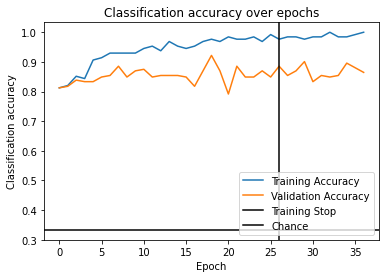

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.5255 - acc: 0.8125 - val_loss: 0.5717 - val_acc: 0.7708
Epoch 2/50 0.234s 	 loss: 0.4812 - acc: 0.8438 - val_loss: 0.5722 - val_acc: 0.7917
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.4114 - acc: 0.8594 - val_loss: 0.5283 - val_acc: 0.7656
Epoch 4/50 0.235s 	 loss: 0.3711 - acc: 0.8984 - val_loss: 0.4932 - val_acc: 0.7865
Epoch 5/50 0.236s 	 loss: 0.3612 - acc: 0.8984 - val_loss: 0.5002 - val_acc: 0.8021
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.242s 	 loss: 0.3199 - acc: 0.9062 - val_loss: 0.4870 - val_acc: 0.7708
Epoch 7/50 0.233s 	 loss: 0.2918 - acc: 0.9297 - val_loss: 0.4636 - val_acc: 0.8021
Epoch 8/50 0.240s 	 loss: 0.2893 - acc: 0.9297 - val_loss: 0.4228 - val_acc: 0.8385
Epoch 9/50 0.234s 	 loss: 0.2608 - acc: 0.9531 - val_loss: 0.4270 - val_acc: 0.8021
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.232s 	 loss: 0.2341 - acc: 0.9531 - val_loss: 0.447

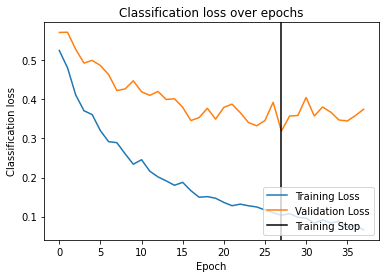

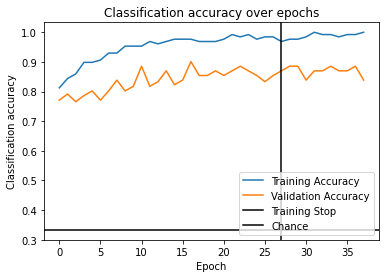

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5737 - acc: 0.7656 - val_loss: 0.6608 - val_acc: 0.7292
Epoch 2/50 0.239s 	 loss: 0.5329 - acc: 0.8203 - val_loss: 0.6775 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.243s 	 loss: 0.5013 - acc: 0.8359 - val_loss: 0.6799 - val_acc: 0.7448
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.4616 - acc: 0.8672 - val_loss: 0.6613 - val_acc: 0.7604
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.235s 	 loss: 0.4344 - acc: 0.8594 - val_loss: 0.6303 - val_acc: 0.7760
Epoch 6/50 0.232s 	 loss: 0.3911 - acc: 0.8984 - val_loss: 0.6114 - val_acc: 0.7448
Epoch 7/50 0.235s 	 loss: 0.3761 - acc: 0.9062 - val_loss: 0.6607 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.3703 - acc: 0.8984 - val_loss: 0.5928 - val_acc: 0.7760
Epoch 9/50 0.235s 	 loss: 0.3389 - acc: 0.9531 - val_loss: 0.6951 - val_acc: 0.7604
EarlyStopping counter: 1 out o

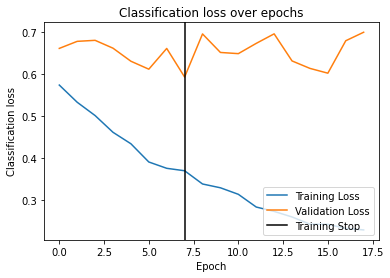

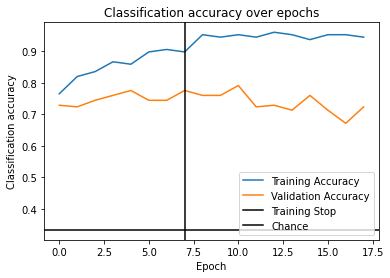

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.6250 - acc: 0.7969 - val_loss: 0.5182 - val_acc: 0.8281
Epoch 2/50 0.242s 	 loss: 0.5819 - acc: 0.8125 - val_loss: 0.5383 - val_acc: 0.8281
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.5201 - acc: 0.8203 - val_loss: 0.4913 - val_acc: 0.8229
Epoch 4/50 0.236s 	 loss: 0.4861 - acc: 0.8359 - val_loss: 0.4822 - val_acc: 0.8385
Epoch 5/50 0.245s 	 loss: 0.4604 - acc: 0.8438 - val_loss: 0.4801 - val_acc: 0.8281
Epoch 6/50 0.234s 	 loss: 0.4307 - acc: 0.8828 - val_loss: 0.4758 - val_acc: 0.8594
Epoch 7/50 0.235s 	 loss: 0.4386 - acc: 0.8828 - val_loss: 0.4653 - val_acc: 0.8125
Epoch 8/50 0.231s 	 loss: 0.4057 - acc: 0.8750 - val_loss: 0.4925 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.3914 - acc: 0.9062 - val_loss: 0.4503 - val_acc: 0.8594
Epoch 10/50 0.232s 	 loss: 0.3912 - acc: 0.8750 - val_loss: 0.4365 - val_acc: 0.8750
Epoch 11/50 0.2

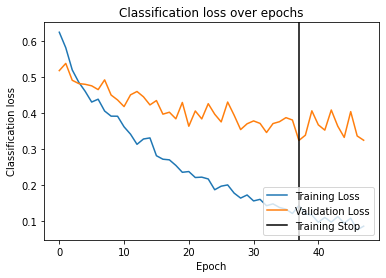

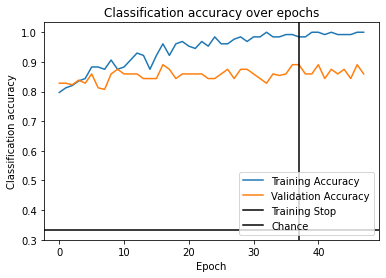

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.229s 	 loss: 0.6047 - acc: 0.7891 - val_loss: 0.5830 - val_acc: 0.7812
Epoch 2/50 0.238s 	 loss: 0.5711 - acc: 0.8125 - val_loss: 0.5674 - val_acc: 0.7865
Epoch 3/50 0.241s 	 loss: 0.5410 - acc: 0.8281 - val_loss: 0.5253 - val_acc: 0.7708
Epoch 4/50 0.235s 	 loss: 0.5165 - acc: 0.7891 - val_loss: 0.5409 - val_acc: 0.8333
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.4992 - acc: 0.8516 - val_loss: 0.5289 - val_acc: 0.8281
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.244s 	 loss: 0.4459 - acc: 0.8906 - val_loss: 0.5203 - val_acc: 0.8333
Epoch 7/50 0.241s 	 loss: 0.4249 - acc: 0.8594 - val_loss: 0.5648 - val_acc: 0.7969
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.232s 	 loss: 0.4123 - acc: 0.8750 - val_loss: 0.5312 - val_acc: 0.8125
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.3996 - acc: 0.8828 - val_loss: 0.5243 - val_acc: 0.8073
EarlyStopping counter: 3 out o

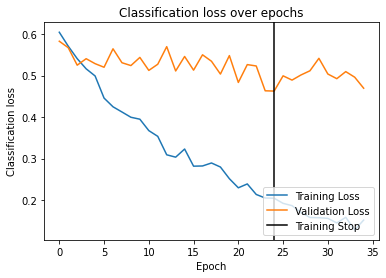

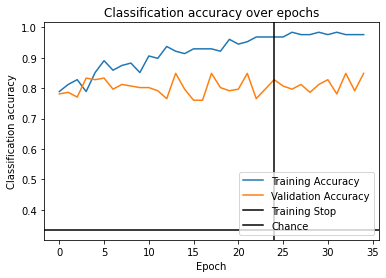

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.1237 - acc: 0.5156 - val_loss: 1.0454 - val_acc: 0.4844
Epoch 2/50 0.234s 	 loss: 1.0299 - acc: 0.5625 - val_loss: 1.0182 - val_acc: 0.5469
Epoch 3/50 0.234s 	 loss: 1.0586 - acc: 0.5312 - val_loss: 1.0254 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 1.0147 - acc: 0.5312 - val_loss: 0.9802 - val_acc: 0.5677
Epoch 5/50 0.232s 	 loss: 0.9876 - acc: 0.5938 - val_loss: 1.0328 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.9932 - acc: 0.5312 - val_loss: 1.0109 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.9480 - acc: 0.5938 - val_loss: 0.9496 - val_acc: 0.5885
Epoch 8/50 0.235s 	 loss: 0.9402 - acc: 0.5781 - val_loss: 0.9763 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.8893 - acc: 0.6016 - val_loss: 0.9828 - val_acc: 0.5156
EarlyStopping counter: 2 out o

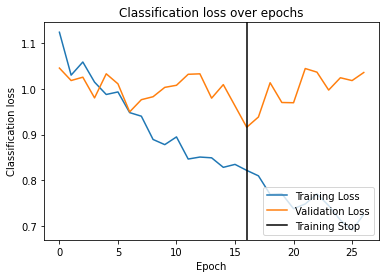

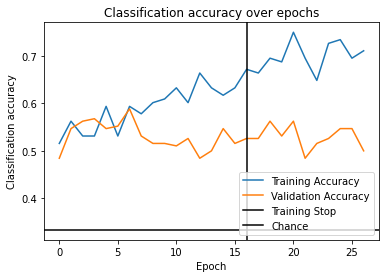

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.0946 - acc: 0.5391 - val_loss: 1.0949 - val_acc: 0.5469
Epoch 2/50 0.233s 	 loss: 1.0407 - acc: 0.5547 - val_loss: 1.0345 - val_acc: 0.4792
Epoch 3/50 0.233s 	 loss: 1.0217 - acc: 0.5781 - val_loss: 1.0994 - val_acc: 0.4792
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 1.0201 - acc: 0.5391 - val_loss: 1.0313 - val_acc: 0.4635
Epoch 5/50 0.233s 	 loss: 0.9659 - acc: 0.5859 - val_loss: 1.0858 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.244s 	 loss: 0.9220 - acc: 0.5859 - val_loss: 1.0948 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.9291 - acc: 0.5703 - val_loss: 1.1284 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.233s 	 loss: 0.9042 - acc: 0.5859 - val_loss: 1.0659 - val_acc: 0.5104
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.236s 	 loss: 0.8927 - acc: 0.6484 - val_loss: 1.1226 - val_acc: 0.

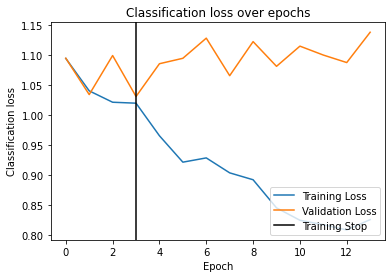

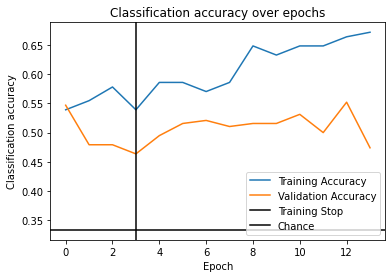

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0569 - acc: 0.5078 - val_loss: 1.1279 - val_acc: 0.5365
Epoch 2/50 0.230s 	 loss: 0.9882 - acc: 0.6016 - val_loss: 1.2137 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.9776 - acc: 0.5469 - val_loss: 1.0705 - val_acc: 0.4896
Epoch 4/50 0.236s 	 loss: 0.9505 - acc: 0.5469 - val_loss: 1.0953 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.9073 - acc: 0.5469 - val_loss: 1.1023 - val_acc: 0.4844
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.8885 - acc: 0.5625 - val_loss: 1.1350 - val_acc: 0.4844
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.8875 - acc: 0.5938 - val_loss: 1.1313 - val_acc: 0.4583
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.243s 	 loss: 0.8366 - acc: 0.6562 - val_loss: 1.0915 - val_acc: 0.5208
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.238s 	 loss: 0.8247 - acc: 0.65

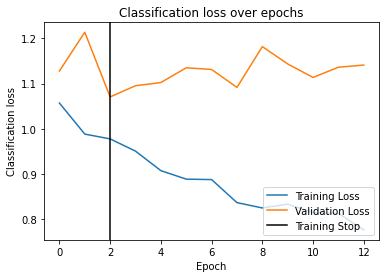

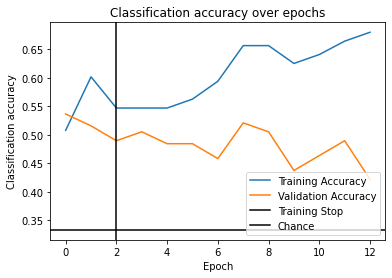

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8018 - acc: 0.6250 - val_loss: 0.9459 - val_acc: 0.5104
Epoch 2/50 0.236s 	 loss: 0.7231 - acc: 0.6797 - val_loss: 0.9426 - val_acc: 0.5208
Epoch 3/50 0.233s 	 loss: 0.6981 - acc: 0.7266 - val_loss: 0.9273 - val_acc: 0.5521
Epoch 4/50 0.232s 	 loss: 0.6435 - acc: 0.7031 - val_loss: 0.8880 - val_acc: 0.5885
Epoch 5/50 0.237s 	 loss: 0.5491 - acc: 0.7734 - val_loss: 0.8858 - val_acc: 0.5312
Epoch 6/50 0.234s 	 loss: 0.5632 - acc: 0.7734 - val_loss: 0.8921 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.4822 - acc: 0.8281 - val_loss: 0.8820 - val_acc: 0.5833
Epoch 8/50 0.229s 	 loss: 0.4679 - acc: 0.7969 - val_loss: 0.8397 - val_acc: 0.5156
Epoch 9/50 0.236s 	 loss: 0.4292 - acc: 0.8594 - val_loss: 0.8111 - val_acc: 0.6354
Epoch 10/50 0.236s 	 loss: 0.4073 - acc: 0.8516 - val_loss: 0.7730 - val_acc: 0.6146
Epoch 11/50 0.235s 	 loss: 0.3824 - acc: 0.8984 - 

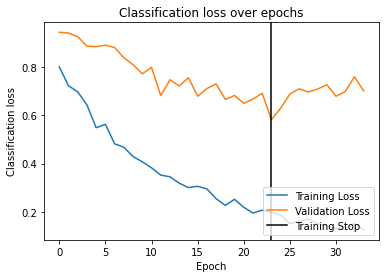

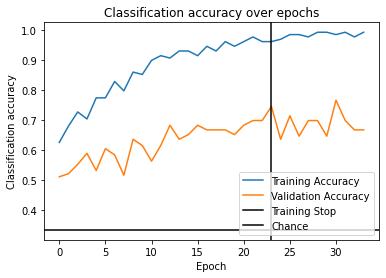

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8834 - acc: 0.5469 - val_loss: 0.7410 - val_acc: 0.7031
Epoch 2/50 0.232s 	 loss: 0.7904 - acc: 0.6719 - val_loss: 0.7435 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.243s 	 loss: 0.7811 - acc: 0.6172 - val_loss: 0.6870 - val_acc: 0.7500
Epoch 4/50 0.234s 	 loss: 0.6913 - acc: 0.6719 - val_loss: 0.6893 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.6764 - acc: 0.6953 - val_loss: 0.6282 - val_acc: 0.7292
Epoch 6/50 0.232s 	 loss: 0.6540 - acc: 0.7109 - val_loss: 0.6693 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.240s 	 loss: 0.5894 - acc: 0.7578 - val_loss: 0.6863 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.5404 - acc: 0.7891 - val_loss: 0.6460 - val_acc: 0.7656
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.236s 	 loss: 0.5123 - acc: 0.8203 - val_loss: 0.6171 - val_acc: 0.

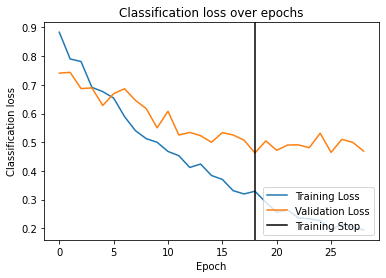

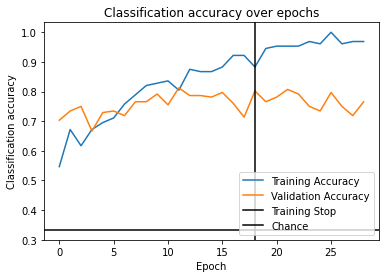

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8993 - acc: 0.5938 - val_loss: 0.8559 - val_acc: 0.6406
Epoch 2/50 0.235s 	 loss: 0.7881 - acc: 0.6406 - val_loss: 0.8281 - val_acc: 0.6042
Epoch 3/50 0.238s 	 loss: 0.7400 - acc: 0.6562 - val_loss: 0.7986 - val_acc: 0.6094
Epoch 4/50 0.236s 	 loss: 0.7037 - acc: 0.7266 - val_loss: 0.7226 - val_acc: 0.5938
Epoch 5/50 0.236s 	 loss: 0.6505 - acc: 0.7500 - val_loss: 0.7459 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.5809 - acc: 0.7812 - val_loss: 0.7371 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.245s 	 loss: 0.5562 - acc: 0.7812 - val_loss: 0.6435 - val_acc: 0.7448
Epoch 8/50 0.243s 	 loss: 0.5479 - acc: 0.7891 - val_loss: 0.6677 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.4866 - acc: 0.8281 - val_loss: 0.6619 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.236s 	 loss: 0.4

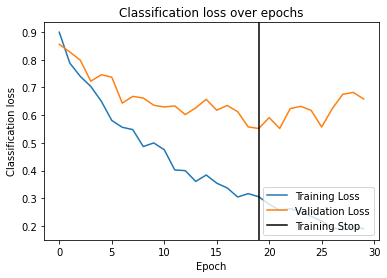

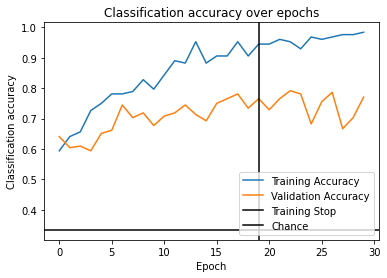

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8831 - acc: 0.5547 - val_loss: 0.8243 - val_acc: 0.6354
Epoch 2/50 0.232s 	 loss: 0.8170 - acc: 0.6250 - val_loss: 0.7767 - val_acc: 0.7188
Epoch 3/50 0.233s 	 loss: 0.7916 - acc: 0.6562 - val_loss: 0.7228 - val_acc: 0.7188
Epoch 4/50 0.235s 	 loss: 0.8053 - acc: 0.6094 - val_loss: 0.7390 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.7756 - acc: 0.6562 - val_loss: 0.7149 - val_acc: 0.6875
Epoch 6/50 0.232s 	 loss: 0.7338 - acc: 0.6875 - val_loss: 0.7606 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.7336 - acc: 0.6953 - val_loss: 0.7519 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.245s 	 loss: 0.7271 - acc: 0.7188 - val_loss: 0.7570 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.236s 	 loss: 0.6880 - acc: 0.7109 - val_loss: 0.7344 - val_acc: 0.6719
EarlyStopping counter: 4 out o

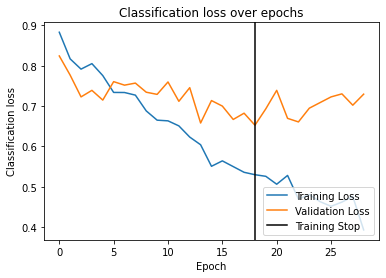

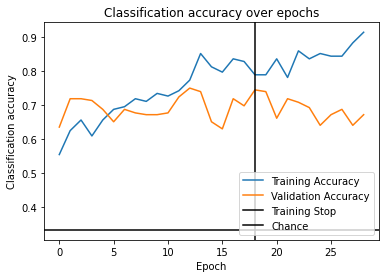

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8536 - acc: 0.6094 - val_loss: 0.7686 - val_acc: 0.6042
Epoch 2/50 0.235s 	 loss: 0.8273 - acc: 0.6953 - val_loss: 0.7558 - val_acc: 0.6354
Epoch 3/50 0.238s 	 loss: 0.8246 - acc: 0.6328 - val_loss: 0.7318 - val_acc: 0.6979
Epoch 4/50 0.246s 	 loss: 0.7800 - acc: 0.6641 - val_loss: 0.7323 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.7665 - acc: 0.7266 - val_loss: 0.7452 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.7919 - acc: 0.6797 - val_loss: 0.7467 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.7287 - acc: 0.7344 - val_loss: 0.7597 - val_acc: 0.6354
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.246s 	 loss: 0.7519 - acc: 0.6875 - val_loss: 0.7195 - val_acc: 0.6927
Epoch 9/50 0.234s 	 loss: 0.6962 - acc: 0.7891 - val_loss: 0.7423 - val_acc: 0.7188
EarlyStopping counter: 1 out o

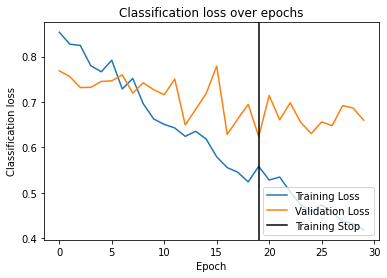

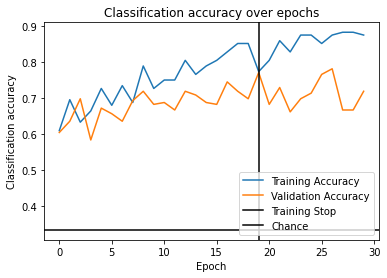

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8129 - acc: 0.6328 - val_loss: 0.8797 - val_acc: 0.5990
Epoch 2/50 0.237s 	 loss: 0.7694 - acc: 0.6484 - val_loss: 0.8507 - val_acc: 0.6094
Epoch 3/50 0.233s 	 loss: 0.7335 - acc: 0.6875 - val_loss: 0.9180 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.7010 - acc: 0.7188 - val_loss: 0.8617 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.242s 	 loss: 0.7116 - acc: 0.6953 - val_loss: 0.9190 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.6581 - acc: 0.7734 - val_loss: 0.9344 - val_acc: 0.5573
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.6588 - acc: 0.6875 - val_loss: 0.8757 - val_acc: 0.6146
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.255s 	 loss: 0.6499 - acc: 0.7344 - val_loss: 0.8828 - val_acc: 0.5885
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.245s 	 loss: 0.5840 - acc: 0.75

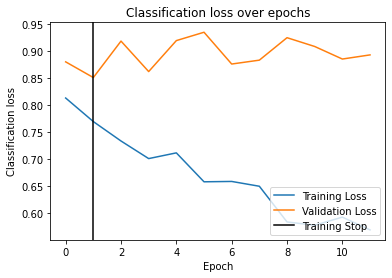

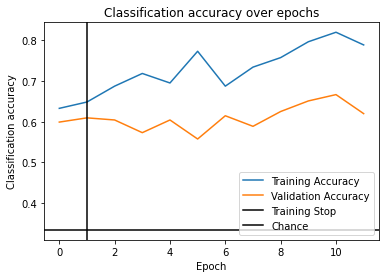

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8310 - acc: 0.5938 - val_loss: 0.9520 - val_acc: 0.5365
Epoch 2/50 0.237s 	 loss: 0.7987 - acc: 0.6328 - val_loss: 0.9407 - val_acc: 0.4896
Epoch 3/50 0.235s 	 loss: 0.7752 - acc: 0.6094 - val_loss: 0.9065 - val_acc: 0.5729
Epoch 4/50 0.237s 	 loss: 0.7235 - acc: 0.6484 - val_loss: 0.8968 - val_acc: 0.5260
Epoch 5/50 0.235s 	 loss: 0.6891 - acc: 0.6719 - val_loss: 0.9065 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6488 - acc: 0.6875 - val_loss: 0.9521 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.6567 - acc: 0.7188 - val_loss: 0.9743 - val_acc: 0.4844
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.237s 	 loss: 0.6222 - acc: 0.7266 - val_loss: 0.9794 - val_acc: 0.5312
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.236s 	 loss: 0.6319 - acc: 0.7031 - val_loss: 0.8515 - val_acc: 0.5833
Epoch 10/50 0.236s 	 loss: 0.5

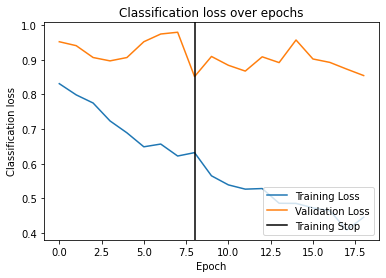

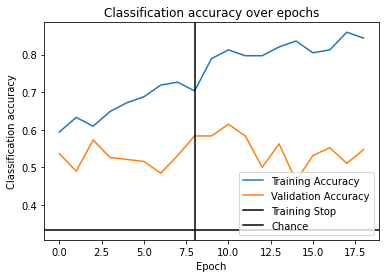

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.9682 - acc: 0.5469 - val_loss: 0.7869 - val_acc: 0.6094
Epoch 2/50 0.235s 	 loss: 0.8405 - acc: 0.5938 - val_loss: 0.7294 - val_acc: 0.6719
Epoch 3/50 0.232s 	 loss: 0.8010 - acc: 0.6016 - val_loss: 0.8065 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.7595 - acc: 0.6328 - val_loss: 0.7095 - val_acc: 0.6875
Epoch 5/50 0.239s 	 loss: 0.7327 - acc: 0.6406 - val_loss: 0.7779 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.7017 - acc: 0.6562 - val_loss: 0.7322 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.6764 - acc: 0.6562 - val_loss: 0.6982 - val_acc: 0.7396
Epoch 8/50 0.247s 	 loss: 0.6644 - acc: 0.7109 - val_loss: 0.6965 - val_acc: 0.6771
Epoch 9/50 0.234s 	 loss: 0.6280 - acc: 0.6719 - val_loss: 0.7225 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.6

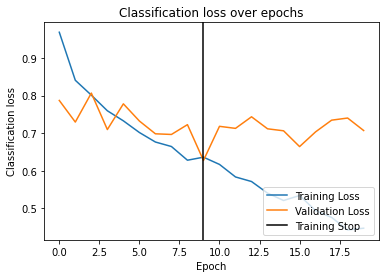

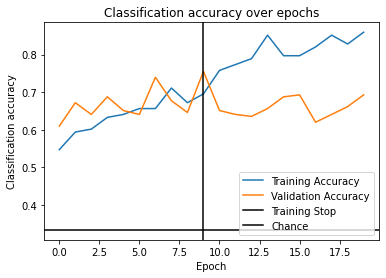

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8146 - acc: 0.5625 - val_loss: 0.8840 - val_acc: 0.5365
Epoch 2/50 0.231s 	 loss: 0.8126 - acc: 0.6094 - val_loss: 0.8312 - val_acc: 0.5990
Epoch 3/50 0.236s 	 loss: 0.7934 - acc: 0.6250 - val_loss: 0.8286 - val_acc: 0.5781
Epoch 4/50 0.231s 	 loss: 0.7179 - acc: 0.6641 - val_loss: 0.8720 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.6674 - acc: 0.6797 - val_loss: 0.8494 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.6634 - acc: 0.7031 - val_loss: 0.7907 - val_acc: 0.6302
Epoch 7/50 0.248s 	 loss: 0.6393 - acc: 0.7266 - val_loss: 0.8147 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.6383 - acc: 0.6953 - val_loss: 0.8192 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.6063 - acc: 0.7578 - val_loss: 0.8408 - val_acc: 0.5938
EarlyStopping counter: 3 out o

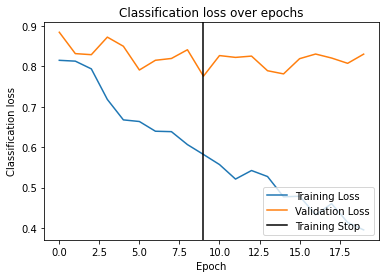

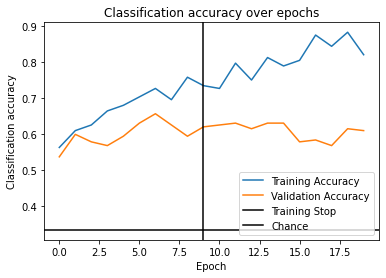

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9693 - acc: 0.5938 - val_loss: 0.7487 - val_acc: 0.7188
Epoch 2/50 0.234s 	 loss: 0.8552 - acc: 0.6406 - val_loss: 0.7859 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.8426 - acc: 0.6172 - val_loss: 0.7628 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.231s 	 loss: 0.7950 - acc: 0.6953 - val_loss: 0.7810 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.233s 	 loss: 0.7757 - acc: 0.6797 - val_loss: 0.7630 - val_acc: 0.6302
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.235s 	 loss: 0.7417 - acc: 0.6875 - val_loss: 0.7495 - val_acc: 0.6094
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.233s 	 loss: 0.6928 - acc: 0.7109 - val_loss: 0.7125 - val_acc: 0.6354
Epoch 8/50 0.234s 	 loss: 0.6902 - acc: 0.6562 - val_loss: 0.7606 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.240s 	 loss: 0.6653 - acc: 0.75

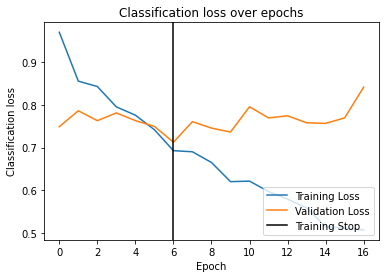

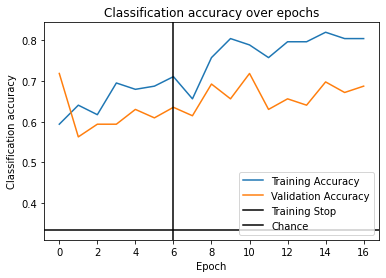

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8267 - acc: 0.6484 - val_loss: 1.0501 - val_acc: 0.4792
Epoch 2/50 0.234s 	 loss: 0.7802 - acc: 0.6484 - val_loss: 1.0044 - val_acc: 0.5260
Epoch 3/50 0.230s 	 loss: 0.7579 - acc: 0.6406 - val_loss: 0.9827 - val_acc: 0.5260
Epoch 4/50 0.231s 	 loss: 0.6680 - acc: 0.7656 - val_loss: 1.0446 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.6159 - acc: 0.7578 - val_loss: 0.9728 - val_acc: 0.5469
Epoch 6/50 0.232s 	 loss: 0.6174 - acc: 0.7656 - val_loss: 1.0207 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.232s 	 loss: 0.5935 - acc: 0.7734 - val_loss: 0.9781 - val_acc: 0.6094
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.5609 - acc: 0.7969 - val_loss: 1.0194 - val_acc: 0.5781
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.232s 	 loss: 0.5488 - acc: 0.7891 - val_loss: 0.9749 - val_acc: 0.5781
EarlyStopping counter: 4 out o

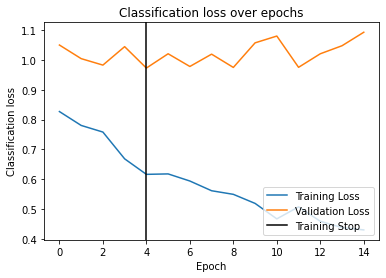

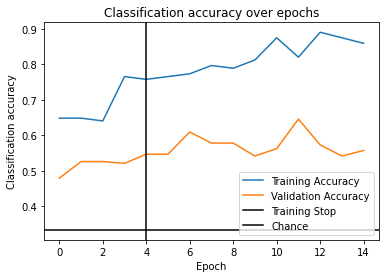

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8941 - acc: 0.5781 - val_loss: 0.9712 - val_acc: 0.6250
Epoch 2/50 0.235s 	 loss: 0.8013 - acc: 0.6562 - val_loss: 0.9531 - val_acc: 0.5938
Epoch 3/50 0.232s 	 loss: 0.7839 - acc: 0.6953 - val_loss: 0.8783 - val_acc: 0.6146
Epoch 4/50 0.243s 	 loss: 0.7370 - acc: 0.7109 - val_loss: 0.9158 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7064 - acc: 0.7344 - val_loss: 0.8840 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.7013 - acc: 0.7031 - val_loss: 0.9818 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.6380 - acc: 0.7656 - val_loss: 0.9351 - val_acc: 0.6250
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.239s 	 loss: 0.6179 - acc: 0.7891 - val_loss: 0.9096 - val_acc: 0.5990
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.234s 	 loss: 0.5981 - acc: 0.8125 - val_loss: 0.8749 - val_acc: 0.

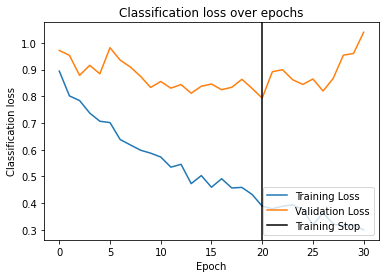

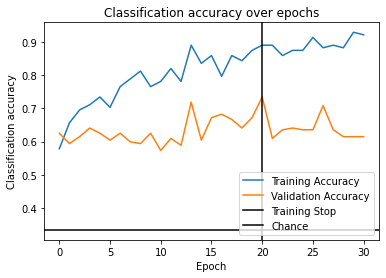

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8044 - acc: 0.6406 - val_loss: 0.8795 - val_acc: 0.6198
Epoch 2/50 0.233s 	 loss: 0.7187 - acc: 0.6797 - val_loss: 0.8763 - val_acc: 0.6146
Epoch 3/50 0.235s 	 loss: 0.6416 - acc: 0.7188 - val_loss: 0.8074 - val_acc: 0.6615
Epoch 4/50 0.236s 	 loss: 0.6443 - acc: 0.7188 - val_loss: 0.7578 - val_acc: 0.6771
Epoch 5/50 0.243s 	 loss: 0.5860 - acc: 0.7344 - val_loss: 0.7683 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.5316 - acc: 0.7969 - val_loss: 0.7412 - val_acc: 0.6771
Epoch 7/50 0.232s 	 loss: 0.5068 - acc: 0.7500 - val_loss: 0.7133 - val_acc: 0.7240
Epoch 8/50 0.233s 	 loss: 0.4702 - acc: 0.7812 - val_loss: 0.7058 - val_acc: 0.6771
Epoch 9/50 0.239s 	 loss: 0.4739 - acc: 0.7578 - val_loss: 0.7166 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.4612 - acc: 0.8203 - val_loss: 0.6967 - val_acc: 0.7344
Epoch 11/50 0.2

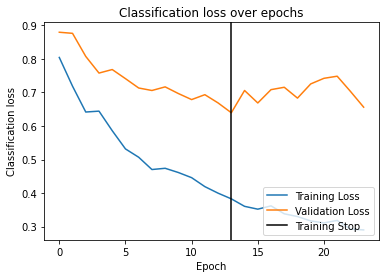

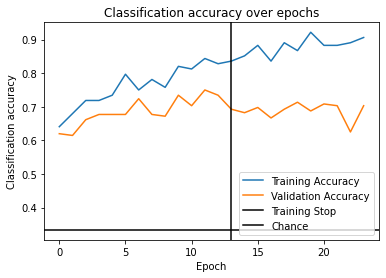

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8814 - acc: 0.5859 - val_loss: 0.6834 - val_acc: 0.7240
Epoch 2/50 0.232s 	 loss: 0.7419 - acc: 0.6719 - val_loss: 0.6782 - val_acc: 0.7031
Epoch 3/50 0.234s 	 loss: 0.7770 - acc: 0.6406 - val_loss: 0.6364 - val_acc: 0.6875
Epoch 4/50 0.240s 	 loss: 0.6867 - acc: 0.7344 - val_loss: 0.6235 - val_acc: 0.7031
Epoch 5/50 0.234s 	 loss: 0.6482 - acc: 0.6953 - val_loss: 0.5766 - val_acc: 0.7552
Epoch 6/50 0.235s 	 loss: 0.6076 - acc: 0.7188 - val_loss: 0.5699 - val_acc: 0.7188
Epoch 7/50 0.235s 	 loss: 0.5941 - acc: 0.7109 - val_loss: 0.5937 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.236s 	 loss: 0.5521 - acc: 0.7656 - val_loss: 0.5412 - val_acc: 0.7708
Epoch 9/50 0.234s 	 loss: 0.5483 - acc: 0.7578 - val_loss: 0.5306 - val_acc: 0.7812
Epoch 10/50 0.234s 	 loss: 0.5031 - acc: 0.7891 - val_loss: 0.5602 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 11/50 0.2

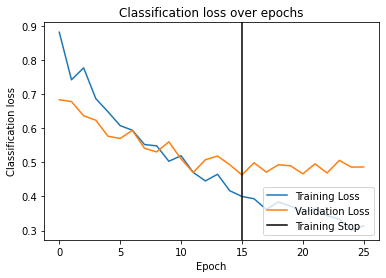

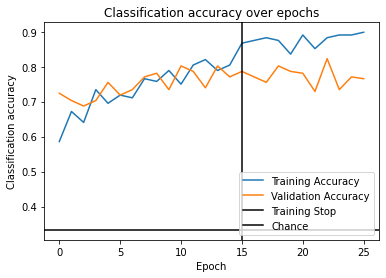

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8185 - acc: 0.6328 - val_loss: 0.7934 - val_acc: 0.6510
Epoch 2/50 0.240s 	 loss: 0.6943 - acc: 0.6953 - val_loss: 0.6645 - val_acc: 0.6667
Epoch 3/50 0.234s 	 loss: 0.6411 - acc: 0.7109 - val_loss: 0.7368 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.5952 - acc: 0.7500 - val_loss: 0.7580 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.236s 	 loss: 0.5650 - acc: 0.7812 - val_loss: 0.7091 - val_acc: 0.7031
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.237s 	 loss: 0.5120 - acc: 0.7578 - val_loss: 0.6416 - val_acc: 0.7656
Epoch 7/50 0.237s 	 loss: 0.4620 - acc: 0.8359 - val_loss: 0.7262 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.4469 - acc: 0.8203 - val_loss: 0.7465 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.240s 	 loss: 0.4250 - acc: 0.8281 - val_loss: 0.6676 - val_acc: 0.

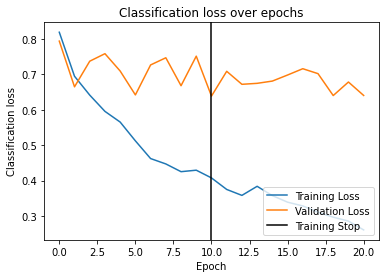

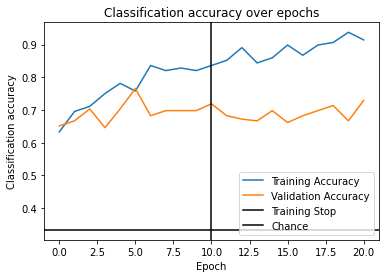

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9426 - acc: 0.5312 - val_loss: 0.8505 - val_acc: 0.6406
Epoch 2/50 0.238s 	 loss: 0.8573 - acc: 0.6484 - val_loss: 0.7920 - val_acc: 0.6719
Epoch 3/50 0.232s 	 loss: 0.8236 - acc: 0.6172 - val_loss: 0.7843 - val_acc: 0.6771
Epoch 4/50 0.237s 	 loss: 0.7399 - acc: 0.7188 - val_loss: 0.7448 - val_acc: 0.6979
Epoch 5/50 0.237s 	 loss: 0.7186 - acc: 0.7266 - val_loss: 0.7633 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.7040 - acc: 0.7500 - val_loss: 0.7669 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.6539 - acc: 0.7734 - val_loss: 0.7757 - val_acc: 0.6354
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.6464 - acc: 0.7266 - val_loss: 0.7347 - val_acc: 0.7292
Epoch 9/50 0.235s 	 loss: 0.6164 - acc: 0.7891 - val_loss: 0.7385 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

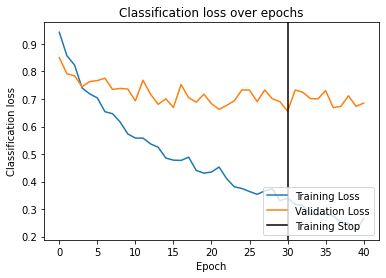

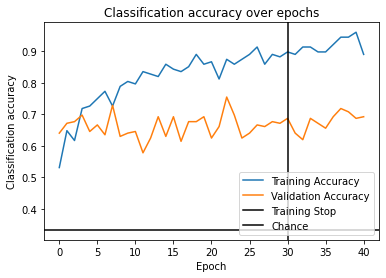

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.9057 - acc: 0.6250 - val_loss: 0.8671 - val_acc: 0.5052
Epoch 2/50 0.246s 	 loss: 0.8401 - acc: 0.6875 - val_loss: 0.8762 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.242s 	 loss: 0.7744 - acc: 0.6719 - val_loss: 0.8577 - val_acc: 0.5365
Epoch 4/50 0.231s 	 loss: 0.7305 - acc: 0.7109 - val_loss: 0.8989 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.6965 - acc: 0.7422 - val_loss: 0.9039 - val_acc: 0.4948
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.242s 	 loss: 0.6430 - acc: 0.7891 - val_loss: 0.8854 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.229s 	 loss: 0.6627 - acc: 0.7578 - val_loss: 0.7933 - val_acc: 0.5938
Epoch 8/50 0.234s 	 loss: 0.5989 - acc: 0.7578 - val_loss: 0.8055 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.6233 - acc: 0.8047 - val_loss: 0.8401 - val_acc: 0.

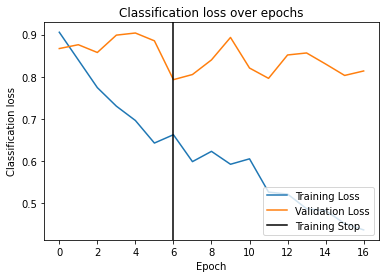

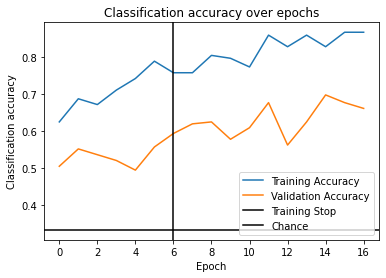

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8821 - acc: 0.5703 - val_loss: 0.9569 - val_acc: 0.5833
Epoch 2/50 0.235s 	 loss: 0.7881 - acc: 0.6797 - val_loss: 0.8933 - val_acc: 0.5312
Epoch 3/50 0.234s 	 loss: 0.7826 - acc: 0.6641 - val_loss: 0.8447 - val_acc: 0.6146
Epoch 4/50 0.237s 	 loss: 0.7396 - acc: 0.6719 - val_loss: 0.8157 - val_acc: 0.6458
Epoch 5/50 0.232s 	 loss: 0.7002 - acc: 0.7188 - val_loss: 0.8291 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.6763 - acc: 0.7031 - val_loss: 0.8086 - val_acc: 0.6302
Epoch 7/50 0.233s 	 loss: 0.6689 - acc: 0.7188 - val_loss: 0.7952 - val_acc: 0.6615
Epoch 8/50 0.234s 	 loss: 0.6351 - acc: 0.7344 - val_loss: 0.7260 - val_acc: 0.6458
Epoch 9/50 0.231s 	 loss: 0.6277 - acc: 0.7422 - val_loss: 0.7211 - val_acc: 0.6302
Epoch 10/50 0.233s 	 loss: 0.5453 - acc: 0.7891 - val_loss: 0.6767 - val_acc: 0.6979
Epoch 11/50 0.236s 	 loss: 0.5407 - acc: 0.7969 - 

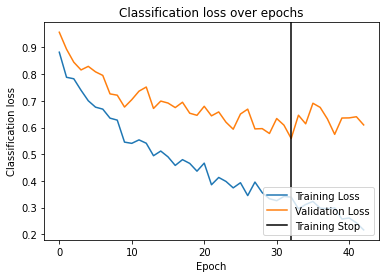

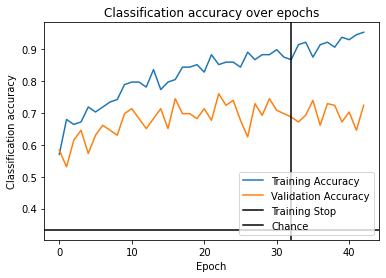

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.230s 	 loss: 0.7854 - acc: 0.6562 - val_loss: 0.9642 - val_acc: 0.5833
Epoch 2/50 0.231s 	 loss: 0.7603 - acc: 0.6406 - val_loss: 0.8867 - val_acc: 0.6250
Epoch 3/50 0.230s 	 loss: 0.6739 - acc: 0.7266 - val_loss: 0.9273 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.248s 	 loss: 0.5755 - acc: 0.7812 - val_loss: 0.8741 - val_acc: 0.6146
Epoch 5/50 0.235s 	 loss: 0.5544 - acc: 0.8125 - val_loss: 0.7989 - val_acc: 0.6042
Epoch 6/50 0.231s 	 loss: 0.5115 - acc: 0.8125 - val_loss: 0.7501 - val_acc: 0.6146
Epoch 7/50 0.234s 	 loss: 0.4965 - acc: 0.8203 - val_loss: 0.7900 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.4718 - acc: 0.8281 - val_loss: 0.7588 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.241s 	 loss: 0.4318 - acc: 0.8594 - val_loss: 0.7615 - val_acc: 0.6406
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.237s 	 loss: 0.4

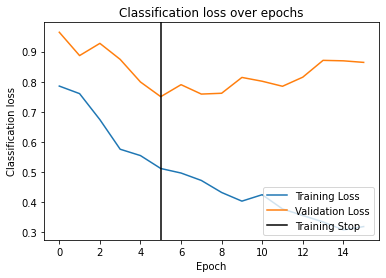

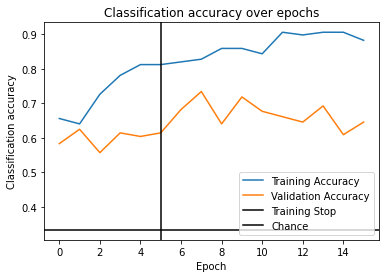

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9164 - acc: 0.5781 - val_loss: 0.6666 - val_acc: 0.6562
Epoch 2/50 0.233s 	 loss: 0.7659 - acc: 0.6953 - val_loss: 0.6232 - val_acc: 0.7135
Epoch 3/50 0.238s 	 loss: 0.7154 - acc: 0.6719 - val_loss: 0.6556 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.6497 - acc: 0.7344 - val_loss: 0.5438 - val_acc: 0.7760
Epoch 5/50 0.231s 	 loss: 0.6185 - acc: 0.7656 - val_loss: 0.5860 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.5895 - acc: 0.7812 - val_loss: 0.5895 - val_acc: 0.7135
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.239s 	 loss: 0.5695 - acc: 0.8047 - val_loss: 0.5647 - val_acc: 0.7396
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.242s 	 loss: 0.5223 - acc: 0.8281 - val_loss: 0.5526 - val_acc: 0.7604
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.230s 	 loss: 0.5484 - acc: 0.7734 - val_loss: 0.5958 - val_acc: 0.

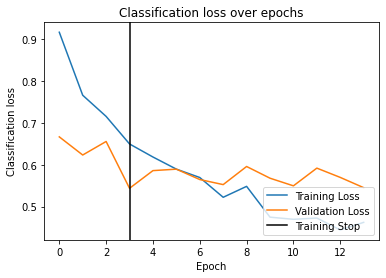

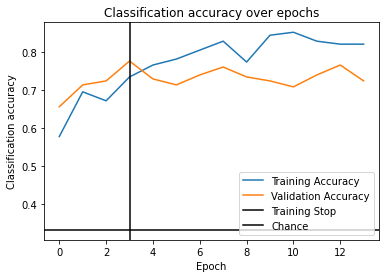

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8853 - acc: 0.6016 - val_loss: 0.7897 - val_acc: 0.6667
Epoch 2/50 0.237s 	 loss: 0.7357 - acc: 0.6797 - val_loss: 0.7497 - val_acc: 0.6510
Epoch 3/50 0.236s 	 loss: 0.6787 - acc: 0.7344 - val_loss: 0.8466 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.5981 - acc: 0.8047 - val_loss: 0.8576 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.248s 	 loss: 0.5736 - acc: 0.7969 - val_loss: 0.7939 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.242s 	 loss: 0.5358 - acc: 0.7891 - val_loss: 0.7539 - val_acc: 0.7031
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.237s 	 loss: 0.4903 - acc: 0.8281 - val_loss: 0.7697 - val_acc: 0.6979
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.242s 	 loss: 0.4526 - acc: 0.8359 - val_loss: 0.7798 - val_acc: 0.6927
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.242s 	 loss: 0.4579 - acc: 0.81

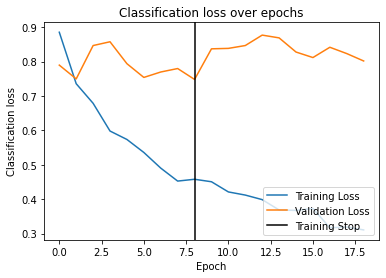

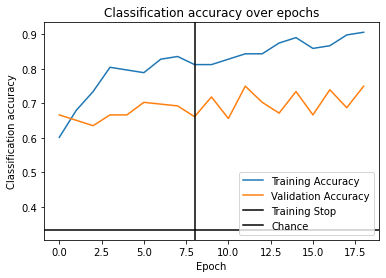

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.7001 - acc: 0.7188 - val_loss: 0.6511 - val_acc: 0.7344
Epoch 2/50 0.233s 	 loss: 0.6171 - acc: 0.7656 - val_loss: 0.7182 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.5871 - acc: 0.7500 - val_loss: 0.7132 - val_acc: 0.7604
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.5361 - acc: 0.7734 - val_loss: 0.7217 - val_acc: 0.7188
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.237s 	 loss: 0.5164 - acc: 0.7969 - val_loss: 0.7357 - val_acc: 0.7083
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.237s 	 loss: 0.4773 - acc: 0.8281 - val_loss: 0.6958 - val_acc: 0.7292
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.235s 	 loss: 0.4865 - acc: 0.8359 - val_loss: 0.6544 - val_acc: 0.7448
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.233s 	 loss: 0.4516 - acc: 0.8516 - val_loss: 0.6997 - val_acc: 0.7188
EarlyStopping counter: 7 out of 10
Epoch 9/5

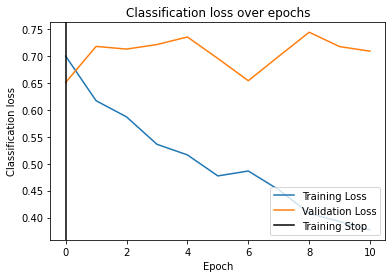

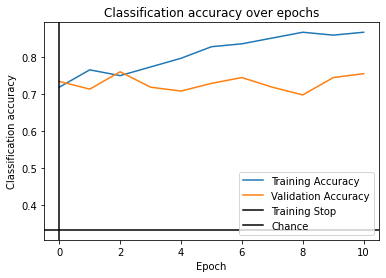

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.6730 - acc: 0.7188 - val_loss: 0.7146 - val_acc: 0.6302
Epoch 2/50 0.232s 	 loss: 0.5636 - acc: 0.7891 - val_loss: 0.7382 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.5659 - acc: 0.7891 - val_loss: 0.7748 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.4880 - acc: 0.8438 - val_loss: 0.7444 - val_acc: 0.5885
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.241s 	 loss: 0.5267 - acc: 0.8203 - val_loss: 0.7609 - val_acc: 0.5677
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.232s 	 loss: 0.4762 - acc: 0.8594 - val_loss: 0.7409 - val_acc: 0.6146
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.234s 	 loss: 0.4297 - acc: 0.8672 - val_loss: 0.7202 - val_acc: 0.6458
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.233s 	 loss: 0.4037 - acc: 0.8672 - val_loss: 0.7149 - val_acc: 0.6406
EarlyStopping counter: 7 out of 10
Epoch 9/5

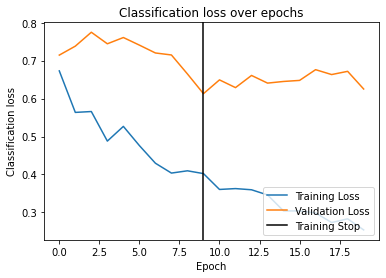

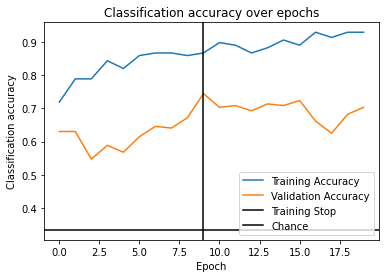

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.7141 - acc: 0.6719 - val_loss: 0.6334 - val_acc: 0.7500
Epoch 2/50 0.232s 	 loss: 0.6534 - acc: 0.7188 - val_loss: 0.5645 - val_acc: 0.7969
Epoch 3/50 0.236s 	 loss: 0.5903 - acc: 0.7344 - val_loss: 0.6205 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.5803 - acc: 0.7578 - val_loss: 0.6215 - val_acc: 0.7708
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.236s 	 loss: 0.5468 - acc: 0.7734 - val_loss: 0.6558 - val_acc: 0.7396
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.233s 	 loss: 0.5324 - acc: 0.8047 - val_loss: 0.5966 - val_acc: 0.8750
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.231s 	 loss: 0.5066 - acc: 0.8047 - val_loss: 0.6747 - val_acc: 0.7552
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.235s 	 loss: 0.4744 - acc: 0.8516 - val_loss: 0.6516 - val_acc: 0.7344
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.244s 	 loss: 0.4316 - acc: 0.84

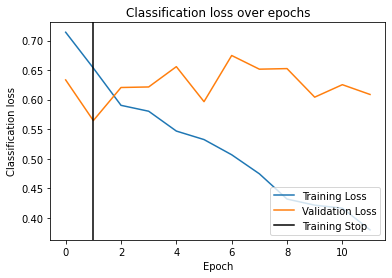

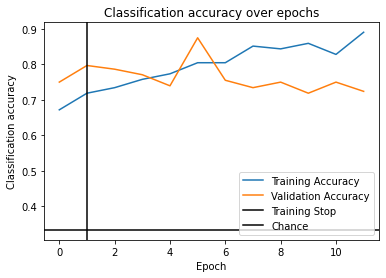

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9630 - acc: 0.5547 - val_loss: 0.8095 - val_acc: 0.6250
Epoch 2/50 0.241s 	 loss: 0.8724 - acc: 0.6172 - val_loss: 0.7942 - val_acc: 0.6510
Epoch 3/50 0.233s 	 loss: 0.7682 - acc: 0.6797 - val_loss: 0.7658 - val_acc: 0.6823
Epoch 4/50 0.238s 	 loss: 0.7528 - acc: 0.7031 - val_loss: 0.7835 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.6690 - acc: 0.7578 - val_loss: 0.7650 - val_acc: 0.6458
Epoch 6/50 0.233s 	 loss: 0.6909 - acc: 0.7344 - val_loss: 0.8106 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.6409 - acc: 0.7266 - val_loss: 0.7702 - val_acc: 0.7135
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.5922 - acc: 0.7656 - val_loss: 0.7555 - val_acc: 0.7448
Epoch 9/50 0.231s 	 loss: 0.5558 - acc: 0.7891 - val_loss: 0.7700 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.5

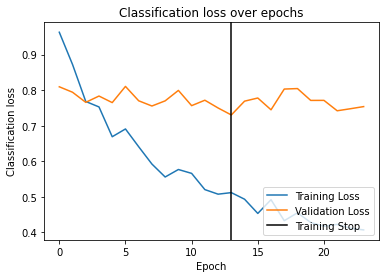

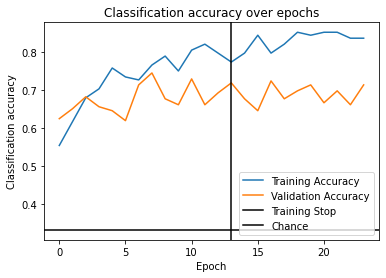

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8531 - acc: 0.6719 - val_loss: 1.0733 - val_acc: 0.5208
Epoch 2/50 0.232s 	 loss: 0.8015 - acc: 0.6797 - val_loss: 1.0136 - val_acc: 0.5625
Epoch 3/50 0.231s 	 loss: 0.7349 - acc: 0.7031 - val_loss: 0.9379 - val_acc: 0.5781
Epoch 4/50 0.233s 	 loss: 0.7113 - acc: 0.7344 - val_loss: 0.9409 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.6560 - acc: 0.7344 - val_loss: 0.9117 - val_acc: 0.6354
Epoch 6/50 0.231s 	 loss: 0.6334 - acc: 0.7891 - val_loss: 0.9157 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.6112 - acc: 0.7812 - val_loss: 0.9610 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.231s 	 loss: 0.5552 - acc: 0.8203 - val_loss: 0.8955 - val_acc: 0.5469
Epoch 9/50 0.239s 	 loss: 0.5203 - acc: 0.8047 - val_loss: 0.9241 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.4

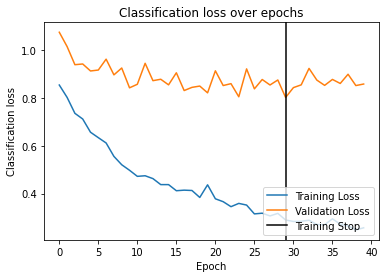

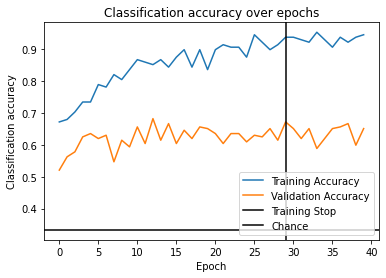

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9044 - acc: 0.6172 - val_loss: 0.9058 - val_acc: 0.5938
Epoch 2/50 0.237s 	 loss: 0.8628 - acc: 0.6094 - val_loss: 0.7579 - val_acc: 0.6979
Epoch 3/50 0.230s 	 loss: 0.7943 - acc: 0.7188 - val_loss: 0.7882 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7773 - acc: 0.6953 - val_loss: 0.7639 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.232s 	 loss: 0.7516 - acc: 0.6797 - val_loss: 0.7217 - val_acc: 0.7396
Epoch 6/50 0.251s 	 loss: 0.7313 - acc: 0.6953 - val_loss: 0.7476 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.7199 - acc: 0.7500 - val_loss: 0.6835 - val_acc: 0.7708
Epoch 8/50 0.233s 	 loss: 0.6739 - acc: 0.7500 - val_loss: 0.7289 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.6526 - acc: 0.8047 - val_loss: 0.6732 - val_acc: 0.7188
Epoch 10/50 0.232s 	 loss: 0.6

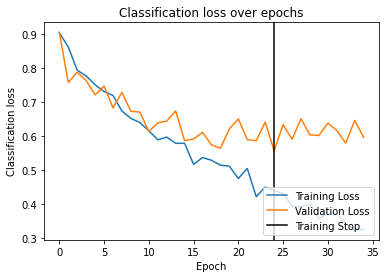

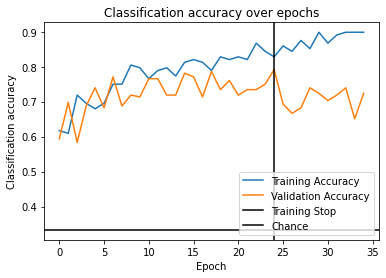

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 1.0269 - acc: 0.4922 - val_loss: 0.6705 - val_acc: 0.7552
Epoch 2/50 0.237s 	 loss: 0.9378 - acc: 0.5938 - val_loss: 0.7026 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.9392 - acc: 0.6172 - val_loss: 0.7440 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.9030 - acc: 0.6172 - val_loss: 0.7505 - val_acc: 0.7083
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.238s 	 loss: 0.8293 - acc: 0.6797 - val_loss: 0.7552 - val_acc: 0.6510
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.233s 	 loss: 0.8141 - acc: 0.6484 - val_loss: 0.7368 - val_acc: 0.6094
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.231s 	 loss: 0.7403 - acc: 0.7422 - val_loss: 0.6844 - val_acc: 0.7396
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.235s 	 loss: 0.7745 - acc: 0.6875 - val_loss: 0.8068 - val_acc: 0.6354
EarlyStopping counter: 7 out of 10
Epoch 9/5

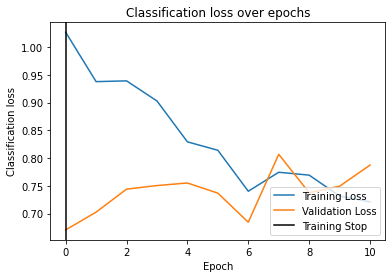

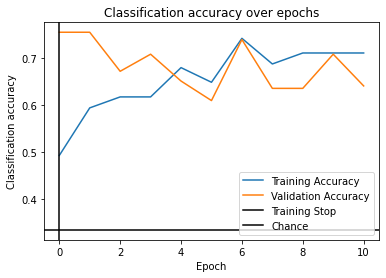

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8145 - acc: 0.6406 - val_loss: 1.1244 - val_acc: 0.4740
Epoch 2/50 0.236s 	 loss: 0.7751 - acc: 0.6797 - val_loss: 1.0341 - val_acc: 0.5417
Epoch 3/50 0.236s 	 loss: 0.8035 - acc: 0.6562 - val_loss: 1.0776 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.7218 - acc: 0.6953 - val_loss: 1.0834 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.231s 	 loss: 0.6969 - acc: 0.7422 - val_loss: 1.1514 - val_acc: 0.4323
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.6571 - acc: 0.7500 - val_loss: 1.0272 - val_acc: 0.5156
Epoch 7/50 0.233s 	 loss: 0.6507 - acc: 0.7891 - val_loss: 1.0338 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.6445 - acc: 0.7422 - val_loss: 1.0691 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.6091 - acc: 0.7656 - val_loss: 1.0052 - val_acc: 0.

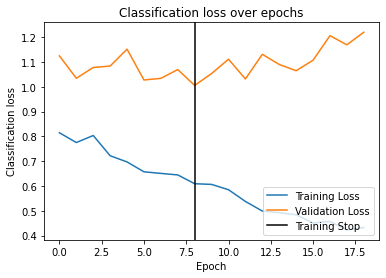

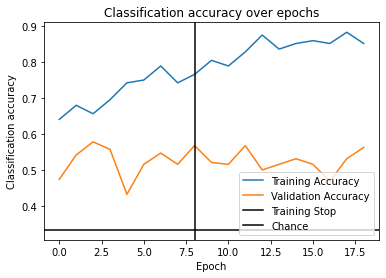

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8929 - acc: 0.6016 - val_loss: 0.9984 - val_acc: 0.5417
Epoch 2/50 0.234s 	 loss: 0.8117 - acc: 0.6719 - val_loss: 0.9946 - val_acc: 0.4635
Epoch 3/50 0.233s 	 loss: 0.8526 - acc: 0.6484 - val_loss: 0.9752 - val_acc: 0.5312
Epoch 4/50 0.232s 	 loss: 0.7500 - acc: 0.6719 - val_loss: 0.9784 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.7543 - acc: 0.6719 - val_loss: 0.9629 - val_acc: 0.5729
Epoch 6/50 0.239s 	 loss: 0.6937 - acc: 0.7031 - val_loss: 0.9678 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.7058 - acc: 0.7500 - val_loss: 0.9219 - val_acc: 0.5417
Epoch 8/50 0.235s 	 loss: 0.7161 - acc: 0.7109 - val_loss: 0.9808 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.6985 - acc: 0.7188 - val_loss: 0.9511 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.243s 	 loss: 0.6

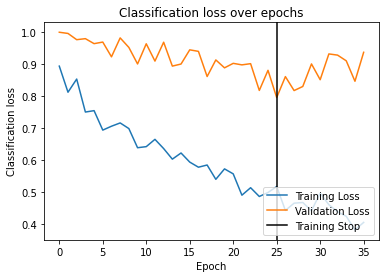

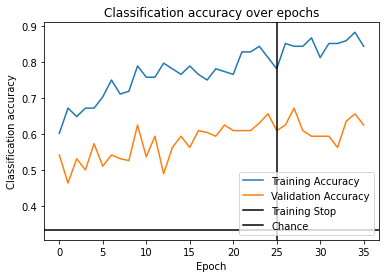

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9855 - acc: 0.5703 - val_loss: 0.7500 - val_acc: 0.6146
Epoch 2/50 0.235s 	 loss: 1.0035 - acc: 0.5703 - val_loss: 0.7140 - val_acc: 0.7031
Epoch 3/50 0.243s 	 loss: 0.9134 - acc: 0.5703 - val_loss: 0.7206 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.9156 - acc: 0.6172 - val_loss: 0.7277 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.8597 - acc: 0.6719 - val_loss: 0.7532 - val_acc: 0.7135
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.8648 - acc: 0.6562 - val_loss: 0.7586 - val_acc: 0.6771
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.232s 	 loss: 0.8027 - acc: 0.6562 - val_loss: 0.7528 - val_acc: 0.6875
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.233s 	 loss: 0.7916 - acc: 0.6875 - val_loss: 0.7913 - val_acc: 0.6719
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.234s 	 loss: 0.7946 - acc: 0.66

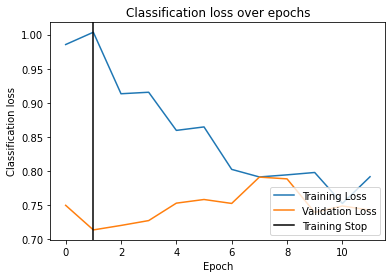

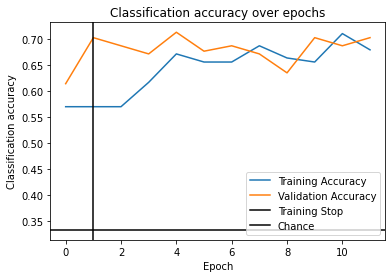

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.9498 - acc: 0.5781 - val_loss: 0.8868 - val_acc: 0.6094
Epoch 2/50 0.232s 	 loss: 0.9129 - acc: 0.5938 - val_loss: 0.8677 - val_acc: 0.5573
Epoch 3/50 0.235s 	 loss: 0.8879 - acc: 0.6328 - val_loss: 0.8652 - val_acc: 0.6354
Epoch 4/50 0.233s 	 loss: 0.8558 - acc: 0.6406 - val_loss: 0.9084 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.8425 - acc: 0.6406 - val_loss: 0.8915 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.8128 - acc: 0.6484 - val_loss: 0.9025 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.248s 	 loss: 0.7947 - acc: 0.6641 - val_loss: 0.8392 - val_acc: 0.6198
Epoch 8/50 0.236s 	 loss: 0.7507 - acc: 0.6875 - val_loss: 0.8707 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.7735 - acc: 0.6406 - val_loss: 0.8735 - val_acc: 0.6250
EarlyStopping counter: 2 out o

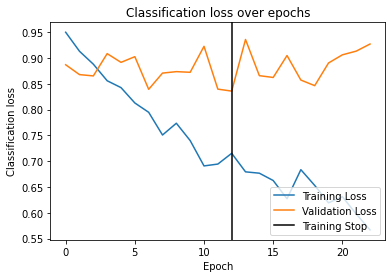

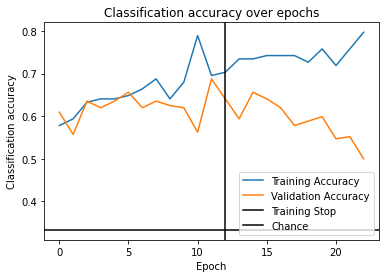

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7941 - acc: 0.6641 - val_loss: 1.2032 - val_acc: 0.4323
Epoch 2/50 0.238s 	 loss: 0.7430 - acc: 0.6875 - val_loss: 1.2015 - val_acc: 0.4792
Epoch 3/50 0.234s 	 loss: 0.7334 - acc: 0.6953 - val_loss: 1.1462 - val_acc: 0.5208
Epoch 4/50 0.233s 	 loss: 0.6844 - acc: 0.7500 - val_loss: 1.2331 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.6691 - acc: 0.7188 - val_loss: 1.1720 - val_acc: 0.5104
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.6587 - acc: 0.6875 - val_loss: 1.1559 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.6163 - acc: 0.7969 - val_loss: 1.1520 - val_acc: 0.5625
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.236s 	 loss: 0.6137 - acc: 0.7969 - val_loss: 1.1463 - val_acc: 0.4896
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.235s 	 loss: 0.6100 - acc: 0.7812 - val_loss: 1.1591 - val_acc: 0.

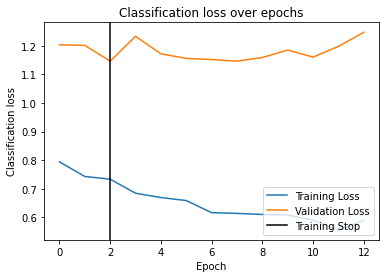

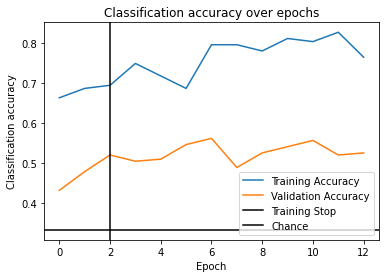

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.1095 - acc: 0.4844 - val_loss: 0.9566 - val_acc: 0.5312
Epoch 2/50 0.234s 	 loss: 1.0513 - acc: 0.4609 - val_loss: 1.0200 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.9746 - acc: 0.5156 - val_loss: 0.9213 - val_acc: 0.5312
Epoch 4/50 0.232s 	 loss: 0.9290 - acc: 0.5703 - val_loss: 1.0061 - val_acc: 0.4531
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.8859 - acc: 0.5547 - val_loss: 1.0036 - val_acc: 0.5104
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.9150 - acc: 0.5938 - val_loss: 1.0472 - val_acc: 0.5000
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.230s 	 loss: 0.8246 - acc: 0.5859 - val_loss: 1.0665 - val_acc: 0.4792
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.234s 	 loss: 0.8424 - acc: 0.6094 - val_loss: 1.1705 - val_acc: 0.4062
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.240s 	 loss: 0.8061 - acc: 0.64

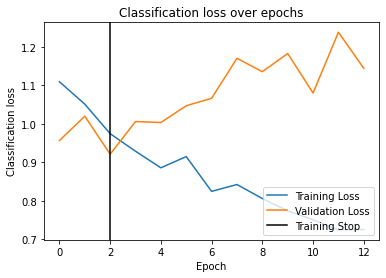

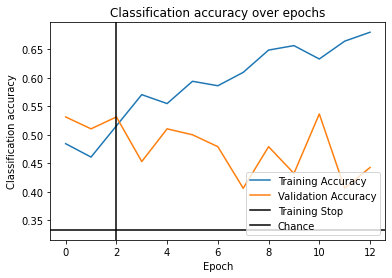

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 1.0706 - acc: 0.4844 - val_loss: 1.1632 - val_acc: 0.4323
Epoch 2/50 0.236s 	 loss: 0.9909 - acc: 0.4766 - val_loss: 1.1164 - val_acc: 0.4115
Epoch 3/50 0.248s 	 loss: 0.9710 - acc: 0.5391 - val_loss: 1.1390 - val_acc: 0.4010
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.9302 - acc: 0.5781 - val_loss: 1.1353 - val_acc: 0.4219
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.8846 - acc: 0.5703 - val_loss: 1.1007 - val_acc: 0.4167
Epoch 6/50 0.237s 	 loss: 0.8030 - acc: 0.6328 - val_loss: 1.0970 - val_acc: 0.4479
Epoch 7/50 0.235s 	 loss: 0.8561 - acc: 0.5859 - val_loss: 1.0145 - val_acc: 0.4427
Epoch 8/50 0.239s 	 loss: 0.8513 - acc: 0.5938 - val_loss: 1.0268 - val_acc: 0.4427
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.8455 - acc: 0.6562 - val_loss: 1.0698 - val_acc: 0.3802
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.233s 	 loss: 0.8

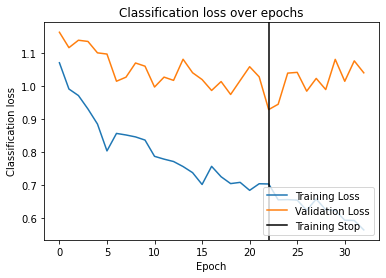

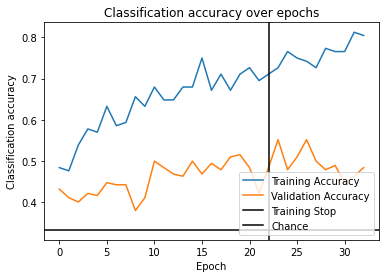

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0577 - acc: 0.4453 - val_loss: 1.0632 - val_acc: 0.4635
Epoch 2/50 0.233s 	 loss: 1.0177 - acc: 0.4844 - val_loss: 1.0952 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.9747 - acc: 0.5312 - val_loss: 1.0205 - val_acc: 0.5156
Epoch 4/50 0.240s 	 loss: 0.9082 - acc: 0.5547 - val_loss: 1.0374 - val_acc: 0.4167
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.9489 - acc: 0.5000 - val_loss: 1.0828 - val_acc: 0.4635
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.8770 - acc: 0.5703 - val_loss: 0.9972 - val_acc: 0.4896
Epoch 7/50 0.234s 	 loss: 0.8595 - acc: 0.6328 - val_loss: 1.0322 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.243s 	 loss: 0.8148 - acc: 0.6250 - val_loss: 1.0179 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.241s 	 loss: 0.7762 - acc: 0.5859 - val_loss: 1.0553 - val_acc: 0.

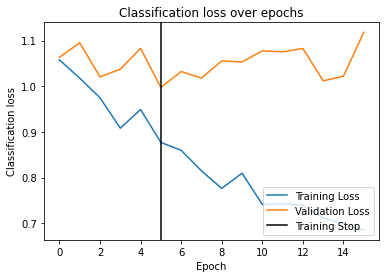

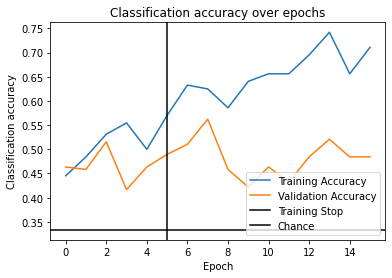

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0707 - acc: 0.4609 - val_loss: 1.1481 - val_acc: 0.5312
Epoch 2/50 0.238s 	 loss: 0.9728 - acc: 0.5547 - val_loss: 1.0609 - val_acc: 0.4896
Epoch 3/50 0.235s 	 loss: 0.9377 - acc: 0.5391 - val_loss: 0.9483 - val_acc: 0.5312
Epoch 4/50 0.243s 	 loss: 0.9153 - acc: 0.5547 - val_loss: 1.0194 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.8915 - acc: 0.6328 - val_loss: 0.9756 - val_acc: 0.5312
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.234s 	 loss: 0.8418 - acc: 0.6328 - val_loss: 0.9413 - val_acc: 0.6302
Epoch 7/50 0.232s 	 loss: 0.8491 - acc: 0.6406 - val_loss: 0.8976 - val_acc: 0.6094
Epoch 8/50 0.232s 	 loss: 0.8092 - acc: 0.6406 - val_loss: 0.8911 - val_acc: 0.6510
Epoch 9/50 0.237s 	 loss: 0.7748 - acc: 0.7344 - val_loss: 0.9003 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.7782 - acc: 0.6406 - val_loss: 0.868

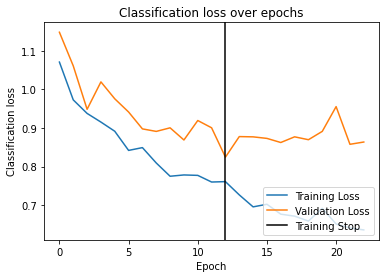

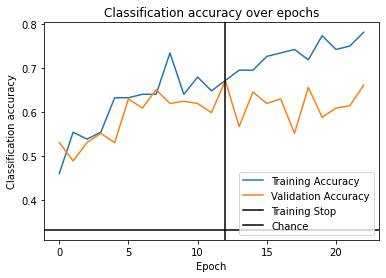

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0873 - acc: 0.5078 - val_loss: 0.9607 - val_acc: 0.5469
Epoch 2/50 0.231s 	 loss: 1.0091 - acc: 0.5312 - val_loss: 0.8850 - val_acc: 0.6146
Epoch 3/50 0.233s 	 loss: 0.9864 - acc: 0.5469 - val_loss: 0.9366 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.9123 - acc: 0.5938 - val_loss: 0.9511 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.8907 - acc: 0.5703 - val_loss: 0.9659 - val_acc: 0.4792
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.9004 - acc: 0.6016 - val_loss: 0.8666 - val_acc: 0.6042
Epoch 7/50 0.233s 	 loss: 0.8595 - acc: 0.6719 - val_loss: 0.9098 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.8508 - acc: 0.6406 - val_loss: 0.8940 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.8276 - acc: 0.6719 - val_loss: 0.9453 - val_acc: 0.

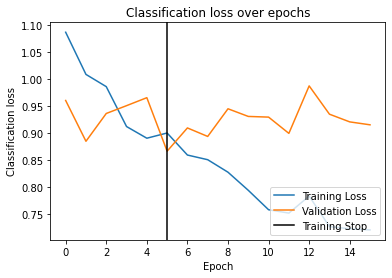

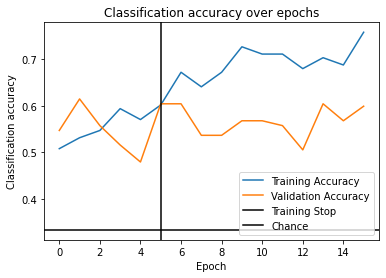

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 1.0624 - acc: 0.5078 - val_loss: 1.1491 - val_acc: 0.4792
Epoch 2/50 0.234s 	 loss: 0.9643 - acc: 0.5391 - val_loss: 1.1671 - val_acc: 0.4427
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.238s 	 loss: 0.9462 - acc: 0.5625 - val_loss: 1.1290 - val_acc: 0.4010
Epoch 4/50 0.233s 	 loss: 0.8748 - acc: 0.5703 - val_loss: 1.0632 - val_acc: 0.4635
Epoch 5/50 0.246s 	 loss: 0.8291 - acc: 0.5938 - val_loss: 1.0179 - val_acc: 0.5052
Epoch 6/50 0.237s 	 loss: 0.7689 - acc: 0.6641 - val_loss: 1.0519 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.7710 - acc: 0.6406 - val_loss: 1.1455 - val_acc: 0.4740
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.7157 - acc: 0.6797 - val_loss: 1.1173 - val_acc: 0.4479
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.7196 - acc: 0.7266 - val_loss: 1.0830 - val_acc: 0.4635
EarlyStopping counter: 4 out o

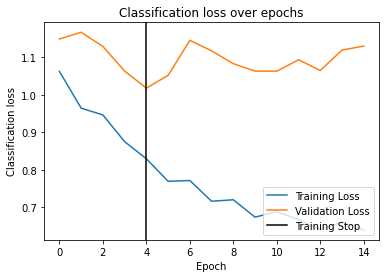

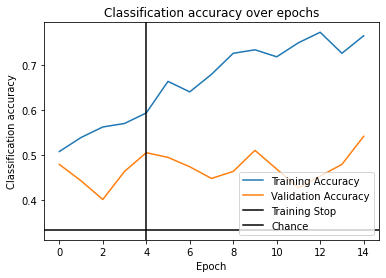

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8198 - acc: 0.6406 - val_loss: 0.8636 - val_acc: 0.6094
Epoch 2/50 0.236s 	 loss: 0.7448 - acc: 0.6797 - val_loss: 0.7716 - val_acc: 0.7344
Epoch 3/50 0.236s 	 loss: 0.7041 - acc: 0.7031 - val_loss: 0.7912 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.6999 - acc: 0.7031 - val_loss: 0.8082 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.232s 	 loss: 0.6484 - acc: 0.7109 - val_loss: 0.8152 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.237s 	 loss: 0.6461 - acc: 0.7422 - val_loss: 0.7954 - val_acc: 0.6562
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.232s 	 loss: 0.5916 - acc: 0.7891 - val_loss: 0.7840 - val_acc: 0.7083
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.244s 	 loss: 0.6073 - acc: 0.7656 - val_loss: 0.7647 - val_acc: 0.7240
Epoch 9/50 0.232s 	 loss: 0.5551 - acc: 0.8281 - val_loss: 0.8011 - val_acc: 0.

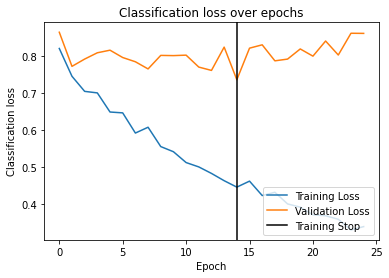

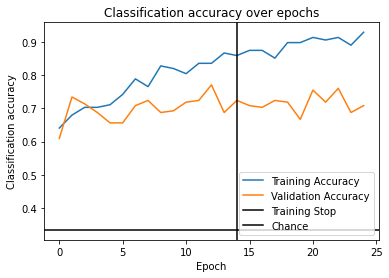

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.7819 - acc: 0.6797 - val_loss: 0.8786 - val_acc: 0.5885
Epoch 2/50 0.235s 	 loss: 0.7324 - acc: 0.7344 - val_loss: 0.8458 - val_acc: 0.5521
Epoch 3/50 0.243s 	 loss: 0.6714 - acc: 0.7188 - val_loss: 0.8832 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.6391 - acc: 0.7422 - val_loss: 0.8688 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.249s 	 loss: 0.6320 - acc: 0.7734 - val_loss: 0.8296 - val_acc: 0.5938
Epoch 6/50 0.232s 	 loss: 0.5901 - acc: 0.7500 - val_loss: 0.8027 - val_acc: 0.5885
Epoch 7/50 0.236s 	 loss: 0.5547 - acc: 0.8203 - val_loss: 0.8125 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.240s 	 loss: 0.5490 - acc: 0.8203 - val_loss: 0.8199 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.239s 	 loss: 0.5258 - acc: 0.8281 - val_loss: 0.8530 - val_acc: 0.6458
EarlyStopping counter: 3 out o

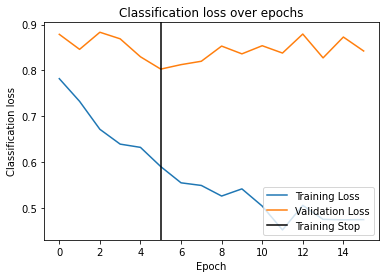

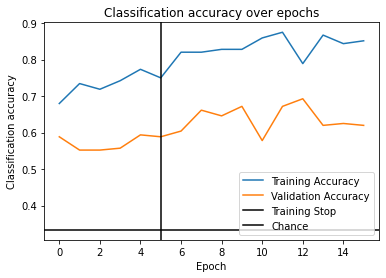

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8626 - acc: 0.5859 - val_loss: 0.6993 - val_acc: 0.7604
Epoch 2/50 0.232s 	 loss: 0.8146 - acc: 0.6094 - val_loss: 0.7495 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7889 - acc: 0.6641 - val_loss: 0.7124 - val_acc: 0.7656
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.237s 	 loss: 0.7434 - acc: 0.7188 - val_loss: 0.6793 - val_acc: 0.7135
Epoch 5/50 0.236s 	 loss: 0.7334 - acc: 0.6875 - val_loss: 0.6857 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.7251 - acc: 0.6641 - val_loss: 0.6614 - val_acc: 0.7292
Epoch 7/50 0.248s 	 loss: 0.6976 - acc: 0.7344 - val_loss: 0.6640 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.6566 - acc: 0.7266 - val_loss: 0.6546 - val_acc: 0.7188
Epoch 9/50 0.234s 	 loss: 0.6951 - acc: 0.7109 - val_loss: 0.6338 - val_acc: 0.7292
Epoch 10/50 0.235s 	 loss: 0.6

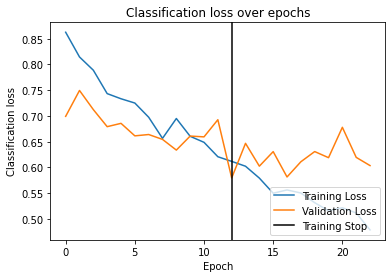

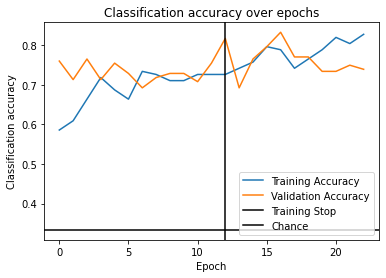

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0934 - acc: 0.4844 - val_loss: 0.9377 - val_acc: 0.5625
Epoch 2/50 0.235s 	 loss: 0.9694 - acc: 0.4922 - val_loss: 0.9067 - val_acc: 0.5365
Epoch 3/50 0.237s 	 loss: 0.8748 - acc: 0.5469 - val_loss: 0.8789 - val_acc: 0.5885
Epoch 4/50 0.235s 	 loss: 0.8179 - acc: 0.6172 - val_loss: 0.8795 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7569 - acc: 0.6094 - val_loss: 0.8826 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.6408 - acc: 0.7266 - val_loss: 0.8445 - val_acc: 0.6042
Epoch 7/50 0.233s 	 loss: 0.6699 - acc: 0.6797 - val_loss: 0.8354 - val_acc: 0.5573
Epoch 8/50 0.235s 	 loss: 0.6193 - acc: 0.7422 - val_loss: 0.8514 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.243s 	 loss: 0.6524 - acc: 0.6875 - val_loss: 0.8497 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

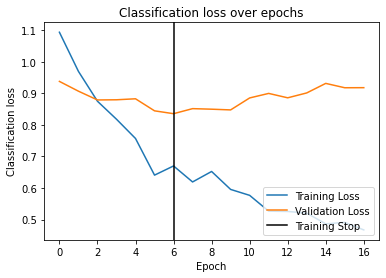

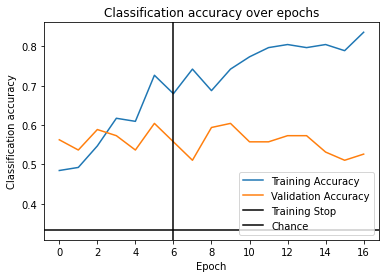

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0397 - acc: 0.5391 - val_loss: 1.0264 - val_acc: 0.5312
Epoch 2/50 0.234s 	 loss: 0.9166 - acc: 0.5938 - val_loss: 0.9703 - val_acc: 0.5677
Epoch 3/50 0.233s 	 loss: 0.8188 - acc: 0.6562 - val_loss: 0.9435 - val_acc: 0.5000
Epoch 4/50 0.233s 	 loss: 0.7719 - acc: 0.6953 - val_loss: 0.8974 - val_acc: 0.5469
Epoch 5/50 0.232s 	 loss: 0.7742 - acc: 0.6328 - val_loss: 0.9458 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.7445 - acc: 0.7031 - val_loss: 0.8899 - val_acc: 0.5312
Epoch 7/50 0.233s 	 loss: 0.7001 - acc: 0.7188 - val_loss: 0.8848 - val_acc: 0.5573
Epoch 8/50 0.231s 	 loss: 0.7103 - acc: 0.6797 - val_loss: 0.9167 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.6635 - acc: 0.6875 - val_loss: 0.8846 - val_acc: 0.4583
Epoch 10/50 0.239s 	 loss: 0.6177 - acc: 0.7266 - val_loss: 0.9851 - val_acc: 0.4844
EarlyStopping c

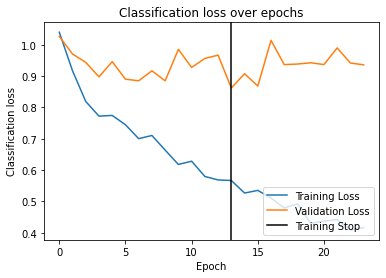

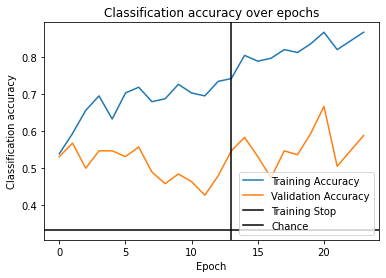

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.9124 - acc: 0.5469 - val_loss: 1.1802 - val_acc: 0.4167
Epoch 2/50 0.233s 	 loss: 0.8368 - acc: 0.6094 - val_loss: 1.1498 - val_acc: 0.4688
Epoch 3/50 0.234s 	 loss: 0.7667 - acc: 0.6328 - val_loss: 1.0935 - val_acc: 0.4896
Epoch 4/50 0.237s 	 loss: 0.6930 - acc: 0.6875 - val_loss: 1.1386 - val_acc: 0.4479
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.6610 - acc: 0.6797 - val_loss: 1.1262 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.6040 - acc: 0.7266 - val_loss: 1.0696 - val_acc: 0.4896
Epoch 7/50 0.231s 	 loss: 0.5995 - acc: 0.7422 - val_loss: 1.2020 - val_acc: 0.4531
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.230s 	 loss: 0.5521 - acc: 0.7812 - val_loss: 1.2287 - val_acc: 0.4583
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.255s 	 loss: 0.5293 - acc: 0.8203 - val_loss: 1.2339 - val_acc: 0.4583
EarlyStopping counter: 3 out o

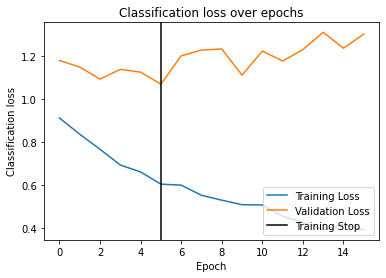

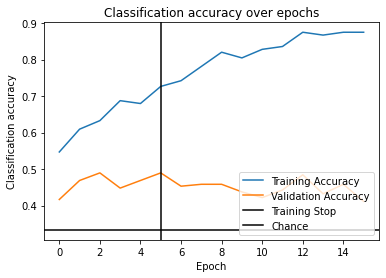

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6998 - acc: 0.7188 - val_loss: 0.8902 - val_acc: 0.5260
Epoch 2/50 0.239s 	 loss: 0.6761 - acc: 0.7188 - val_loss: 0.8788 - val_acc: 0.6042
Epoch 3/50 0.236s 	 loss: 0.6233 - acc: 0.7266 - val_loss: 0.8511 - val_acc: 0.6042
Epoch 4/50 0.239s 	 loss: 0.5873 - acc: 0.7656 - val_loss: 0.8126 - val_acc: 0.6302
Epoch 5/50 0.233s 	 loss: 0.5826 - acc: 0.8047 - val_loss: 0.8076 - val_acc: 0.6302
Epoch 6/50 0.233s 	 loss: 0.5597 - acc: 0.7422 - val_loss: 0.8155 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.5334 - acc: 0.8359 - val_loss: 0.7726 - val_acc: 0.6562
Epoch 8/50 0.235s 	 loss: 0.5249 - acc: 0.8203 - val_loss: 0.7360 - val_acc: 0.7188
Epoch 9/50 0.235s 	 loss: 0.5000 - acc: 0.8438 - val_loss: 0.7731 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.242s 	 loss: 0.4804 - acc: 0.8516 - val_loss: 0.7137 - val_acc: 0.6927
Epoch 11/50 0.2

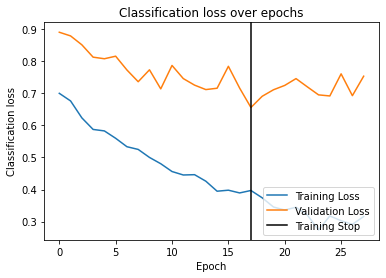

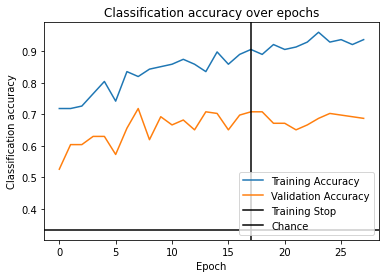

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.6584 - acc: 0.6953 - val_loss: 0.9739 - val_acc: 0.5469
Epoch 2/50 0.234s 	 loss: 0.6565 - acc: 0.7422 - val_loss: 0.9009 - val_acc: 0.5625
Epoch 3/50 0.237s 	 loss: 0.5869 - acc: 0.7891 - val_loss: 0.9581 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.249s 	 loss: 0.5848 - acc: 0.7500 - val_loss: 0.8692 - val_acc: 0.5885
Epoch 5/50 0.232s 	 loss: 0.5652 - acc: 0.7812 - val_loss: 0.8478 - val_acc: 0.6354
Epoch 6/50 0.233s 	 loss: 0.5333 - acc: 0.7578 - val_loss: 0.8576 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.240s 	 loss: 0.4861 - acc: 0.7812 - val_loss: 0.8398 - val_acc: 0.6302
Epoch 8/50 0.244s 	 loss: 0.4689 - acc: 0.8203 - val_loss: 0.8813 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.4506 - acc: 0.8594 - val_loss: 0.8188 - val_acc: 0.6510
Epoch 10/50 0.234s 	 loss: 0.4404 - acc: 0.8516 - val_loss: 0.832

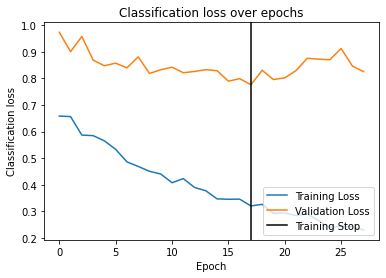

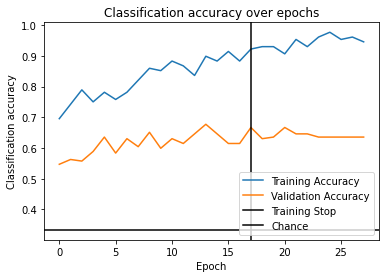

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9345 - acc: 0.5469 - val_loss: 0.5058 - val_acc: 0.8125
Epoch 2/50 0.236s 	 loss: 0.8643 - acc: 0.6406 - val_loss: 0.5735 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.254s 	 loss: 0.7681 - acc: 0.6406 - val_loss: 0.5142 - val_acc: 0.7812
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.7071 - acc: 0.7188 - val_loss: 0.4968 - val_acc: 0.8021
Epoch 5/50 0.231s 	 loss: 0.6399 - acc: 0.7344 - val_loss: 0.4907 - val_acc: 0.8698
Epoch 6/50 0.235s 	 loss: 0.6429 - acc: 0.7031 - val_loss: 0.5112 - val_acc: 0.8021
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.5873 - acc: 0.7656 - val_loss: 0.4822 - val_acc: 0.8438
Epoch 8/50 0.235s 	 loss: 0.5457 - acc: 0.7891 - val_loss: 0.5495 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5353 - acc: 0.7812 - val_loss: 0.5304 - val_acc: 0.8125
EarlyStopping counter: 2 out o

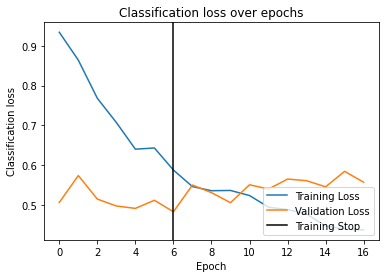

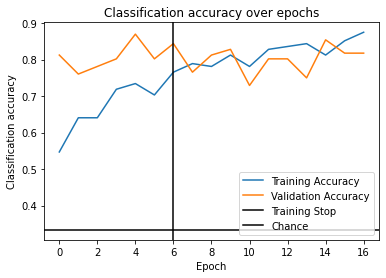

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.9894 - acc: 0.5547 - val_loss: 0.7348 - val_acc: 0.6667
Epoch 2/50 0.239s 	 loss: 0.9240 - acc: 0.6016 - val_loss: 0.7514 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8549 - acc: 0.6250 - val_loss: 0.7622 - val_acc: 0.7031
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.8159 - acc: 0.6094 - val_loss: 0.6862 - val_acc: 0.6875
Epoch 5/50 0.233s 	 loss: 0.8176 - acc: 0.6250 - val_loss: 0.7393 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.243s 	 loss: 0.8211 - acc: 0.6328 - val_loss: 0.7127 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.7609 - acc: 0.6797 - val_loss: 0.7899 - val_acc: 0.7031
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.7630 - acc: 0.6406 - val_loss: 0.7382 - val_acc: 0.7031
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.236s 	 loss: 0.7620 - acc: 0.67

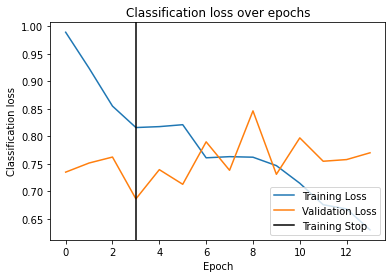

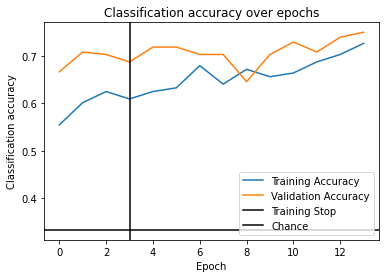

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.8903 - acc: 0.6094 - val_loss: 0.8282 - val_acc: 0.5990
Epoch 2/50 0.231s 	 loss: 0.8635 - acc: 0.6172 - val_loss: 0.8296 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.231s 	 loss: 0.8257 - acc: 0.6328 - val_loss: 0.7989 - val_acc: 0.6927
Epoch 4/50 0.245s 	 loss: 0.8193 - acc: 0.6719 - val_loss: 0.8293 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7642 - acc: 0.6875 - val_loss: 0.8622 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.7390 - acc: 0.6641 - val_loss: 0.8338 - val_acc: 0.5885
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.7121 - acc: 0.7031 - val_loss: 0.7909 - val_acc: 0.6250
Epoch 8/50 0.235s 	 loss: 0.7072 - acc: 0.7188 - val_loss: 0.8152 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.248s 	 loss: 0.6861 - acc: 0.7266 - val_loss: 0.8340 - val_acc: 0.

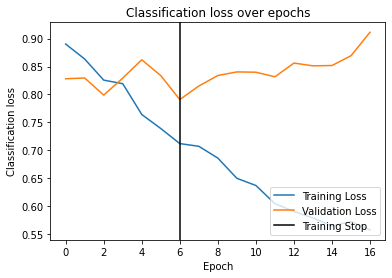

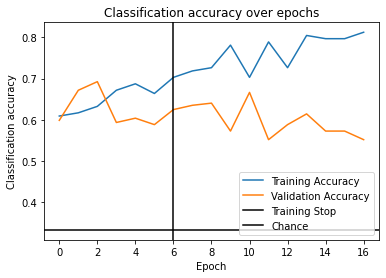

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8187 - acc: 0.6406 - val_loss: 1.1034 - val_acc: 0.5000
Epoch 2/50 0.232s 	 loss: 0.6897 - acc: 0.7188 - val_loss: 1.0782 - val_acc: 0.5208
Epoch 3/50 0.232s 	 loss: 0.6898 - acc: 0.7344 - val_loss: 1.1078 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.6955 - acc: 0.6797 - val_loss: 1.1678 - val_acc: 0.5052
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.6433 - acc: 0.7344 - val_loss: 1.1576 - val_acc: 0.4948
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.6473 - acc: 0.7656 - val_loss: 1.1978 - val_acc: 0.5000
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.237s 	 loss: 0.5668 - acc: 0.7891 - val_loss: 1.1744 - val_acc: 0.4792
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.239s 	 loss: 0.5966 - acc: 0.7422 - val_loss: 1.1752 - val_acc: 0.5417
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.242s 	 loss: 0.5392 - acc: 0.80

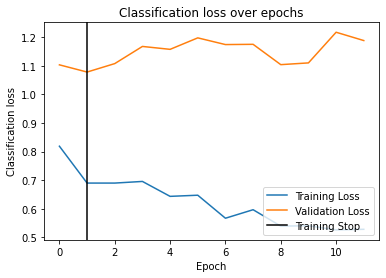

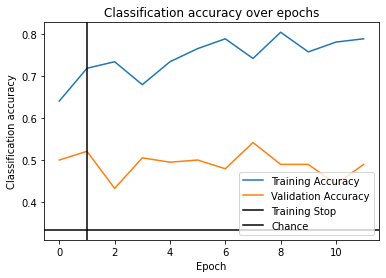

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9970 - acc: 0.5469 - val_loss: 0.8596 - val_acc: 0.6146
Epoch 2/50 0.232s 	 loss: 0.9370 - acc: 0.6250 - val_loss: 0.8626 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8921 - acc: 0.6719 - val_loss: 0.8574 - val_acc: 0.6562
Epoch 4/50 0.234s 	 loss: 0.9172 - acc: 0.6250 - val_loss: 0.8791 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.8847 - acc: 0.7109 - val_loss: 0.8687 - val_acc: 0.5677
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.8564 - acc: 0.6797 - val_loss: 0.9080 - val_acc: 0.5885
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.241s 	 loss: 0.8110 - acc: 0.6641 - val_loss: 0.8798 - val_acc: 0.5833
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.231s 	 loss: 0.8330 - acc: 0.6953 - val_loss: 0.8774 - val_acc: 0.5417
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.236s 	 loss: 0.7830 - acc: 0.69

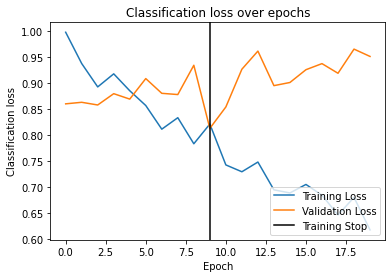

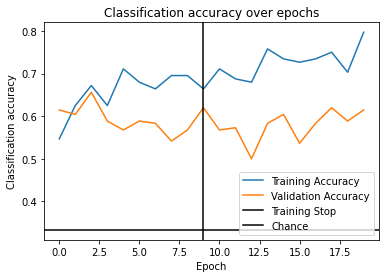

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.0390 - acc: 0.5312 - val_loss: 0.8182 - val_acc: 0.6510
Epoch 2/50 0.236s 	 loss: 0.9870 - acc: 0.5547 - val_loss: 0.7966 - val_acc: 0.6927
Epoch 3/50 0.233s 	 loss: 0.9079 - acc: 0.5781 - val_loss: 0.8481 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.9343 - acc: 0.6094 - val_loss: 0.8598 - val_acc: 0.7135
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.8822 - acc: 0.6172 - val_loss: 0.9051 - val_acc: 0.6823
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.233s 	 loss: 0.8476 - acc: 0.6406 - val_loss: 0.9206 - val_acc: 0.6250
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.233s 	 loss: 0.8239 - acc: 0.6719 - val_loss: 0.9638 - val_acc: 0.5938
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.238s 	 loss: 0.8124 - acc: 0.6641 - val_loss: 0.8709 - val_acc: 0.6615
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.253s 	 loss: 0.8047 - acc: 0.67

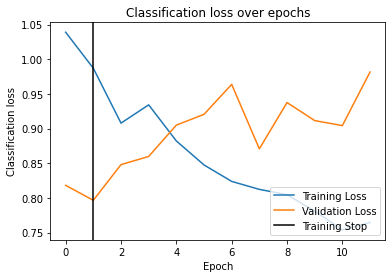

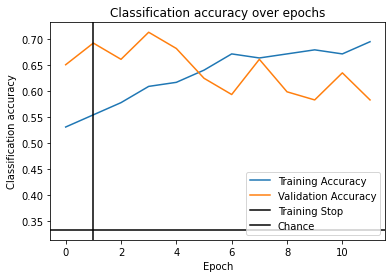

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8486 - acc: 0.6172 - val_loss: 1.1270 - val_acc: 0.5625
Epoch 2/50 0.235s 	 loss: 0.8397 - acc: 0.6328 - val_loss: 1.0986 - val_acc: 0.4948
Epoch 3/50 0.236s 	 loss: 0.7909 - acc: 0.6406 - val_loss: 1.1513 - val_acc: 0.4688
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7432 - acc: 0.6797 - val_loss: 1.2032 - val_acc: 0.4792
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.7428 - acc: 0.6875 - val_loss: 1.1718 - val_acc: 0.5000
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.232s 	 loss: 0.7159 - acc: 0.7188 - val_loss: 1.1970 - val_acc: 0.4792
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.6784 - acc: 0.7031 - val_loss: 1.2642 - val_acc: 0.4583
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.237s 	 loss: 0.6670 - acc: 0.7344 - val_loss: 1.2611 - val_acc: 0.5000
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.232s 	 loss: 0.6771 - acc: 0.72

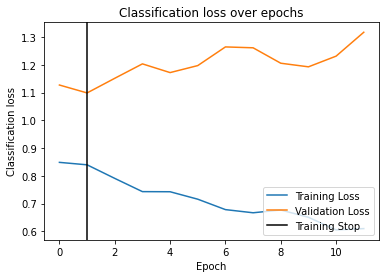

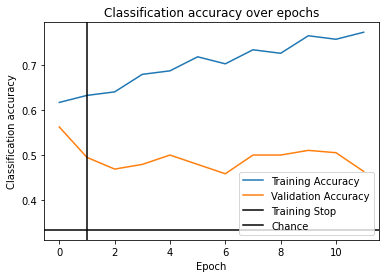

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.248s 	 loss: 0.8648 - acc: 0.6172 - val_loss: 0.6893 - val_acc: 0.7240
Epoch 2/50 0.237s 	 loss: 0.7950 - acc: 0.6328 - val_loss: 0.6718 - val_acc: 0.6667
Epoch 3/50 0.232s 	 loss: 0.7364 - acc: 0.6797 - val_loss: 0.6246 - val_acc: 0.7031
Epoch 4/50 0.235s 	 loss: 0.7006 - acc: 0.7188 - val_loss: 0.6387 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.6799 - acc: 0.7109 - val_loss: 0.6386 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.5853 - acc: 0.7734 - val_loss: 0.6038 - val_acc: 0.7240
Epoch 7/50 0.235s 	 loss: 0.6365 - acc: 0.7188 - val_loss: 0.6190 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.240s 	 loss: 0.6023 - acc: 0.7656 - val_loss: 0.6062 - val_acc: 0.7500
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.5721 - acc: 0.8047 - val_loss: 0.6090 - val_acc: 0.7031
EarlyStopping counter: 3 out o

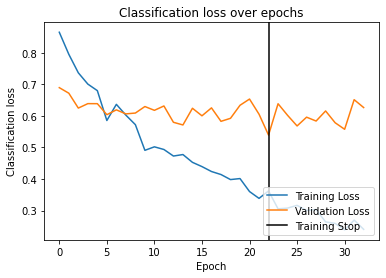

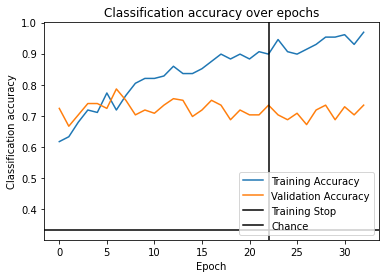

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8559 - acc: 0.5938 - val_loss: 0.6772 - val_acc: 0.7552
Epoch 2/50 0.236s 	 loss: 0.7747 - acc: 0.6172 - val_loss: 0.7070 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.7006 - acc: 0.6484 - val_loss: 0.6738 - val_acc: 0.7083
Epoch 4/50 0.234s 	 loss: 0.6854 - acc: 0.6562 - val_loss: 0.6904 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.6125 - acc: 0.7969 - val_loss: 0.6559 - val_acc: 0.7448
Epoch 6/50 0.232s 	 loss: 0.5696 - acc: 0.7812 - val_loss: 0.6910 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.241s 	 loss: 0.5746 - acc: 0.7344 - val_loss: 0.6851 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.238s 	 loss: 0.5517 - acc: 0.7969 - val_loss: 0.6629 - val_acc: 0.7083
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.238s 	 loss: 0.5540 - acc: 0.8047 - val_loss: 0.6678 - val_acc: 0.

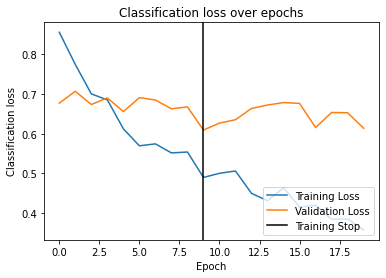

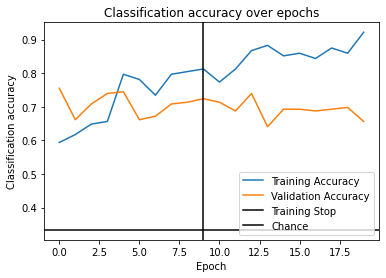

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6989 - acc: 0.7031 - val_loss: 1.0021 - val_acc: 0.4740
Epoch 2/50 0.231s 	 loss: 0.6724 - acc: 0.7109 - val_loss: 0.9085 - val_acc: 0.5417
Epoch 3/50 0.240s 	 loss: 0.6005 - acc: 0.7422 - val_loss: 0.9230 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.5726 - acc: 0.7734 - val_loss: 0.9135 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.239s 	 loss: 0.5399 - acc: 0.7578 - val_loss: 0.9145 - val_acc: 0.5260
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.242s 	 loss: 0.5387 - acc: 0.7969 - val_loss: 0.9419 - val_acc: 0.5365
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.4958 - acc: 0.8438 - val_loss: 0.9396 - val_acc: 0.4792
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.233s 	 loss: 0.4444 - acc: 0.8438 - val_loss: 0.8738 - val_acc: 0.6146
Epoch 9/50 0.237s 	 loss: 0.4401 - acc: 0.8672 - val_loss: 0.8536 - val_acc: 0.

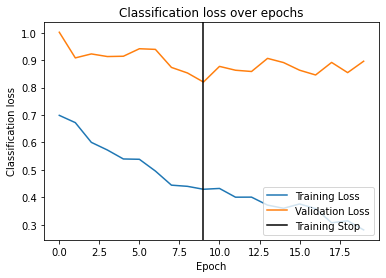

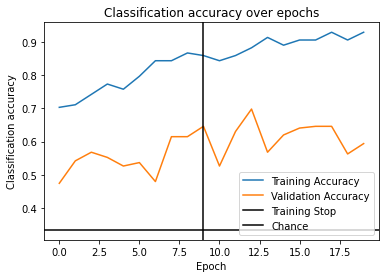

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9025 - acc: 0.6328 - val_loss: 1.0938 - val_acc: 0.4323
Epoch 2/50 0.235s 	 loss: 0.8987 - acc: 0.6094 - val_loss: 1.0368 - val_acc: 0.4896
Epoch 3/50 0.232s 	 loss: 0.8504 - acc: 0.6250 - val_loss: 1.0084 - val_acc: 0.5000
Epoch 4/50 0.241s 	 loss: 0.8154 - acc: 0.5938 - val_loss: 1.0739 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.7675 - acc: 0.6484 - val_loss: 1.0683 - val_acc: 0.5312
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.7999 - acc: 0.6328 - val_loss: 0.9588 - val_acc: 0.5677
Epoch 7/50 0.235s 	 loss: 0.7263 - acc: 0.7031 - val_loss: 1.0556 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.7052 - acc: 0.7031 - val_loss: 1.0469 - val_acc: 0.5677
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.6783 - acc: 0.7188 - val_loss: 1.0081 - val_acc: 0.5365
EarlyStopping counter: 3 out o

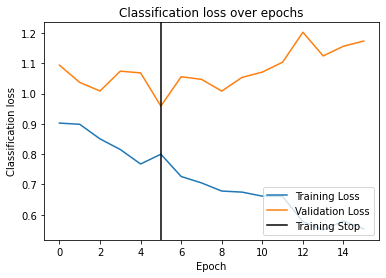

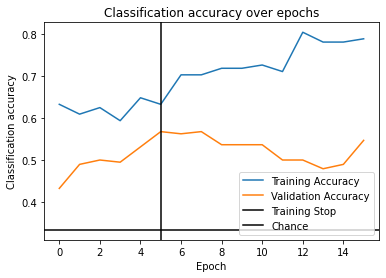

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.9668 - acc: 0.5234 - val_loss: 0.8965 - val_acc: 0.5938
Epoch 2/50 0.231s 	 loss: 0.9530 - acc: 0.5234 - val_loss: 0.9577 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.240s 	 loss: 0.9547 - acc: 0.5703 - val_loss: 0.8892 - val_acc: 0.5781
Epoch 4/50 0.236s 	 loss: 0.9052 - acc: 0.5938 - val_loss: 0.9723 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.8667 - acc: 0.6094 - val_loss: 0.8951 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.7953 - acc: 0.6094 - val_loss: 0.8885 - val_acc: 0.5260
Epoch 7/50 0.233s 	 loss: 0.8395 - acc: 0.6406 - val_loss: 0.8658 - val_acc: 0.5156
Epoch 8/50 0.231s 	 loss: 0.8082 - acc: 0.6328 - val_loss: 0.9386 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.241s 	 loss: 0.8093 - acc: 0.6562 - val_loss: 0.8443 - val_acc: 0.5938
Epoch 10/50 0.234s 	 loss: 0.7

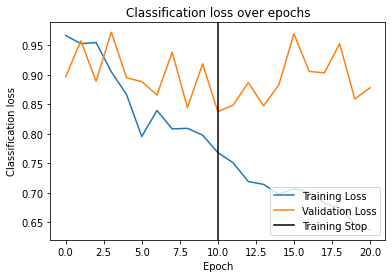

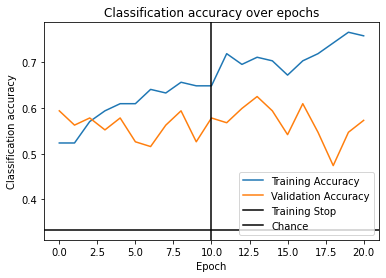

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9785 - acc: 0.5547 - val_loss: 0.9859 - val_acc: 0.5312
Epoch 2/50 0.240s 	 loss: 0.9443 - acc: 0.6016 - val_loss: 0.9506 - val_acc: 0.6094
Epoch 3/50 0.233s 	 loss: 0.9033 - acc: 0.6172 - val_loss: 0.9896 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.232s 	 loss: 0.8951 - acc: 0.6172 - val_loss: 0.9854 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.8434 - acc: 0.6250 - val_loss: 0.9259 - val_acc: 0.4688
Epoch 6/50 0.233s 	 loss: 0.8077 - acc: 0.6484 - val_loss: 0.9858 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.7661 - acc: 0.6484 - val_loss: 0.9907 - val_acc: 0.5677
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.237s 	 loss: 0.7704 - acc: 0.6406 - val_loss: 1.0132 - val_acc: 0.4896
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.7228 - acc: 0.6875 - val_loss: 0.9494 - val_acc: 0.

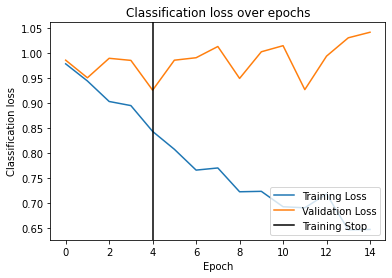

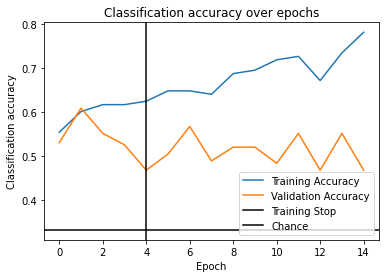

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8585 - acc: 0.6250 - val_loss: 0.5812 - val_acc: 0.7500
Epoch 2/50 0.238s 	 loss: 0.8315 - acc: 0.6094 - val_loss: 0.6017 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.7773 - acc: 0.6328 - val_loss: 0.5316 - val_acc: 0.8750
Epoch 4/50 0.236s 	 loss: 0.7383 - acc: 0.6797 - val_loss: 0.5771 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.6872 - acc: 0.6719 - val_loss: 0.6307 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.6674 - acc: 0.7109 - val_loss: 0.5833 - val_acc: 0.7708
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.247s 	 loss: 0.6527 - acc: 0.7422 - val_loss: 0.5893 - val_acc: 0.7396
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.238s 	 loss: 0.6410 - acc: 0.7344 - val_loss: 0.5811 - val_acc: 0.8073
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.238s 	 loss: 0.5836 - acc: 0.73

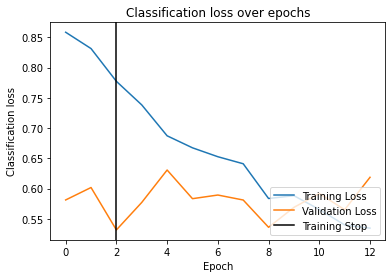

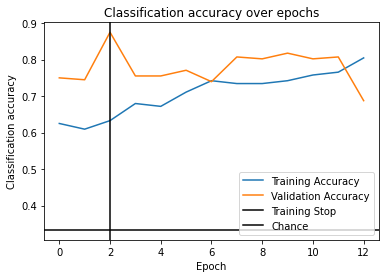

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8080 - acc: 0.6016 - val_loss: 0.9352 - val_acc: 0.5260
Epoch 2/50 0.239s 	 loss: 0.6897 - acc: 0.7422 - val_loss: 0.8625 - val_acc: 0.5208
Epoch 3/50 0.247s 	 loss: 0.7192 - acc: 0.6562 - val_loss: 0.8357 - val_acc: 0.6198
Epoch 4/50 0.234s 	 loss: 0.6379 - acc: 0.7266 - val_loss: 0.7581 - val_acc: 0.6562
Epoch 5/50 0.236s 	 loss: 0.6131 - acc: 0.7109 - val_loss: 0.7262 - val_acc: 0.6250
Epoch 6/50 0.235s 	 loss: 0.6052 - acc: 0.7656 - val_loss: 0.8090 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.6047 - acc: 0.7734 - val_loss: 0.7386 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.243s 	 loss: 0.5981 - acc: 0.7500 - val_loss: 0.7356 - val_acc: 0.6719
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.240s 	 loss: 0.5420 - acc: 0.8359 - val_loss: 0.8390 - val_acc: 0.5781
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.239s 	 loss: 0.4

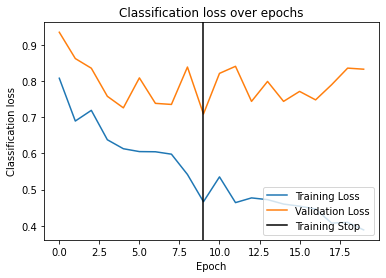

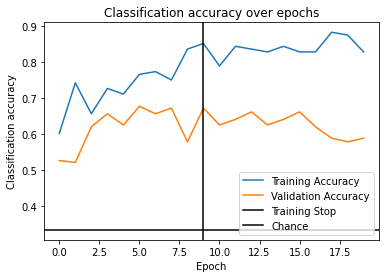

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.7321 - acc: 0.6562 - val_loss: 0.9278 - val_acc: 0.5677
Epoch 2/50 0.242s 	 loss: 0.6589 - acc: 0.6562 - val_loss: 0.8767 - val_acc: 0.6042
Epoch 3/50 0.232s 	 loss: 0.6179 - acc: 0.7422 - val_loss: 0.8373 - val_acc: 0.6198
Epoch 4/50 0.232s 	 loss: 0.5377 - acc: 0.8125 - val_loss: 0.8938 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.5493 - acc: 0.7891 - val_loss: 0.8585 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.236s 	 loss: 0.5686 - acc: 0.7578 - val_loss: 0.8817 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.233s 	 loss: 0.5053 - acc: 0.8125 - val_loss: 0.8486 - val_acc: 0.6302
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.231s 	 loss: 0.4667 - acc: 0.8281 - val_loss: 0.9203 - val_acc: 0.5312
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.234s 	 loss: 0.4623 - acc: 0.8359 - val_loss: 0.9765 - val_acc: 0.

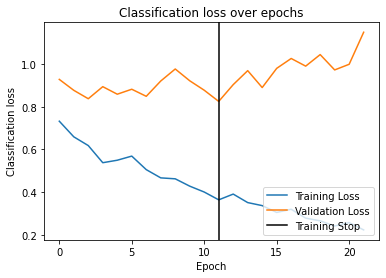

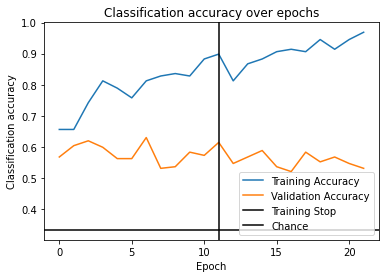

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 1.3948 - acc: 0.4219 - val_loss: 0.8000 - val_acc: 0.6510
Epoch 2/50 0.233s 	 loss: 1.1816 - acc: 0.5078 - val_loss: 0.8124 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 1.0496 - acc: 0.5469 - val_loss: 0.9206 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.9793 - acc: 0.5312 - val_loss: 0.8456 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.240s 	 loss: 0.8940 - acc: 0.6016 - val_loss: 0.8793 - val_acc: 0.6094
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.236s 	 loss: 0.8939 - acc: 0.5859 - val_loss: 0.8719 - val_acc: 0.5990
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.233s 	 loss: 0.8817 - acc: 0.5938 - val_loss: 0.8870 - val_acc: 0.6615
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.240s 	 loss: 0.8695 - acc: 0.6250 - val_loss: 0.8426 - val_acc: 0.6198
EarlyStopping counter: 7 out of 10
Epoch 9/5

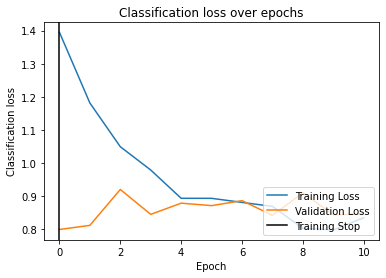

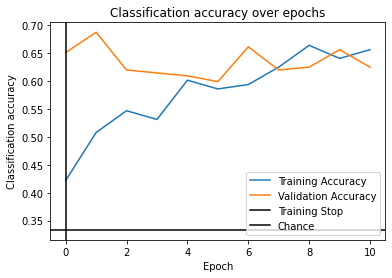

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 1.0241 - acc: 0.5156 - val_loss: 1.6181 - val_acc: 0.3698
Epoch 2/50 0.235s 	 loss: 0.9274 - acc: 0.6016 - val_loss: 1.5599 - val_acc: 0.4115
Epoch 3/50 0.233s 	 loss: 0.8167 - acc: 0.6484 - val_loss: 1.3750 - val_acc: 0.4427
Epoch 4/50 0.233s 	 loss: 0.7829 - acc: 0.6875 - val_loss: 1.3631 - val_acc: 0.3438
Epoch 5/50 0.231s 	 loss: 0.6842 - acc: 0.6953 - val_loss: 1.2978 - val_acc: 0.3750
Epoch 6/50 0.232s 	 loss: 0.7370 - acc: 0.6641 - val_loss: 1.3599 - val_acc: 0.4010
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.6797 - acc: 0.7578 - val_loss: 1.2582 - val_acc: 0.4375
Epoch 8/50 0.232s 	 loss: 0.6338 - acc: 0.7812 - val_loss: 1.2033 - val_acc: 0.3542
Epoch 9/50 0.234s 	 loss: 0.6116 - acc: 0.7422 - val_loss: 1.2250 - val_acc: 0.4740
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.240s 	 loss: 0.6209 - acc: 0.7500 - val_loss: 1.2479 - val_acc: 0.4167
EarlyStopping c

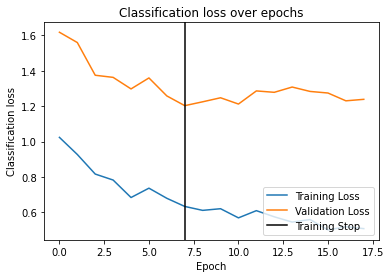

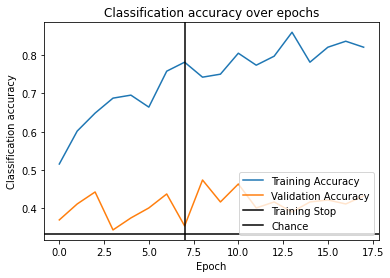

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.1966 - acc: 0.5234 - val_loss: 1.2128 - val_acc: 0.4792
Epoch 2/50 0.233s 	 loss: 1.0246 - acc: 0.5703 - val_loss: 1.1679 - val_acc: 0.4896
Epoch 3/50 0.231s 	 loss: 0.9638 - acc: 0.5781 - val_loss: 1.0638 - val_acc: 0.5208
Epoch 4/50 0.233s 	 loss: 0.9116 - acc: 0.5859 - val_loss: 1.0179 - val_acc: 0.5312
Epoch 5/50 0.235s 	 loss: 0.8642 - acc: 0.5859 - val_loss: 0.9941 - val_acc: 0.5260
Epoch 6/50 0.238s 	 loss: 0.7970 - acc: 0.6875 - val_loss: 0.8950 - val_acc: 0.6667
Epoch 7/50 0.233s 	 loss: 0.7374 - acc: 0.6406 - val_loss: 0.9915 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.236s 	 loss: 0.7772 - acc: 0.6719 - val_loss: 0.9339 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.7150 - acc: 0.7188 - val_loss: 0.9922 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.235s 	 loss: 0.6577 - acc: 0.7422 - val_loss: 0.891

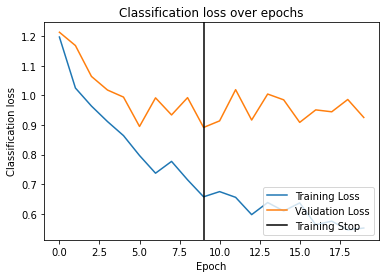

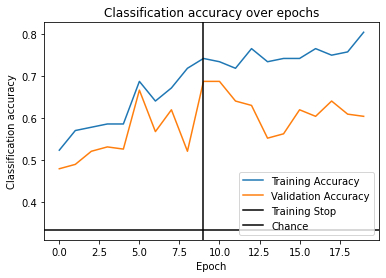

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8490 - acc: 0.6172 - val_loss: 0.9188 - val_acc: 0.5417
Epoch 2/50 0.230s 	 loss: 0.7682 - acc: 0.6172 - val_loss: 0.8903 - val_acc: 0.6146
Epoch 3/50 0.232s 	 loss: 0.7828 - acc: 0.6406 - val_loss: 0.8865 - val_acc: 0.6354
Epoch 4/50 0.237s 	 loss: 0.7131 - acc: 0.6562 - val_loss: 0.8758 - val_acc: 0.5521
Epoch 5/50 0.236s 	 loss: 0.6662 - acc: 0.7344 - val_loss: 0.8509 - val_acc: 0.6198
Epoch 6/50 0.232s 	 loss: 0.6873 - acc: 0.6797 - val_loss: 0.8816 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.6082 - acc: 0.7578 - val_loss: 0.9291 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.6008 - acc: 0.7734 - val_loss: 0.8739 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.237s 	 loss: 0.5985 - acc: 0.7656 - val_loss: 0.8751 - val_acc: 0.6042
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.240s 	 loss: 0.6

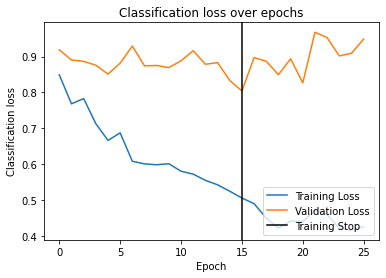

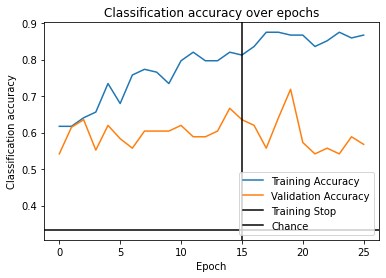

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8246 - acc: 0.6562 - val_loss: 0.9354 - val_acc: 0.6094
Epoch 2/50 0.232s 	 loss: 0.7650 - acc: 0.6406 - val_loss: 0.9382 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.7613 - acc: 0.6562 - val_loss: 0.8825 - val_acc: 0.5417
Epoch 4/50 0.235s 	 loss: 0.7099 - acc: 0.6875 - val_loss: 0.8455 - val_acc: 0.5938
Epoch 5/50 0.234s 	 loss: 0.6983 - acc: 0.6562 - val_loss: 0.9283 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.7198 - acc: 0.6641 - val_loss: 0.7534 - val_acc: 0.6927
Epoch 7/50 0.236s 	 loss: 0.6438 - acc: 0.7109 - val_loss: 0.8579 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.6221 - acc: 0.6875 - val_loss: 0.8691 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.6191 - acc: 0.7578 - val_loss: 0.8164 - val_acc: 0.6250
EarlyStopping counter: 3 out o

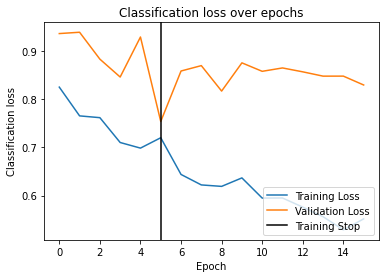

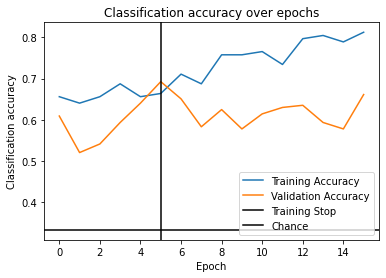

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9738 - acc: 0.5000 - val_loss: 0.7182 - val_acc: 0.6719
Epoch 2/50 0.238s 	 loss: 0.9182 - acc: 0.5469 - val_loss: 0.7352 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.8562 - acc: 0.5859 - val_loss: 0.7153 - val_acc: 0.6510
Epoch 4/50 0.233s 	 loss: 0.8030 - acc: 0.6328 - val_loss: 0.7380 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.7631 - acc: 0.6406 - val_loss: 0.7275 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.7213 - acc: 0.6641 - val_loss: 0.7210 - val_acc: 0.6094
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.7422 - acc: 0.6250 - val_loss: 0.6974 - val_acc: 0.6823
Epoch 8/50 0.232s 	 loss: 0.6678 - acc: 0.7188 - val_loss: 0.7133 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.233s 	 loss: 0.6598 - acc: 0.6797 - val_loss: 0.7061 - val_acc: 0.

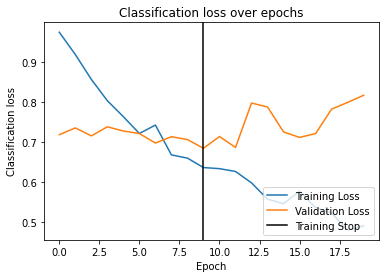

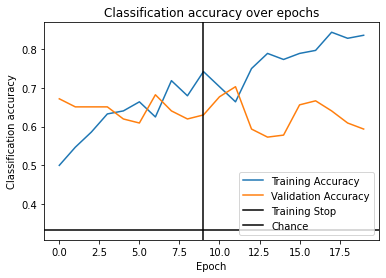

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7868 - acc: 0.6719 - val_loss: 0.7261 - val_acc: 0.6927
Epoch 2/50 0.231s 	 loss: 0.7287 - acc: 0.7031 - val_loss: 0.6454 - val_acc: 0.7188
Epoch 3/50 0.242s 	 loss: 0.7227 - acc: 0.7109 - val_loss: 0.6559 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.6792 - acc: 0.6875 - val_loss: 0.6582 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.234s 	 loss: 0.6571 - acc: 0.7109 - val_loss: 0.6245 - val_acc: 0.6927
Epoch 6/50 0.233s 	 loss: 0.5875 - acc: 0.7969 - val_loss: 0.6056 - val_acc: 0.7240
Epoch 7/50 0.233s 	 loss: 0.5994 - acc: 0.7188 - val_loss: 0.6369 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.5860 - acc: 0.7422 - val_loss: 0.5989 - val_acc: 0.7083
Epoch 9/50 0.242s 	 loss: 0.5299 - acc: 0.8281 - val_loss: 0.5858 - val_acc: 0.7344
Epoch 10/50 0.234s 	 loss: 0.5378 - acc: 0.7969 - val_loss: 0.590

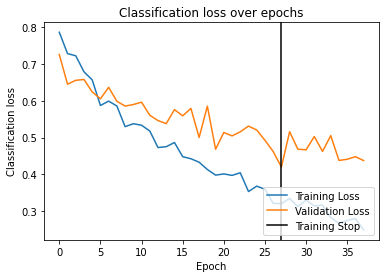

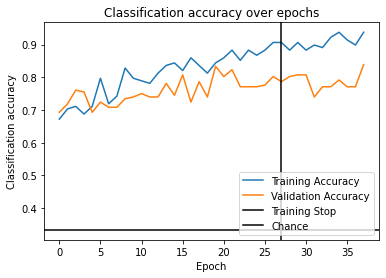

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7801 - acc: 0.6406 - val_loss: 0.8334 - val_acc: 0.6250
Epoch 2/50 0.233s 	 loss: 0.6913 - acc: 0.7344 - val_loss: 0.8465 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.240s 	 loss: 0.6805 - acc: 0.7422 - val_loss: 0.8551 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.6372 - acc: 0.7422 - val_loss: 0.8019 - val_acc: 0.6250
Epoch 5/50 0.234s 	 loss: 0.5914 - acc: 0.7812 - val_loss: 0.7498 - val_acc: 0.6927
Epoch 6/50 0.232s 	 loss: 0.5740 - acc: 0.7812 - val_loss: 0.8464 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.5687 - acc: 0.7969 - val_loss: 0.7578 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.242s 	 loss: 0.5557 - acc: 0.7812 - val_loss: 0.7048 - val_acc: 0.6771
Epoch 9/50 0.235s 	 loss: 0.5049 - acc: 0.8203 - val_loss: 0.7189 - val_acc: 0.6406
EarlyStopping counter: 1 out o

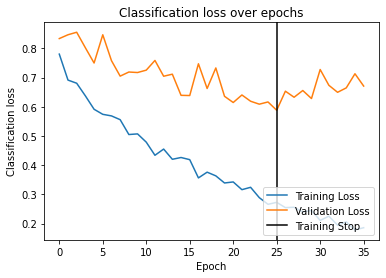

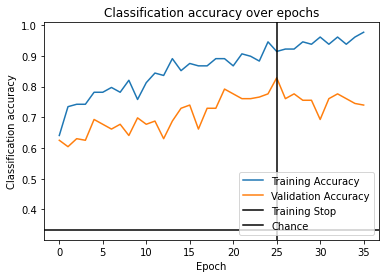

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7587 - acc: 0.6562 - val_loss: 0.8002 - val_acc: 0.7292
Epoch 2/50 0.251s 	 loss: 0.7091 - acc: 0.6953 - val_loss: 0.8054 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.6804 - acc: 0.7266 - val_loss: 0.7503 - val_acc: 0.6510
Epoch 4/50 0.233s 	 loss: 0.6119 - acc: 0.7422 - val_loss: 0.7549 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.5840 - acc: 0.7891 - val_loss: 0.7866 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.231s 	 loss: 0.5334 - acc: 0.8203 - val_loss: 0.7122 - val_acc: 0.6667
Epoch 7/50 0.236s 	 loss: 0.5426 - acc: 0.8203 - val_loss: 0.6883 - val_acc: 0.7083
Epoch 8/50 0.237s 	 loss: 0.5028 - acc: 0.8203 - val_loss: 0.7275 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.232s 	 loss: 0.5148 - acc: 0.8203 - val_loss: 0.7188 - val_acc: 0.6875
EarlyStopping counter: 2 out o

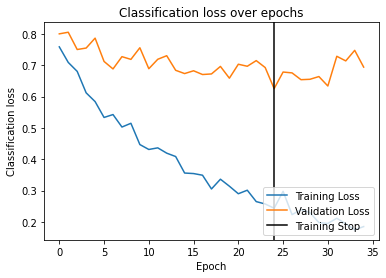

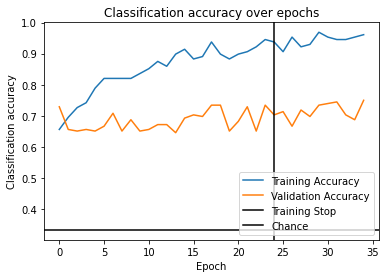

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.5420 - acc: 0.8281 - val_loss: 0.4563 - val_acc: 0.8594
Epoch 2/50 0.233s 	 loss: 0.5142 - acc: 0.7969 - val_loss: 0.3971 - val_acc: 0.9062
Epoch 3/50 0.234s 	 loss: 0.4280 - acc: 0.8438 - val_loss: 0.4102 - val_acc: 0.8594
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.4184 - acc: 0.8828 - val_loss: 0.3573 - val_acc: 0.9219
Epoch 5/50 0.235s 	 loss: 0.3680 - acc: 0.8750 - val_loss: 0.3340 - val_acc: 0.9219
Epoch 6/50 0.233s 	 loss: 0.3485 - acc: 0.9141 - val_loss: 0.3340 - val_acc: 0.8750
Epoch 7/50 0.233s 	 loss: 0.3270 - acc: 0.8984 - val_loss: 0.3298 - val_acc: 0.9062
Epoch 8/50 0.238s 	 loss: 0.3011 - acc: 0.9219 - val_loss: 0.3048 - val_acc: 0.9062
Epoch 9/50 0.236s 	 loss: 0.2995 - acc: 0.9297 - val_loss: 0.2834 - val_acc: 0.9219
Epoch 10/50 0.231s 	 loss: 0.2868 - acc: 0.9141 - val_loss: 0.2742 - val_acc: 0.9062
Epoch 11/50 0.230s 	 loss: 0.2635 - acc: 0.9062 - 

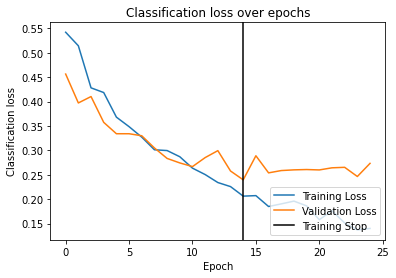

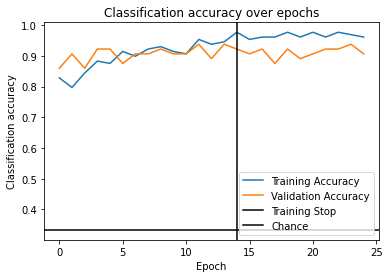

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5031 - acc: 0.8125 - val_loss: 0.4912 - val_acc: 0.8542
Epoch 2/50 0.236s 	 loss: 0.4450 - acc: 0.8359 - val_loss: 0.4444 - val_acc: 0.8646
Epoch 3/50 0.247s 	 loss: 0.4056 - acc: 0.8594 - val_loss: 0.4290 - val_acc: 0.8385
Epoch 4/50 0.234s 	 loss: 0.3856 - acc: 0.8906 - val_loss: 0.4259 - val_acc: 0.8646
Epoch 5/50 0.234s 	 loss: 0.3522 - acc: 0.8906 - val_loss: 0.4188 - val_acc: 0.8854
Epoch 6/50 0.238s 	 loss: 0.3234 - acc: 0.9141 - val_loss: 0.3740 - val_acc: 0.8854
Epoch 7/50 0.232s 	 loss: 0.2982 - acc: 0.9297 - val_loss: 0.4049 - val_acc: 0.8698
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.231s 	 loss: 0.2972 - acc: 0.9219 - val_loss: 0.3716 - val_acc: 0.8906
Epoch 9/50 0.240s 	 loss: 0.2578 - acc: 0.9453 - val_loss: 0.3433 - val_acc: 0.9062
Epoch 10/50 0.232s 	 loss: 0.2526 - acc: 0.9219 - val_loss: 0.3571 - val_acc: 0.8750
EarlyStopping counter: 1 out of 10
Epoch 11/50 0.2

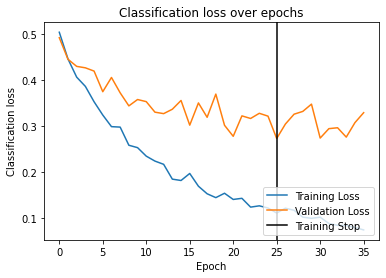

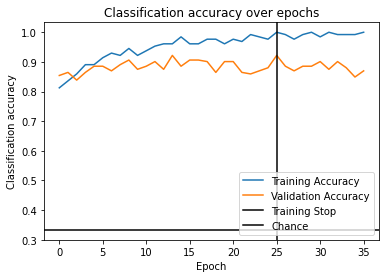

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.4716 - acc: 0.8438 - val_loss: 0.5339 - val_acc: 0.8229
Epoch 2/50 0.233s 	 loss: 0.4356 - acc: 0.8672 - val_loss: 0.5012 - val_acc: 0.7865
Epoch 3/50 0.236s 	 loss: 0.3730 - acc: 0.9141 - val_loss: 0.5220 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.3496 - acc: 0.8984 - val_loss: 0.4839 - val_acc: 0.8073
Epoch 5/50 0.234s 	 loss: 0.3186 - acc: 0.8984 - val_loss: 0.4609 - val_acc: 0.7917
Epoch 6/50 0.239s 	 loss: 0.3184 - acc: 0.9141 - val_loss: 0.4618 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.2748 - acc: 0.9297 - val_loss: 0.3914 - val_acc: 0.8073
Epoch 8/50 0.232s 	 loss: 0.2565 - acc: 0.9531 - val_loss: 0.4055 - val_acc: 0.8229
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.2437 - acc: 0.9688 - val_loss: 0.4076 - val_acc: 0.8542
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.234s 	 loss: 0.2

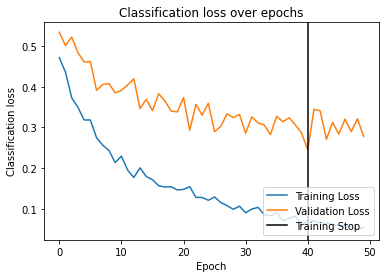

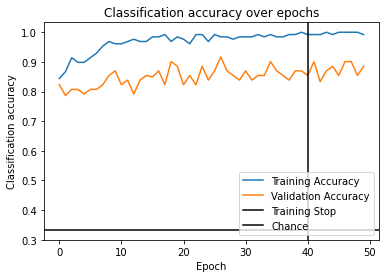

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 0.5383 - acc: 0.8281 - val_loss: 0.6257 - val_acc: 0.7969
Epoch 2/50 0.235s 	 loss: 0.4869 - acc: 0.8594 - val_loss: 0.6434 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.4098 - acc: 0.8906 - val_loss: 0.6264 - val_acc: 0.7969
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.4223 - acc: 0.8750 - val_loss: 0.6374 - val_acc: 0.7917
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.3767 - acc: 0.8828 - val_loss: 0.5981 - val_acc: 0.7760
Epoch 6/50 0.237s 	 loss: 0.3747 - acc: 0.8750 - val_loss: 0.5477 - val_acc: 0.7656
Epoch 7/50 0.238s 	 loss: 0.3432 - acc: 0.9141 - val_loss: 0.6112 - val_acc: 0.7760
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.242s 	 loss: 0.3384 - acc: 0.9141 - val_loss: 0.6385 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.241s 	 loss: 0.3303 - acc: 0.9141 - val_loss: 0.5982 - val_acc: 0.

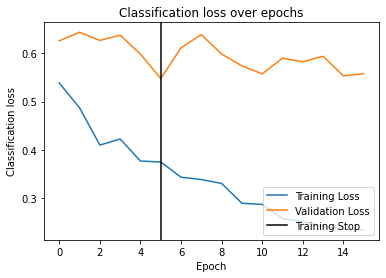

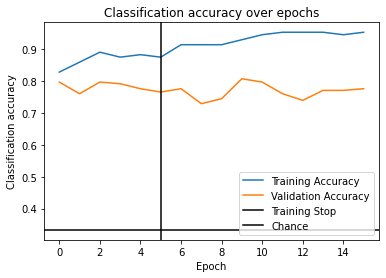

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.5996 - acc: 0.8047 - val_loss: 0.5133 - val_acc: 0.8854
Epoch 2/50 0.240s 	 loss: 0.5320 - acc: 0.8047 - val_loss: 0.4366 - val_acc: 0.9219
Epoch 3/50 0.232s 	 loss: 0.4979 - acc: 0.8359 - val_loss: 0.4277 - val_acc: 0.9219
Epoch 4/50 0.234s 	 loss: 0.4702 - acc: 0.8359 - val_loss: 0.4981 - val_acc: 0.8438
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.4546 - acc: 0.8750 - val_loss: 0.4434 - val_acc: 0.8385
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.4292 - acc: 0.8594 - val_loss: 0.4191 - val_acc: 0.8750
Epoch 7/50 0.234s 	 loss: 0.3975 - acc: 0.8594 - val_loss: 0.3997 - val_acc: 0.8906
Epoch 8/50 0.247s 	 loss: 0.3886 - acc: 0.8750 - val_loss: 0.3904 - val_acc: 0.8906
Epoch 9/50 0.233s 	 loss: 0.3808 - acc: 0.8984 - val_loss: 0.4256 - val_acc: 0.7969
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.3739 - acc: 0.8594 - val_loss: 0.387

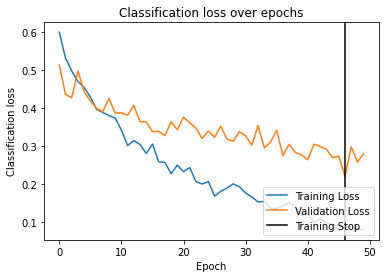

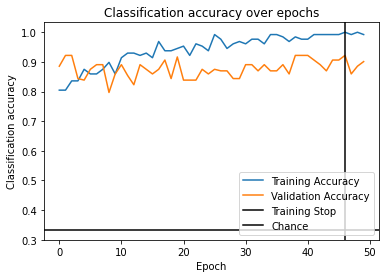

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5623 - acc: 0.8125 - val_loss: 0.5142 - val_acc: 0.8125
Epoch 2/50 0.233s 	 loss: 0.5351 - acc: 0.7812 - val_loss: 0.5393 - val_acc: 0.8021
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.247s 	 loss: 0.4725 - acc: 0.8594 - val_loss: 0.4980 - val_acc: 0.8594
Epoch 4/50 0.236s 	 loss: 0.4712 - acc: 0.8516 - val_loss: 0.5151 - val_acc: 0.8021
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.4473 - acc: 0.8359 - val_loss: 0.5119 - val_acc: 0.8333
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.4163 - acc: 0.8672 - val_loss: 0.5002 - val_acc: 0.8333
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.4068 - acc: 0.8359 - val_loss: 0.4652 - val_acc: 0.8281
Epoch 8/50 0.247s 	 loss: 0.3733 - acc: 0.9062 - val_loss: 0.4348 - val_acc: 0.8490
Epoch 9/50 0.235s 	 loss: 0.3692 - acc: 0.8516 - val_loss: 0.5053 - val_acc: 0.8490
EarlyStopping counter: 1 out o

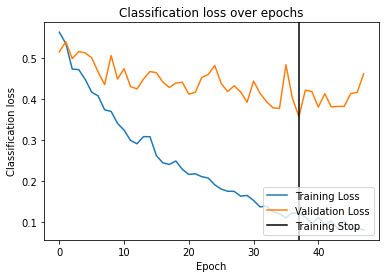

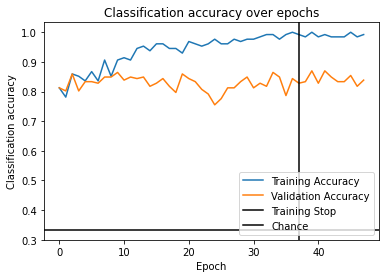

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.1545 - acc: 0.5234 - val_loss: 1.1919 - val_acc: 0.5052
Epoch 2/50 0.234s 	 loss: 1.1218 - acc: 0.5234 - val_loss: 1.1587 - val_acc: 0.5573
Epoch 3/50 0.233s 	 loss: 1.0406 - acc: 0.5469 - val_loss: 1.1092 - val_acc: 0.5260
Epoch 4/50 0.233s 	 loss: 1.0181 - acc: 0.5547 - val_loss: 1.1589 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.9963 - acc: 0.5469 - val_loss: 1.1252 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.9706 - acc: 0.5781 - val_loss: 1.1246 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.9528 - acc: 0.5469 - val_loss: 1.1048 - val_acc: 0.5521
Epoch 8/50 0.235s 	 loss: 0.9354 - acc: 0.6328 - val_loss: 1.0985 - val_acc: 0.5417
Epoch 9/50 0.234s 	 loss: 0.9446 - acc: 0.5703 - val_loss: 1.0957 - val_acc: 0.5000
Epoch 10/50 0.234s 	 loss: 0.9258 - acc: 0.6016 - val_loss: 1.079

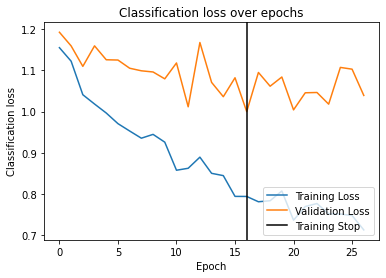

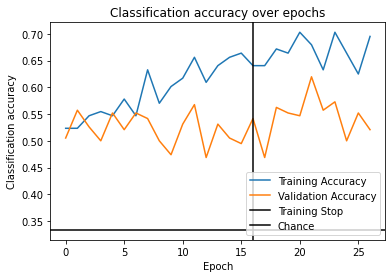

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.1750 - acc: 0.5547 - val_loss: 1.2143 - val_acc: 0.4427
Epoch 2/50 0.237s 	 loss: 1.0437 - acc: 0.5469 - val_loss: 1.3099 - val_acc: 0.3906
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 1.0880 - acc: 0.5469 - val_loss: 1.2088 - val_acc: 0.3802
Epoch 4/50 0.248s 	 loss: 0.9599 - acc: 0.5703 - val_loss: 1.1472 - val_acc: 0.4479
Epoch 5/50 0.236s 	 loss: 0.9716 - acc: 0.5625 - val_loss: 1.2190 - val_acc: 0.3750
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.9429 - acc: 0.5859 - val_loss: 1.1807 - val_acc: 0.4271
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.240s 	 loss: 0.9539 - acc: 0.6172 - val_loss: 1.1742 - val_acc: 0.3854
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.9062 - acc: 0.6250 - val_loss: 1.1397 - val_acc: 0.4167
Epoch 9/50 0.231s 	 loss: 0.8873 - acc: 0.6562 - val_loss: 1.1617 - val_acc: 0.4740
EarlyStopping counter: 1 out o

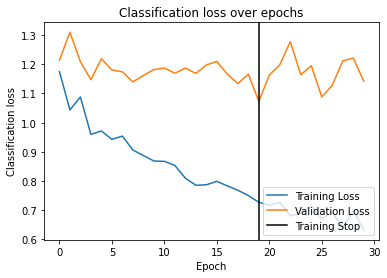

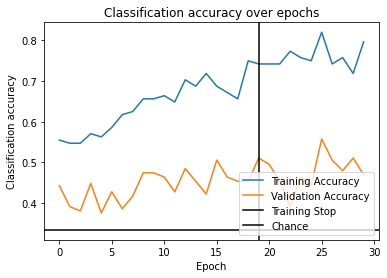

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.1928 - acc: 0.4922 - val_loss: 1.0952 - val_acc: 0.5729
Epoch 2/50 0.244s 	 loss: 1.1574 - acc: 0.4844 - val_loss: 1.0425 - val_acc: 0.6198
Epoch 3/50 0.234s 	 loss: 1.0602 - acc: 0.5078 - val_loss: 1.0442 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 1.0924 - acc: 0.5156 - val_loss: 1.1042 - val_acc: 0.5208
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 1.0038 - acc: 0.5312 - val_loss: 1.0574 - val_acc: 0.5417
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.231s 	 loss: 0.9415 - acc: 0.5781 - val_loss: 1.0863 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.9562 - acc: 0.5547 - val_loss: 1.0901 - val_acc: 0.4792
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.260s 	 loss: 0.9307 - acc: 0.5547 - val_loss: 1.1001 - val_acc: 0.4896
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.239s 	 loss: 0.9108 - acc: 0.58

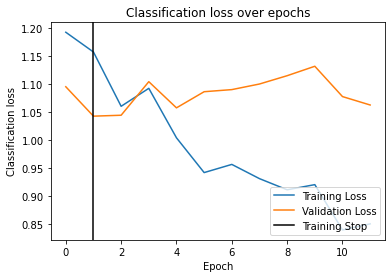

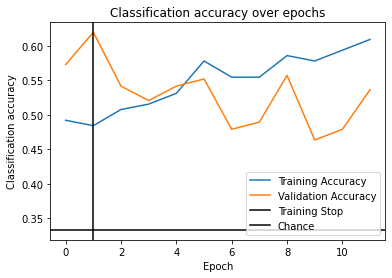

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.7859 - acc: 0.6719 - val_loss: 1.0749 - val_acc: 0.5156
Epoch 2/50 0.233s 	 loss: 0.7366 - acc: 0.7031 - val_loss: 0.9932 - val_acc: 0.5365
Epoch 3/50 0.234s 	 loss: 0.6664 - acc: 0.7109 - val_loss: 0.9060 - val_acc: 0.5260
Epoch 4/50 0.232s 	 loss: 0.6246 - acc: 0.7266 - val_loss: 0.8766 - val_acc: 0.5729
Epoch 5/50 0.236s 	 loss: 0.6001 - acc: 0.7734 - val_loss: 0.7942 - val_acc: 0.6354
Epoch 6/50 0.231s 	 loss: 0.5420 - acc: 0.7500 - val_loss: 0.7698 - val_acc: 0.6667
Epoch 7/50 0.236s 	 loss: 0.5068 - acc: 0.7969 - val_loss: 0.7560 - val_acc: 0.6510
Epoch 8/50 0.231s 	 loss: 0.4749 - acc: 0.8125 - val_loss: 0.8067 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.4463 - acc: 0.8281 - val_loss: 0.7565 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.235s 	 loss: 0.3950 - acc: 0.8906 - val_loss: 0.7328 - val_acc: 0.6302
Epoch 11/50 0.2

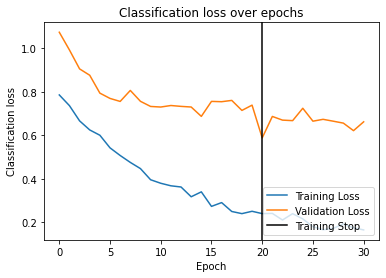

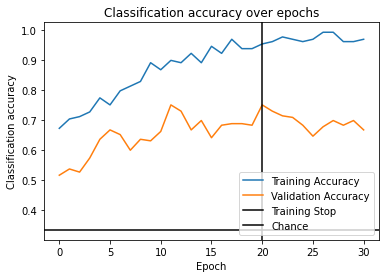

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8996 - acc: 0.5859 - val_loss: 0.7306 - val_acc: 0.7188
Epoch 2/50 0.234s 	 loss: 0.7866 - acc: 0.5859 - val_loss: 0.7040 - val_acc: 0.6823
Epoch 3/50 0.234s 	 loss: 0.7338 - acc: 0.6562 - val_loss: 0.7337 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.6329 - acc: 0.7422 - val_loss: 0.7465 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.232s 	 loss: 0.5596 - acc: 0.7500 - val_loss: 0.6884 - val_acc: 0.7292
Epoch 6/50 0.235s 	 loss: 0.5892 - acc: 0.7422 - val_loss: 0.6999 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.5221 - acc: 0.8047 - val_loss: 0.6787 - val_acc: 0.6875
Epoch 8/50 0.236s 	 loss: 0.4968 - acc: 0.8438 - val_loss: 0.6202 - val_acc: 0.7135
Epoch 9/50 0.235s 	 loss: 0.5096 - acc: 0.8125 - val_loss: 0.6745 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.4

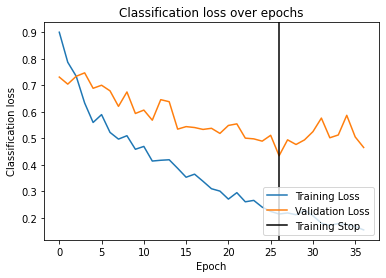

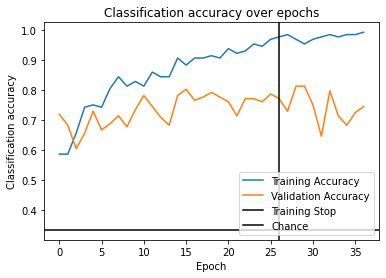

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9135 - acc: 0.6328 - val_loss: 0.8399 - val_acc: 0.6406
Epoch 2/50 0.234s 	 loss: 0.8210 - acc: 0.6406 - val_loss: 0.8051 - val_acc: 0.6615
Epoch 3/50 0.246s 	 loss: 0.7011 - acc: 0.7188 - val_loss: 0.7457 - val_acc: 0.6458
Epoch 4/50 0.233s 	 loss: 0.6312 - acc: 0.7578 - val_loss: 0.7082 - val_acc: 0.6823
Epoch 5/50 0.233s 	 loss: 0.5643 - acc: 0.7969 - val_loss: 0.6873 - val_acc: 0.6615
Epoch 6/50 0.233s 	 loss: 0.5446 - acc: 0.7812 - val_loss: 0.6419 - val_acc: 0.7083
Epoch 7/50 0.238s 	 loss: 0.5114 - acc: 0.8203 - val_loss: 0.6568 - val_acc: 0.7448
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.4920 - acc: 0.8438 - val_loss: 0.6043 - val_acc: 0.7344
Epoch 9/50 0.231s 	 loss: 0.4647 - acc: 0.8047 - val_loss: 0.6933 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.242s 	 loss: 0.4471 - acc: 0.8672 - val_loss: 0.6870 - val_acc: 0.6562
EarlyStopping c

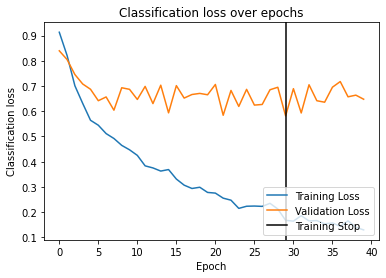

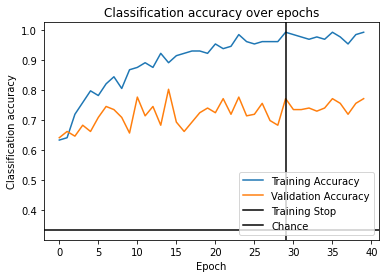

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8424 - acc: 0.6406 - val_loss: 0.7083 - val_acc: 0.7188
Epoch 2/50 0.233s 	 loss: 0.8096 - acc: 0.6406 - val_loss: 0.6873 - val_acc: 0.7396
Epoch 3/50 0.237s 	 loss: 0.7951 - acc: 0.6484 - val_loss: 0.6579 - val_acc: 0.8021
Epoch 4/50 0.236s 	 loss: 0.8128 - acc: 0.6953 - val_loss: 0.6996 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.241s 	 loss: 0.7538 - acc: 0.6562 - val_loss: 0.7017 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.243s 	 loss: 0.7360 - acc: 0.7188 - val_loss: 0.6733 - val_acc: 0.8177
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.6897 - acc: 0.7656 - val_loss: 0.6727 - val_acc: 0.7240
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.239s 	 loss: 0.6842 - acc: 0.7031 - val_loss: 0.6976 - val_acc: 0.7396
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.237s 	 loss: 0.6883 - acc: 0.6875 - val_loss: 0.6824 - val_acc: 0.

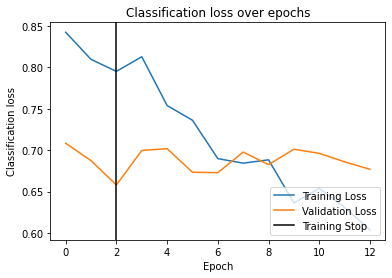

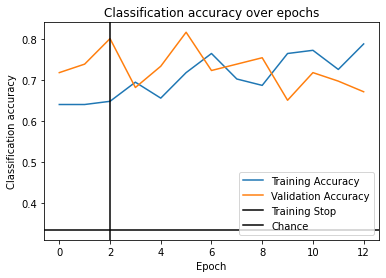

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7944 - acc: 0.6406 - val_loss: 0.7554 - val_acc: 0.5938
Epoch 2/50 0.234s 	 loss: 0.7871 - acc: 0.7109 - val_loss: 0.7651 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.7933 - acc: 0.7266 - val_loss: 0.7535 - val_acc: 0.6510
Epoch 4/50 0.233s 	 loss: 0.7546 - acc: 0.6875 - val_loss: 0.7518 - val_acc: 0.6406
Epoch 5/50 0.231s 	 loss: 0.7262 - acc: 0.6875 - val_loss: 0.7302 - val_acc: 0.6771
Epoch 6/50 0.234s 	 loss: 0.7222 - acc: 0.7188 - val_loss: 0.7008 - val_acc: 0.7292
Epoch 7/50 0.233s 	 loss: 0.6922 - acc: 0.7344 - val_loss: 0.7629 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.232s 	 loss: 0.6752 - acc: 0.7422 - val_loss: 0.7371 - val_acc: 0.6198
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.244s 	 loss: 0.6503 - acc: 0.7344 - val_loss: 0.7218 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.240s 	 loss: 0.6

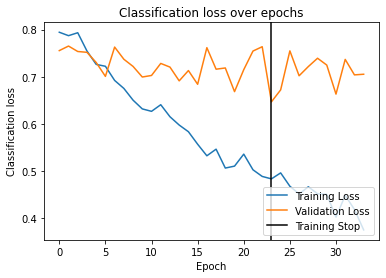

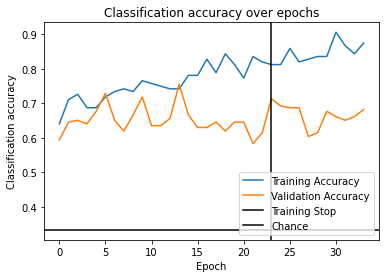

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7584 - acc: 0.6328 - val_loss: 0.8889 - val_acc: 0.5833
Epoch 2/50 0.236s 	 loss: 0.7017 - acc: 0.7109 - val_loss: 0.9094 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.6896 - acc: 0.7031 - val_loss: 0.8711 - val_acc: 0.5625
Epoch 4/50 0.235s 	 loss: 0.6834 - acc: 0.7422 - val_loss: 0.9002 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.243s 	 loss: 0.6719 - acc: 0.7266 - val_loss: 0.8287 - val_acc: 0.6719
Epoch 6/50 0.239s 	 loss: 0.6005 - acc: 0.7812 - val_loss: 0.9108 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.6238 - acc: 0.7578 - val_loss: 0.9065 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.5720 - acc: 0.7812 - val_loss: 0.7970 - val_acc: 0.7188
Epoch 9/50 0.235s 	 loss: 0.6161 - acc: 0.7734 - val_loss: 0.8309 - val_acc: 0.6510
EarlyStopping counter: 1 out o

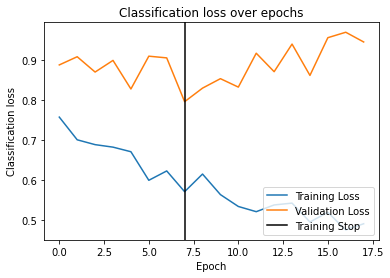

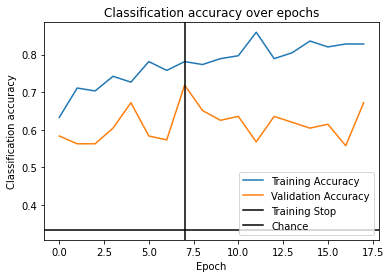

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8267 - acc: 0.5859 - val_loss: 1.1084 - val_acc: 0.5052
Epoch 2/50 0.231s 	 loss: 0.7976 - acc: 0.6250 - val_loss: 0.9740 - val_acc: 0.5052
Epoch 3/50 0.233s 	 loss: 0.7354 - acc: 0.6641 - val_loss: 1.0220 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.244s 	 loss: 0.6956 - acc: 0.6406 - val_loss: 1.0105 - val_acc: 0.4479
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.231s 	 loss: 0.6439 - acc: 0.7422 - val_loss: 0.9484 - val_acc: 0.5677
Epoch 6/50 0.236s 	 loss: 0.5971 - acc: 0.7266 - val_loss: 0.9185 - val_acc: 0.5469
Epoch 7/50 0.234s 	 loss: 0.5714 - acc: 0.7891 - val_loss: 0.9893 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.5659 - acc: 0.7969 - val_loss: 0.9033 - val_acc: 0.5521
Epoch 9/50 0.234s 	 loss: 0.5112 - acc: 0.8203 - val_loss: 0.9918 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

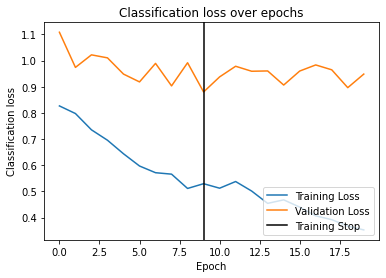

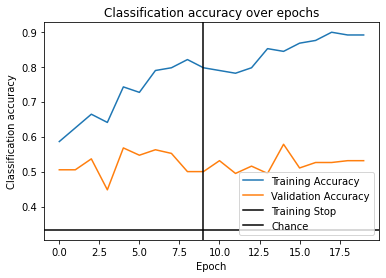

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.9598 - acc: 0.5703 - val_loss: 0.8060 - val_acc: 0.5677
Epoch 2/50 0.236s 	 loss: 0.9069 - acc: 0.6172 - val_loss: 0.7658 - val_acc: 0.6354
Epoch 3/50 0.236s 	 loss: 0.8542 - acc: 0.6094 - val_loss: 0.7109 - val_acc: 0.6354
Epoch 4/50 0.231s 	 loss: 0.7909 - acc: 0.6641 - val_loss: 0.7535 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.7535 - acc: 0.6641 - val_loss: 0.7202 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.7386 - acc: 0.6484 - val_loss: 0.7370 - val_acc: 0.6354
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.240s 	 loss: 0.7227 - acc: 0.6875 - val_loss: 0.6545 - val_acc: 0.6719
Epoch 8/50 0.244s 	 loss: 0.6648 - acc: 0.7422 - val_loss: 0.6927 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.6651 - acc: 0.6875 - val_loss: 0.7194 - val_acc: 0.5885
EarlyStopping counter: 2 out o

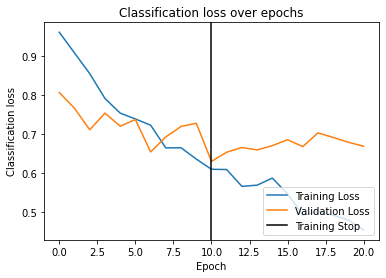

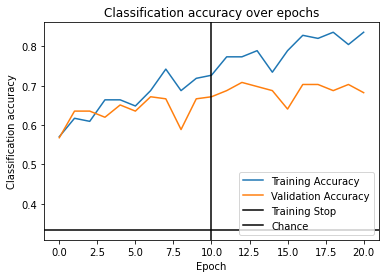

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8756 - acc: 0.5859 - val_loss: 0.8554 - val_acc: 0.6094
Epoch 2/50 0.232s 	 loss: 0.8435 - acc: 0.5938 - val_loss: 0.8297 - val_acc: 0.5573
Epoch 3/50 0.234s 	 loss: 0.7640 - acc: 0.6250 - val_loss: 0.7831 - val_acc: 0.6250
Epoch 4/50 0.242s 	 loss: 0.7329 - acc: 0.6250 - val_loss: 0.8294 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.6871 - acc: 0.6797 - val_loss: 0.7677 - val_acc: 0.6667
Epoch 6/50 0.233s 	 loss: 0.6907 - acc: 0.6641 - val_loss: 0.7809 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.6285 - acc: 0.7109 - val_loss: 0.7666 - val_acc: 0.6615
Epoch 8/50 0.234s 	 loss: 0.6067 - acc: 0.7891 - val_loss: 0.8259 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5802 - acc: 0.7422 - val_loss: 0.7818 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.232s 	 loss: 0.5

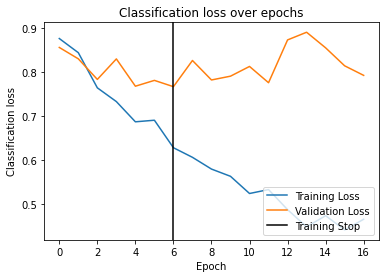

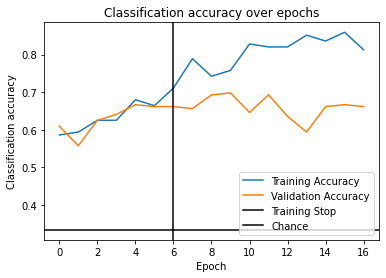

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.230s 	 loss: 0.9705 - acc: 0.5391 - val_loss: 0.7749 - val_acc: 0.6771
Epoch 2/50 0.230s 	 loss: 0.8521 - acc: 0.6094 - val_loss: 0.7194 - val_acc: 0.6667
Epoch 3/50 0.230s 	 loss: 0.8322 - acc: 0.6641 - val_loss: 0.7243 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.7750 - acc: 0.6797 - val_loss: 0.7063 - val_acc: 0.6719
Epoch 5/50 0.243s 	 loss: 0.7692 - acc: 0.6875 - val_loss: 0.7624 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.7144 - acc: 0.6875 - val_loss: 0.6667 - val_acc: 0.6927
Epoch 7/50 0.233s 	 loss: 0.7003 - acc: 0.6719 - val_loss: 0.7332 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.6934 - acc: 0.6875 - val_loss: 0.6935 - val_acc: 0.6771
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.6336 - acc: 0.7188 - val_loss: 0.7011 - val_acc: 0.6719
EarlyStopping counter: 3 out o

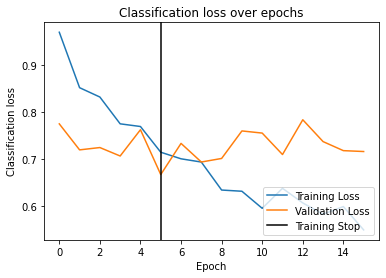

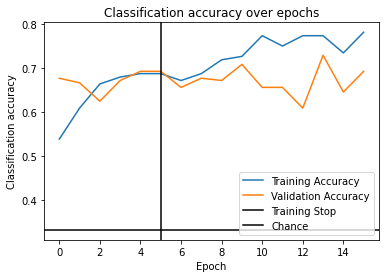

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.8403 - acc: 0.6094 - val_loss: 1.0277 - val_acc: 0.5521
Epoch 2/50 0.236s 	 loss: 0.7527 - acc: 0.6719 - val_loss: 0.9978 - val_acc: 0.5208
Epoch 3/50 0.236s 	 loss: 0.7269 - acc: 0.7109 - val_loss: 0.9575 - val_acc: 0.5469
Epoch 4/50 0.236s 	 loss: 0.6611 - acc: 0.7422 - val_loss: 1.0248 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.6445 - acc: 0.7500 - val_loss: 1.0438 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.245s 	 loss: 0.5904 - acc: 0.7578 - val_loss: 1.0306 - val_acc: 0.4635
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.5769 - acc: 0.7656 - val_loss: 0.9383 - val_acc: 0.5469
Epoch 8/50 0.236s 	 loss: 0.5460 - acc: 0.8047 - val_loss: 1.0728 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5298 - acc: 0.7734 - val_loss: 1.0562 - val_acc: 0.5365
EarlyStopping counter: 2 out o

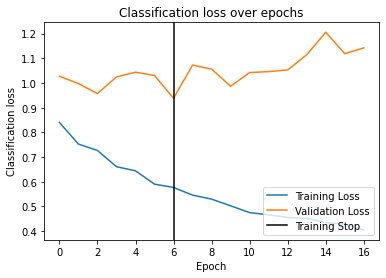

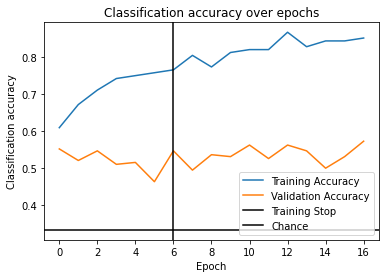

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.247s 	 loss: 0.8472 - acc: 0.6094 - val_loss: 0.8680 - val_acc: 0.6667
Epoch 2/50 0.238s 	 loss: 0.7759 - acc: 0.6406 - val_loss: 0.9269 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.238s 	 loss: 0.7694 - acc: 0.6406 - val_loss: 0.8629 - val_acc: 0.6198
Epoch 4/50 0.233s 	 loss: 0.7187 - acc: 0.7266 - val_loss: 0.9014 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.6729 - acc: 0.7109 - val_loss: 0.8347 - val_acc: 0.6562
Epoch 6/50 0.237s 	 loss: 0.6396 - acc: 0.7266 - val_loss: 0.8242 - val_acc: 0.7240
Epoch 7/50 0.235s 	 loss: 0.6194 - acc: 0.7109 - val_loss: 0.8830 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.247s 	 loss: 0.6081 - acc: 0.7500 - val_loss: 0.8382 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.239s 	 loss: 0.5805 - acc: 0.7422 - val_loss: 0.8520 - val_acc: 0.6198
EarlyStopping counter: 3 out o

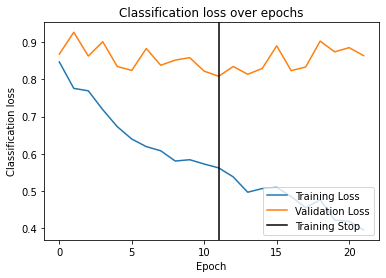

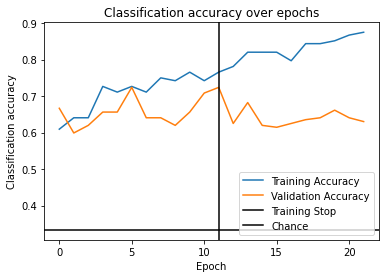

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7582 - acc: 0.7109 - val_loss: 0.8852 - val_acc: 0.6979
Epoch 2/50 0.228s 	 loss: 0.6737 - acc: 0.7344 - val_loss: 0.9263 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.6210 - acc: 0.7578 - val_loss: 0.9441 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.5838 - acc: 0.7578 - val_loss: 0.8390 - val_acc: 0.6458
Epoch 5/50 0.245s 	 loss: 0.5364 - acc: 0.8125 - val_loss: 0.7594 - val_acc: 0.6875
Epoch 6/50 0.234s 	 loss: 0.5469 - acc: 0.7656 - val_loss: 0.7689 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.4870 - acc: 0.7891 - val_loss: 0.7474 - val_acc: 0.7188
Epoch 8/50 0.236s 	 loss: 0.4492 - acc: 0.8438 - val_loss: 0.7826 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.239s 	 loss: 0.4216 - acc: 0.8594 - val_loss: 0.7550 - val_acc: 0.6406
EarlyStopping counter: 2 out o

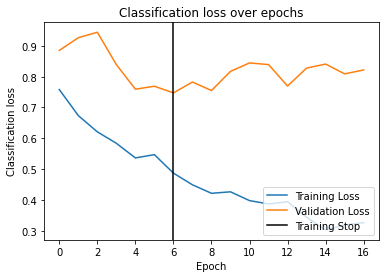

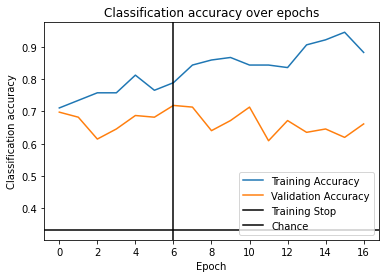

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8947 - acc: 0.6172 - val_loss: 0.6508 - val_acc: 0.7031
Epoch 2/50 0.236s 	 loss: 0.7859 - acc: 0.6953 - val_loss: 0.6458 - val_acc: 0.7500
Epoch 3/50 0.234s 	 loss: 0.7496 - acc: 0.7266 - val_loss: 0.6870 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.7215 - acc: 0.6641 - val_loss: 0.6241 - val_acc: 0.7344
Epoch 5/50 0.238s 	 loss: 0.6803 - acc: 0.7188 - val_loss: 0.6222 - val_acc: 0.7188
Epoch 6/50 0.232s 	 loss: 0.6098 - acc: 0.7891 - val_loss: 0.6241 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.5957 - acc: 0.7656 - val_loss: 0.5542 - val_acc: 0.7760
Epoch 8/50 0.234s 	 loss: 0.5555 - acc: 0.7734 - val_loss: 0.5687 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.5843 - acc: 0.7344 - val_loss: 0.5806 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.233s 	 loss: 0.5

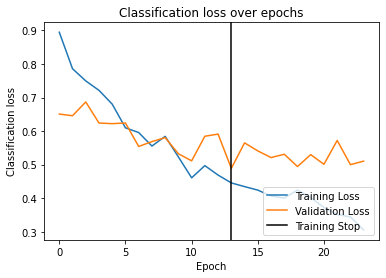

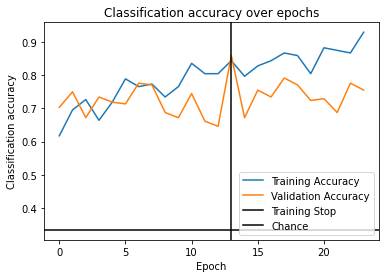

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7910 - acc: 0.7188 - val_loss: 0.7884 - val_acc: 0.7135
Epoch 2/50 0.234s 	 loss: 0.7297 - acc: 0.7344 - val_loss: 0.7520 - val_acc: 0.7448
Epoch 3/50 0.232s 	 loss: 0.6832 - acc: 0.7266 - val_loss: 0.7575 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.5848 - acc: 0.8125 - val_loss: 0.7256 - val_acc: 0.7760
Epoch 5/50 0.234s 	 loss: 0.5593 - acc: 0.7500 - val_loss: 0.6670 - val_acc: 0.7865
Epoch 6/50 0.236s 	 loss: 0.5249 - acc: 0.7812 - val_loss: 0.6571 - val_acc: 0.7552
Epoch 7/50 0.232s 	 loss: 0.5250 - acc: 0.8125 - val_loss: 0.6731 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.4846 - acc: 0.7969 - val_loss: 0.6226 - val_acc: 0.7396
Epoch 9/50 0.235s 	 loss: 0.4632 - acc: 0.8516 - val_loss: 0.6272 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.242s 	 loss: 0.4382 - acc: 0.8359 - val_loss: 0.675

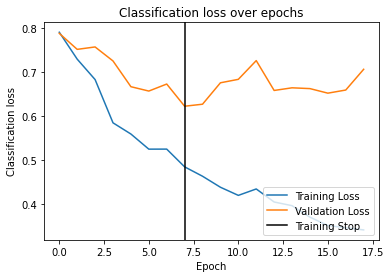

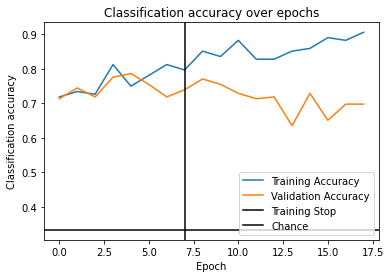

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8775 - acc: 0.6094 - val_loss: 0.8345 - val_acc: 0.6406
Epoch 2/50 0.229s 	 loss: 0.7796 - acc: 0.6484 - val_loss: 0.8126 - val_acc: 0.6771
Epoch 3/50 0.230s 	 loss: 0.7392 - acc: 0.6406 - val_loss: 0.8345 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.231s 	 loss: 0.7213 - acc: 0.7031 - val_loss: 0.8404 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.6598 - acc: 0.6875 - val_loss: 0.7796 - val_acc: 0.5990
Epoch 6/50 0.240s 	 loss: 0.6268 - acc: 0.7344 - val_loss: 0.7923 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.232s 	 loss: 0.6453 - acc: 0.7266 - val_loss: 0.7463 - val_acc: 0.6094
Epoch 8/50 0.232s 	 loss: 0.6260 - acc: 0.7344 - val_loss: 0.7681 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.233s 	 loss: 0.5593 - acc: 0.7891 - val_loss: 0.8240 - val_acc: 0.5677
EarlyStopping counter: 2 out o

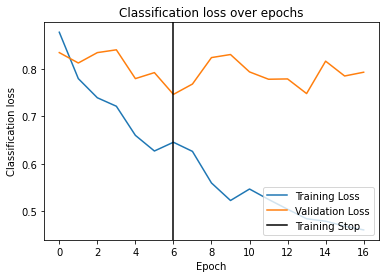

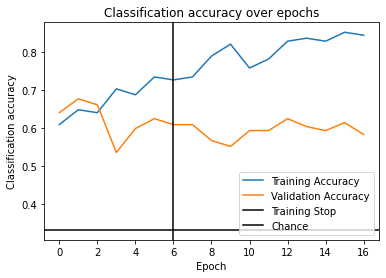

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9052 - acc: 0.6016 - val_loss: 0.7822 - val_acc: 0.6146
Epoch 2/50 0.233s 	 loss: 0.8149 - acc: 0.6484 - val_loss: 0.8254 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.7591 - acc: 0.6875 - val_loss: 0.8058 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.7270 - acc: 0.7109 - val_loss: 0.8482 - val_acc: 0.5312
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.7223 - acc: 0.6719 - val_loss: 0.7653 - val_acc: 0.6562
Epoch 6/50 0.241s 	 loss: 0.6840 - acc: 0.7344 - val_loss: 0.7702 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.6655 - acc: 0.7031 - val_loss: 0.7367 - val_acc: 0.6146
Epoch 8/50 0.234s 	 loss: 0.6041 - acc: 0.7422 - val_loss: 0.7026 - val_acc: 0.6458
Epoch 9/50 0.233s 	 loss: 0.6047 - acc: 0.7266 - val_loss: 0.7421 - val_acc: 0.6458
EarlyStopping counter: 1 out o

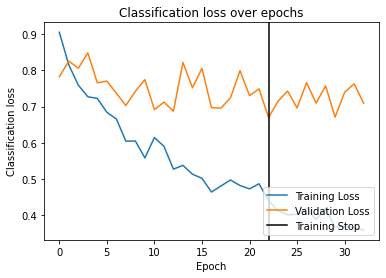

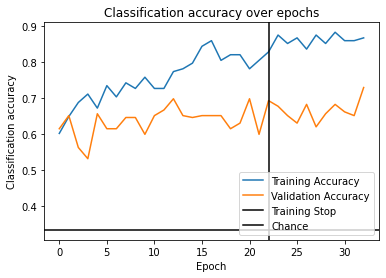

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8922 - acc: 0.5781 - val_loss: 0.9311 - val_acc: 0.5885
Epoch 2/50 0.237s 	 loss: 0.7979 - acc: 0.6562 - val_loss: 0.8812 - val_acc: 0.5729
Epoch 3/50 0.244s 	 loss: 0.6864 - acc: 0.7422 - val_loss: 0.8655 - val_acc: 0.5885
Epoch 4/50 0.236s 	 loss: 0.6759 - acc: 0.7188 - val_loss: 0.8406 - val_acc: 0.6094
Epoch 5/50 0.233s 	 loss: 0.6690 - acc: 0.7188 - val_loss: 0.7322 - val_acc: 0.5833
Epoch 6/50 0.239s 	 loss: 0.6518 - acc: 0.6562 - val_loss: 0.7708 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.5630 - acc: 0.7969 - val_loss: 0.7928 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.232s 	 loss: 0.6024 - acc: 0.7969 - val_loss: 0.7637 - val_acc: 0.6250
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.5577 - acc: 0.8047 - val_loss: 0.7385 - val_acc: 0.7135
EarlyStopping counter: 4 out of 10
Epoch 10/50 0.244s 	 loss: 0.5

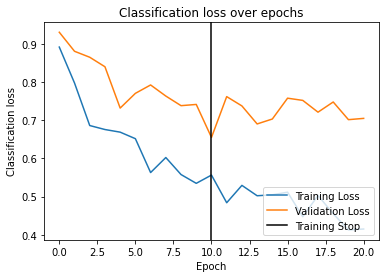

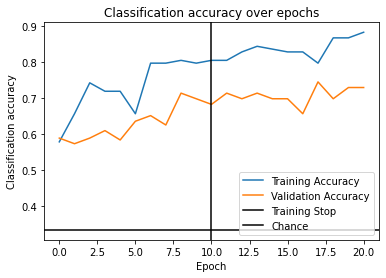

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.6877 - acc: 0.7188 - val_loss: 0.7267 - val_acc: 0.7083
Epoch 2/50 0.231s 	 loss: 0.6150 - acc: 0.7812 - val_loss: 0.7146 - val_acc: 0.6406
Epoch 3/50 0.235s 	 loss: 0.5785 - acc: 0.7812 - val_loss: 0.6886 - val_acc: 0.7604
Epoch 4/50 0.235s 	 loss: 0.5316 - acc: 0.7812 - val_loss: 0.6458 - val_acc: 0.6927
Epoch 5/50 0.232s 	 loss: 0.4896 - acc: 0.8281 - val_loss: 0.6089 - val_acc: 0.7865
Epoch 6/50 0.245s 	 loss: 0.4569 - acc: 0.8516 - val_loss: 0.6023 - val_acc: 0.7708
Epoch 7/50 0.232s 	 loss: 0.4684 - acc: 0.8594 - val_loss: 0.6137 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.4122 - acc: 0.8438 - val_loss: 0.5972 - val_acc: 0.8229
Epoch 9/50 0.234s 	 loss: 0.3975 - acc: 0.8594 - val_loss: 0.6613 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.3877 - acc: 0.8672 - val_loss: 0.6386 - val_acc: 0.6979
EarlyStopping c

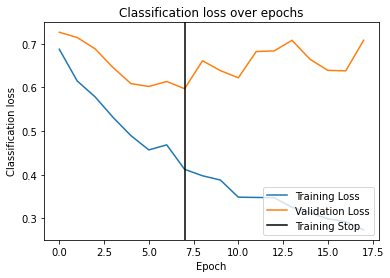

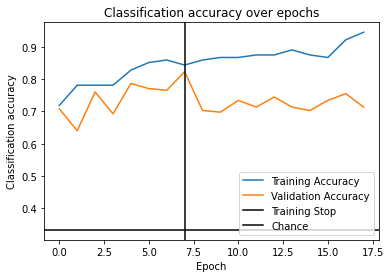

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7216 - acc: 0.6719 - val_loss: 0.6469 - val_acc: 0.7240
Epoch 2/50 0.241s 	 loss: 0.6505 - acc: 0.7656 - val_loss: 0.5909 - val_acc: 0.7552
Epoch 3/50 0.237s 	 loss: 0.6029 - acc: 0.7422 - val_loss: 0.5762 - val_acc: 0.7708
Epoch 4/50 0.234s 	 loss: 0.5681 - acc: 0.7812 - val_loss: 0.5715 - val_acc: 0.7344
Epoch 5/50 0.246s 	 loss: 0.5215 - acc: 0.8125 - val_loss: 0.6035 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.5253 - acc: 0.8047 - val_loss: 0.5269 - val_acc: 0.8490
Epoch 7/50 0.230s 	 loss: 0.4756 - acc: 0.8359 - val_loss: 0.5545 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.230s 	 loss: 0.4789 - acc: 0.8359 - val_loss: 0.4755 - val_acc: 0.8646
Epoch 9/50 0.235s 	 loss: 0.4589 - acc: 0.8047 - val_loss: 0.4958 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.4704 - acc: 0.8125 - val_loss: 0.499

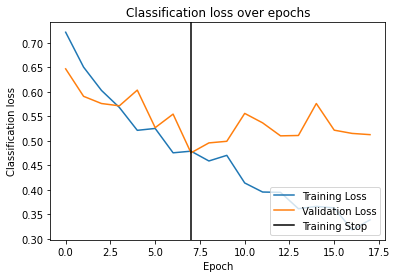

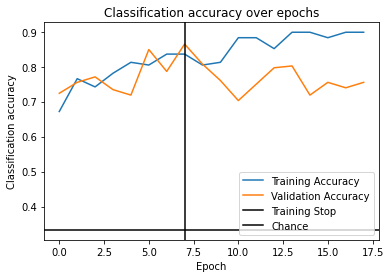

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.7579 - acc: 0.6797 - val_loss: 0.7944 - val_acc: 0.6198
Epoch 2/50 0.231s 	 loss: 0.6245 - acc: 0.7188 - val_loss: 0.7758 - val_acc: 0.6562
Epoch 3/50 0.234s 	 loss: 0.5422 - acc: 0.8281 - val_loss: 0.7657 - val_acc: 0.6771
Epoch 4/50 0.234s 	 loss: 0.5374 - acc: 0.7891 - val_loss: 0.6912 - val_acc: 0.7292
Epoch 5/50 0.252s 	 loss: 0.4987 - acc: 0.8203 - val_loss: 0.6718 - val_acc: 0.6667
Epoch 6/50 0.237s 	 loss: 0.4515 - acc: 0.8438 - val_loss: 0.7471 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.245s 	 loss: 0.4807 - acc: 0.8281 - val_loss: 0.7253 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.241s 	 loss: 0.4114 - acc: 0.8672 - val_loss: 0.6024 - val_acc: 0.7031
Epoch 9/50 0.241s 	 loss: 0.3987 - acc: 0.8594 - val_loss: 0.7686 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.239s 	 loss: 0.3858 - acc: 0.8750 - val_loss: 0.769

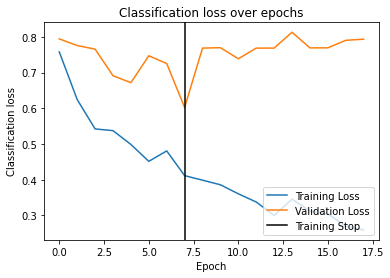

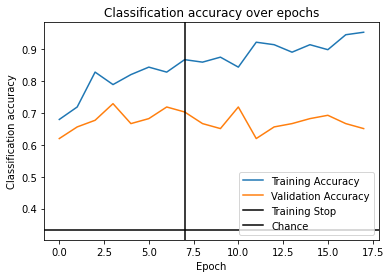

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6978 - acc: 0.7344 - val_loss: 0.7622 - val_acc: 0.6042
Epoch 2/50 0.231s 	 loss: 0.6186 - acc: 0.7500 - val_loss: 0.7553 - val_acc: 0.6823
Epoch 3/50 0.234s 	 loss: 0.5878 - acc: 0.7969 - val_loss: 0.7259 - val_acc: 0.6927
Epoch 4/50 0.232s 	 loss: 0.5447 - acc: 0.8203 - val_loss: 0.7684 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.244s 	 loss: 0.5112 - acc: 0.8125 - val_loss: 0.8090 - val_acc: 0.7135
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.242s 	 loss: 0.4678 - acc: 0.8203 - val_loss: 0.7336 - val_acc: 0.7188
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.4958 - acc: 0.8516 - val_loss: 0.7529 - val_acc: 0.7448
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.236s 	 loss: 0.4206 - acc: 0.8750 - val_loss: 0.7428 - val_acc: 0.7344
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.231s 	 loss: 0.4234 - acc: 0.8750 - val_loss: 0.8052 - val_acc: 0.

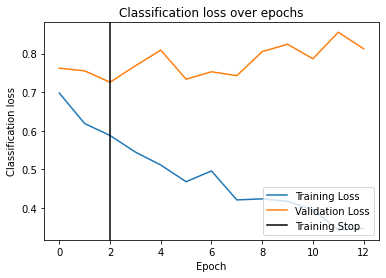

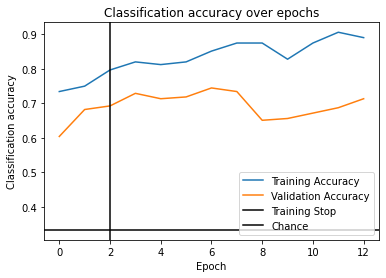

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7091 - acc: 0.7266 - val_loss: 0.7303 - val_acc: 0.6562
Epoch 2/50 0.234s 	 loss: 0.6242 - acc: 0.7500 - val_loss: 0.7544 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.5816 - acc: 0.8125 - val_loss: 0.7701 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.5452 - acc: 0.8203 - val_loss: 0.7622 - val_acc: 0.6562
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.235s 	 loss: 0.5045 - acc: 0.8125 - val_loss: 0.7322 - val_acc: 0.6667
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.238s 	 loss: 0.4856 - acc: 0.8672 - val_loss: 0.7647 - val_acc: 0.6562
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.235s 	 loss: 0.4476 - acc: 0.8906 - val_loss: 0.6658 - val_acc: 0.6823
Epoch 8/50 0.232s 	 loss: 0.4361 - acc: 0.9062 - val_loss: 0.7341 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.4125 - acc: 0.88

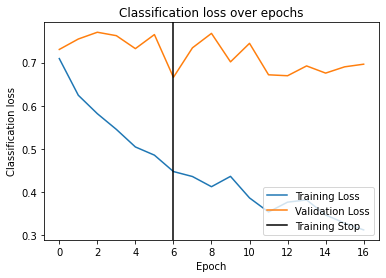

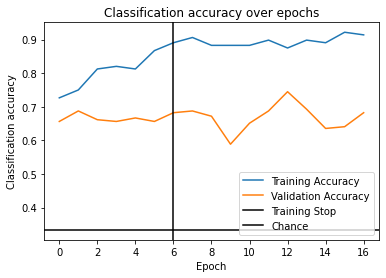

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7450 - acc: 0.6562 - val_loss: 0.5875 - val_acc: 0.8073
Epoch 2/50 0.232s 	 loss: 0.7019 - acc: 0.6797 - val_loss: 0.5759 - val_acc: 0.8385
Epoch 3/50 0.239s 	 loss: 0.6640 - acc: 0.7344 - val_loss: 0.6527 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.241s 	 loss: 0.5832 - acc: 0.7812 - val_loss: 0.7172 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.5926 - acc: 0.7656 - val_loss: 0.6160 - val_acc: 0.7344
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.231s 	 loss: 0.5135 - acc: 0.7891 - val_loss: 0.6654 - val_acc: 0.7292
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.231s 	 loss: 0.5170 - acc: 0.8047 - val_loss: 0.6628 - val_acc: 0.7500
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.240s 	 loss: 0.4961 - acc: 0.8203 - val_loss: 0.6666 - val_acc: 0.7760
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.234s 	 loss: 0.4365 - acc: 0.85

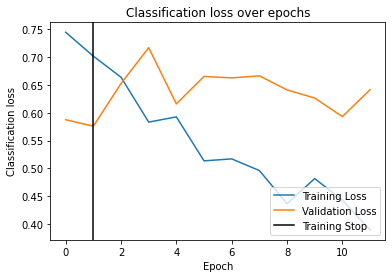

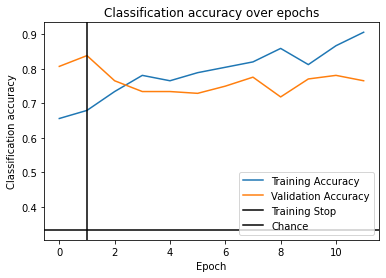

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.0062 - acc: 0.5938 - val_loss: 0.8040 - val_acc: 0.6823
Epoch 2/50 0.239s 	 loss: 0.9364 - acc: 0.6094 - val_loss: 0.8100 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8282 - acc: 0.6719 - val_loss: 0.7594 - val_acc: 0.6562
Epoch 4/50 0.235s 	 loss: 0.7811 - acc: 0.6641 - val_loss: 0.8034 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.7593 - acc: 0.6875 - val_loss: 0.7776 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.7205 - acc: 0.6953 - val_loss: 0.7943 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.248s 	 loss: 0.6833 - acc: 0.7656 - val_loss: 0.7499 - val_acc: 0.7292
Epoch 8/50 0.234s 	 loss: 0.7049 - acc: 0.7031 - val_loss: 0.7675 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.6322 - acc: 0.7422 - val_loss: 0.7426 - val_acc: 0.

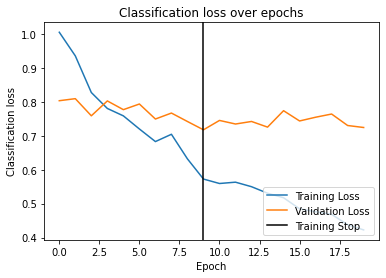

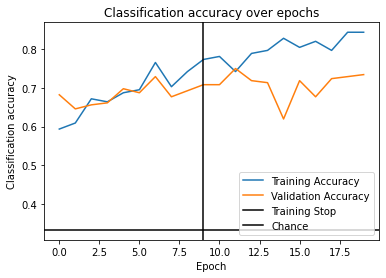

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.9333 - acc: 0.6328 - val_loss: 1.0269 - val_acc: 0.5469
Epoch 2/50 0.235s 	 loss: 0.8627 - acc: 0.6875 - val_loss: 0.9668 - val_acc: 0.5781
Epoch 3/50 0.234s 	 loss: 0.8057 - acc: 0.6953 - val_loss: 0.9941 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.7129 - acc: 0.7344 - val_loss: 0.9348 - val_acc: 0.5833
Epoch 5/50 0.238s 	 loss: 0.7077 - acc: 0.7031 - val_loss: 1.0419 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.6699 - acc: 0.7578 - val_loss: 0.9899 - val_acc: 0.4948
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.6036 - acc: 0.7812 - val_loss: 0.9608 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.232s 	 loss: 0.5727 - acc: 0.7656 - val_loss: 0.9736 - val_acc: 0.5729
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.233s 	 loss: 0.5696 - acc: 0.7969 - val_loss: 0.9314 - val_acc: 0.

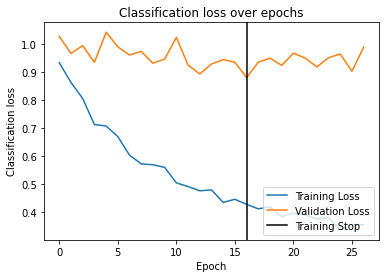

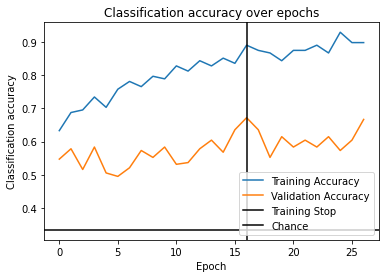

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9426 - acc: 0.5625 - val_loss: 0.9016 - val_acc: 0.5990
Epoch 2/50 0.235s 	 loss: 0.8771 - acc: 0.6016 - val_loss: 0.9127 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.8058 - acc: 0.6797 - val_loss: 0.8154 - val_acc: 0.6458
Epoch 4/50 0.232s 	 loss: 0.7987 - acc: 0.6719 - val_loss: 0.7735 - val_acc: 0.6667
Epoch 5/50 0.234s 	 loss: 0.7738 - acc: 0.6953 - val_loss: 0.8233 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.7435 - acc: 0.7031 - val_loss: 0.7987 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.239s 	 loss: 0.6832 - acc: 0.7344 - val_loss: 0.7946 - val_acc: 0.6927
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.7023 - acc: 0.7500 - val_loss: 0.7579 - val_acc: 0.6927
Epoch 9/50 0.233s 	 loss: 0.6577 - acc: 0.7656 - val_loss: 0.6740 - val_acc: 0.7135
Epoch 10/50 0.233s 	 loss: 0.6

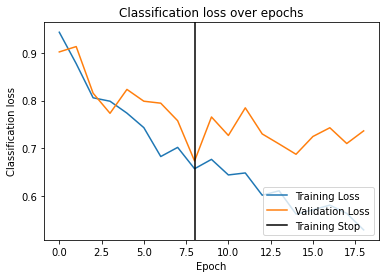

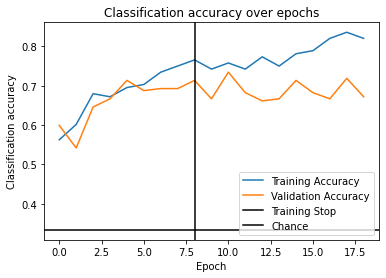

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0691 - acc: 0.5234 - val_loss: 0.6833 - val_acc: 0.7031
Epoch 2/50 0.235s 	 loss: 0.9881 - acc: 0.5547 - val_loss: 0.6819 - val_acc: 0.7188
Epoch 3/50 0.231s 	 loss: 0.9318 - acc: 0.6328 - val_loss: 0.7071 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.232s 	 loss: 0.8843 - acc: 0.6172 - val_loss: 0.7439 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.8346 - acc: 0.6250 - val_loss: 0.6938 - val_acc: 0.7344
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.8169 - acc: 0.6562 - val_loss: 0.6990 - val_acc: 0.6875
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.237s 	 loss: 0.7516 - acc: 0.7188 - val_loss: 0.6830 - val_acc: 0.7031
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.236s 	 loss: 0.7513 - acc: 0.7109 - val_loss: 0.7293 - val_acc: 0.6719
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.239s 	 loss: 0.7270 - acc: 0.71

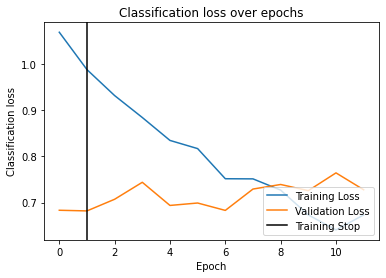

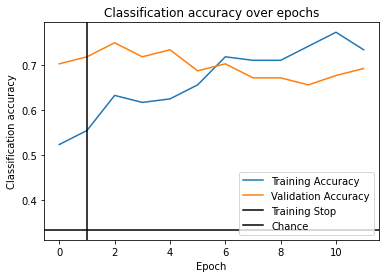

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8091 - acc: 0.6719 - val_loss: 1.1271 - val_acc: 0.5260
Epoch 2/50 0.233s 	 loss: 0.7779 - acc: 0.6406 - val_loss: 1.0985 - val_acc: 0.5625
Epoch 3/50 0.236s 	 loss: 0.7133 - acc: 0.7031 - val_loss: 1.0858 - val_acc: 0.5417
Epoch 4/50 0.233s 	 loss: 0.7207 - acc: 0.7031 - val_loss: 1.1297 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.6868 - acc: 0.7734 - val_loss: 1.0511 - val_acc: 0.5260
Epoch 6/50 0.234s 	 loss: 0.6182 - acc: 0.7734 - val_loss: 1.1683 - val_acc: 0.4740
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.249s 	 loss: 0.6382 - acc: 0.7578 - val_loss: 1.1634 - val_acc: 0.4792
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.5832 - acc: 0.7812 - val_loss: 1.0999 - val_acc: 0.5417
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.5716 - acc: 0.8359 - val_loss: 1.1592 - val_acc: 0.4531
EarlyStopping counter: 4 out o

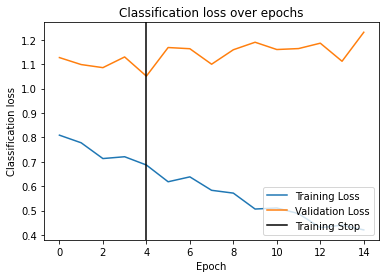

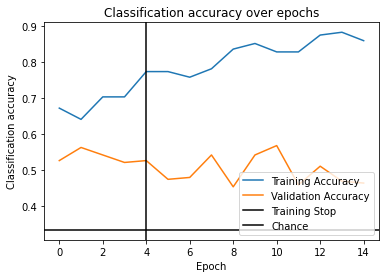

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.8675 - acc: 0.6172 - val_loss: 0.9048 - val_acc: 0.5312
Epoch 2/50 0.232s 	 loss: 0.8434 - acc: 0.6172 - val_loss: 1.0226 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7923 - acc: 0.6484 - val_loss: 1.0597 - val_acc: 0.4792
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.233s 	 loss: 0.7286 - acc: 0.6875 - val_loss: 0.9981 - val_acc: 0.5260
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.7000 - acc: 0.7188 - val_loss: 0.9561 - val_acc: 0.5208
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.233s 	 loss: 0.7283 - acc: 0.6719 - val_loss: 0.9522 - val_acc: 0.5417
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.239s 	 loss: 0.6918 - acc: 0.7422 - val_loss: 0.9220 - val_acc: 0.5417
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.236s 	 loss: 0.7367 - acc: 0.7344 - val_loss: 0.9484 - val_acc: 0.6354
EarlyStopping counter: 7 out of 10
Epoch 9/5

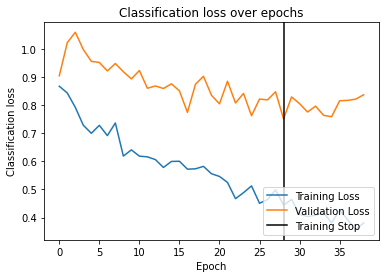

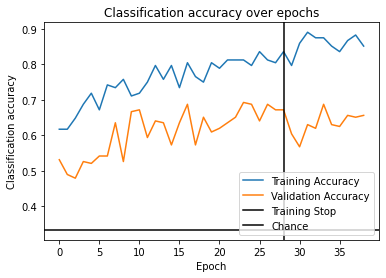

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0007 - acc: 0.5312 - val_loss: 0.6979 - val_acc: 0.6823
Epoch 2/50 0.231s 	 loss: 0.9945 - acc: 0.5547 - val_loss: 0.6662 - val_acc: 0.7240
Epoch 3/50 0.232s 	 loss: 0.8969 - acc: 0.6172 - val_loss: 0.7054 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.9204 - acc: 0.6172 - val_loss: 0.7317 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.8585 - acc: 0.6250 - val_loss: 0.7398 - val_acc: 0.6354
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.235s 	 loss: 0.8254 - acc: 0.6328 - val_loss: 0.8012 - val_acc: 0.6354
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.8052 - acc: 0.6484 - val_loss: 0.7717 - val_acc: 0.6354
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.240s 	 loss: 0.7896 - acc: 0.6172 - val_loss: 0.7279 - val_acc: 0.6354
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.235s 	 loss: 0.7860 - acc: 0.65

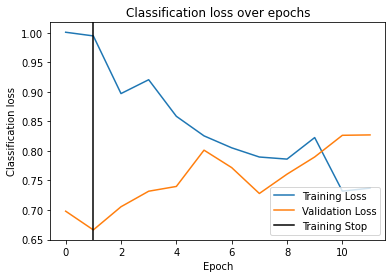

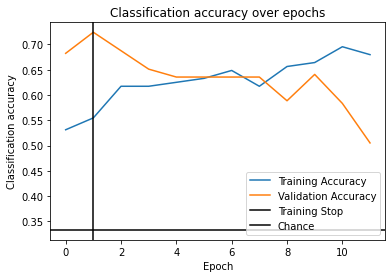

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.9298 - acc: 0.5625 - val_loss: 0.9551 - val_acc: 0.6875
Epoch 2/50 0.231s 	 loss: 0.8827 - acc: 0.5703 - val_loss: 0.9137 - val_acc: 0.6875
Epoch 3/50 0.231s 	 loss: 0.8900 - acc: 0.6250 - val_loss: 0.8363 - val_acc: 0.6510
Epoch 4/50 0.249s 	 loss: 0.8348 - acc: 0.6094 - val_loss: 0.9294 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.8134 - acc: 0.6484 - val_loss: 0.8484 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.7830 - acc: 0.6250 - val_loss: 0.9133 - val_acc: 0.6302
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.7599 - acc: 0.6641 - val_loss: 0.8807 - val_acc: 0.6146
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.235s 	 loss: 0.7802 - acc: 0.6562 - val_loss: 0.8092 - val_acc: 0.6927
Epoch 9/50 0.232s 	 loss: 0.7739 - acc: 0.6719 - val_loss: 0.8356 - val_acc: 0.6875
EarlyStopping counter: 1 out o

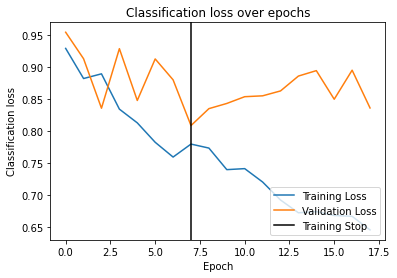

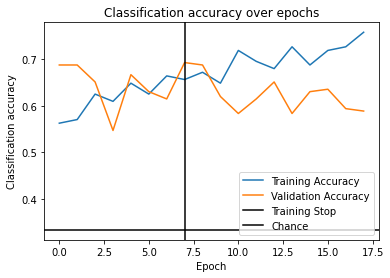

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7809 - acc: 0.7031 - val_loss: 1.1655 - val_acc: 0.4844
Epoch 2/50 0.232s 	 loss: 0.7323 - acc: 0.6875 - val_loss: 1.1351 - val_acc: 0.4688
Epoch 3/50 0.231s 	 loss: 0.7091 - acc: 0.7031 - val_loss: 1.1038 - val_acc: 0.4167
Epoch 4/50 0.234s 	 loss: 0.6799 - acc: 0.7266 - val_loss: 1.0919 - val_acc: 0.5104
Epoch 5/50 0.233s 	 loss: 0.6113 - acc: 0.7812 - val_loss: 1.1618 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.6133 - acc: 0.7812 - val_loss: 1.1457 - val_acc: 0.5052
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.5703 - acc: 0.8203 - val_loss: 1.1536 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.5787 - acc: 0.8125 - val_loss: 1.2119 - val_acc: 0.5573
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.232s 	 loss: 0.5790 - acc: 0.8047 - val_loss: 1.2895 - val_acc: 0.4427
EarlyStopping counter: 5 out o

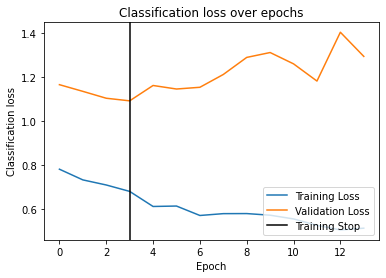

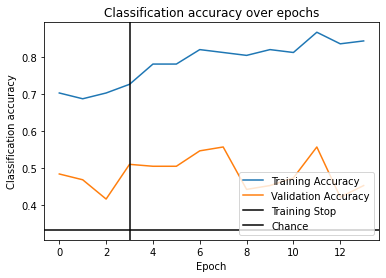

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.1774 - acc: 0.4531 - val_loss: 1.0800 - val_acc: 0.4948
Epoch 2/50 0.239s 	 loss: 1.0864 - acc: 0.5156 - val_loss: 1.1038 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.9850 - acc: 0.5625 - val_loss: 1.1289 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.9767 - acc: 0.5547 - val_loss: 1.0965 - val_acc: 0.4271
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.234s 	 loss: 0.9760 - acc: 0.5547 - val_loss: 1.1710 - val_acc: 0.4062
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.236s 	 loss: 0.9228 - acc: 0.5859 - val_loss: 1.1190 - val_acc: 0.4583
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.239s 	 loss: 0.9193 - acc: 0.5625 - val_loss: 1.1022 - val_acc: 0.5365
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.240s 	 loss: 0.8703 - acc: 0.6016 - val_loss: 1.1091 - val_acc: 0.5156
EarlyStopping counter: 7 out of 10
Epoch 9/5

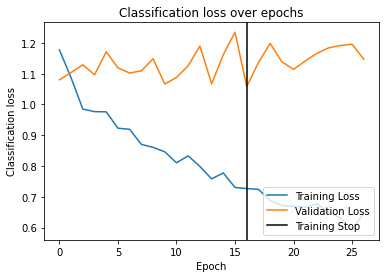

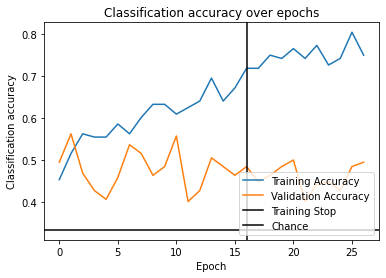

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.1003 - acc: 0.5078 - val_loss: 1.2416 - val_acc: 0.4219
Epoch 2/50 0.231s 	 loss: 1.0903 - acc: 0.4766 - val_loss: 1.1403 - val_acc: 0.4375
Epoch 3/50 0.233s 	 loss: 1.0165 - acc: 0.5000 - val_loss: 1.1501 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.9871 - acc: 0.5234 - val_loss: 1.1648 - val_acc: 0.4635
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.241s 	 loss: 0.9099 - acc: 0.5469 - val_loss: 1.1230 - val_acc: 0.4062
Epoch 6/50 0.238s 	 loss: 0.9210 - acc: 0.5469 - val_loss: 1.1348 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.9325 - acc: 0.5703 - val_loss: 1.1340 - val_acc: 0.4688
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.9142 - acc: 0.5625 - val_loss: 1.1348 - val_acc: 0.4479
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.233s 	 loss: 0.8444 - acc: 0.6250 - val_loss: 1.0860 - val_acc: 0.

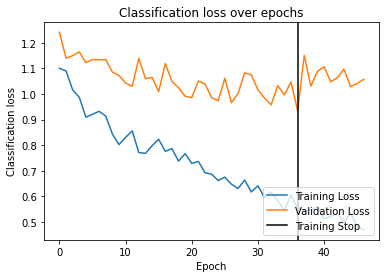

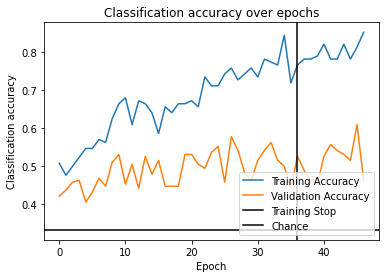

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 1.1609 - acc: 0.4609 - val_loss: 1.1309 - val_acc: 0.4427
Epoch 2/50 0.234s 	 loss: 1.0750 - acc: 0.4688 - val_loss: 1.1411 - val_acc: 0.4531
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.249s 	 loss: 1.0552 - acc: 0.4844 - val_loss: 1.1102 - val_acc: 0.4323
Epoch 4/50 0.235s 	 loss: 0.9713 - acc: 0.4688 - val_loss: 1.0313 - val_acc: 0.5312
Epoch 5/50 0.231s 	 loss: 0.9668 - acc: 0.5391 - val_loss: 1.0255 - val_acc: 0.4792
Epoch 6/50 0.230s 	 loss: 0.9421 - acc: 0.5234 - val_loss: 1.0112 - val_acc: 0.4948
Epoch 7/50 0.234s 	 loss: 0.9185 - acc: 0.5312 - val_loss: 1.0350 - val_acc: 0.4688
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.8920 - acc: 0.5781 - val_loss: 0.9804 - val_acc: 0.5677
Epoch 9/50 0.235s 	 loss: 0.8098 - acc: 0.6250 - val_loss: 1.1003 - val_acc: 0.4219
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.240s 	 loss: 0.8852 - acc: 0.5547 - val_loss: 1.084

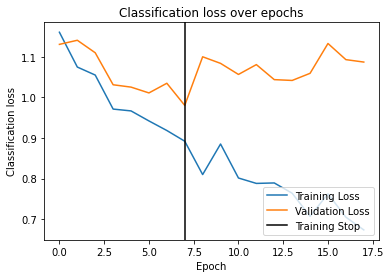

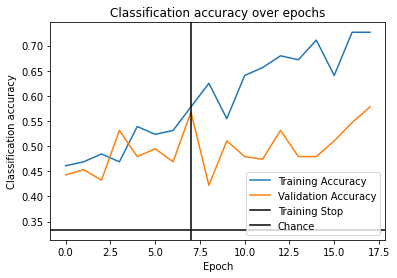

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0922 - acc: 0.5078 - val_loss: 1.1426 - val_acc: 0.5677
Epoch 2/50 0.233s 	 loss: 0.9894 - acc: 0.5859 - val_loss: 1.0558 - val_acc: 0.5417
Epoch 3/50 0.234s 	 loss: 0.9500 - acc: 0.6250 - val_loss: 1.0035 - val_acc: 0.5781
Epoch 4/50 0.247s 	 loss: 0.8790 - acc: 0.6016 - val_loss: 0.9953 - val_acc: 0.6510
Epoch 5/50 0.236s 	 loss: 0.8270 - acc: 0.6484 - val_loss: 0.9586 - val_acc: 0.6406
Epoch 6/50 0.240s 	 loss: 0.8593 - acc: 0.6172 - val_loss: 0.8929 - val_acc: 0.6719
Epoch 7/50 0.238s 	 loss: 0.8151 - acc: 0.6875 - val_loss: 0.9146 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.8015 - acc: 0.6953 - val_loss: 0.9361 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.8012 - acc: 0.6797 - val_loss: 0.8403 - val_acc: 0.7552
Epoch 10/50 0.241s 	 loss: 0.7284 - acc: 0.7031 - val_loss: 0.8515 - val_acc: 0.6927
EarlyStopping c

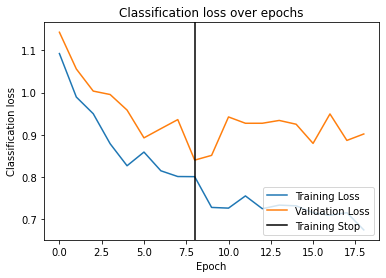

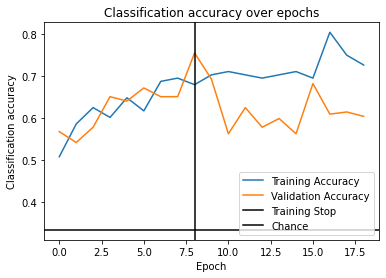

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1654 - acc: 0.4688 - val_loss: 0.9864 - val_acc: 0.5312
Epoch 2/50 0.233s 	 loss: 1.0422 - acc: 0.5078 - val_loss: 0.9976 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.9924 - acc: 0.5391 - val_loss: 0.9778 - val_acc: 0.5625
Epoch 4/50 0.234s 	 loss: 0.9154 - acc: 0.6094 - val_loss: 0.9303 - val_acc: 0.5781
Epoch 5/50 0.234s 	 loss: 0.9007 - acc: 0.6172 - val_loss: 0.9588 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.8315 - acc: 0.6484 - val_loss: 0.9248 - val_acc: 0.5833
Epoch 7/50 0.232s 	 loss: 0.8499 - acc: 0.6562 - val_loss: 0.9245 - val_acc: 0.5625
Epoch 8/50 0.233s 	 loss: 0.8170 - acc: 0.6719 - val_loss: 0.9040 - val_acc: 0.5052
Epoch 9/50 0.243s 	 loss: 0.8233 - acc: 0.6797 - val_loss: 0.9047 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.7822 - acc: 0.6953 - val_loss: 0.907

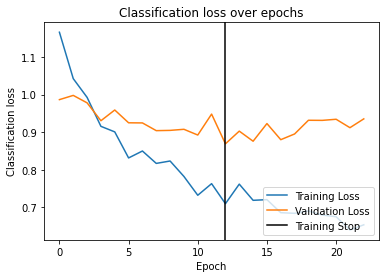

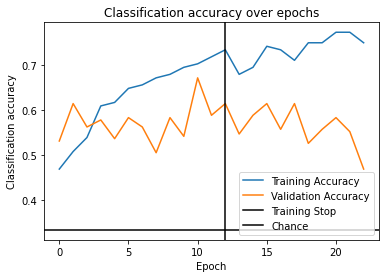

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.1017 - acc: 0.5312 - val_loss: 1.0947 - val_acc: 0.4531
Epoch 2/50 0.234s 	 loss: 1.0300 - acc: 0.5391 - val_loss: 1.0858 - val_acc: 0.4427
Epoch 3/50 0.233s 	 loss: 0.9527 - acc: 0.6406 - val_loss: 1.0473 - val_acc: 0.5052
Epoch 4/50 0.232s 	 loss: 0.9335 - acc: 0.5781 - val_loss: 1.0114 - val_acc: 0.5677
Epoch 5/50 0.238s 	 loss: 0.8232 - acc: 0.6172 - val_loss: 0.9859 - val_acc: 0.5104
Epoch 6/50 0.235s 	 loss: 0.8236 - acc: 0.5859 - val_loss: 1.0225 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.7857 - acc: 0.6641 - val_loss: 1.0309 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.7778 - acc: 0.6797 - val_loss: 0.9782 - val_acc: 0.5469
Epoch 9/50 0.237s 	 loss: 0.7374 - acc: 0.7422 - val_loss: 0.9679 - val_acc: 0.6094
Epoch 10/50 0.234s 	 loss: 0.7256 - acc: 0.7031 - val_loss: 1.0104 - val_acc: 0.5990
EarlyStopping c

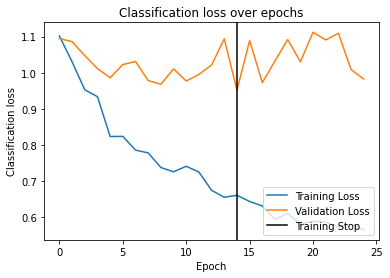

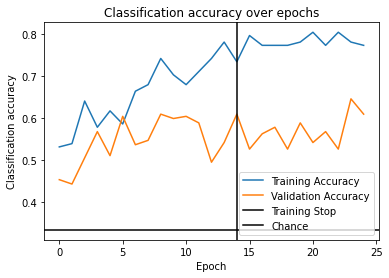

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7483 - acc: 0.6484 - val_loss: 0.7671 - val_acc: 0.7188
Epoch 2/50 0.235s 	 loss: 0.6661 - acc: 0.7266 - val_loss: 0.7769 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.6434 - acc: 0.7031 - val_loss: 0.7961 - val_acc: 0.6823
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.6197 - acc: 0.7344 - val_loss: 0.7666 - val_acc: 0.7344
Epoch 5/50 0.232s 	 loss: 0.5888 - acc: 0.7578 - val_loss: 0.7987 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.5919 - acc: 0.7891 - val_loss: 0.7098 - val_acc: 0.7188
Epoch 7/50 0.235s 	 loss: 0.5374 - acc: 0.8203 - val_loss: 0.7193 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.231s 	 loss: 0.5205 - acc: 0.8125 - val_loss: 0.7156 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.5007 - acc: 0.8047 - val_loss: 0.7093 - val_acc: 0.

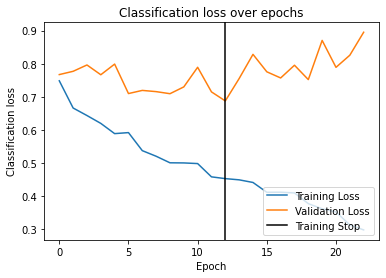

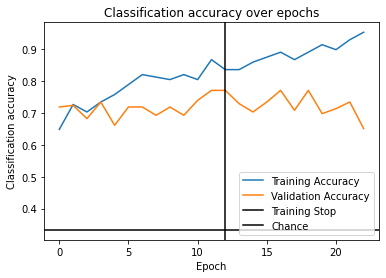

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7467 - acc: 0.6797 - val_loss: 0.8271 - val_acc: 0.6198
Epoch 2/50 0.232s 	 loss: 0.7114 - acc: 0.7188 - val_loss: 0.7475 - val_acc: 0.6719
Epoch 3/50 0.236s 	 loss: 0.6501 - acc: 0.7891 - val_loss: 0.7443 - val_acc: 0.7083
Epoch 4/50 0.233s 	 loss: 0.6002 - acc: 0.7891 - val_loss: 0.7421 - val_acc: 0.6562
Epoch 5/50 0.236s 	 loss: 0.5908 - acc: 0.7734 - val_loss: 0.7382 - val_acc: 0.6406
Epoch 6/50 0.235s 	 loss: 0.5963 - acc: 0.7578 - val_loss: 0.7945 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.5409 - acc: 0.8047 - val_loss: 0.6928 - val_acc: 0.7083
Epoch 8/50 0.240s 	 loss: 0.5406 - acc: 0.8047 - val_loss: 0.7106 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.5081 - acc: 0.8359 - val_loss: 0.6996 - val_acc: 0.7188
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.234s 	 loss: 0.5038 - acc: 0.8125 - val_loss: 0.788

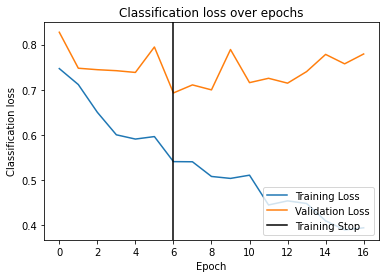

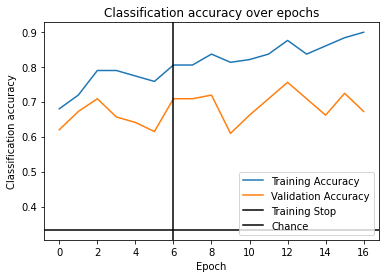

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8048 - acc: 0.6484 - val_loss: 0.6729 - val_acc: 0.7812
Epoch 2/50 0.233s 	 loss: 0.7786 - acc: 0.6172 - val_loss: 0.6267 - val_acc: 0.7188
Epoch 3/50 0.234s 	 loss: 0.7674 - acc: 0.6875 - val_loss: 0.6457 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.7325 - acc: 0.7031 - val_loss: 0.5891 - val_acc: 0.7865
Epoch 5/50 0.235s 	 loss: 0.7118 - acc: 0.7031 - val_loss: 0.6000 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.250s 	 loss: 0.6766 - acc: 0.7188 - val_loss: 0.5294 - val_acc: 0.8333
Epoch 7/50 0.237s 	 loss: 0.6382 - acc: 0.7266 - val_loss: 0.5769 - val_acc: 0.8125
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.231s 	 loss: 0.6560 - acc: 0.7500 - val_loss: 0.5410 - val_acc: 0.8802
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.6235 - acc: 0.7656 - val_loss: 0.5418 - val_acc: 0.7969
EarlyStopping counter: 3 out o

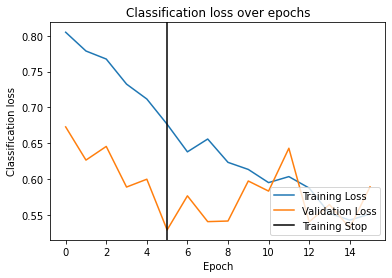

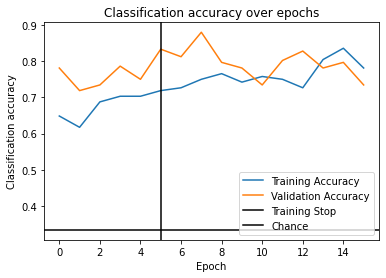

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.9574 - acc: 0.5703 - val_loss: 0.9669 - val_acc: 0.5469
Epoch 2/50 0.233s 	 loss: 0.8462 - acc: 0.5781 - val_loss: 0.9708 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7513 - acc: 0.6250 - val_loss: 0.8387 - val_acc: 0.6615
Epoch 4/50 0.233s 	 loss: 0.6854 - acc: 0.7109 - val_loss: 0.8848 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.6350 - acc: 0.7266 - val_loss: 0.8145 - val_acc: 0.6146
Epoch 6/50 0.233s 	 loss: 0.6366 - acc: 0.7500 - val_loss: 0.8145 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.232s 	 loss: 0.5803 - acc: 0.7812 - val_loss: 0.8596 - val_acc: 0.5781
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.233s 	 loss: 0.5062 - acc: 0.8125 - val_loss: 0.8414 - val_acc: 0.6250
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.235s 	 loss: 0.5470 - acc: 0.7656 - val_loss: 0.8534 - val_acc: 0.

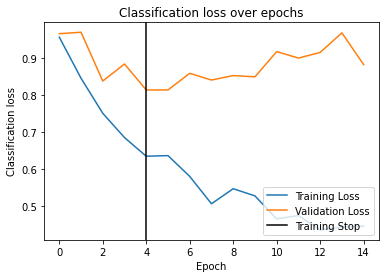

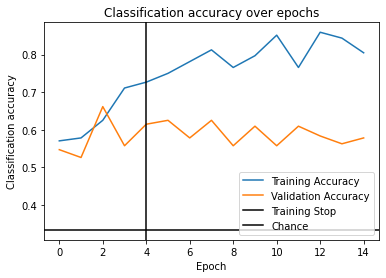

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9988 - acc: 0.5859 - val_loss: 0.9233 - val_acc: 0.5573
Epoch 2/50 0.236s 	 loss: 0.9189 - acc: 0.6172 - val_loss: 0.8763 - val_acc: 0.5417
Epoch 3/50 0.234s 	 loss: 0.7847 - acc: 0.6562 - val_loss: 0.8632 - val_acc: 0.5625
Epoch 4/50 0.234s 	 loss: 0.7655 - acc: 0.6797 - val_loss: 0.7654 - val_acc: 0.6354
Epoch 5/50 0.240s 	 loss: 0.6859 - acc: 0.6953 - val_loss: 0.8118 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.240s 	 loss: 0.6229 - acc: 0.7188 - val_loss: 0.8337 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.6574 - acc: 0.7500 - val_loss: 0.8271 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.240s 	 loss: 0.6079 - acc: 0.7578 - val_loss: 0.8689 - val_acc: 0.5417
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.235s 	 loss: 0.5703 - acc: 0.7891 - val_loss: 0.9144 - val_acc: 0.4635
EarlyStopping counter: 5 out o

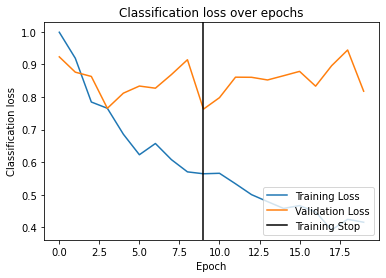

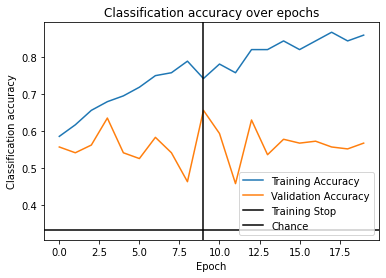

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9166 - acc: 0.5625 - val_loss: 1.1579 - val_acc: 0.4740
Epoch 2/50 0.231s 	 loss: 0.7815 - acc: 0.6172 - val_loss: 1.0120 - val_acc: 0.5417
Epoch 3/50 0.234s 	 loss: 0.7438 - acc: 0.6641 - val_loss: 1.0504 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.6941 - acc: 0.6719 - val_loss: 0.9756 - val_acc: 0.5365
Epoch 5/50 0.231s 	 loss: 0.6251 - acc: 0.7578 - val_loss: 0.9355 - val_acc: 0.5833
Epoch 6/50 0.245s 	 loss: 0.5966 - acc: 0.7344 - val_loss: 0.9317 - val_acc: 0.5521
Epoch 7/50 0.233s 	 loss: 0.5673 - acc: 0.8047 - val_loss: 0.9766 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.5659 - acc: 0.8359 - val_loss: 1.0550 - val_acc: 0.5312
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.5408 - acc: 0.8125 - val_loss: 0.9961 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.233s 	 loss: 0.4

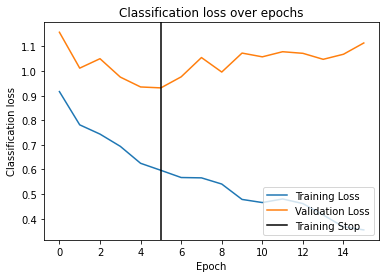

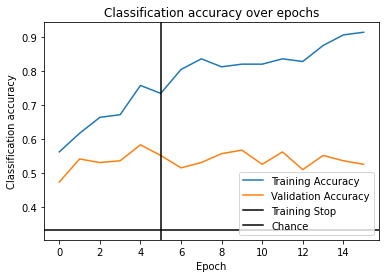

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.6758 - acc: 0.7266 - val_loss: 0.8834 - val_acc: 0.5990
Epoch 2/50 0.241s 	 loss: 0.6360 - acc: 0.7422 - val_loss: 0.8818 - val_acc: 0.5469
Epoch 3/50 0.239s 	 loss: 0.5795 - acc: 0.7656 - val_loss: 0.8797 - val_acc: 0.5938
Epoch 4/50 0.233s 	 loss: 0.5354 - acc: 0.8125 - val_loss: 0.8879 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.5104 - acc: 0.8359 - val_loss: 0.8085 - val_acc: 0.6510
Epoch 6/50 0.234s 	 loss: 0.5219 - acc: 0.8125 - val_loss: 0.8371 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.4795 - acc: 0.8281 - val_loss: 0.8044 - val_acc: 0.6146
Epoch 8/50 0.231s 	 loss: 0.4297 - acc: 0.8828 - val_loss: 0.8188 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.4302 - acc: 0.8672 - val_loss: 0.7995 - val_acc: 0.6146
Epoch 10/50 0.232s 	 loss: 0.4252 - acc: 0.8672 - val_loss: 0.791

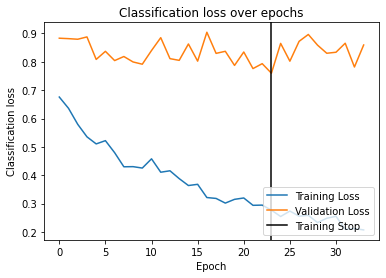

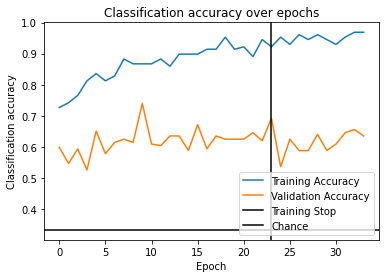

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7061 - acc: 0.6719 - val_loss: 0.7897 - val_acc: 0.6198
Epoch 2/50 0.231s 	 loss: 0.6071 - acc: 0.7344 - val_loss: 0.8399 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.6306 - acc: 0.7266 - val_loss: 0.8467 - val_acc: 0.5677
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.241s 	 loss: 0.5521 - acc: 0.7578 - val_loss: 0.7929 - val_acc: 0.6302
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.5302 - acc: 0.7734 - val_loss: 0.7639 - val_acc: 0.6406
Epoch 6/50 0.235s 	 loss: 0.5457 - acc: 0.7812 - val_loss: 0.8173 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.5210 - acc: 0.7656 - val_loss: 0.7660 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.234s 	 loss: 0.4838 - acc: 0.7891 - val_loss: 0.7632 - val_acc: 0.6823
Epoch 9/50 0.231s 	 loss: 0.4806 - acc: 0.8516 - val_loss: 0.7264 - val_acc: 0.

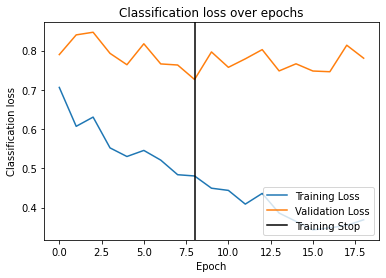

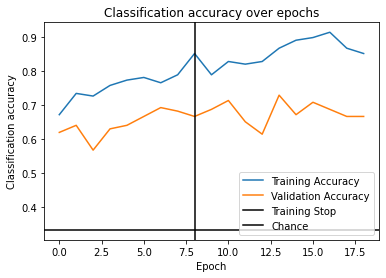

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.9539 - acc: 0.5625 - val_loss: 0.5195 - val_acc: 0.7604
Epoch 2/50 0.232s 	 loss: 0.8272 - acc: 0.6016 - val_loss: 0.4356 - val_acc: 0.8542
Epoch 3/50 0.232s 	 loss: 0.7602 - acc: 0.6484 - val_loss: 0.4427 - val_acc: 0.8646
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.6865 - acc: 0.7109 - val_loss: 0.5023 - val_acc: 0.8125
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.241s 	 loss: 0.6751 - acc: 0.7031 - val_loss: 0.5373 - val_acc: 0.7917
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.232s 	 loss: 0.6531 - acc: 0.7109 - val_loss: 0.5135 - val_acc: 0.8438
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.5960 - acc: 0.7344 - val_loss: 0.4893 - val_acc: 0.8177
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.234s 	 loss: 0.5516 - acc: 0.7969 - val_loss: 0.5203 - val_acc: 0.7969
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.235s 	 loss: 0.5679 - acc: 0.78

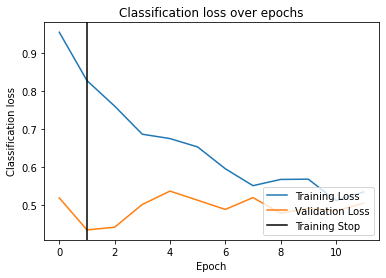

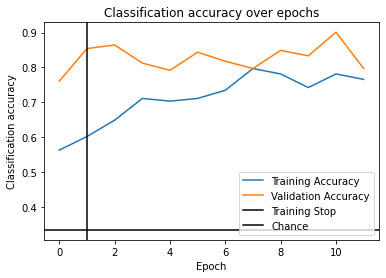

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 1.0461 - acc: 0.5859 - val_loss: 0.7685 - val_acc: 0.6562
Epoch 2/50 0.234s 	 loss: 0.9090 - acc: 0.6172 - val_loss: 0.7911 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8163 - acc: 0.6328 - val_loss: 0.7235 - val_acc: 0.6979
Epoch 4/50 0.242s 	 loss: 0.7989 - acc: 0.6797 - val_loss: 0.7684 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.7710 - acc: 0.6875 - val_loss: 0.7749 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.7576 - acc: 0.6875 - val_loss: 0.8200 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.7349 - acc: 0.6641 - val_loss: 0.7532 - val_acc: 0.6719
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.236s 	 loss: 0.6894 - acc: 0.7422 - val_loss: 0.7993 - val_acc: 0.6667
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.237s 	 loss: 0.6945 - acc: 0.68

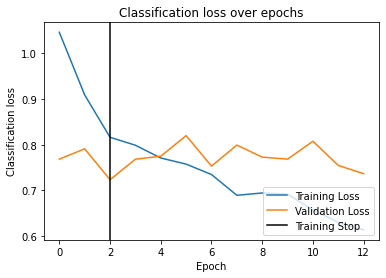

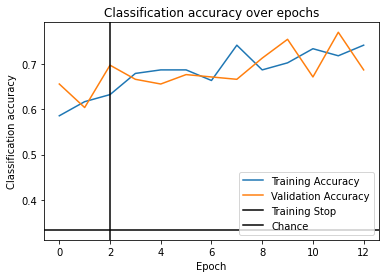

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9686 - acc: 0.5938 - val_loss: 0.8310 - val_acc: 0.6302
Epoch 2/50 0.231s 	 loss: 0.9087 - acc: 0.6172 - val_loss: 0.8424 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7900 - acc: 0.6562 - val_loss: 0.8094 - val_acc: 0.6302
Epoch 4/50 0.232s 	 loss: 0.7962 - acc: 0.6719 - val_loss: 0.8788 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.7204 - acc: 0.6484 - val_loss: 0.8971 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.6728 - acc: 0.7266 - val_loss: 0.8076 - val_acc: 0.6094
Epoch 7/50 0.231s 	 loss: 0.6988 - acc: 0.7109 - val_loss: 0.8237 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.6464 - acc: 0.7500 - val_loss: 0.8881 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.233s 	 loss: 0.6209 - acc: 0.7656 - val_loss: 0.9140 - val_acc: 0.

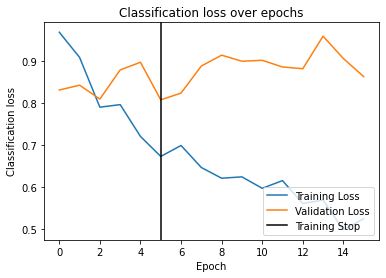

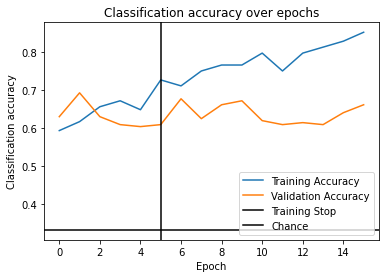

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.8426 - acc: 0.6406 - val_loss: 1.1491 - val_acc: 0.4896
Epoch 2/50 0.232s 	 loss: 0.7340 - acc: 0.6562 - val_loss: 1.1177 - val_acc: 0.5156
Epoch 3/50 0.233s 	 loss: 0.6873 - acc: 0.7109 - val_loss: 1.1128 - val_acc: 0.6198
Epoch 4/50 0.233s 	 loss: 0.6620 - acc: 0.7344 - val_loss: 1.1064 - val_acc: 0.5573
Epoch 5/50 0.235s 	 loss: 0.6786 - acc: 0.6797 - val_loss: 1.1119 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.6342 - acc: 0.7031 - val_loss: 1.1363 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.5727 - acc: 0.7734 - val_loss: 1.1211 - val_acc: 0.5052
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.233s 	 loss: 0.5803 - acc: 0.7578 - val_loss: 1.1005 - val_acc: 0.4375
Epoch 9/50 0.232s 	 loss: 0.5446 - acc: 0.7344 - val_loss: 1.1719 - val_acc: 0.4740
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

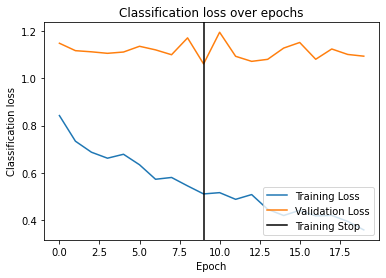

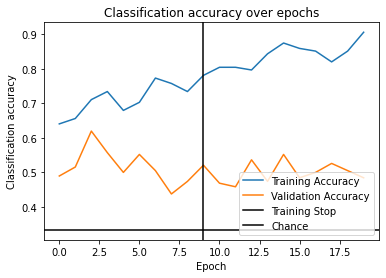

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9938 - acc: 0.5469 - val_loss: 0.8470 - val_acc: 0.5990
Epoch 2/50 0.237s 	 loss: 0.9224 - acc: 0.6094 - val_loss: 0.8605 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8841 - acc: 0.6094 - val_loss: 0.8559 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.8887 - acc: 0.6094 - val_loss: 0.8287 - val_acc: 0.6667
Epoch 5/50 0.232s 	 loss: 0.8346 - acc: 0.6875 - val_loss: 0.9082 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.8399 - acc: 0.6172 - val_loss: 0.8557 - val_acc: 0.6823
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.8078 - acc: 0.6328 - val_loss: 0.9631 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.235s 	 loss: 0.7460 - acc: 0.6797 - val_loss: 0.9192 - val_acc: 0.6146
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.244s 	 loss: 0.7664 - acc: 0.66

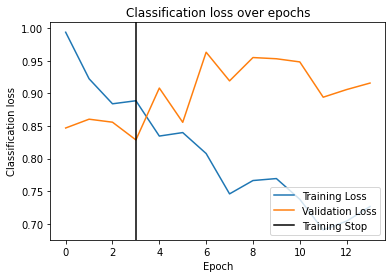

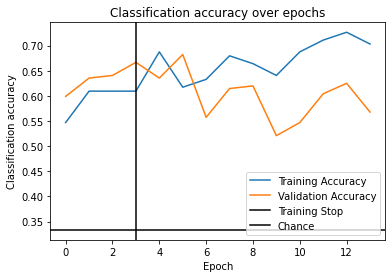

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.0091 - acc: 0.5547 - val_loss: 0.8339 - val_acc: 0.6406
Epoch 2/50 0.234s 	 loss: 0.9473 - acc: 0.5547 - val_loss: 0.7750 - val_acc: 0.6458
Epoch 3/50 0.234s 	 loss: 0.9320 - acc: 0.5781 - val_loss: 0.7970 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.8981 - acc: 0.5859 - val_loss: 0.7984 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.235s 	 loss: 0.8664 - acc: 0.6172 - val_loss: 0.8298 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.233s 	 loss: 0.8263 - acc: 0.6484 - val_loss: 0.8265 - val_acc: 0.6094
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.236s 	 loss: 0.8301 - acc: 0.6016 - val_loss: 0.8305 - val_acc: 0.6667
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.233s 	 loss: 0.8002 - acc: 0.6484 - val_loss: 0.8189 - val_acc: 0.6823
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.241s 	 loss: 0.8080 - acc: 0.66

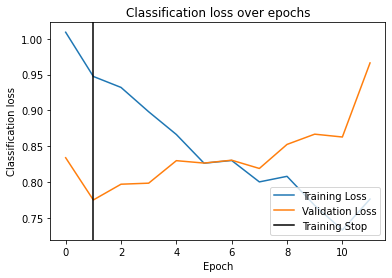

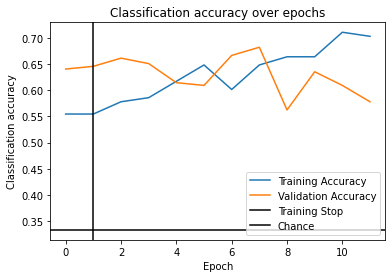

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.247s 	 loss: 0.8692 - acc: 0.6250 - val_loss: 1.2440 - val_acc: 0.4688
Epoch 2/50 0.231s 	 loss: 0.7783 - acc: 0.6641 - val_loss: 1.1922 - val_acc: 0.4740
Epoch 3/50 0.233s 	 loss: 0.7422 - acc: 0.6562 - val_loss: 1.2399 - val_acc: 0.4427
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.7434 - acc: 0.7109 - val_loss: 1.2571 - val_acc: 0.3750
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.232s 	 loss: 0.6854 - acc: 0.7109 - val_loss: 1.2535 - val_acc: 0.5208
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.233s 	 loss: 0.7183 - acc: 0.6953 - val_loss: 1.2869 - val_acc: 0.5000
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.236s 	 loss: 0.6754 - acc: 0.6953 - val_loss: 1.2176 - val_acc: 0.4375
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.244s 	 loss: 0.6352 - acc: 0.7266 - val_loss: 1.1978 - val_acc: 0.5208
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.236s 	 loss: 0.6614 - acc: 0.70

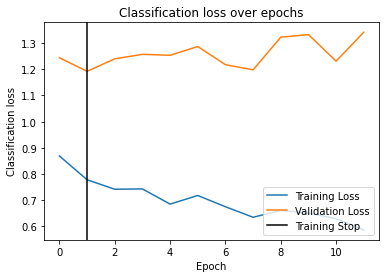

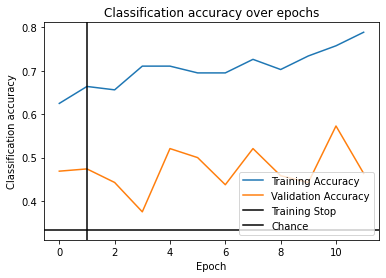

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8488 - acc: 0.6094 - val_loss: 0.5236 - val_acc: 0.7917
Epoch 2/50 0.238s 	 loss: 0.7237 - acc: 0.6719 - val_loss: 0.5837 - val_acc: 0.8073
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.6992 - acc: 0.7188 - val_loss: 0.5971 - val_acc: 0.7708
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.237s 	 loss: 0.6329 - acc: 0.7344 - val_loss: 0.5478 - val_acc: 0.7917
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.242s 	 loss: 0.6210 - acc: 0.7656 - val_loss: 0.5180 - val_acc: 0.7865
Epoch 6/50 0.238s 	 loss: 0.6123 - acc: 0.7188 - val_loss: 0.5372 - val_acc: 0.7917
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.5586 - acc: 0.8203 - val_loss: 0.5231 - val_acc: 0.7760
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.248s 	 loss: 0.4933 - acc: 0.8516 - val_loss: 0.5651 - val_acc: 0.7917
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.245s 	 loss: 0.5142 - acc: 0.81

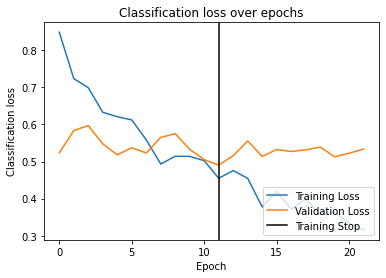

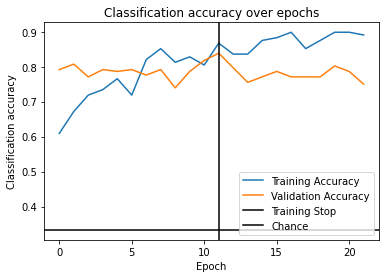

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.7415 - acc: 0.6953 - val_loss: 0.7154 - val_acc: 0.7240
Epoch 2/50 0.235s 	 loss: 0.6787 - acc: 0.7266 - val_loss: 0.6852 - val_acc: 0.7240
Epoch 3/50 0.234s 	 loss: 0.7106 - acc: 0.6719 - val_loss: 0.6765 - val_acc: 0.6562
Epoch 4/50 0.232s 	 loss: 0.6007 - acc: 0.7812 - val_loss: 0.6478 - val_acc: 0.7500
Epoch 5/50 0.233s 	 loss: 0.5642 - acc: 0.7969 - val_loss: 0.6665 - val_acc: 0.7760
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.5818 - acc: 0.7656 - val_loss: 0.6038 - val_acc: 0.7552
Epoch 7/50 0.244s 	 loss: 0.5422 - acc: 0.7734 - val_loss: 0.6119 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.5373 - acc: 0.8047 - val_loss: 0.6247 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.239s 	 loss: 0.5260 - acc: 0.7578 - val_loss: 0.6806 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.236s 	 loss: 0.4

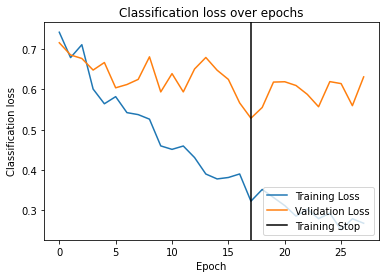

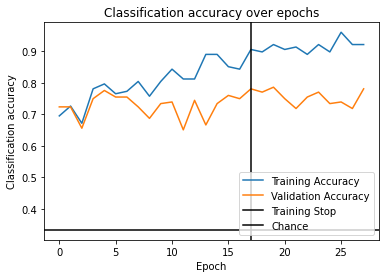

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6595 - acc: 0.7188 - val_loss: 0.8928 - val_acc: 0.5677
Epoch 2/50 0.235s 	 loss: 0.5770 - acc: 0.7578 - val_loss: 0.9772 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.5560 - acc: 0.8125 - val_loss: 0.9010 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.232s 	 loss: 0.5082 - acc: 0.8281 - val_loss: 0.9003 - val_acc: 0.5365
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.246s 	 loss: 0.4690 - acc: 0.8438 - val_loss: 0.8934 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.235s 	 loss: 0.4541 - acc: 0.8672 - val_loss: 0.9420 - val_acc: 0.5208
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.235s 	 loss: 0.4477 - acc: 0.8359 - val_loss: 0.8739 - val_acc: 0.6146
Epoch 8/50 0.232s 	 loss: 0.4370 - acc: 0.8281 - val_loss: 0.8860 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.4231 - acc: 0.85

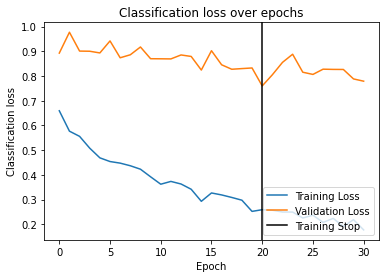

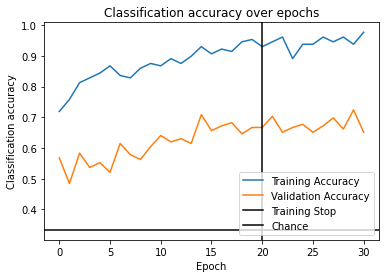

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9747 - acc: 0.5469 - val_loss: 1.0097 - val_acc: 0.4635
Epoch 2/50 0.244s 	 loss: 0.9429 - acc: 0.5391 - val_loss: 1.0079 - val_acc: 0.5469
Epoch 3/50 0.231s 	 loss: 0.8512 - acc: 0.6094 - val_loss: 1.0134 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.7978 - acc: 0.6016 - val_loss: 1.0707 - val_acc: 0.5104
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.7109 - acc: 0.7188 - val_loss: 1.0552 - val_acc: 0.4792
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.238s 	 loss: 0.7604 - acc: 0.6484 - val_loss: 1.0599 - val_acc: 0.5625
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.7060 - acc: 0.6641 - val_loss: 1.0624 - val_acc: 0.5104
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.232s 	 loss: 0.6842 - acc: 0.7188 - val_loss: 1.1317 - val_acc: 0.4635
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.242s 	 loss: 0.6659 - acc: 0.71

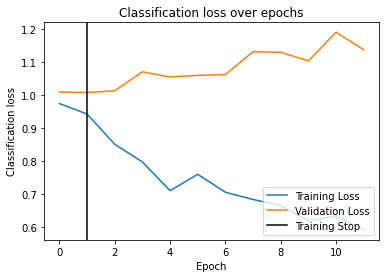

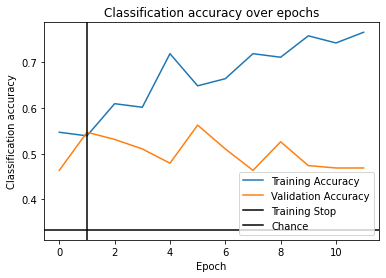

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0730 - acc: 0.5625 - val_loss: 0.9717 - val_acc: 0.5625
Epoch 2/50 0.234s 	 loss: 1.0012 - acc: 0.5234 - val_loss: 0.9322 - val_acc: 0.5417
Epoch 3/50 0.254s 	 loss: 0.9621 - acc: 0.5703 - val_loss: 0.9688 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.9124 - acc: 0.5391 - val_loss: 0.9087 - val_acc: 0.5781
Epoch 5/50 0.236s 	 loss: 0.8802 - acc: 0.5859 - val_loss: 0.9219 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.8473 - acc: 0.6016 - val_loss: 0.9345 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.8178 - acc: 0.5938 - val_loss: 0.8376 - val_acc: 0.6406
Epoch 8/50 0.234s 	 loss: 0.7640 - acc: 0.6562 - val_loss: 0.9167 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.239s 	 loss: 0.7258 - acc: 0.6875 - val_loss: 0.8858 - val_acc: 0.5938
EarlyStopping counter: 2 out o

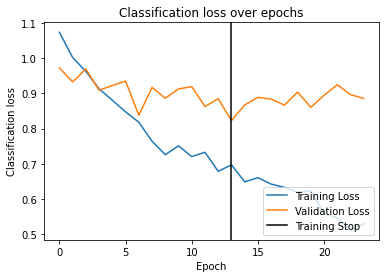

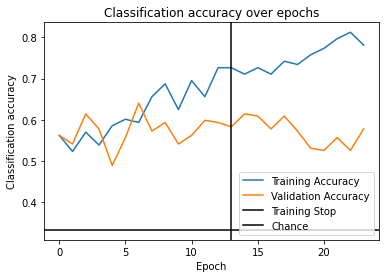

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.9623 - acc: 0.5703 - val_loss: 0.9771 - val_acc: 0.5885
Epoch 2/50 0.236s 	 loss: 0.8992 - acc: 0.6250 - val_loss: 0.9964 - val_acc: 0.5000
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.240s 	 loss: 0.9579 - acc: 0.5391 - val_loss: 1.0151 - val_acc: 0.4896
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.8621 - acc: 0.5859 - val_loss: 0.9681 - val_acc: 0.5990
Epoch 5/50 0.238s 	 loss: 0.8566 - acc: 0.6328 - val_loss: 1.0078 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.8376 - acc: 0.5781 - val_loss: 0.9775 - val_acc: 0.5521
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.231s 	 loss: 0.7629 - acc: 0.6641 - val_loss: 0.9938 - val_acc: 0.5729
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.234s 	 loss: 0.7629 - acc: 0.6484 - val_loss: 0.9494 - val_acc: 0.5156
Epoch 9/50 0.238s 	 loss: 0.7475 - acc: 0.6797 - val_loss: 1.0212 - val_acc: 0.

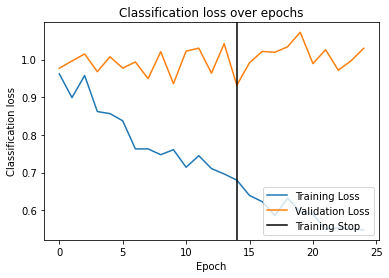

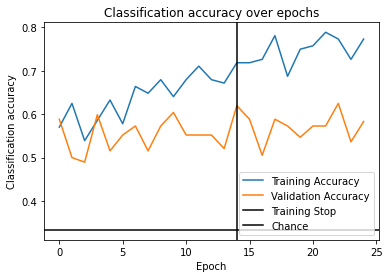

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 1.0995 - acc: 0.4609 - val_loss: 0.6564 - val_acc: 0.6667
Epoch 2/50 0.235s 	 loss: 0.9719 - acc: 0.5391 - val_loss: 0.5955 - val_acc: 0.7812
Epoch 3/50 0.231s 	 loss: 0.8445 - acc: 0.6328 - val_loss: 0.6232 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.8173 - acc: 0.6328 - val_loss: 0.6375 - val_acc: 0.7969
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.233s 	 loss: 0.7653 - acc: 0.6562 - val_loss: 0.5986 - val_acc: 0.7812
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.238s 	 loss: 0.7467 - acc: 0.6875 - val_loss: 0.6205 - val_acc: 0.7396
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.235s 	 loss: 0.6620 - acc: 0.6875 - val_loss: 0.6083 - val_acc: 0.7448
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.244s 	 loss: 0.6266 - acc: 0.7500 - val_loss: 0.6122 - val_acc: 0.7292
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.238s 	 loss: 0.6264 - acc: 0.69

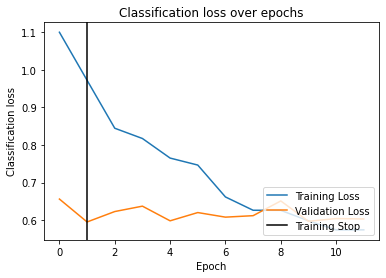

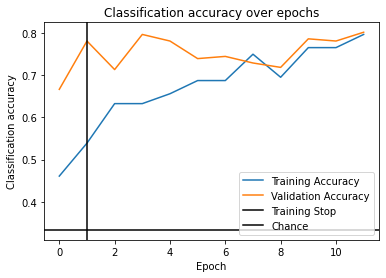

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.8740 - acc: 0.6094 - val_loss: 1.0701 - val_acc: 0.4792
Epoch 2/50 0.236s 	 loss: 0.8390 - acc: 0.6641 - val_loss: 1.0004 - val_acc: 0.5260
Epoch 3/50 0.233s 	 loss: 0.7328 - acc: 0.6875 - val_loss: 0.9086 - val_acc: 0.5208
Epoch 4/50 0.236s 	 loss: 0.7212 - acc: 0.6797 - val_loss: 0.8806 - val_acc: 0.5573
Epoch 5/50 0.236s 	 loss: 0.7149 - acc: 0.6406 - val_loss: 0.8790 - val_acc: 0.5521
Epoch 6/50 0.237s 	 loss: 0.6370 - acc: 0.7656 - val_loss: 0.8300 - val_acc: 0.5938
Epoch 7/50 0.235s 	 loss: 0.6137 - acc: 0.7188 - val_loss: 0.9275 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.244s 	 loss: 0.5988 - acc: 0.7656 - val_loss: 0.8570 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.239s 	 loss: 0.6079 - acc: 0.7344 - val_loss: 0.8610 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.240s 	 loss: 0.5254 - acc: 0.8047 - val_loss: 0.914

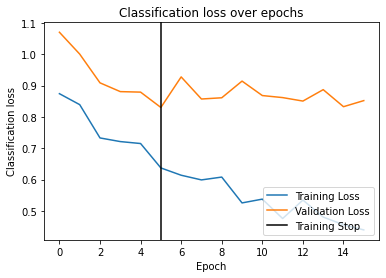

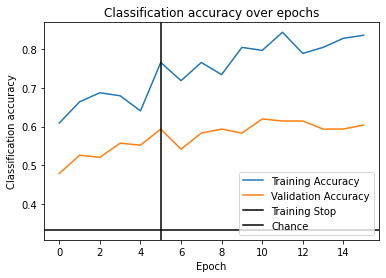

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.8467 - acc: 0.6016 - val_loss: 1.0317 - val_acc: 0.5729
Epoch 2/50 0.233s 	 loss: 0.7342 - acc: 0.6641 - val_loss: 1.1356 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.6398 - acc: 0.7266 - val_loss: 1.1134 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.6024 - acc: 0.7812 - val_loss: 0.9191 - val_acc: 0.5677
Epoch 5/50 0.238s 	 loss: 0.5595 - acc: 0.8281 - val_loss: 0.9897 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.5227 - acc: 0.7891 - val_loss: 0.9601 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.5286 - acc: 0.7891 - val_loss: 0.9733 - val_acc: 0.5990
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.237s 	 loss: 0.4598 - acc: 0.8516 - val_loss: 0.8827 - val_acc: 0.6302
Epoch 9/50 0.235s 	 loss: 0.4538 - acc: 0.8125 - val_loss: 1.0029 - val_acc: 0.

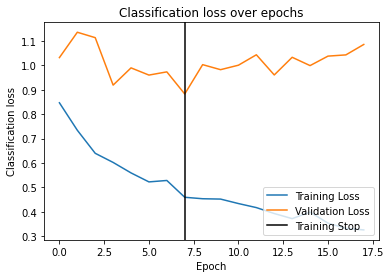

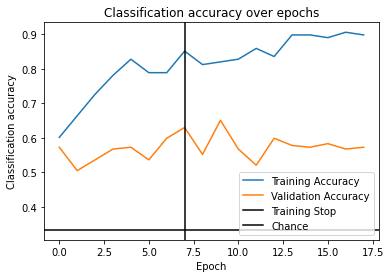

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.1924 - acc: 0.4922 - val_loss: 0.8968 - val_acc: 0.6042
Epoch 2/50 0.233s 	 loss: 1.0641 - acc: 0.5312 - val_loss: 0.9446 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.8714 - acc: 0.5938 - val_loss: 0.9082 - val_acc: 0.5990
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.8876 - acc: 0.6562 - val_loss: 0.8436 - val_acc: 0.5990
Epoch 5/50 0.233s 	 loss: 0.8220 - acc: 0.6172 - val_loss: 0.8779 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.7914 - acc: 0.6250 - val_loss: 0.8663 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.7465 - acc: 0.7031 - val_loss: 0.9205 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.233s 	 loss: 0.7540 - acc: 0.6641 - val_loss: 0.8147 - val_acc: 0.5781
Epoch 9/50 0.234s 	 loss: 0.6906 - acc: 0.7422 - val_loss: 0.8694 - val_acc: 0.

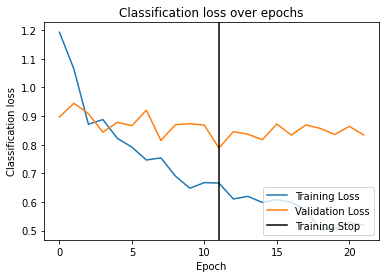

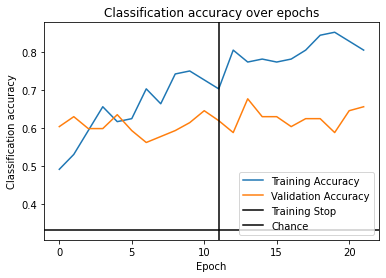

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0194 - acc: 0.5625 - val_loss: 1.3275 - val_acc: 0.4688
Epoch 2/50 0.236s 	 loss: 0.8901 - acc: 0.6094 - val_loss: 1.3011 - val_acc: 0.4792
Epoch 3/50 0.235s 	 loss: 0.7853 - acc: 0.6719 - val_loss: 1.1759 - val_acc: 0.4635
Epoch 4/50 0.240s 	 loss: 0.7475 - acc: 0.6797 - val_loss: 1.1094 - val_acc: 0.4792
Epoch 5/50 0.239s 	 loss: 0.7039 - acc: 0.6875 - val_loss: 1.1042 - val_acc: 0.5260
Epoch 6/50 0.245s 	 loss: 0.6510 - acc: 0.7500 - val_loss: 1.0054 - val_acc: 0.5469
Epoch 7/50 0.233s 	 loss: 0.6496 - acc: 0.6797 - val_loss: 1.0976 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.6279 - acc: 0.7969 - val_loss: 1.0684 - val_acc: 0.5156
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.234s 	 loss: 0.5925 - acc: 0.7500 - val_loss: 1.0763 - val_acc: 0.4531
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.231s 	 loss: 0.6219 - acc: 0.7812 - val_loss: 1.043

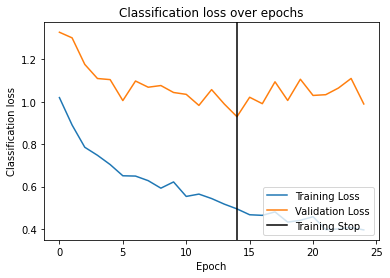

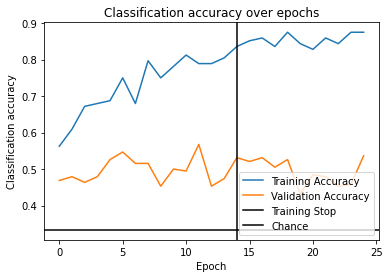

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.250s 	 loss: 1.1139 - acc: 0.5781 - val_loss: 0.9812 - val_acc: 0.6302
Epoch 2/50 0.242s 	 loss: 0.9625 - acc: 0.5703 - val_loss: 1.0412 - val_acc: 0.5052
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.8374 - acc: 0.6328 - val_loss: 0.9271 - val_acc: 0.5729
Epoch 4/50 0.238s 	 loss: 0.8508 - acc: 0.6016 - val_loss: 0.9447 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.8022 - acc: 0.6641 - val_loss: 0.8929 - val_acc: 0.5729
Epoch 6/50 0.234s 	 loss: 0.7106 - acc: 0.7109 - val_loss: 0.8438 - val_acc: 0.6562
Epoch 7/50 0.233s 	 loss: 0.6623 - acc: 0.6953 - val_loss: 0.8997 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.231s 	 loss: 0.6348 - acc: 0.7656 - val_loss: 0.9178 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.253s 	 loss: 0.6698 - acc: 0.6953 - val_loss: 0.8474 - val_acc: 0.5781
EarlyStopping counter: 3 out o

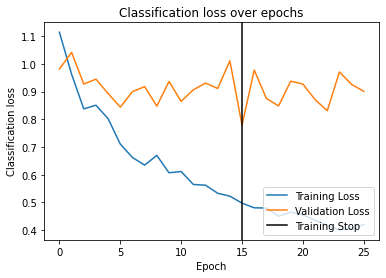

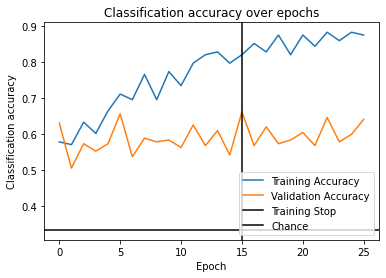

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.8124 - acc: 0.6094 - val_loss: 0.8463 - val_acc: 0.5573
Epoch 2/50 0.233s 	 loss: 0.7057 - acc: 0.6406 - val_loss: 0.8974 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.7428 - acc: 0.6406 - val_loss: 0.8480 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.232s 	 loss: 0.6603 - acc: 0.7188 - val_loss: 0.8494 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.6227 - acc: 0.7188 - val_loss: 0.8258 - val_acc: 0.6198
Epoch 6/50 0.239s 	 loss: 0.5983 - acc: 0.7656 - val_loss: 0.8199 - val_acc: 0.6615
Epoch 7/50 0.233s 	 loss: 0.6123 - acc: 0.7266 - val_loss: 0.8366 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.233s 	 loss: 0.5664 - acc: 0.7891 - val_loss: 0.9009 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.5716 - acc: 0.7344 - val_loss: 0.8439 - val_acc: 0.

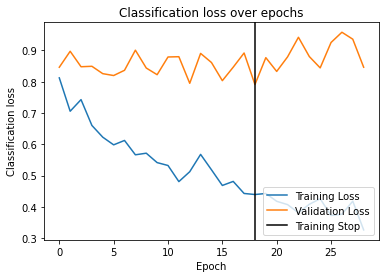

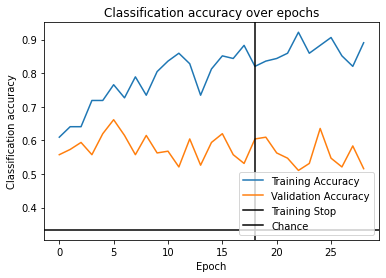

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8368 - acc: 0.5703 - val_loss: 0.7866 - val_acc: 0.6406
Epoch 2/50 0.235s 	 loss: 0.7739 - acc: 0.6484 - val_loss: 0.7628 - val_acc: 0.6615
Epoch 3/50 0.231s 	 loss: 0.7186 - acc: 0.6484 - val_loss: 0.8803 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.6889 - acc: 0.6484 - val_loss: 0.8710 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.7023 - acc: 0.6953 - val_loss: 0.7519 - val_acc: 0.6458
Epoch 6/50 0.234s 	 loss: 0.6249 - acc: 0.7344 - val_loss: 0.7627 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.242s 	 loss: 0.6606 - acc: 0.6875 - val_loss: 0.7831 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.237s 	 loss: 0.6509 - acc: 0.7344 - val_loss: 0.8084 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.238s 	 loss: 0.6204 - acc: 0.7422 - val_loss: 0.8562 - val_acc: 0.

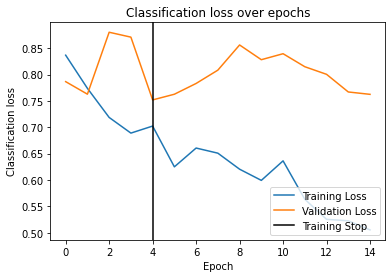

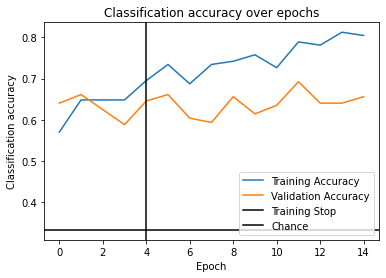

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8384 - acc: 0.5781 - val_loss: 0.7035 - val_acc: 0.6094
Epoch 2/50 0.240s 	 loss: 0.8206 - acc: 0.6172 - val_loss: 0.7224 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.7668 - acc: 0.6328 - val_loss: 0.6891 - val_acc: 0.6510
Epoch 4/50 0.232s 	 loss: 0.7188 - acc: 0.6562 - val_loss: 0.7112 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.7201 - acc: 0.6953 - val_loss: 0.7188 - val_acc: 0.6771
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.249s 	 loss: 0.6581 - acc: 0.7266 - val_loss: 0.6207 - val_acc: 0.7031
Epoch 7/50 0.237s 	 loss: 0.6522 - acc: 0.7109 - val_loss: 0.7540 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.236s 	 loss: 0.6444 - acc: 0.7109 - val_loss: 0.7707 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.234s 	 loss: 0.6152 - acc: 0.7578 - val_loss: 0.7295 - val_acc: 0.

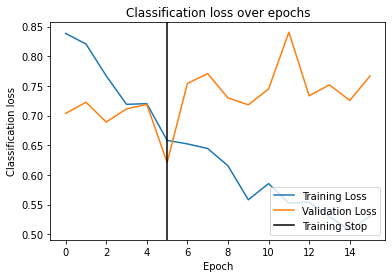

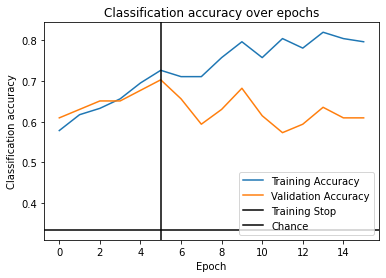

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8292 - acc: 0.6406 - val_loss: 0.6002 - val_acc: 0.7083
Epoch 2/50 0.237s 	 loss: 0.7538 - acc: 0.6562 - val_loss: 0.5717 - val_acc: 0.7604
Epoch 3/50 0.231s 	 loss: 0.6843 - acc: 0.7188 - val_loss: 0.5524 - val_acc: 0.7552
Epoch 4/50 0.229s 	 loss: 0.6469 - acc: 0.7656 - val_loss: 0.4948 - val_acc: 0.8854
Epoch 5/50 0.235s 	 loss: 0.6498 - acc: 0.7109 - val_loss: 0.5346 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.5623 - acc: 0.7656 - val_loss: 0.5570 - val_acc: 0.8021
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.232s 	 loss: 0.5788 - acc: 0.7500 - val_loss: 0.5493 - val_acc: 0.7552
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.242s 	 loss: 0.5385 - acc: 0.7812 - val_loss: 0.4908 - val_acc: 0.7708
Epoch 9/50 0.261s 	 loss: 0.5515 - acc: 0.7734 - val_loss: 0.5563 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.250s 	 loss: 0.4

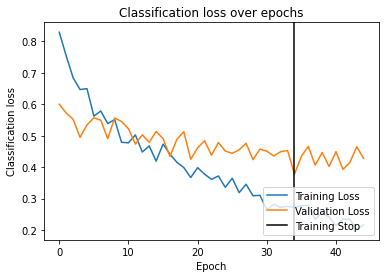

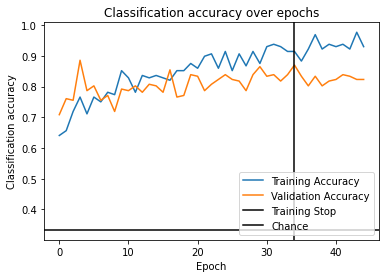

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.6977 - acc: 0.7109 - val_loss: 0.9715 - val_acc: 0.5677
Epoch 2/50 0.235s 	 loss: 0.6651 - acc: 0.6953 - val_loss: 0.9243 - val_acc: 0.5990
Epoch 3/50 0.235s 	 loss: 0.6211 - acc: 0.7500 - val_loss: 0.7833 - val_acc: 0.6510
Epoch 4/50 0.236s 	 loss: 0.5727 - acc: 0.8047 - val_loss: 0.8131 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.233s 	 loss: 0.5401 - acc: 0.7969 - val_loss: 0.8040 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.238s 	 loss: 0.5455 - acc: 0.7578 - val_loss: 0.7331 - val_acc: 0.7292
Epoch 7/50 0.236s 	 loss: 0.5003 - acc: 0.7969 - val_loss: 0.8012 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.251s 	 loss: 0.4640 - acc: 0.8438 - val_loss: 0.7758 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.4801 - acc: 0.8047 - val_loss: 0.6894 - val_acc: 0.7240
Epoch 10/50 0.232s 	 loss: 0.4

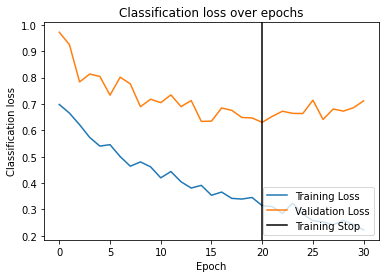

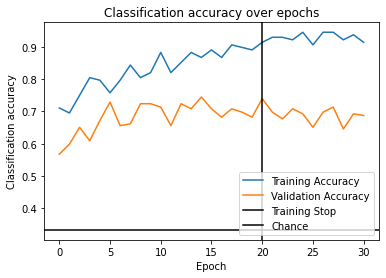

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.6987 - acc: 0.7344 - val_loss: 0.7664 - val_acc: 0.7083
Epoch 2/50 0.236s 	 loss: 0.6600 - acc: 0.7344 - val_loss: 0.7762 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.5890 - acc: 0.8047 - val_loss: 0.7140 - val_acc: 0.7240
Epoch 4/50 0.236s 	 loss: 0.5544 - acc: 0.7734 - val_loss: 0.7373 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.5218 - acc: 0.8047 - val_loss: 0.7006 - val_acc: 0.7240
Epoch 6/50 0.255s 	 loss: 0.4973 - acc: 0.8594 - val_loss: 0.6783 - val_acc: 0.7188
Epoch 7/50 0.239s 	 loss: 0.4848 - acc: 0.8125 - val_loss: 0.7157 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.4397 - acc: 0.8828 - val_loss: 0.7061 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.234s 	 loss: 0.4308 - acc: 0.8672 - val_loss: 0.7076 - val_acc: 0.7031
EarlyStopping counter: 3 out o

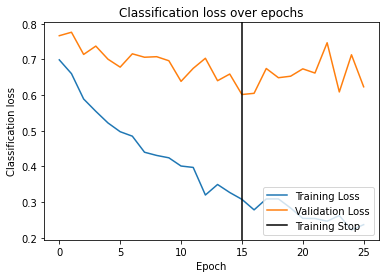

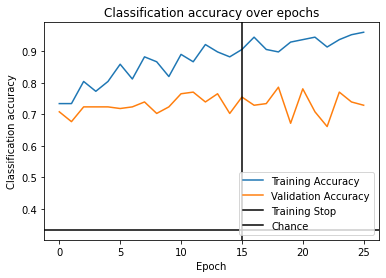

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.4808 - acc: 0.8281 - val_loss: 0.3856 - val_acc: 0.8281
Epoch 2/50 0.230s 	 loss: 0.4173 - acc: 0.8594 - val_loss: 0.3646 - val_acc: 0.8438
Epoch 3/50 0.233s 	 loss: 0.3615 - acc: 0.8828 - val_loss: 0.2839 - val_acc: 0.9375
Epoch 4/50 0.237s 	 loss: 0.3522 - acc: 0.9062 - val_loss: 0.3054 - val_acc: 0.9375
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.3187 - acc: 0.9297 - val_loss: 0.2742 - val_acc: 0.9375
Epoch 6/50 0.234s 	 loss: 0.2803 - acc: 0.9297 - val_loss: 0.2678 - val_acc: 0.9844
Epoch 7/50 0.237s 	 loss: 0.2698 - acc: 0.9297 - val_loss: 0.2350 - val_acc: 0.9688
Epoch 8/50 0.236s 	 loss: 0.2531 - acc: 0.9453 - val_loss: 0.2572 - val_acc: 0.9375
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.253s 	 loss: 0.2292 - acc: 0.9453 - val_loss: 0.2126 - val_acc: 0.9479
Epoch 10/50 0.234s 	 loss: 0.2071 - acc: 0.9688 - val_loss: 0.2327 - val_acc: 0.9531
EarlyStopping c

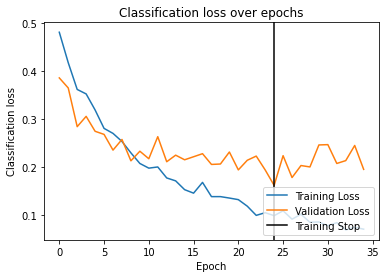

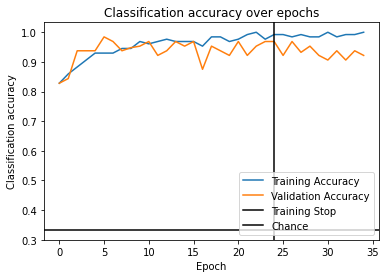

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.5218 - acc: 0.7578 - val_loss: 0.3967 - val_acc: 0.8385
Epoch 2/50 0.236s 	 loss: 0.4181 - acc: 0.8516 - val_loss: 0.3799 - val_acc: 0.8854
Epoch 3/50 0.238s 	 loss: 0.3880 - acc: 0.8594 - val_loss: 0.3429 - val_acc: 0.8906
Epoch 4/50 0.235s 	 loss: 0.3088 - acc: 0.9141 - val_loss: 0.3268 - val_acc: 0.8906
Epoch 5/50 0.237s 	 loss: 0.3023 - acc: 0.9062 - val_loss: 0.3476 - val_acc: 0.8750
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.2667 - acc: 0.9375 - val_loss: 0.3086 - val_acc: 0.9219
Epoch 7/50 0.233s 	 loss: 0.2577 - acc: 0.9375 - val_loss: 0.3369 - val_acc: 0.8542
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.2463 - acc: 0.9297 - val_loss: 0.3006 - val_acc: 0.9010
Epoch 9/50 0.236s 	 loss: 0.2276 - acc: 0.9375 - val_loss: 0.2421 - val_acc: 0.9531
Epoch 10/50 0.236s 	 loss: 0.2134 - acc: 0.9375 - val_loss: 0.2435 - val_acc: 0.9010
EarlyStopping c

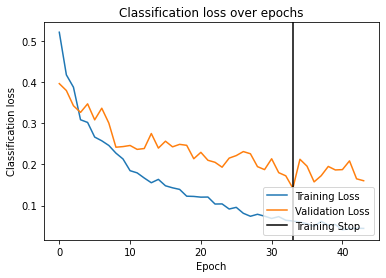

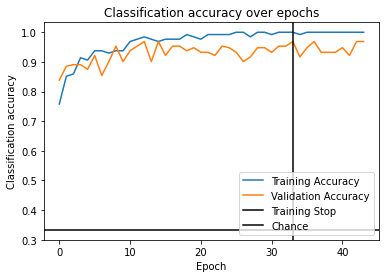

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.4254 - acc: 0.8203 - val_loss: 0.5593 - val_acc: 0.7135
Epoch 2/50 0.239s 	 loss: 0.3699 - acc: 0.8672 - val_loss: 0.4888 - val_acc: 0.8073
Epoch 3/50 0.235s 	 loss: 0.3110 - acc: 0.8906 - val_loss: 0.4666 - val_acc: 0.8385
Epoch 4/50 0.233s 	 loss: 0.2813 - acc: 0.9219 - val_loss: 0.4235 - val_acc: 0.8229
Epoch 5/50 0.246s 	 loss: 0.2554 - acc: 0.9531 - val_loss: 0.3989 - val_acc: 0.8542
Epoch 6/50 0.236s 	 loss: 0.2123 - acc: 0.9688 - val_loss: 0.3852 - val_acc: 0.8490
Epoch 7/50 0.232s 	 loss: 0.2046 - acc: 0.9531 - val_loss: 0.3830 - val_acc: 0.8385
Epoch 8/50 0.235s 	 loss: 0.1807 - acc: 0.9844 - val_loss: 0.3871 - val_acc: 0.8854
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.1610 - acc: 0.9922 - val_loss: 0.3991 - val_acc: 0.8542
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.236s 	 loss: 0.1832 - acc: 0.9688 - val_loss: 0.3176 - val_acc: 0.8854
Epoch 11/50 0.2

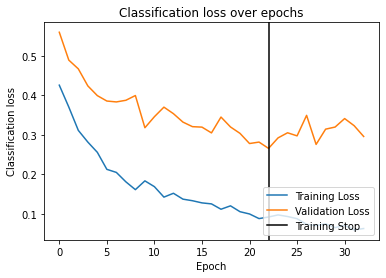

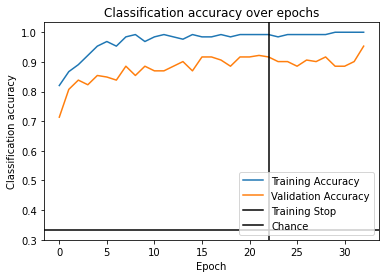

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5535 - acc: 0.7891 - val_loss: 0.5788 - val_acc: 0.7917
Epoch 2/50 0.239s 	 loss: 0.4786 - acc: 0.8125 - val_loss: 0.5995 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.246s 	 loss: 0.4346 - acc: 0.8516 - val_loss: 0.5422 - val_acc: 0.7760
Epoch 4/50 0.239s 	 loss: 0.3920 - acc: 0.8594 - val_loss: 0.6043 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.3732 - acc: 0.8750 - val_loss: 0.5704 - val_acc: 0.7917
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.239s 	 loss: 0.3457 - acc: 0.8984 - val_loss: 0.6357 - val_acc: 0.8073
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.241s 	 loss: 0.3430 - acc: 0.9062 - val_loss: 0.6365 - val_acc: 0.7656
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.242s 	 loss: 0.3025 - acc: 0.8984 - val_loss: 0.5708 - val_acc: 0.7656
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.238s 	 loss: 0.2790 - acc: 0.94

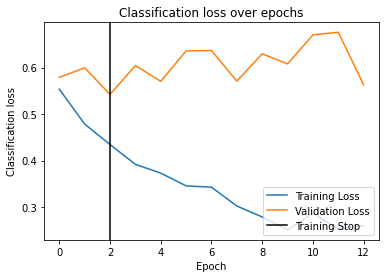

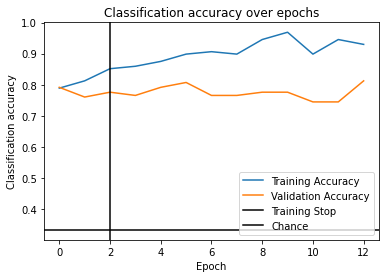

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.6510 - acc: 0.7422 - val_loss: 0.4517 - val_acc: 0.8594
Epoch 2/50 0.232s 	 loss: 0.5514 - acc: 0.7891 - val_loss: 0.3895 - val_acc: 0.9062
Epoch 3/50 0.237s 	 loss: 0.5046 - acc: 0.7969 - val_loss: 0.4023 - val_acc: 0.8906
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.235s 	 loss: 0.4660 - acc: 0.8438 - val_loss: 0.4237 - val_acc: 0.8438
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.4624 - acc: 0.8125 - val_loss: 0.4066 - val_acc: 0.9062
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.247s 	 loss: 0.4287 - acc: 0.8281 - val_loss: 0.4049 - val_acc: 0.8750
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.234s 	 loss: 0.4188 - acc: 0.8750 - val_loss: 0.3945 - val_acc: 0.8750
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.237s 	 loss: 0.3996 - acc: 0.8828 - val_loss: 0.3766 - val_acc: 0.8750
Epoch 9/50 0.237s 	 loss: 0.3539 - acc: 0.8984 - val_loss: 0.3581 - val_acc: 0.

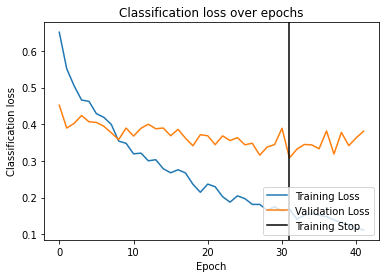

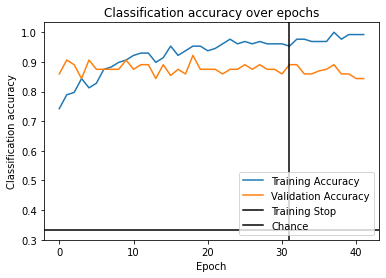

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.5134 - acc: 0.7891 - val_loss: 0.5927 - val_acc: 0.7604
Epoch 2/50 0.231s 	 loss: 0.4889 - acc: 0.8047 - val_loss: 0.5524 - val_acc: 0.7865
Epoch 3/50 0.237s 	 loss: 0.4167 - acc: 0.8281 - val_loss: 0.5956 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.4098 - acc: 0.8906 - val_loss: 0.5406 - val_acc: 0.7656
Epoch 5/50 0.237s 	 loss: 0.3968 - acc: 0.8281 - val_loss: 0.4831 - val_acc: 0.7708
Epoch 6/50 0.239s 	 loss: 0.3747 - acc: 0.8906 - val_loss: 0.5473 - val_acc: 0.7812
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.3606 - acc: 0.8672 - val_loss: 0.4748 - val_acc: 0.7865
Epoch 8/50 0.233s 	 loss: 0.3127 - acc: 0.9375 - val_loss: 0.5061 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.245s 	 loss: 0.3409 - acc: 0.8828 - val_loss: 0.4427 - val_acc: 0.8073
Epoch 10/50 0.230s 	 loss: 0.3117 - acc: 0.9062 - val_loss: 0.477

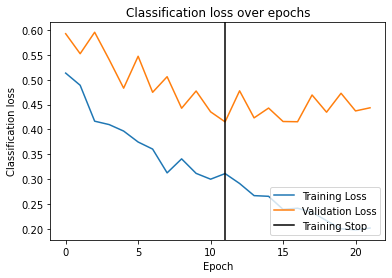

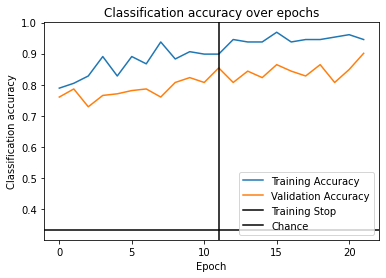

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 1.2567 - acc: 0.4922 - val_loss: 1.0950 - val_acc: 0.5573
Epoch 2/50 0.234s 	 loss: 1.1748 - acc: 0.5156 - val_loss: 1.1309 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 1.0965 - acc: 0.5391 - val_loss: 1.0401 - val_acc: 0.5312
Epoch 4/50 0.232s 	 loss: 1.0850 - acc: 0.5547 - val_loss: 1.0376 - val_acc: 0.6042
Epoch 5/50 0.233s 	 loss: 1.0335 - acc: 0.5703 - val_loss: 1.0475 - val_acc: 0.5625
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.9726 - acc: 0.5859 - val_loss: 1.0368 - val_acc: 0.6146
Epoch 7/50 0.235s 	 loss: 0.9443 - acc: 0.5781 - val_loss: 0.9707 - val_acc: 0.5677
Epoch 8/50 0.236s 	 loss: 0.9032 - acc: 0.6328 - val_loss: 1.0523 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.242s 	 loss: 0.9099 - acc: 0.6094 - val_loss: 0.9761 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.233s 	 loss: 0.9

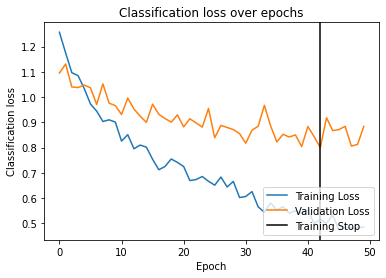

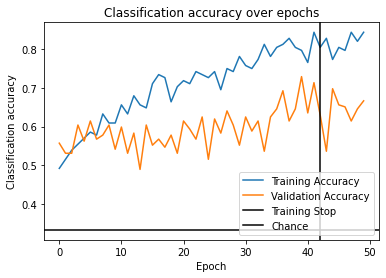

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.1441 - acc: 0.5312 - val_loss: 1.3717 - val_acc: 0.4740
Epoch 2/50 0.234s 	 loss: 1.0666 - acc: 0.6016 - val_loss: 1.3491 - val_acc: 0.4271
Epoch 3/50 0.233s 	 loss: 0.9316 - acc: 0.6094 - val_loss: 1.3354 - val_acc: 0.4583
Epoch 4/50 0.233s 	 loss: 0.9760 - acc: 0.5625 - val_loss: 1.3632 - val_acc: 0.4167
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.234s 	 loss: 0.9377 - acc: 0.6016 - val_loss: 1.2050 - val_acc: 0.5469
Epoch 6/50 0.235s 	 loss: 0.8795 - acc: 0.6328 - val_loss: 1.2479 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.8661 - acc: 0.6406 - val_loss: 1.2456 - val_acc: 0.5312
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.232s 	 loss: 0.8887 - acc: 0.6484 - val_loss: 1.1143 - val_acc: 0.5885
Epoch 9/50 0.235s 	 loss: 0.8282 - acc: 0.6562 - val_loss: 1.0987 - val_acc: 0.6198
Epoch 10/50 0.234s 	 loss: 0.7914 - acc: 0.6797 - val_loss: 1.130

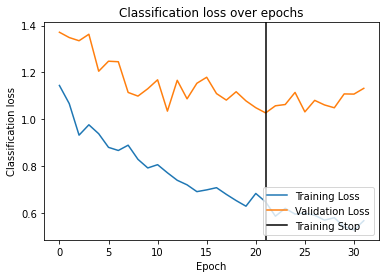

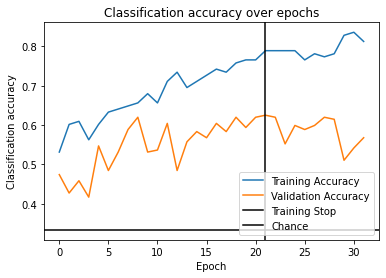

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.2367 - acc: 0.4844 - val_loss: 1.1194 - val_acc: 0.6042
Epoch 2/50 0.235s 	 loss: 1.1251 - acc: 0.5234 - val_loss: 1.0821 - val_acc: 0.5573
Epoch 3/50 0.232s 	 loss: 1.0529 - acc: 0.5391 - val_loss: 1.0873 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.9474 - acc: 0.6094 - val_loss: 1.0377 - val_acc: 0.5469
Epoch 5/50 0.231s 	 loss: 0.9623 - acc: 0.6094 - val_loss: 1.0419 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.232s 	 loss: 0.9422 - acc: 0.6406 - val_loss: 1.1123 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.8849 - acc: 0.6094 - val_loss: 1.0368 - val_acc: 0.5573
Epoch 8/50 0.237s 	 loss: 0.8758 - acc: 0.6406 - val_loss: 1.0376 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.235s 	 loss: 0.7944 - acc: 0.6875 - val_loss: 1.0170 - val_acc: 0.5677
Epoch 10/50 0.236s 	 loss: 0.7

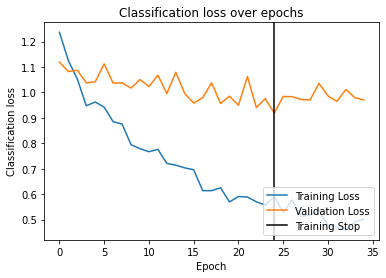

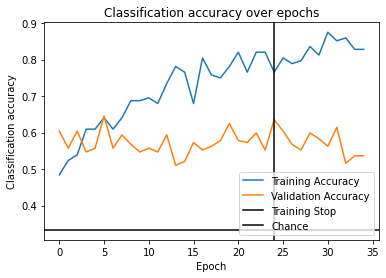

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.231s 	 loss: 0.7082 - acc: 0.6797 - val_loss: 0.8394 - val_acc: 0.6354
Epoch 2/50 0.234s 	 loss: 0.6849 - acc: 0.6875 - val_loss: 0.7310 - val_acc: 0.6979
Epoch 3/50 0.236s 	 loss: 0.6259 - acc: 0.7266 - val_loss: 0.8300 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.5799 - acc: 0.7422 - val_loss: 0.7309 - val_acc: 0.6979
Epoch 5/50 0.233s 	 loss: 0.5060 - acc: 0.8438 - val_loss: 0.6640 - val_acc: 0.6823
Epoch 6/50 0.241s 	 loss: 0.4624 - acc: 0.8438 - val_loss: 0.6882 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.240s 	 loss: 0.4524 - acc: 0.8438 - val_loss: 0.6584 - val_acc: 0.6979
Epoch 8/50 0.236s 	 loss: 0.4622 - acc: 0.8516 - val_loss: 0.6529 - val_acc: 0.6510
Epoch 9/50 0.236s 	 loss: 0.3986 - acc: 0.8906 - val_loss: 0.6904 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.241s 	 loss: 0.4097 - acc: 0.8906 - val_loss: 0.653

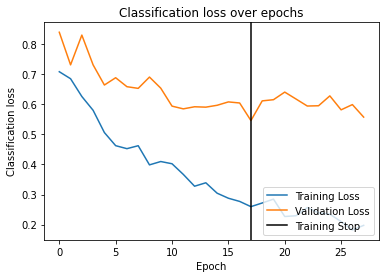

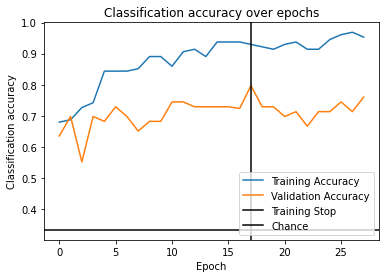

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8403 - acc: 0.5859 - val_loss: 0.6153 - val_acc: 0.7188
Epoch 2/50 0.230s 	 loss: 0.7042 - acc: 0.6797 - val_loss: 0.5961 - val_acc: 0.7708
Epoch 3/50 0.232s 	 loss: 0.6396 - acc: 0.7422 - val_loss: 0.5534 - val_acc: 0.8073
Epoch 4/50 0.237s 	 loss: 0.5888 - acc: 0.7578 - val_loss: 0.5517 - val_acc: 0.8073
Epoch 5/50 0.246s 	 loss: 0.5713 - acc: 0.7812 - val_loss: 0.6121 - val_acc: 0.7760
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.5181 - acc: 0.8125 - val_loss: 0.5633 - val_acc: 0.7865
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.232s 	 loss: 0.4703 - acc: 0.8594 - val_loss: 0.5284 - val_acc: 0.7969
Epoch 8/50 0.235s 	 loss: 0.4304 - acc: 0.8984 - val_loss: 0.5173 - val_acc: 0.8542
Epoch 9/50 0.234s 	 loss: 0.4455 - acc: 0.8438 - val_loss: 0.5598 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.250s 	 loss: 0.3975 - acc: 0.8594 - val_loss: 0.566

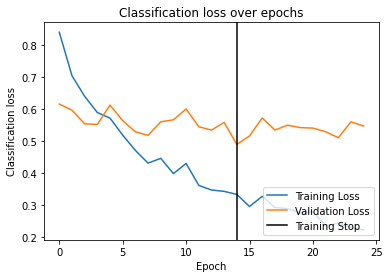

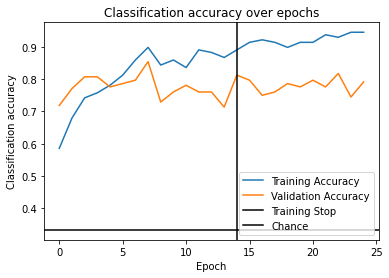

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7944 - acc: 0.6875 - val_loss: 0.8050 - val_acc: 0.6198
Epoch 2/50 0.236s 	 loss: 0.7085 - acc: 0.6719 - val_loss: 0.7022 - val_acc: 0.7031
Epoch 3/50 0.232s 	 loss: 0.6295 - acc: 0.7344 - val_loss: 0.6471 - val_acc: 0.7604
Epoch 4/50 0.235s 	 loss: 0.5834 - acc: 0.7812 - val_loss: 0.7368 - val_acc: 0.6302
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.5032 - acc: 0.8125 - val_loss: 0.6619 - val_acc: 0.7344
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.242s 	 loss: 0.4903 - acc: 0.7812 - val_loss: 0.6608 - val_acc: 0.6979
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.233s 	 loss: 0.4050 - acc: 0.8594 - val_loss: 0.6419 - val_acc: 0.7031
Epoch 8/50 0.235s 	 loss: 0.4320 - acc: 0.8359 - val_loss: 0.6378 - val_acc: 0.7500
Epoch 9/50 0.234s 	 loss: 0.3975 - acc: 0.8516 - val_loss: 0.5879 - val_acc: 0.7448
Epoch 10/50 0.239s 	 loss: 0.3662 - acc: 0.8906 - val_loss: 0.635

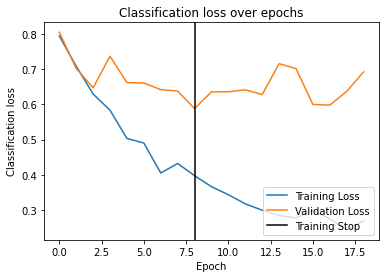

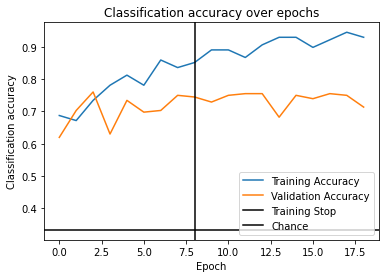

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8600 - acc: 0.6250 - val_loss: 0.7389 - val_acc: 0.6615
Epoch 2/50 0.237s 	 loss: 0.7489 - acc: 0.6797 - val_loss: 0.7324 - val_acc: 0.6615
Epoch 3/50 0.235s 	 loss: 0.7835 - acc: 0.6406 - val_loss: 0.6788 - val_acc: 0.7604
Epoch 4/50 0.247s 	 loss: 0.7215 - acc: 0.6797 - val_loss: 0.7056 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.238s 	 loss: 0.7451 - acc: 0.6562 - val_loss: 0.6561 - val_acc: 0.7344
Epoch 6/50 0.235s 	 loss: 0.7366 - acc: 0.6875 - val_loss: 0.6806 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.6247 - acc: 0.7344 - val_loss: 0.7117 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.231s 	 loss: 0.6238 - acc: 0.7188 - val_loss: 0.6323 - val_acc: 0.7396
Epoch 9/50 0.232s 	 loss: 0.6378 - acc: 0.7578 - val_loss: 0.7073 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.6

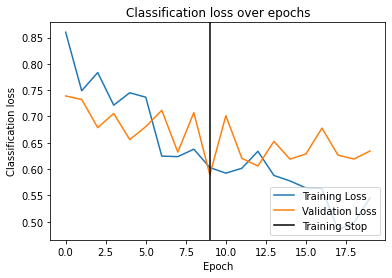

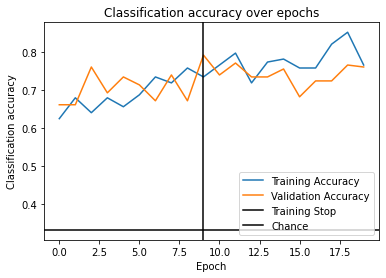

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.8528 - acc: 0.5938 - val_loss: 0.6551 - val_acc: 0.7083
Epoch 2/50 0.234s 	 loss: 0.8423 - acc: 0.6406 - val_loss: 0.6385 - val_acc: 0.7031
Epoch 3/50 0.230s 	 loss: 0.7880 - acc: 0.6562 - val_loss: 0.6542 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.7301 - acc: 0.7188 - val_loss: 0.6745 - val_acc: 0.7083
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.7384 - acc: 0.6953 - val_loss: 0.6869 - val_acc: 0.6927
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.234s 	 loss: 0.6910 - acc: 0.7109 - val_loss: 0.6804 - val_acc: 0.7031
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.238s 	 loss: 0.6958 - acc: 0.7266 - val_loss: 0.6169 - val_acc: 0.7292
Epoch 8/50 0.242s 	 loss: 0.6630 - acc: 0.7266 - val_loss: 0.7184 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.239s 	 loss: 0.6247 - acc: 0.7578 - val_loss: 0.6845 - val_acc: 0.

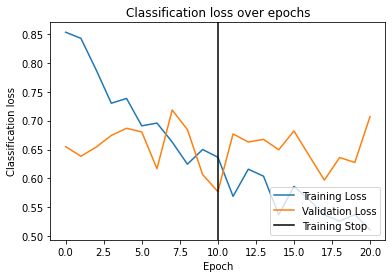

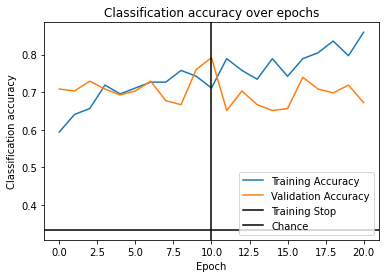

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.7321 - acc: 0.6250 - val_loss: 0.9539 - val_acc: 0.5885
Epoch 2/50 0.236s 	 loss: 0.6792 - acc: 0.7266 - val_loss: 0.9249 - val_acc: 0.6354
Epoch 3/50 0.235s 	 loss: 0.6481 - acc: 0.7266 - val_loss: 0.9403 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.6407 - acc: 0.7188 - val_loss: 0.9058 - val_acc: 0.6146
Epoch 5/50 0.239s 	 loss: 0.6040 - acc: 0.7812 - val_loss: 0.9140 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.6051 - acc: 0.7500 - val_loss: 0.8768 - val_acc: 0.6094
Epoch 7/50 0.233s 	 loss: 0.5485 - acc: 0.7891 - val_loss: 0.9103 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.244s 	 loss: 0.5739 - acc: 0.7344 - val_loss: 0.8524 - val_acc: 0.6927
Epoch 9/50 0.233s 	 loss: 0.5523 - acc: 0.7422 - val_loss: 0.9141 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.5

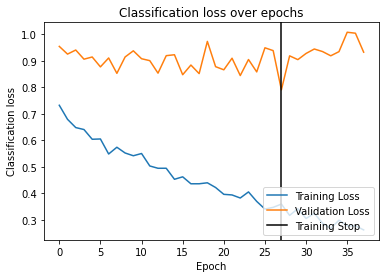

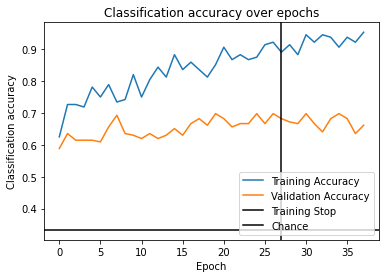

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8238 - acc: 0.5703 - val_loss: 0.9047 - val_acc: 0.6406
Epoch 2/50 0.237s 	 loss: 0.7313 - acc: 0.7188 - val_loss: 0.9080 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.232s 	 loss: 0.6724 - acc: 0.6953 - val_loss: 0.8560 - val_acc: 0.6354
Epoch 4/50 0.236s 	 loss: 0.6687 - acc: 0.6875 - val_loss: 0.9782 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.232s 	 loss: 0.6416 - acc: 0.6953 - val_loss: 0.9170 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.232s 	 loss: 0.6329 - acc: 0.6797 - val_loss: 0.9223 - val_acc: 0.6198
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.6118 - acc: 0.7266 - val_loss: 0.8930 - val_acc: 0.5833
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.238s 	 loss: 0.5598 - acc: 0.7578 - val_loss: 0.8832 - val_acc: 0.6562
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.236s 	 loss: 0.5209 - acc: 0.79

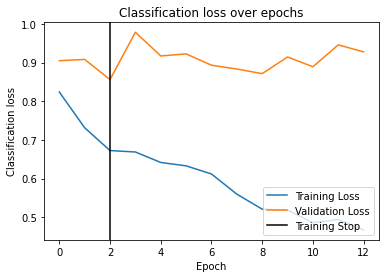

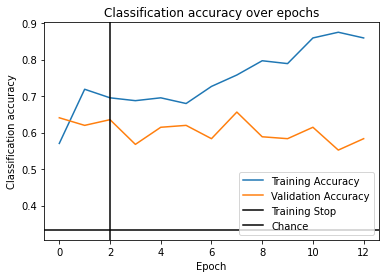

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8450 - acc: 0.5938 - val_loss: 0.7427 - val_acc: 0.6458
Epoch 2/50 0.232s 	 loss: 0.7929 - acc: 0.6719 - val_loss: 0.7487 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.234s 	 loss: 0.7427 - acc: 0.6875 - val_loss: 0.7198 - val_acc: 0.6510
Epoch 4/50 0.239s 	 loss: 0.6839 - acc: 0.6875 - val_loss: 0.7346 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.6960 - acc: 0.6641 - val_loss: 0.8043 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.6732 - acc: 0.7188 - val_loss: 0.6927 - val_acc: 0.6406
Epoch 7/50 0.232s 	 loss: 0.6268 - acc: 0.7344 - val_loss: 0.7133 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.240s 	 loss: 0.5995 - acc: 0.7266 - val_loss: 0.7416 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.5904 - acc: 0.7344 - val_loss: 0.7431 - val_acc: 0.

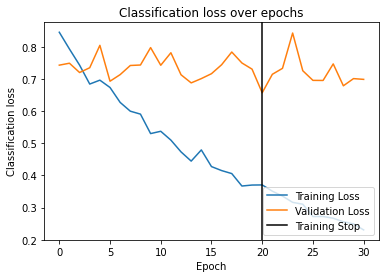

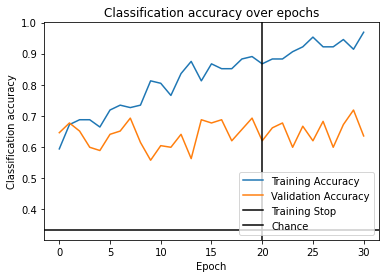

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9084 - acc: 0.5859 - val_loss: 0.7342 - val_acc: 0.7188
Epoch 2/50 0.239s 	 loss: 0.8559 - acc: 0.6250 - val_loss: 0.7865 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7425 - acc: 0.6719 - val_loss: 0.7789 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.244s 	 loss: 0.7416 - acc: 0.6484 - val_loss: 0.7881 - val_acc: 0.6406
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.237s 	 loss: 0.6683 - acc: 0.7031 - val_loss: 0.7909 - val_acc: 0.5573
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.238s 	 loss: 0.6640 - acc: 0.6797 - val_loss: 0.7793 - val_acc: 0.6354
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.239s 	 loss: 0.6465 - acc: 0.7266 - val_loss: 0.7464 - val_acc: 0.6094
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.248s 	 loss: 0.6031 - acc: 0.7188 - val_loss: 0.7808 - val_acc: 0.6771
EarlyStopping counter: 7 out of 10
Epoch 9/5

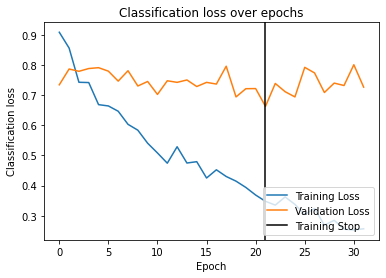

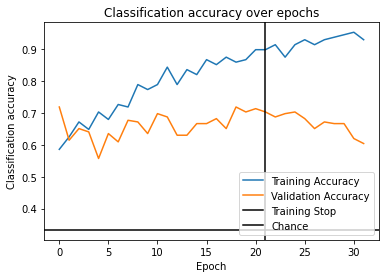

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8581 - acc: 0.6094 - val_loss: 0.5874 - val_acc: 0.7865
Epoch 2/50 0.237s 	 loss: 0.7904 - acc: 0.5938 - val_loss: 0.6298 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.7605 - acc: 0.6719 - val_loss: 0.5763 - val_acc: 0.7917
Epoch 4/50 0.238s 	 loss: 0.7138 - acc: 0.6719 - val_loss: 0.6375 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.6934 - acc: 0.6875 - val_loss: 0.6452 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.239s 	 loss: 0.6691 - acc: 0.6562 - val_loss: 0.6692 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.6644 - acc: 0.7188 - val_loss: 0.6820 - val_acc: 0.7083
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.241s 	 loss: 0.6663 - acc: 0.7188 - val_loss: 0.7056 - val_acc: 0.7448
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.240s 	 loss: 0.5991 - acc: 0.70

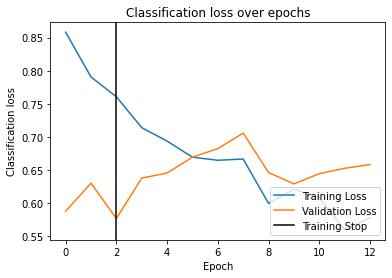

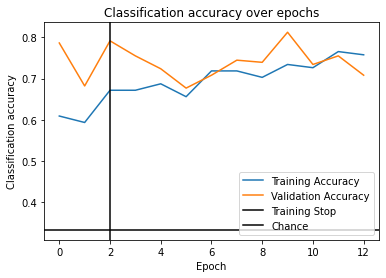

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.6940 - acc: 0.6953 - val_loss: 0.8996 - val_acc: 0.5729
Epoch 2/50 0.233s 	 loss: 0.6288 - acc: 0.7188 - val_loss: 0.8477 - val_acc: 0.5677
Epoch 3/50 0.234s 	 loss: 0.6095 - acc: 0.7734 - val_loss: 0.9195 - val_acc: 0.5104
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.6263 - acc: 0.7266 - val_loss: 0.9679 - val_acc: 0.5208
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.5811 - acc: 0.7891 - val_loss: 0.9562 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.239s 	 loss: 0.5300 - acc: 0.7734 - val_loss: 0.9742 - val_acc: 0.5885
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.240s 	 loss: 0.5178 - acc: 0.7578 - val_loss: 0.9384 - val_acc: 0.5469
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.236s 	 loss: 0.4792 - acc: 0.8281 - val_loss: 0.9365 - val_acc: 0.5781
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.236s 	 loss: 0.4762 - acc: 0.82

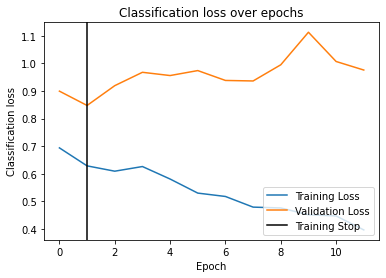

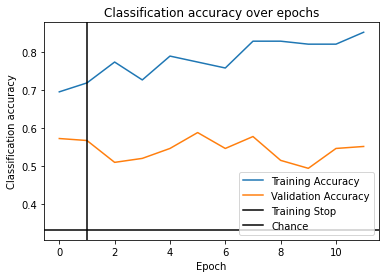

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.7053 - acc: 0.6797 - val_loss: 0.9419 - val_acc: 0.6042
Epoch 2/50 0.235s 	 loss: 0.6712 - acc: 0.7500 - val_loss: 0.8660 - val_acc: 0.6927
Epoch 3/50 0.237s 	 loss: 0.6331 - acc: 0.7188 - val_loss: 0.9522 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.6105 - acc: 0.7500 - val_loss: 0.8158 - val_acc: 0.6667
Epoch 5/50 0.235s 	 loss: 0.6093 - acc: 0.7422 - val_loss: 0.8565 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.6148 - acc: 0.7422 - val_loss: 0.9135 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.248s 	 loss: 0.5302 - acc: 0.7812 - val_loss: 0.8357 - val_acc: 0.6198
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.5349 - acc: 0.7812 - val_loss: 0.8691 - val_acc: 0.6406
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.239s 	 loss: 0.4994 - acc: 0.8281 - val_loss: 0.8359 - val_acc: 0.

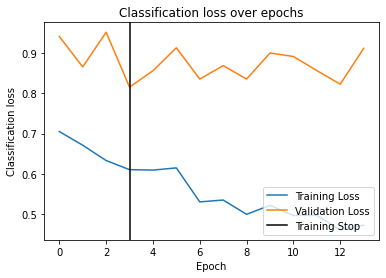

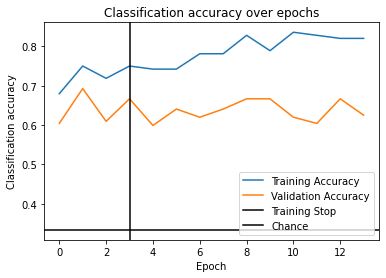

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.7355 - acc: 0.7500 - val_loss: 0.7835 - val_acc: 0.6875
Epoch 2/50 0.238s 	 loss: 0.6606 - acc: 0.7422 - val_loss: 0.7155 - val_acc: 0.7396
Epoch 3/50 0.237s 	 loss: 0.5860 - acc: 0.7812 - val_loss: 0.7270 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.242s 	 loss: 0.5216 - acc: 0.8203 - val_loss: 0.7673 - val_acc: 0.7448
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.240s 	 loss: 0.5287 - acc: 0.7891 - val_loss: 0.7134 - val_acc: 0.7135
Epoch 6/50 0.234s 	 loss: 0.5118 - acc: 0.7969 - val_loss: 0.7624 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.4831 - acc: 0.7891 - val_loss: 0.7595 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.253s 	 loss: 0.4369 - acc: 0.8359 - val_loss: 0.7012 - val_acc: 0.7760
Epoch 9/50 0.241s 	 loss: 0.4174 - acc: 0.8047 - val_loss: 0.7107 - val_acc: 0.7135
EarlyStopping counter: 1 out o

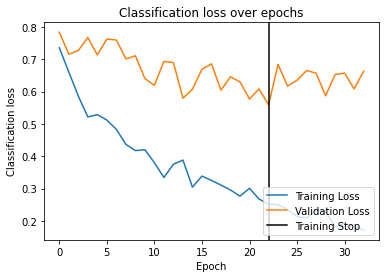

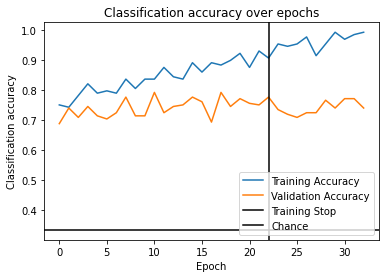

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8436 - acc: 0.7266 - val_loss: 0.5796 - val_acc: 0.7500
Epoch 2/50 0.240s 	 loss: 0.7825 - acc: 0.7266 - val_loss: 0.5147 - val_acc: 0.8021
Epoch 3/50 0.237s 	 loss: 0.6942 - acc: 0.7109 - val_loss: 0.5205 - val_acc: 0.8177
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.242s 	 loss: 0.6411 - acc: 0.7656 - val_loss: 0.4955 - val_acc: 0.7969
Epoch 5/50 0.233s 	 loss: 0.6066 - acc: 0.7812 - val_loss: 0.4693 - val_acc: 0.7865
Epoch 6/50 0.238s 	 loss: 0.5805 - acc: 0.7734 - val_loss: 0.5172 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.5722 - acc: 0.7969 - val_loss: 0.4699 - val_acc: 0.8177
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.248s 	 loss: 0.4676 - acc: 0.8203 - val_loss: 0.4887 - val_acc: 0.7969
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.239s 	 loss: 0.4647 - acc: 0.8359 - val_loss: 0.4565 - val_acc: 0.8177
Epoch 10/50 0.238s 	 loss: 0.4

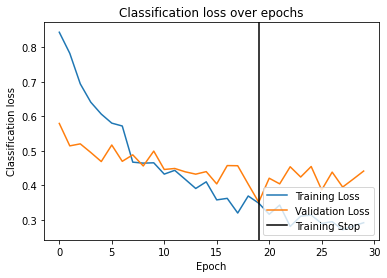

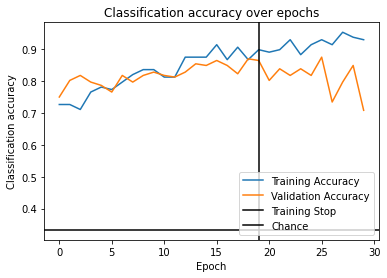

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.6305 - acc: 0.7812 - val_loss: 0.8480 - val_acc: 0.6042
Epoch 2/50 0.234s 	 loss: 0.6390 - acc: 0.7812 - val_loss: 0.8023 - val_acc: 0.6667
Epoch 3/50 0.249s 	 loss: 0.5583 - acc: 0.8203 - val_loss: 0.7796 - val_acc: 0.7031
Epoch 4/50 0.235s 	 loss: 0.4931 - acc: 0.8438 - val_loss: 0.6797 - val_acc: 0.6979
Epoch 5/50 0.237s 	 loss: 0.4475 - acc: 0.8438 - val_loss: 0.7224 - val_acc: 0.6927
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.241s 	 loss: 0.4309 - acc: 0.8672 - val_loss: 0.7176 - val_acc: 0.7031
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.4176 - acc: 0.8750 - val_loss: 0.7181 - val_acc: 0.7396
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.4202 - acc: 0.8828 - val_loss: 0.6164 - val_acc: 0.7188
Epoch 9/50 0.232s 	 loss: 0.3733 - acc: 0.8906 - val_loss: 0.6355 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.238s 	 loss: 0.3

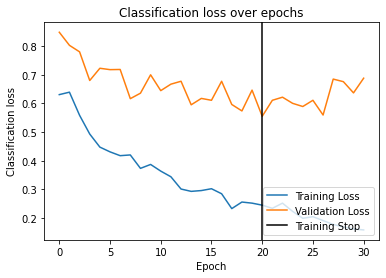

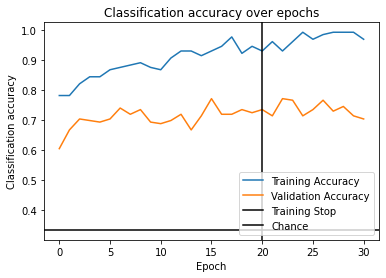

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8736 - acc: 0.5938 - val_loss: 0.9538 - val_acc: 0.4792
Epoch 2/50 0.233s 	 loss: 0.8370 - acc: 0.6406 - val_loss: 0.9307 - val_acc: 0.5573
Epoch 3/50 0.233s 	 loss: 0.7517 - acc: 0.6016 - val_loss: 0.8812 - val_acc: 0.6354
Epoch 4/50 0.237s 	 loss: 0.7186 - acc: 0.7266 - val_loss: 0.9177 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.237s 	 loss: 0.6607 - acc: 0.7188 - val_loss: 0.8670 - val_acc: 0.5729
Epoch 6/50 0.236s 	 loss: 0.6146 - acc: 0.7891 - val_loss: 0.8460 - val_acc: 0.6302
Epoch 7/50 0.238s 	 loss: 0.6462 - acc: 0.7578 - val_loss: 0.8884 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.237s 	 loss: 0.5555 - acc: 0.7969 - val_loss: 0.8336 - val_acc: 0.5000
Epoch 9/50 0.236s 	 loss: 0.5437 - acc: 0.8047 - val_loss: 0.8612 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.5295 - acc: 0.8125 - val_loss: 0.832

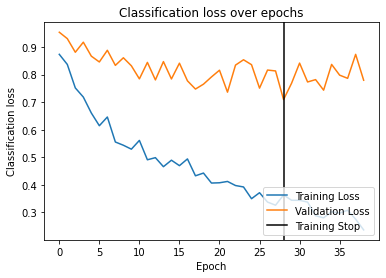

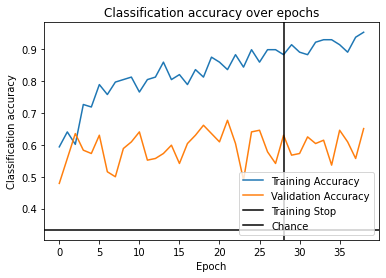

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9755 - acc: 0.5078 - val_loss: 0.9477 - val_acc: 0.5781
Epoch 2/50 0.235s 	 loss: 0.8745 - acc: 0.6250 - val_loss: 0.8961 - val_acc: 0.5573
Epoch 3/50 0.236s 	 loss: 0.7496 - acc: 0.6953 - val_loss: 0.9101 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.7808 - acc: 0.6719 - val_loss: 0.7510 - val_acc: 0.6146
Epoch 5/50 0.232s 	 loss: 0.6972 - acc: 0.6875 - val_loss: 0.7939 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.7108 - acc: 0.6719 - val_loss: 0.7800 - val_acc: 0.5833
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.234s 	 loss: 0.6602 - acc: 0.7266 - val_loss: 0.7825 - val_acc: 0.5781
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.6260 - acc: 0.7344 - val_loss: 0.7182 - val_acc: 0.6979
Epoch 9/50 0.230s 	 loss: 0.6205 - acc: 0.7891 - val_loss: 0.7655 - val_acc: 0.5677
EarlyStopping counter: 1 out o

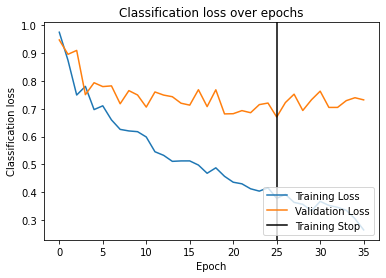

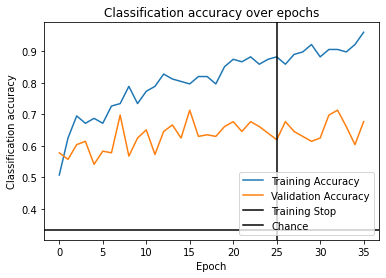

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.9278 - acc: 0.5234 - val_loss: 0.8615 - val_acc: 0.6302
Epoch 2/50 0.244s 	 loss: 0.8209 - acc: 0.6172 - val_loss: 0.8092 - val_acc: 0.6094
Epoch 3/50 0.234s 	 loss: 0.7782 - acc: 0.6172 - val_loss: 0.7969 - val_acc: 0.6667
Epoch 4/50 0.235s 	 loss: 0.7231 - acc: 0.6484 - val_loss: 0.7470 - val_acc: 0.6927
Epoch 5/50 0.233s 	 loss: 0.7143 - acc: 0.6875 - val_loss: 0.7648 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.6642 - acc: 0.6797 - val_loss: 0.7083 - val_acc: 0.7188
Epoch 7/50 0.233s 	 loss: 0.6198 - acc: 0.7109 - val_loss: 0.7278 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.236s 	 loss: 0.6071 - acc: 0.7031 - val_loss: 0.7311 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.241s 	 loss: 0.5990 - acc: 0.7188 - val_loss: 0.7111 - val_acc: 0.6979
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.258s 	 loss: 0.5

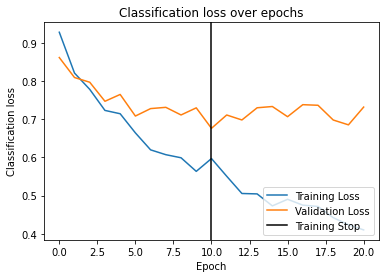

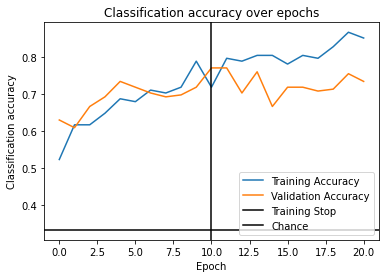

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8585 - acc: 0.6250 - val_loss: 0.9104 - val_acc: 0.5833
Epoch 2/50 0.234s 	 loss: 0.7773 - acc: 0.6094 - val_loss: 0.8493 - val_acc: 0.6250
Epoch 3/50 0.242s 	 loss: 0.6899 - acc: 0.6797 - val_loss: 0.7683 - val_acc: 0.7188
Epoch 4/50 0.237s 	 loss: 0.6384 - acc: 0.7344 - val_loss: 0.6765 - val_acc: 0.6979
Epoch 5/50 0.232s 	 loss: 0.5686 - acc: 0.7734 - val_loss: 0.6367 - val_acc: 0.7500
Epoch 6/50 0.232s 	 loss: 0.5009 - acc: 0.8203 - val_loss: 0.6234 - val_acc: 0.7812
Epoch 7/50 0.239s 	 loss: 0.5198 - acc: 0.8203 - val_loss: 0.6191 - val_acc: 0.6927
Epoch 8/50 0.234s 	 loss: 0.4916 - acc: 0.8281 - val_loss: 0.6434 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.4243 - acc: 0.8516 - val_loss: 0.6241 - val_acc: 0.7917
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.238s 	 loss: 0.4100 - acc: 0.8672 - val_loss: 0.6505 - val_acc: 0.7812
EarlyStopping c

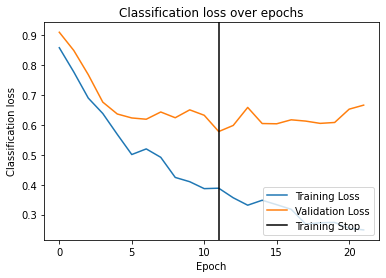

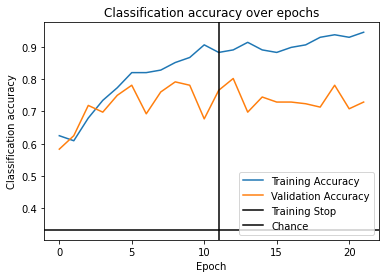

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.9734 - acc: 0.5781 - val_loss: 0.6495 - val_acc: 0.6719
Epoch 2/50 0.235s 	 loss: 0.8111 - acc: 0.6562 - val_loss: 0.6428 - val_acc: 0.7188
Epoch 3/50 0.236s 	 loss: 0.7454 - acc: 0.6797 - val_loss: 0.5862 - val_acc: 0.7396
Epoch 4/50 0.237s 	 loss: 0.7118 - acc: 0.6953 - val_loss: 0.5893 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.247s 	 loss: 0.6409 - acc: 0.7188 - val_loss: 0.5415 - val_acc: 0.7865
Epoch 6/50 0.238s 	 loss: 0.5516 - acc: 0.8125 - val_loss: 0.5248 - val_acc: 0.6875
Epoch 7/50 0.231s 	 loss: 0.5839 - acc: 0.7422 - val_loss: 0.5042 - val_acc: 0.7760
Epoch 8/50 0.239s 	 loss: 0.5408 - acc: 0.7812 - val_loss: 0.5235 - val_acc: 0.7917
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.238s 	 loss: 0.4898 - acc: 0.8438 - val_loss: 0.5277 - val_acc: 0.8073
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.236s 	 loss: 0.5101 - acc: 0.8359 - val_loss: 0.494

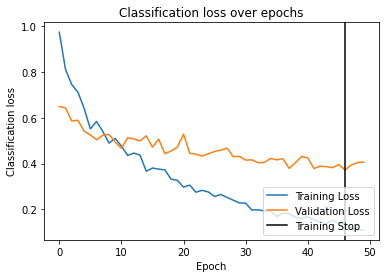

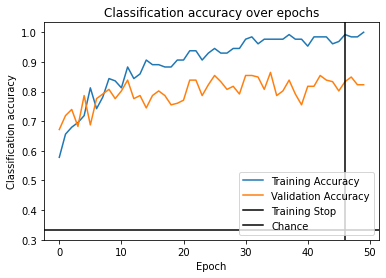

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.8985 - acc: 0.5938 - val_loss: 1.0146 - val_acc: 0.5469
Epoch 2/50 0.241s 	 loss: 0.7292 - acc: 0.7109 - val_loss: 0.9093 - val_acc: 0.5729
Epoch 3/50 0.232s 	 loss: 0.6209 - acc: 0.7812 - val_loss: 0.9322 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.233s 	 loss: 0.5756 - acc: 0.7812 - val_loss: 0.9076 - val_acc: 0.5833
Epoch 5/50 0.233s 	 loss: 0.5256 - acc: 0.8203 - val_loss: 0.8273 - val_acc: 0.6927
Epoch 6/50 0.233s 	 loss: 0.4704 - acc: 0.8438 - val_loss: 0.8791 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.4863 - acc: 0.8203 - val_loss: 0.8381 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.4316 - acc: 0.8203 - val_loss: 0.8004 - val_acc: 0.6354
Epoch 9/50 0.233s 	 loss: 0.4028 - acc: 0.8906 - val_loss: 0.8062 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.3

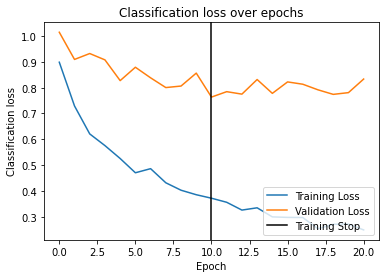

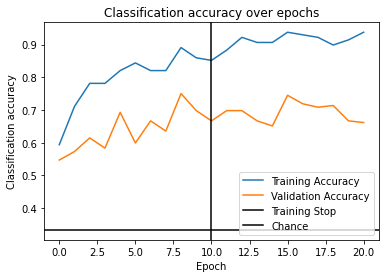

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7655 - acc: 0.6562 - val_loss: 0.7354 - val_acc: 0.7292
Epoch 2/50 0.233s 	 loss: 0.6629 - acc: 0.7031 - val_loss: 0.7935 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.6187 - acc: 0.7266 - val_loss: 0.7408 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.5560 - acc: 0.7656 - val_loss: 0.8955 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.244s 	 loss: 0.5132 - acc: 0.7812 - val_loss: 0.8403 - val_acc: 0.6771
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.241s 	 loss: 0.4961 - acc: 0.8281 - val_loss: 0.8544 - val_acc: 0.5833
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.238s 	 loss: 0.4666 - acc: 0.8438 - val_loss: 0.7557 - val_acc: 0.6250
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.238s 	 loss: 0.4233 - acc: 0.8281 - val_loss: 0.7964 - val_acc: 0.6979
EarlyStopping counter: 7 out of 10
Epoch 9/5

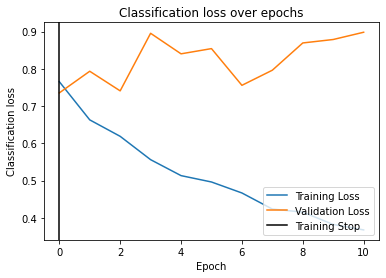

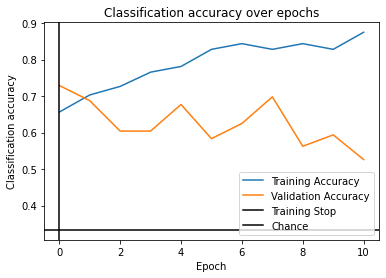

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.7867 - acc: 0.6406 - val_loss: 0.8341 - val_acc: 0.6094
Epoch 2/50 0.239s 	 loss: 0.6135 - acc: 0.7266 - val_loss: 0.8101 - val_acc: 0.6198
Epoch 3/50 0.233s 	 loss: 0.6263 - acc: 0.7734 - val_loss: 0.7862 - val_acc: 0.6562
Epoch 4/50 0.236s 	 loss: 0.5623 - acc: 0.8047 - val_loss: 0.7636 - val_acc: 0.6458
Epoch 5/50 0.235s 	 loss: 0.5586 - acc: 0.7812 - val_loss: 0.6655 - val_acc: 0.7083
Epoch 6/50 0.234s 	 loss: 0.5254 - acc: 0.8047 - val_loss: 0.7268 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.5043 - acc: 0.8125 - val_loss: 0.6918 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.238s 	 loss: 0.4933 - acc: 0.8125 - val_loss: 0.6595 - val_acc: 0.6615
Epoch 9/50 0.241s 	 loss: 0.4657 - acc: 0.8047 - val_loss: 0.6730 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.243s 	 loss: 0.4364 - acc: 0.8438 - val_loss: 0.666

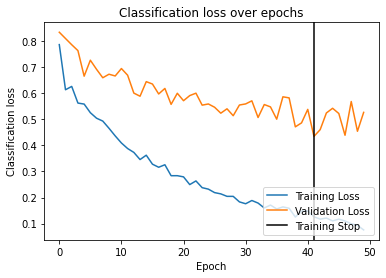

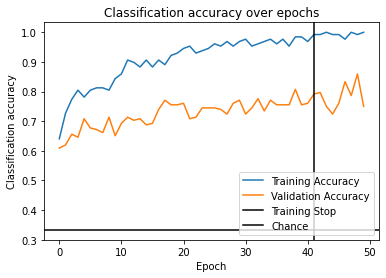

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8126 - acc: 0.6250 - val_loss: 0.7217 - val_acc: 0.6979
Epoch 2/50 0.238s 	 loss: 0.6977 - acc: 0.6641 - val_loss: 0.7146 - val_acc: 0.6823
Epoch 3/50 0.234s 	 loss: 0.6627 - acc: 0.7031 - val_loss: 0.6995 - val_acc: 0.6771
Epoch 4/50 0.257s 	 loss: 0.6812 - acc: 0.6953 - val_loss: 0.6833 - val_acc: 0.7292
Epoch 5/50 0.244s 	 loss: 0.5846 - acc: 0.7422 - val_loss: 0.7593 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.233s 	 loss: 0.5748 - acc: 0.7812 - val_loss: 0.6975 - val_acc: 0.6771
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.235s 	 loss: 0.5226 - acc: 0.7656 - val_loss: 0.7481 - val_acc: 0.6406
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.233s 	 loss: 0.4864 - acc: 0.7969 - val_loss: 0.7047 - val_acc: 0.6510
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.235s 	 loss: 0.4771 - acc: 0.8203 - val_loss: 0.7135 - val_acc: 0.7188
EarlyStopping counter: 5 out o

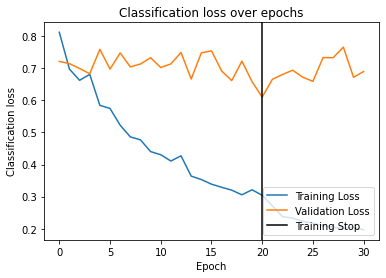

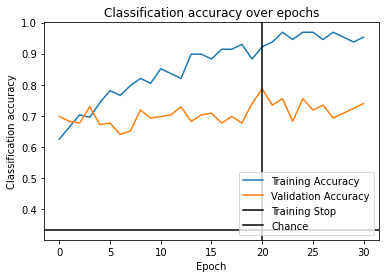

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.251s 	 loss: 0.9357 - acc: 0.5547 - val_loss: 0.7840 - val_acc: 0.6198
Epoch 2/50 0.235s 	 loss: 0.8600 - acc: 0.5469 - val_loss: 0.7878 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.238s 	 loss: 0.7839 - acc: 0.6328 - val_loss: 0.7714 - val_acc: 0.7135
Epoch 4/50 0.239s 	 loss: 0.7668 - acc: 0.6250 - val_loss: 0.7718 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.7445 - acc: 0.6641 - val_loss: 0.7474 - val_acc: 0.6927
Epoch 6/50 0.233s 	 loss: 0.7216 - acc: 0.6953 - val_loss: 0.8426 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.236s 	 loss: 0.6391 - acc: 0.7422 - val_loss: 0.7654 - val_acc: 0.6875
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.238s 	 loss: 0.5719 - acc: 0.8047 - val_loss: 0.7788 - val_acc: 0.6667
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.236s 	 loss: 0.5935 - acc: 0.7500 - val_loss: 0.7562 - val_acc: 0.

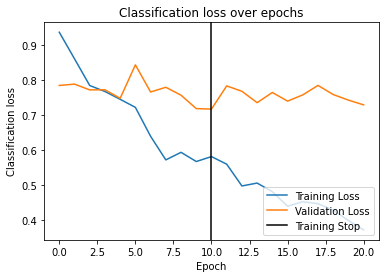

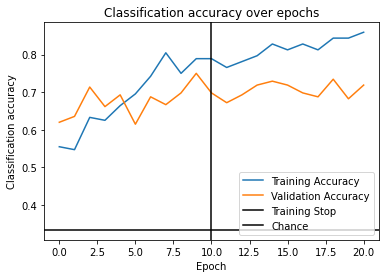

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9052 - acc: 0.5391 - val_loss: 1.1216 - val_acc: 0.4792
Epoch 2/50 0.240s 	 loss: 0.7764 - acc: 0.7031 - val_loss: 1.0196 - val_acc: 0.5417
Epoch 3/50 0.235s 	 loss: 0.7424 - acc: 0.6797 - val_loss: 0.9594 - val_acc: 0.5781
Epoch 4/50 0.232s 	 loss: 0.6606 - acc: 0.7422 - val_loss: 0.9541 - val_acc: 0.5469
Epoch 5/50 0.234s 	 loss: 0.6479 - acc: 0.7656 - val_loss: 0.9727 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.251s 	 loss: 0.6034 - acc: 0.7578 - val_loss: 0.9496 - val_acc: 0.5938
Epoch 7/50 0.237s 	 loss: 0.5972 - acc: 0.7812 - val_loss: 0.9946 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.5408 - acc: 0.7734 - val_loss: 0.9242 - val_acc: 0.6094
Epoch 9/50 0.235s 	 loss: 0.5510 - acc: 0.7812 - val_loss: 0.9427 - val_acc: 0.5417
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.237s 	 loss: 0.5203 - acc: 0.8203 - val_loss: 0.977

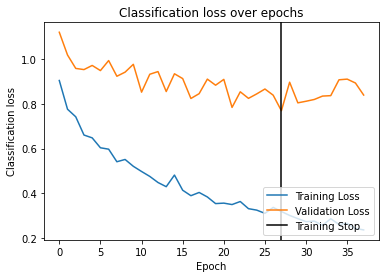

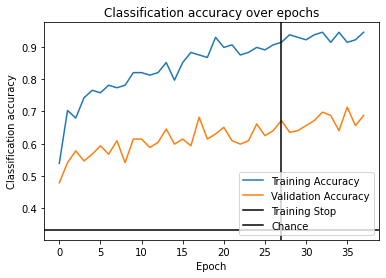

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.9014 - acc: 0.6250 - val_loss: 0.8424 - val_acc: 0.5417
Epoch 2/50 0.234s 	 loss: 0.8785 - acc: 0.5781 - val_loss: 0.8263 - val_acc: 0.6042
Epoch 3/50 0.240s 	 loss: 0.8296 - acc: 0.6406 - val_loss: 0.7128 - val_acc: 0.7188
Epoch 4/50 0.238s 	 loss: 0.7642 - acc: 0.7109 - val_loss: 0.7335 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.7505 - acc: 0.6641 - val_loss: 0.7115 - val_acc: 0.7240
Epoch 6/50 0.238s 	 loss: 0.7133 - acc: 0.7266 - val_loss: 0.6826 - val_acc: 0.7552
Epoch 7/50 0.235s 	 loss: 0.6749 - acc: 0.7344 - val_loss: 0.7127 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.6792 - acc: 0.7188 - val_loss: 0.6862 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.239s 	 loss: 0.6305 - acc: 0.7578 - val_loss: 0.7193 - val_acc: 0.6771
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.234s 	 loss: 0.6

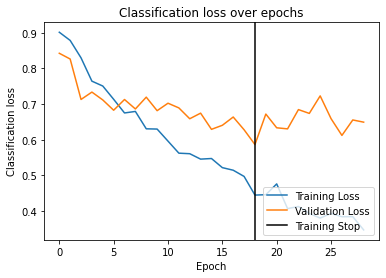

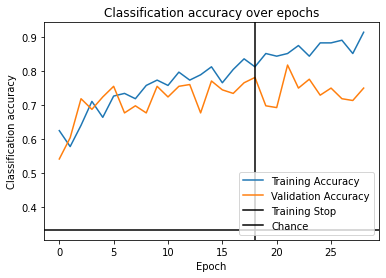

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 0.9899 - acc: 0.6250 - val_loss: 0.5673 - val_acc: 0.7708
Epoch 2/50 0.233s 	 loss: 0.9193 - acc: 0.6484 - val_loss: 0.5818 - val_acc: 0.7865
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.8346 - acc: 0.6328 - val_loss: 0.5588 - val_acc: 0.7812
Epoch 4/50 0.241s 	 loss: 0.8022 - acc: 0.7031 - val_loss: 0.5311 - val_acc: 0.7865
Epoch 5/50 0.232s 	 loss: 0.7375 - acc: 0.6953 - val_loss: 0.5570 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.6706 - acc: 0.7344 - val_loss: 0.5861 - val_acc: 0.7708
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.239s 	 loss: 0.7064 - acc: 0.7344 - val_loss: 0.5513 - val_acc: 0.8229
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.6453 - acc: 0.7500 - val_loss: 0.6103 - val_acc: 0.7188
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.234s 	 loss: 0.6471 - acc: 0.7266 - val_loss: 0.5705 - val_acc: 0.

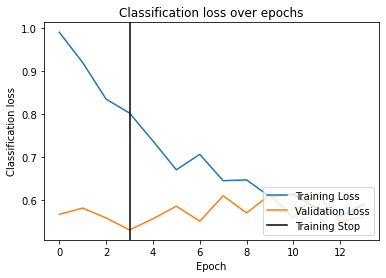

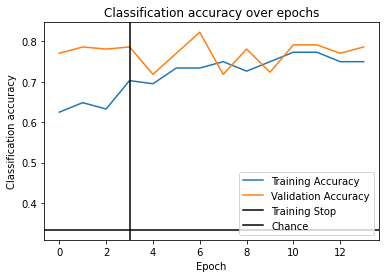

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7818 - acc: 0.6953 - val_loss: 1.1303 - val_acc: 0.5521
Epoch 2/50 0.235s 	 loss: 0.6638 - acc: 0.7188 - val_loss: 1.0619 - val_acc: 0.5833
Epoch 3/50 0.234s 	 loss: 0.6059 - acc: 0.7578 - val_loss: 0.9758 - val_acc: 0.6562
Epoch 4/50 0.239s 	 loss: 0.5951 - acc: 0.7578 - val_loss: 0.9613 - val_acc: 0.6458
Epoch 5/50 0.242s 	 loss: 0.5290 - acc: 0.7812 - val_loss: 1.0374 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.244s 	 loss: 0.4931 - acc: 0.8359 - val_loss: 1.0461 - val_acc: 0.5469
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.248s 	 loss: 0.4857 - acc: 0.8359 - val_loss: 1.0334 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.237s 	 loss: 0.4947 - acc: 0.8438 - val_loss: 0.9825 - val_acc: 0.5781
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.233s 	 loss: 0.4503 - acc: 0.8281 - val_loss: 1.0077 - val_acc: 0.5677
EarlyStopping counter: 5 out o

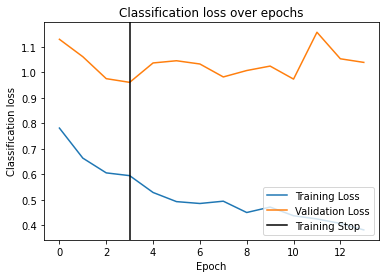

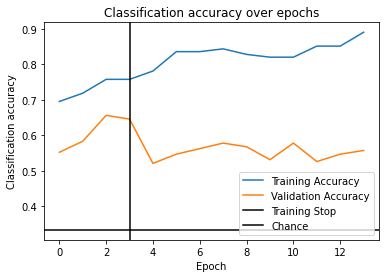

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.239s 	 loss: 0.8704 - acc: 0.6562 - val_loss: 0.8636 - val_acc: 0.6042
Epoch 2/50 0.235s 	 loss: 0.7868 - acc: 0.6719 - val_loss: 0.7634 - val_acc: 0.6875
Epoch 3/50 0.236s 	 loss: 0.7370 - acc: 0.7031 - val_loss: 0.7890 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.6908 - acc: 0.6953 - val_loss: 0.7937 - val_acc: 0.6927
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.240s 	 loss: 0.6318 - acc: 0.7578 - val_loss: 0.7305 - val_acc: 0.6875
Epoch 6/50 0.234s 	 loss: 0.6550 - acc: 0.7031 - val_loss: 0.8334 - val_acc: 0.6458
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.239s 	 loss: 0.5962 - acc: 0.7578 - val_loss: 0.7807 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.6055 - acc: 0.7812 - val_loss: 0.7781 - val_acc: 0.6302
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.237s 	 loss: 0.6217 - acc: 0.7969 - val_loss: 0.8124 - val_acc: 0.

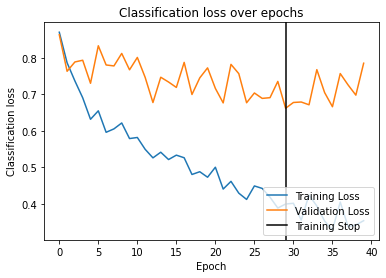

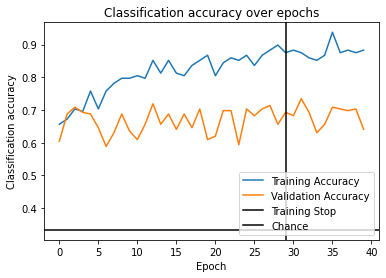

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1671 - acc: 0.5234 - val_loss: 0.6192 - val_acc: 0.7135
Epoch 2/50 0.238s 	 loss: 1.0482 - acc: 0.5234 - val_loss: 0.5712 - val_acc: 0.7292
Epoch 3/50 0.236s 	 loss: 0.9956 - acc: 0.6172 - val_loss: 0.5806 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.252s 	 loss: 0.9618 - acc: 0.6016 - val_loss: 0.6607 - val_acc: 0.6823
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.243s 	 loss: 0.8999 - acc: 0.6016 - val_loss: 0.6531 - val_acc: 0.7448
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.8943 - acc: 0.6094 - val_loss: 0.6147 - val_acc: 0.7188
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.239s 	 loss: 0.8602 - acc: 0.6641 - val_loss: 0.7418 - val_acc: 0.5885
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.237s 	 loss: 0.8022 - acc: 0.6797 - val_loss: 0.7092 - val_acc: 0.6354
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.240s 	 loss: 0.8016 - acc: 0.67

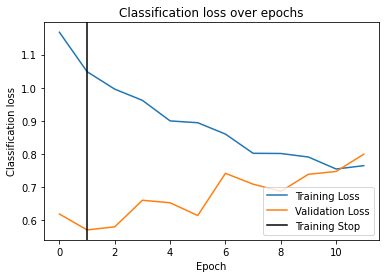

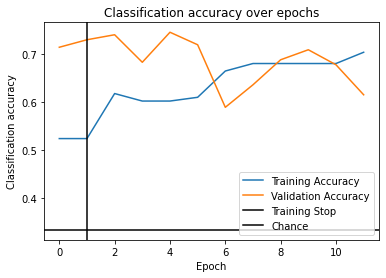

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.9726 - acc: 0.5625 - val_loss: 1.0236 - val_acc: 0.5677
Epoch 2/50 0.235s 	 loss: 0.9634 - acc: 0.5547 - val_loss: 0.9581 - val_acc: 0.6302
Epoch 3/50 0.237s 	 loss: 0.9040 - acc: 0.6016 - val_loss: 0.9751 - val_acc: 0.6198
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.8235 - acc: 0.6641 - val_loss: 0.9125 - val_acc: 0.6094
Epoch 5/50 0.234s 	 loss: 0.7905 - acc: 0.6641 - val_loss: 0.9609 - val_acc: 0.5781
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.7987 - acc: 0.6562 - val_loss: 0.9000 - val_acc: 0.6198
Epoch 7/50 0.234s 	 loss: 0.7747 - acc: 0.6875 - val_loss: 0.9731 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.243s 	 loss: 0.7859 - acc: 0.6797 - val_loss: 0.9397 - val_acc: 0.6146
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.7374 - acc: 0.7188 - val_loss: 0.9061 - val_acc: 0.6146
EarlyStopping counter: 3 out o

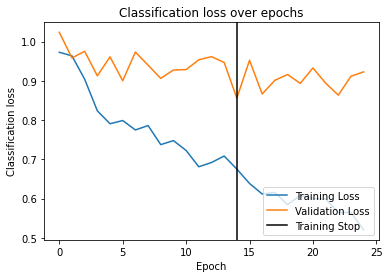

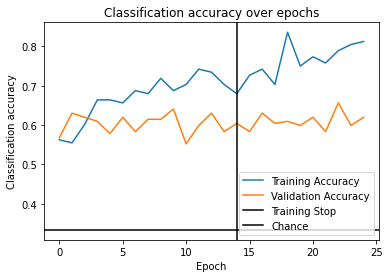

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.255s 	 loss: 0.8024 - acc: 0.6719 - val_loss: 1.3410 - val_acc: 0.4583
Epoch 2/50 0.237s 	 loss: 0.7564 - acc: 0.6953 - val_loss: 1.3309 - val_acc: 0.4792
Epoch 3/50 0.235s 	 loss: 0.6505 - acc: 0.7891 - val_loss: 1.3983 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.6193 - acc: 0.7891 - val_loss: 1.2919 - val_acc: 0.5365
Epoch 5/50 0.241s 	 loss: 0.5727 - acc: 0.7812 - val_loss: 1.3204 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.235s 	 loss: 0.5857 - acc: 0.7891 - val_loss: 1.3622 - val_acc: 0.4375
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.5432 - acc: 0.8359 - val_loss: 1.2980 - val_acc: 0.5156
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.234s 	 loss: 0.5555 - acc: 0.8281 - val_loss: 1.2843 - val_acc: 0.5000
Epoch 9/50 0.239s 	 loss: 0.5280 - acc: 0.8125 - val_loss: 1.2258 - val_acc: 0.5521
Epoch 10/50 0.241s 	 loss: 0.5

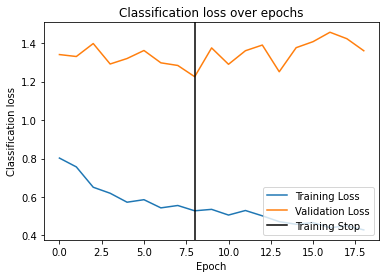

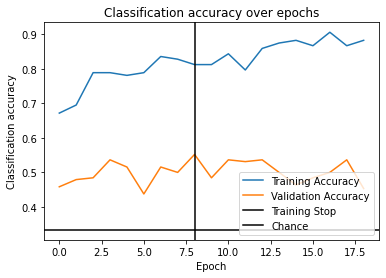

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 1.0953 - acc: 0.4844 - val_loss: 0.9211 - val_acc: 0.6354
Epoch 2/50 0.240s 	 loss: 1.0034 - acc: 0.5312 - val_loss: 1.0545 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.9243 - acc: 0.5625 - val_loss: 1.0039 - val_acc: 0.5990
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.234s 	 loss: 0.9267 - acc: 0.5625 - val_loss: 0.9521 - val_acc: 0.5833
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.237s 	 loss: 0.8364 - acc: 0.6641 - val_loss: 1.0353 - val_acc: 0.5833
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.234s 	 loss: 0.8403 - acc: 0.6250 - val_loss: 1.0485 - val_acc: 0.5365
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.256s 	 loss: 0.8219 - acc: 0.5938 - val_loss: 1.0680 - val_acc: 0.5469
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.237s 	 loss: 0.8028 - acc: 0.6094 - val_loss: 1.0746 - val_acc: 0.5625
EarlyStopping counter: 7 out of 10
Epoch 9/5

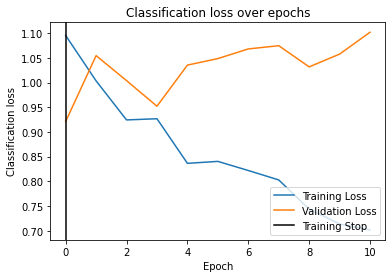

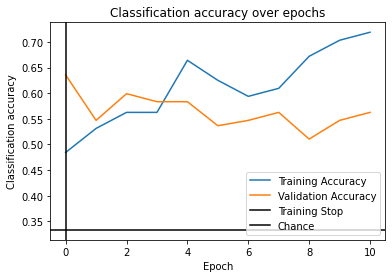

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 1.0184 - acc: 0.5312 - val_loss: 1.1594 - val_acc: 0.4688
Epoch 2/50 0.237s 	 loss: 0.9906 - acc: 0.5391 - val_loss: 1.1005 - val_acc: 0.4844
Epoch 3/50 0.234s 	 loss: 0.9037 - acc: 0.6094 - val_loss: 1.0597 - val_acc: 0.5208
Epoch 4/50 0.237s 	 loss: 0.8981 - acc: 0.5938 - val_loss: 1.0308 - val_acc: 0.5000
Epoch 5/50 0.237s 	 loss: 0.8937 - acc: 0.5781 - val_loss: 1.0336 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.8152 - acc: 0.6250 - val_loss: 1.0273 - val_acc: 0.4635
Epoch 7/50 0.237s 	 loss: 0.8070 - acc: 0.6406 - val_loss: 0.9940 - val_acc: 0.5208
Epoch 8/50 0.233s 	 loss: 0.8312 - acc: 0.5859 - val_loss: 0.9671 - val_acc: 0.5469
Epoch 9/50 0.238s 	 loss: 0.8000 - acc: 0.5781 - val_loss: 1.0229 - val_acc: 0.5365
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.7791 - acc: 0.6172 - val_loss: 0.9876 - val_acc: 0.5365
EarlyStopping c

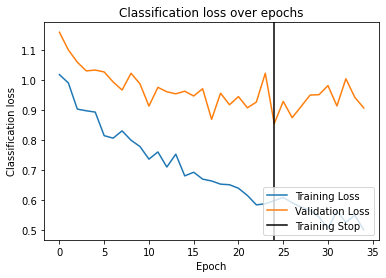

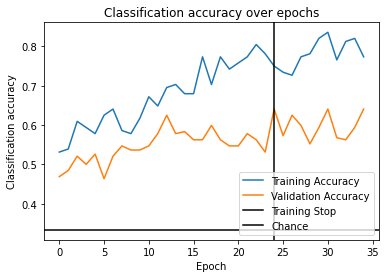

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 1.0644 - acc: 0.5781 - val_loss: 1.0382 - val_acc: 0.5052
Epoch 2/50 0.235s 	 loss: 0.9288 - acc: 0.6094 - val_loss: 1.0844 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.9624 - acc: 0.5781 - val_loss: 1.0301 - val_acc: 0.4740
Epoch 4/50 0.242s 	 loss: 0.9050 - acc: 0.6172 - val_loss: 1.0622 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.242s 	 loss: 0.9091 - acc: 0.5859 - val_loss: 0.9967 - val_acc: 0.5208
Epoch 6/50 0.235s 	 loss: 0.8027 - acc: 0.6484 - val_loss: 1.0802 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.8073 - acc: 0.6328 - val_loss: 0.9990 - val_acc: 0.4896
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.239s 	 loss: 0.7766 - acc: 0.7109 - val_loss: 1.0501 - val_acc: 0.5156
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.243s 	 loss: 0.7395 - acc: 0.6797 - val_loss: 1.0113 - val_acc: 0.

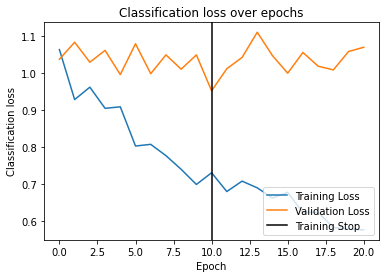

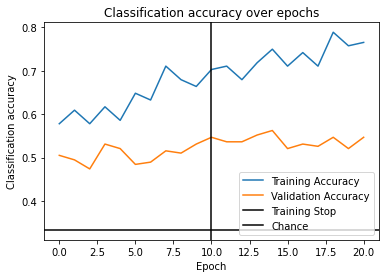

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1010 - acc: 0.5156 - val_loss: 1.1314 - val_acc: 0.5312
Epoch 2/50 0.233s 	 loss: 1.0317 - acc: 0.5391 - val_loss: 1.1156 - val_acc: 0.5521
Epoch 3/50 0.234s 	 loss: 0.9712 - acc: 0.6016 - val_loss: 1.0140 - val_acc: 0.6302
Epoch 4/50 0.237s 	 loss: 0.9603 - acc: 0.6172 - val_loss: 1.0017 - val_acc: 0.5677
Epoch 5/50 0.235s 	 loss: 0.8949 - acc: 0.6250 - val_loss: 0.9390 - val_acc: 0.6562
Epoch 6/50 0.233s 	 loss: 0.8029 - acc: 0.6562 - val_loss: 0.9364 - val_acc: 0.6667
Epoch 7/50 0.233s 	 loss: 0.7843 - acc: 0.7109 - val_loss: 1.0422 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.7454 - acc: 0.7188 - val_loss: 1.0061 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.246s 	 loss: 0.7878 - acc: 0.6875 - val_loss: 0.8908 - val_acc: 0.6354
Epoch 10/50 0.233s 	 loss: 0.7278 - acc: 0.7266 - val_loss: 0.8937 - val_acc: 0.6302
EarlyStopping c

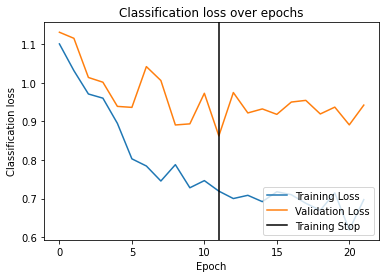

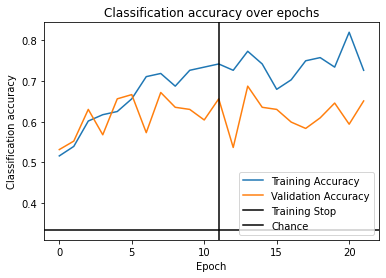

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.2789 - acc: 0.4453 - val_loss: 1.0072 - val_acc: 0.5052
Epoch 2/50 0.234s 	 loss: 1.1098 - acc: 0.5156 - val_loss: 0.8914 - val_acc: 0.6198
Epoch 3/50 0.236s 	 loss: 1.0261 - acc: 0.5703 - val_loss: 0.9532 - val_acc: 0.5260
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.9329 - acc: 0.5469 - val_loss: 0.9291 - val_acc: 0.5938
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.236s 	 loss: 0.8417 - acc: 0.6328 - val_loss: 0.9403 - val_acc: 0.5677
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.243s 	 loss: 0.8525 - acc: 0.6016 - val_loss: 0.9361 - val_acc: 0.6198
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.233s 	 loss: 0.8293 - acc: 0.6562 - val_loss: 0.9163 - val_acc: 0.5833
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.235s 	 loss: 0.7770 - acc: 0.6953 - val_loss: 0.8750 - val_acc: 0.6250
Epoch 9/50 0.240s 	 loss: 0.7581 - acc: 0.7109 - val_loss: 0.9169 - val_acc: 0.

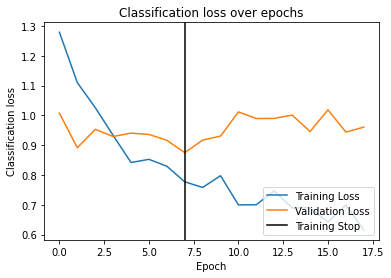

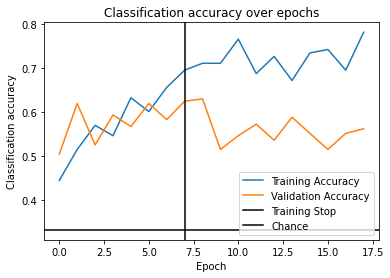

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 1.0892 - acc: 0.4844 - val_loss: 1.1963 - val_acc: 0.4583
Epoch 2/50 0.236s 	 loss: 0.9855 - acc: 0.5391 - val_loss: 1.1943 - val_acc: 0.4688
Epoch 3/50 0.240s 	 loss: 0.9272 - acc: 0.5625 - val_loss: 1.1621 - val_acc: 0.5156
Epoch 4/50 0.235s 	 loss: 0.8727 - acc: 0.6641 - val_loss: 1.1857 - val_acc: 0.4635
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.241s 	 loss: 0.8716 - acc: 0.6328 - val_loss: 1.1059 - val_acc: 0.4896
Epoch 6/50 0.237s 	 loss: 0.8445 - acc: 0.6250 - val_loss: 1.1084 - val_acc: 0.4583
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.242s 	 loss: 0.7512 - acc: 0.6719 - val_loss: 1.0945 - val_acc: 0.4896
Epoch 8/50 0.235s 	 loss: 0.7487 - acc: 0.6797 - val_loss: 1.0563 - val_acc: 0.5104
Epoch 9/50 0.236s 	 loss: 0.7486 - acc: 0.6953 - val_loss: 1.1107 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.7545 - acc: 0.6797 - val_loss: 1.069

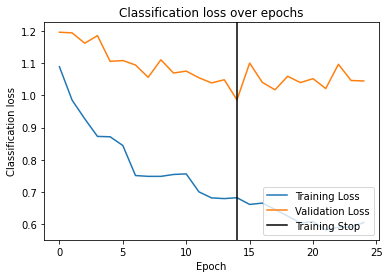

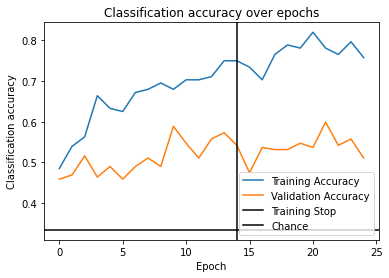

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7095 - acc: 0.6641 - val_loss: 0.7484 - val_acc: 0.6979
Epoch 2/50 0.235s 	 loss: 0.6282 - acc: 0.7266 - val_loss: 0.6973 - val_acc: 0.7396
Epoch 3/50 0.233s 	 loss: 0.5447 - acc: 0.7656 - val_loss: 0.7355 - val_acc: 0.6823
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.4991 - acc: 0.8281 - val_loss: 0.7273 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.243s 	 loss: 0.4924 - acc: 0.8359 - val_loss: 0.7460 - val_acc: 0.7240
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.5090 - acc: 0.7891 - val_loss: 0.6947 - val_acc: 0.7604
Epoch 7/50 0.238s 	 loss: 0.4344 - acc: 0.8516 - val_loss: 0.7388 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.248s 	 loss: 0.4355 - acc: 0.8281 - val_loss: 0.7370 - val_acc: 0.7448
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.236s 	 loss: 0.4466 - acc: 0.8750 - val_loss: 0.6874 - val_acc: 0.

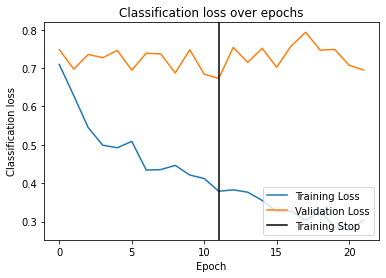

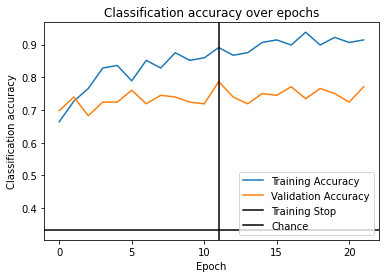

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.6603 - acc: 0.7188 - val_loss: 0.7479 - val_acc: 0.6562
Epoch 2/50 0.247s 	 loss: 0.5716 - acc: 0.7656 - val_loss: 0.7083 - val_acc: 0.7031
Epoch 3/50 0.240s 	 loss: 0.5370 - acc: 0.7812 - val_loss: 0.6735 - val_acc: 0.7083
Epoch 4/50 0.237s 	 loss: 0.5442 - acc: 0.8203 - val_loss: 0.7383 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.241s 	 loss: 0.4915 - acc: 0.8281 - val_loss: 0.6982 - val_acc: 0.7240
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.4785 - acc: 0.8125 - val_loss: 0.6841 - val_acc: 0.7344
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.234s 	 loss: 0.4286 - acc: 0.8359 - val_loss: 0.7369 - val_acc: 0.6875
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.233s 	 loss: 0.4289 - acc: 0.8281 - val_loss: 0.6684 - val_acc: 0.7708
Epoch 9/50 0.242s 	 loss: 0.3764 - acc: 0.8906 - val_loss: 0.7607 - val_acc: 0.7396
EarlyStopping counter: 1 out o

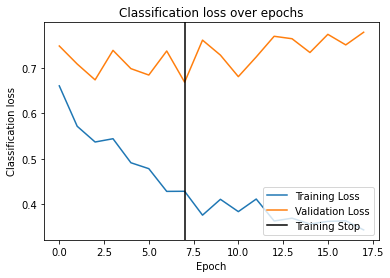

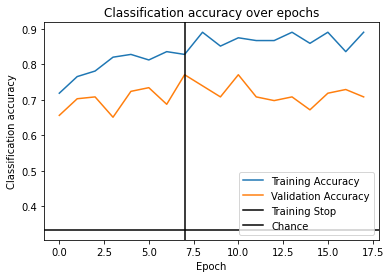

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.7772 - acc: 0.6406 - val_loss: 0.5096 - val_acc: 0.8490
Epoch 2/50 0.248s 	 loss: 0.6961 - acc: 0.7031 - val_loss: 0.5201 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.7152 - acc: 0.7344 - val_loss: 0.4603 - val_acc: 0.8281
Epoch 4/50 0.237s 	 loss: 0.6608 - acc: 0.7500 - val_loss: 0.4471 - val_acc: 0.8385
Epoch 5/50 0.239s 	 loss: 0.6128 - acc: 0.7500 - val_loss: 0.4497 - val_acc: 0.9115
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.6124 - acc: 0.7344 - val_loss: 0.4837 - val_acc: 0.8021
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.5654 - acc: 0.7812 - val_loss: 0.4835 - val_acc: 0.8021
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.238s 	 loss: 0.5558 - acc: 0.7969 - val_loss: 0.4555 - val_acc: 0.8177
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.234s 	 loss: 0.5574 - acc: 0.7812 - val_loss: 0.4362 - val_acc: 0.

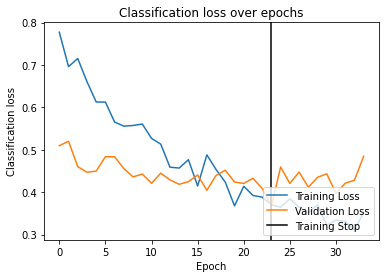

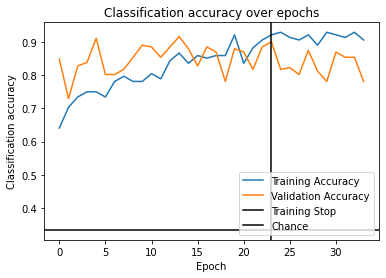

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.1601 - acc: 0.5000 - val_loss: 1.1290 - val_acc: 0.3958
Epoch 2/50 0.232s 	 loss: 0.9867 - acc: 0.5938 - val_loss: 1.0682 - val_acc: 0.4531
Epoch 3/50 0.234s 	 loss: 0.8402 - acc: 0.6250 - val_loss: 1.0468 - val_acc: 0.4479
Epoch 4/50 0.237s 	 loss: 0.7743 - acc: 0.6875 - val_loss: 0.9884 - val_acc: 0.5052
Epoch 5/50 0.235s 	 loss: 0.6952 - acc: 0.7188 - val_loss: 0.9836 - val_acc: 0.5052
Epoch 6/50 0.233s 	 loss: 0.6293 - acc: 0.7500 - val_loss: 0.9940 - val_acc: 0.4844
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.238s 	 loss: 0.5836 - acc: 0.7656 - val_loss: 1.0091 - val_acc: 0.5625
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.240s 	 loss: 0.5454 - acc: 0.7969 - val_loss: 0.9539 - val_acc: 0.4740
Epoch 9/50 0.240s 	 loss: 0.5077 - acc: 0.8438 - val_loss: 1.0037 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.241s 	 loss: 0.5066 - acc: 0.8359 - val_loss: 0.961

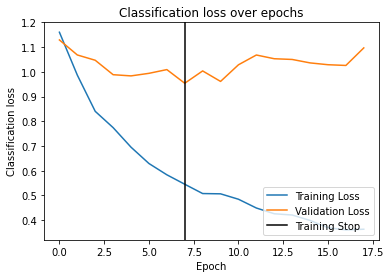

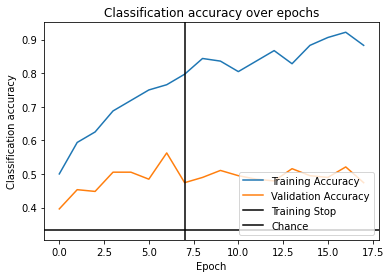

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.2010 - acc: 0.4297 - val_loss: 1.0029 - val_acc: 0.5208
Epoch 2/50 0.238s 	 loss: 1.0307 - acc: 0.5078 - val_loss: 1.0361 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.9085 - acc: 0.6016 - val_loss: 0.9919 - val_acc: 0.5260
Epoch 4/50 0.233s 	 loss: 0.9105 - acc: 0.5703 - val_loss: 0.8822 - val_acc: 0.6250
Epoch 5/50 0.238s 	 loss: 0.8279 - acc: 0.6562 - val_loss: 0.8509 - val_acc: 0.6250
Epoch 6/50 0.233s 	 loss: 0.7523 - acc: 0.6562 - val_loss: 0.8122 - val_acc: 0.6302
Epoch 7/50 0.233s 	 loss: 0.7369 - acc: 0.6484 - val_loss: 0.8389 - val_acc: 0.6615
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.6670 - acc: 0.7422 - val_loss: 0.8185 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.235s 	 loss: 0.6484 - acc: 0.7422 - val_loss: 0.9035 - val_acc: 0.5417
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.235s 	 loss: 0.5

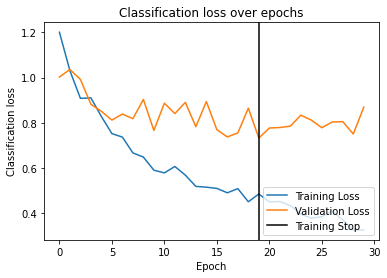

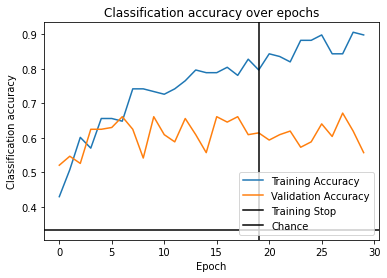

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.0539 - acc: 0.5234 - val_loss: 1.2841 - val_acc: 0.4427
Epoch 2/50 0.235s 	 loss: 0.9579 - acc: 0.5469 - val_loss: 1.1589 - val_acc: 0.5208
Epoch 3/50 0.232s 	 loss: 0.8444 - acc: 0.6562 - val_loss: 1.2059 - val_acc: 0.4323
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.232s 	 loss: 0.8088 - acc: 0.6562 - val_loss: 1.0375 - val_acc: 0.5521
Epoch 5/50 0.235s 	 loss: 0.7522 - acc: 0.6719 - val_loss: 1.1100 - val_acc: 0.4948
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6764 - acc: 0.7578 - val_loss: 1.1143 - val_acc: 0.4844
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.244s 	 loss: 0.6676 - acc: 0.7031 - val_loss: 1.0253 - val_acc: 0.5260
Epoch 8/50 0.249s 	 loss: 0.6269 - acc: 0.7422 - val_loss: 0.9583 - val_acc: 0.5469
Epoch 9/50 0.236s 	 loss: 0.5764 - acc: 0.8125 - val_loss: 1.0524 - val_acc: 0.4531
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.238s 	 loss: 0.5

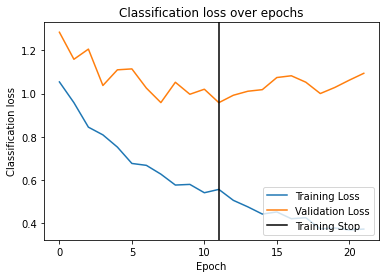

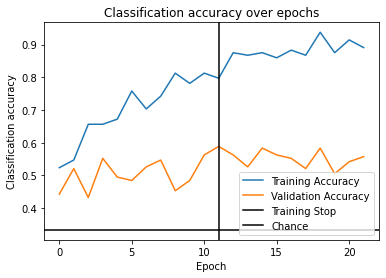

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.5869 - acc: 0.7344 - val_loss: 0.8283 - val_acc: 0.5677
Epoch 2/50 0.234s 	 loss: 0.5535 - acc: 0.7891 - val_loss: 0.7850 - val_acc: 0.5938
Epoch 3/50 0.235s 	 loss: 0.4889 - acc: 0.8281 - val_loss: 0.8113 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.5218 - acc: 0.7969 - val_loss: 0.7080 - val_acc: 0.6719
Epoch 5/50 0.237s 	 loss: 0.4907 - acc: 0.8359 - val_loss: 0.8087 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.4653 - acc: 0.8203 - val_loss: 0.7350 - val_acc: 0.6406
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.4348 - acc: 0.8281 - val_loss: 0.7563 - val_acc: 0.6615
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.240s 	 loss: 0.3875 - acc: 0.8594 - val_loss: 0.6983 - val_acc: 0.6562
Epoch 9/50 0.240s 	 loss: 0.4148 - acc: 0.8438 - val_loss: 0.7703 - val_acc: 0.6250
EarlyStopping counter: 1 out o

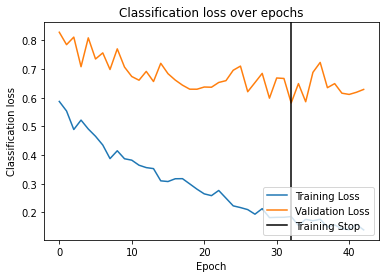

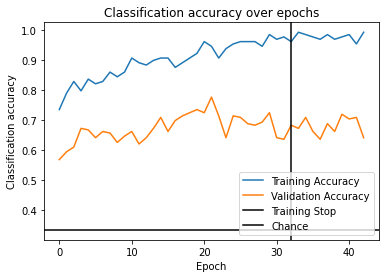

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.6533 - acc: 0.7500 - val_loss: 0.8147 - val_acc: 0.6146
Epoch 2/50 0.234s 	 loss: 0.5271 - acc: 0.7734 - val_loss: 0.8011 - val_acc: 0.6354
Epoch 3/50 0.237s 	 loss: 0.5232 - acc: 0.7734 - val_loss: 0.7951 - val_acc: 0.6562
Epoch 4/50 0.239s 	 loss: 0.5011 - acc: 0.8125 - val_loss: 0.7787 - val_acc: 0.6094
Epoch 5/50 0.236s 	 loss: 0.5002 - acc: 0.8203 - val_loss: 0.7223 - val_acc: 0.6979
Epoch 6/50 0.233s 	 loss: 0.4444 - acc: 0.8750 - val_loss: 0.7403 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.233s 	 loss: 0.4312 - acc: 0.8438 - val_loss: 0.7417 - val_acc: 0.6510
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.4575 - acc: 0.8281 - val_loss: 0.7088 - val_acc: 0.6615
Epoch 9/50 0.245s 	 loss: 0.3790 - acc: 0.8828 - val_loss: 0.7156 - val_acc: 0.6667
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.240s 	 loss: 0.4212 - acc: 0.8516 - val_loss: 0.772

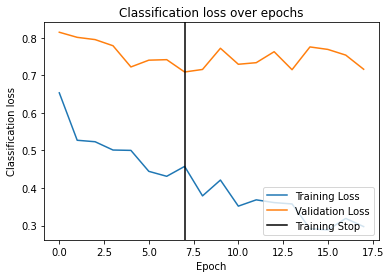

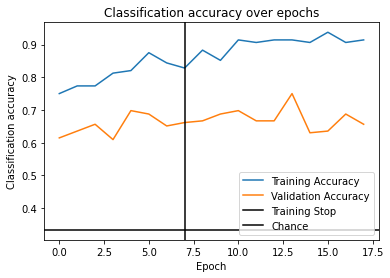

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8122 - acc: 0.6406 - val_loss: 0.3715 - val_acc: 0.9115
Epoch 2/50 0.232s 	 loss: 0.7143 - acc: 0.6562 - val_loss: 0.4166 - val_acc: 0.8854
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.241s 	 loss: 0.6849 - acc: 0.6953 - val_loss: 0.3978 - val_acc: 0.8958
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.236s 	 loss: 0.6380 - acc: 0.7266 - val_loss: 0.4299 - val_acc: 0.8646
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.237s 	 loss: 0.5668 - acc: 0.7656 - val_loss: 0.4572 - val_acc: 0.8281
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.256s 	 loss: 0.5407 - acc: 0.7812 - val_loss: 0.4783 - val_acc: 0.8177
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.237s 	 loss: 0.4987 - acc: 0.7891 - val_loss: 0.4559 - val_acc: 0.8229
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.242s 	 loss: 0.4969 - acc: 0.8125 - val_loss: 0.4396 - val_acc: 0.9062
EarlyStopping counter: 7 out of 10
Epoch 9/5

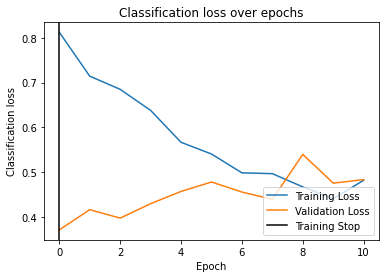

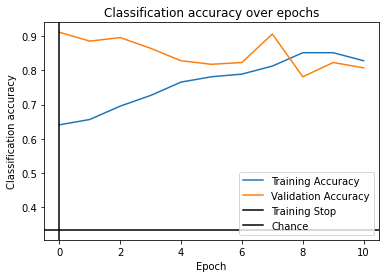

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.238s 	 loss: 0.9299 - acc: 0.6406 - val_loss: 0.6610 - val_acc: 0.7344
Epoch 2/50 0.245s 	 loss: 0.8675 - acc: 0.6641 - val_loss: 0.7218 - val_acc: 0.6719
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.8002 - acc: 0.6797 - val_loss: 0.6569 - val_acc: 0.7552
Epoch 4/50 0.234s 	 loss: 0.7564 - acc: 0.6953 - val_loss: 0.7098 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7572 - acc: 0.7266 - val_loss: 0.7201 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.240s 	 loss: 0.7320 - acc: 0.7031 - val_loss: 0.7559 - val_acc: 0.7135
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.237s 	 loss: 0.7190 - acc: 0.7188 - val_loss: 0.7314 - val_acc: 0.6667
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.237s 	 loss: 0.6830 - acc: 0.7344 - val_loss: 0.7245 - val_acc: 0.6354
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.238s 	 loss: 0.6557 - acc: 0.75

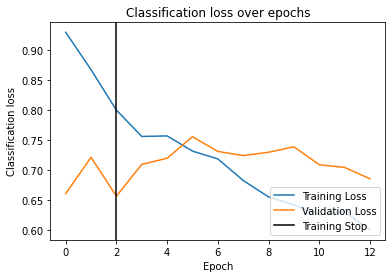

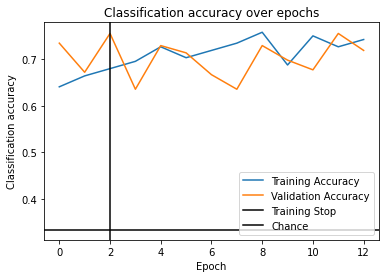

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.8838 - acc: 0.6562 - val_loss: 0.7367 - val_acc: 0.6719
Epoch 2/50 0.238s 	 loss: 0.8421 - acc: 0.6562 - val_loss: 0.8286 - val_acc: 0.6875
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.233s 	 loss: 0.7754 - acc: 0.6250 - val_loss: 0.7542 - val_acc: 0.7448
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.235s 	 loss: 0.7298 - acc: 0.7266 - val_loss: 0.7884 - val_acc: 0.6510
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.238s 	 loss: 0.7131 - acc: 0.7344 - val_loss: 0.7639 - val_acc: 0.6823
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.238s 	 loss: 0.7100 - acc: 0.7344 - val_loss: 0.7633 - val_acc: 0.6719
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.246s 	 loss: 0.6552 - acc: 0.7188 - val_loss: 0.8197 - val_acc: 0.6094
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.236s 	 loss: 0.6274 - acc: 0.7109 - val_loss: 0.7656 - val_acc: 0.6458
EarlyStopping counter: 7 out of 10
Epoch 9/5

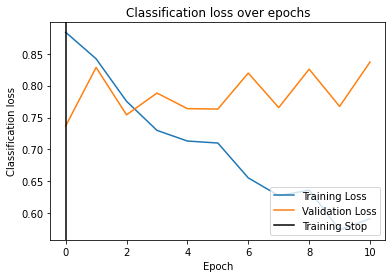

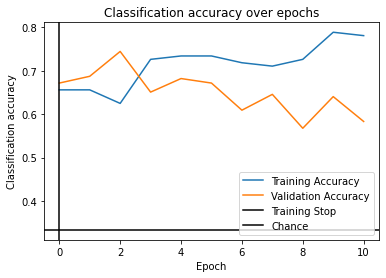

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.7514 - acc: 0.6875 - val_loss: 1.0796 - val_acc: 0.5365
Epoch 2/50 0.232s 	 loss: 0.6815 - acc: 0.7266 - val_loss: 1.0637 - val_acc: 0.5312
Epoch 3/50 0.255s 	 loss: 0.6014 - acc: 0.7578 - val_loss: 1.1134 - val_acc: 0.5729
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.238s 	 loss: 0.5735 - acc: 0.7500 - val_loss: 1.0717 - val_acc: 0.5417
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.237s 	 loss: 0.5489 - acc: 0.7891 - val_loss: 1.0874 - val_acc: 0.4844
EarlyStopping counter: 3 out of 10
Epoch 6/50 0.236s 	 loss: 0.5421 - acc: 0.7500 - val_loss: 1.0640 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 7/50 0.238s 	 loss: 0.5217 - acc: 0.8359 - val_loss: 1.1274 - val_acc: 0.5260
EarlyStopping counter: 5 out of 10
Epoch 8/50 0.239s 	 loss: 0.4471 - acc: 0.8359 - val_loss: 1.1072 - val_acc: 0.5729
EarlyStopping counter: 6 out of 10
Epoch 9/50 0.241s 	 loss: 0.4834 - acc: 0.82

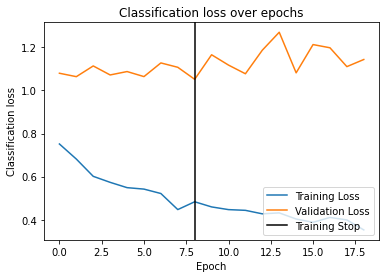

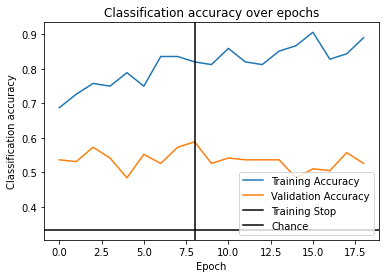

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.241s 	 loss: 1.0160 - acc: 0.5391 - val_loss: 0.7887 - val_acc: 0.6615
Epoch 2/50 0.239s 	 loss: 0.9516 - acc: 0.5625 - val_loss: 0.8342 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8728 - acc: 0.6172 - val_loss: 0.7972 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.243s 	 loss: 0.8197 - acc: 0.7031 - val_loss: 0.7891 - val_acc: 0.6510
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.8115 - acc: 0.6484 - val_loss: 0.8167 - val_acc: 0.6406
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.241s 	 loss: 0.8028 - acc: 0.6641 - val_loss: 0.8518 - val_acc: 0.6094
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.239s 	 loss: 0.7957 - acc: 0.6562 - val_loss: 0.8364 - val_acc: 0.6510
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.236s 	 loss: 0.7395 - acc: 0.7422 - val_loss: 0.7851 - val_acc: 0.6042
Epoch 9/50 0.245s 	 loss: 0.7771 - acc: 0.68

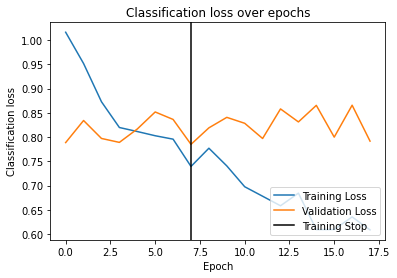

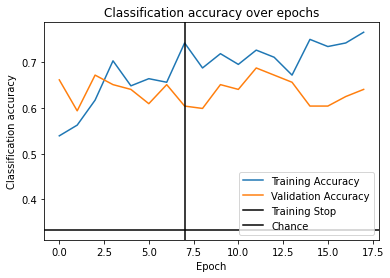

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.9856 - acc: 0.5312 - val_loss: 0.8641 - val_acc: 0.6094
Epoch 2/50 0.235s 	 loss: 0.9407 - acc: 0.6016 - val_loss: 0.9001 - val_acc: 0.6094
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.8909 - acc: 0.6016 - val_loss: 0.8793 - val_acc: 0.5885
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.237s 	 loss: 0.8116 - acc: 0.6719 - val_loss: 0.9813 - val_acc: 0.6146
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.243s 	 loss: 0.8309 - acc: 0.6562 - val_loss: 0.8412 - val_acc: 0.5990
Epoch 6/50 0.235s 	 loss: 0.7494 - acc: 0.6562 - val_loss: 0.9354 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.244s 	 loss: 0.7599 - acc: 0.6797 - val_loss: 0.8778 - val_acc: 0.6042
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.245s 	 loss: 0.7865 - acc: 0.6719 - val_loss: 0.9844 - val_acc: 0.5469
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.243s 	 loss: 0.7540 - acc: 0.66

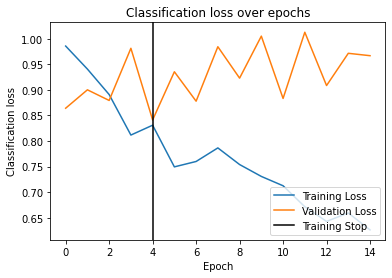

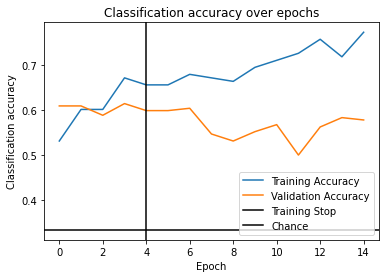

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.8119 - acc: 0.6328 - val_loss: 1.1310 - val_acc: 0.5052
Epoch 2/50 0.235s 	 loss: 0.7611 - acc: 0.6875 - val_loss: 1.1405 - val_acc: 0.4896
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.235s 	 loss: 0.7412 - acc: 0.7031 - val_loss: 1.1993 - val_acc: 0.4583
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.242s 	 loss: 0.7217 - acc: 0.6797 - val_loss: 1.1771 - val_acc: 0.4115
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.236s 	 loss: 0.6938 - acc: 0.7266 - val_loss: 1.2002 - val_acc: 0.4792
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.235s 	 loss: 0.6245 - acc: 0.7344 - val_loss: 1.2239 - val_acc: 0.4792
EarlyStopping counter: 5 out of 10
Epoch 7/50 0.235s 	 loss: 0.6287 - acc: 0.7109 - val_loss: 1.3045 - val_acc: 0.4219
EarlyStopping counter: 6 out of 10
Epoch 8/50 0.236s 	 loss: 0.6079 - acc: 0.7500 - val_loss: 1.2070 - val_acc: 0.4792
EarlyStopping counter: 7 out of 10
Epoch 9/5

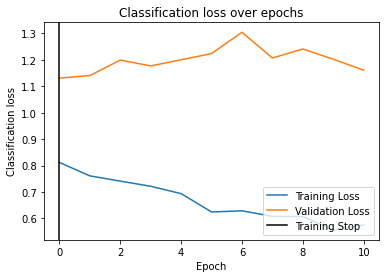

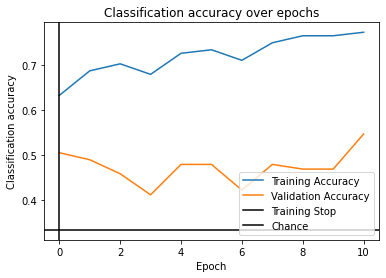

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.240s 	 loss: 0.9639 - acc: 0.5781 - val_loss: 0.6216 - val_acc: 0.7240
Epoch 2/50 0.235s 	 loss: 0.8152 - acc: 0.6094 - val_loss: 0.6102 - val_acc: 0.7083
Epoch 3/50 0.234s 	 loss: 0.7996 - acc: 0.6016 - val_loss: 0.5533 - val_acc: 0.7604
Epoch 4/50 0.235s 	 loss: 0.7012 - acc: 0.6797 - val_loss: 0.6250 - val_acc: 0.7240
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.6781 - acc: 0.6875 - val_loss: 0.5859 - val_acc: 0.7396
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.235s 	 loss: 0.6276 - acc: 0.7109 - val_loss: 0.5308 - val_acc: 0.7917
Epoch 7/50 0.235s 	 loss: 0.5941 - acc: 0.7578 - val_loss: 0.5712 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.6296 - acc: 0.7266 - val_loss: 0.5676 - val_acc: 0.7292
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.251s 	 loss: 0.5698 - acc: 0.7578 - val_loss: 0.5449 - val_acc: 0.7500
EarlyStopping counter: 3 out o

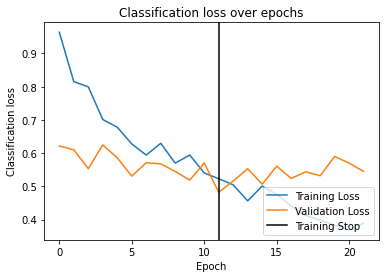

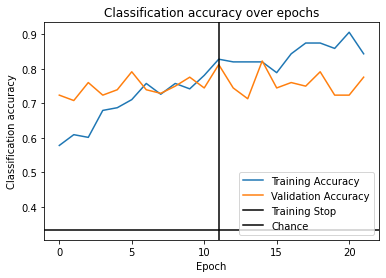

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8421 - acc: 0.6172 - val_loss: 0.7983 - val_acc: 0.6094
Epoch 2/50 0.242s 	 loss: 0.7227 - acc: 0.6797 - val_loss: 0.7771 - val_acc: 0.5885
Epoch 3/50 0.247s 	 loss: 0.6975 - acc: 0.6875 - val_loss: 0.6712 - val_acc: 0.6979
Epoch 4/50 0.235s 	 loss: 0.6410 - acc: 0.7344 - val_loss: 0.7691 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.235s 	 loss: 0.5957 - acc: 0.7578 - val_loss: 0.6499 - val_acc: 0.7188
Epoch 6/50 0.235s 	 loss: 0.5570 - acc: 0.7578 - val_loss: 0.7392 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.237s 	 loss: 0.5849 - acc: 0.7344 - val_loss: 0.7365 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.237s 	 loss: 0.5268 - acc: 0.7656 - val_loss: 0.7174 - val_acc: 0.6875
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.239s 	 loss: 0.5594 - acc: 0.7578 - val_loss: 0.6766 - val_acc: 0.7500
EarlyStopping counter: 4 out o

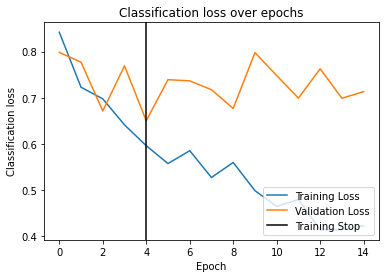

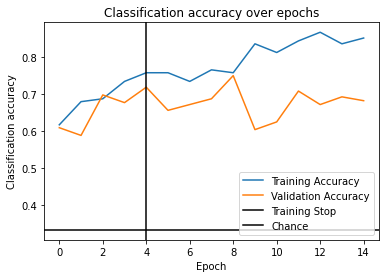

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7650 - acc: 0.6484 - val_loss: 0.9381 - val_acc: 0.5729
Epoch 2/50 0.237s 	 loss: 0.6991 - acc: 0.7188 - val_loss: 0.9412 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.5768 - acc: 0.7656 - val_loss: 0.8740 - val_acc: 0.6146
Epoch 4/50 0.237s 	 loss: 0.5769 - acc: 0.7500 - val_loss: 0.8847 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.5416 - acc: 0.7969 - val_loss: 0.8073 - val_acc: 0.5312
Epoch 6/50 0.246s 	 loss: 0.5118 - acc: 0.7969 - val_loss: 0.8094 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.241s 	 loss: 0.4800 - acc: 0.8672 - val_loss: 0.8204 - val_acc: 0.6302
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.234s 	 loss: 0.4882 - acc: 0.8281 - val_loss: 0.7636 - val_acc: 0.6094
Epoch 9/50 0.234s 	 loss: 0.4873 - acc: 0.7891 - val_loss: 0.7421 - val_acc: 0.6198
Epoch 10/50 0.240s 	 loss: 0.4

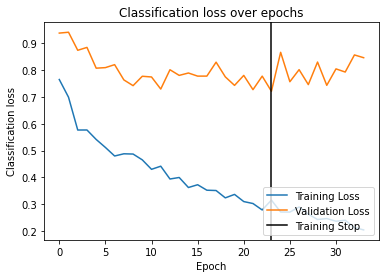

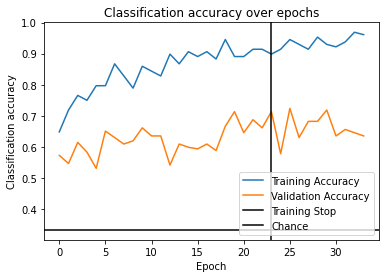

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.261s 	 loss: 0.8034 - acc: 0.5859 - val_loss: 0.7931 - val_acc: 0.6510
Epoch 2/50 0.237s 	 loss: 0.6980 - acc: 0.6953 - val_loss: 0.7873 - val_acc: 0.5885
Epoch 3/50 0.233s 	 loss: 0.7087 - acc: 0.7109 - val_loss: 0.7276 - val_acc: 0.6719
Epoch 4/50 0.235s 	 loss: 0.6537 - acc: 0.7031 - val_loss: 0.7298 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.240s 	 loss: 0.6520 - acc: 0.7188 - val_loss: 0.7680 - val_acc: 0.6458
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.241s 	 loss: 0.5850 - acc: 0.7188 - val_loss: 0.7753 - val_acc: 0.6042
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.236s 	 loss: 0.5565 - acc: 0.7344 - val_loss: 0.7640 - val_acc: 0.6615
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.235s 	 loss: 0.5305 - acc: 0.7812 - val_loss: 0.6736 - val_acc: 0.7083
Epoch 9/50 0.239s 	 loss: 0.5518 - acc: 0.7578 - val_loss: 0.6708 - val_acc: 0.6667
Epoch 10/50 0.235s 	 loss: 0.5291 - acc: 0.8047 - val_loss: 0.6817 - va

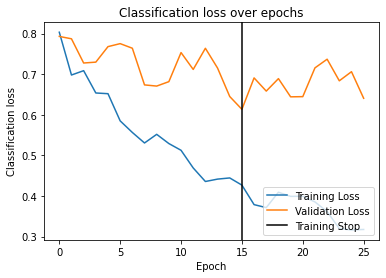

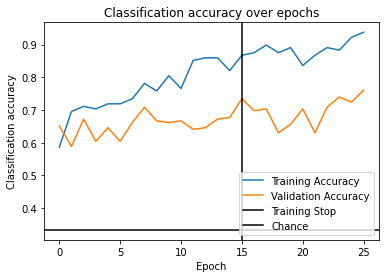

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7667 - acc: 0.6094 - val_loss: 0.6667 - val_acc: 0.7083
Epoch 2/50 0.235s 	 loss: 0.7257 - acc: 0.6484 - val_loss: 0.6947 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.251s 	 loss: 0.6914 - acc: 0.6719 - val_loss: 0.7076 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.239s 	 loss: 0.6838 - acc: 0.6562 - val_loss: 0.6914 - val_acc: 0.6615
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.240s 	 loss: 0.6368 - acc: 0.7109 - val_loss: 0.6939 - val_acc: 0.6458
EarlyStopping counter: 4 out of 10
Epoch 6/50 0.241s 	 loss: 0.6546 - acc: 0.7188 - val_loss: 0.6618 - val_acc: 0.6979
Epoch 7/50 0.236s 	 loss: 0.6208 - acc: 0.7500 - val_loss: 0.6956 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.238s 	 loss: 0.6066 - acc: 0.7344 - val_loss: 0.6308 - val_acc: 0.7188
Epoch 9/50 0.233s 	 loss: 0.5645 - acc: 0.7891 - val_loss: 0.7068 - val_acc: 0.

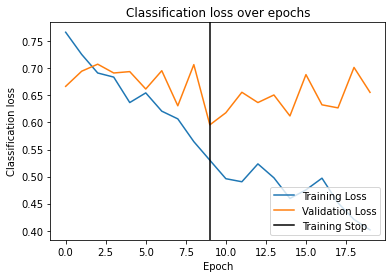

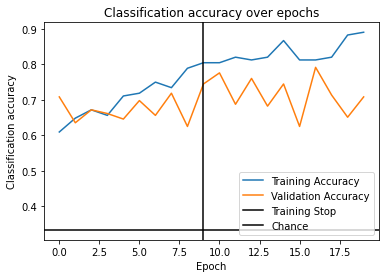

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.7278 - acc: 0.6406 - val_loss: 0.8265 - val_acc: 0.5990
Epoch 2/50 0.236s 	 loss: 0.6934 - acc: 0.6484 - val_loss: 0.8190 - val_acc: 0.5469
Epoch 3/50 0.236s 	 loss: 0.6589 - acc: 0.7188 - val_loss: 0.8317 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.237s 	 loss: 0.6306 - acc: 0.7266 - val_loss: 0.7733 - val_acc: 0.5885
Epoch 5/50 0.236s 	 loss: 0.5878 - acc: 0.7344 - val_loss: 0.8586 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.240s 	 loss: 0.5586 - acc: 0.7656 - val_loss: 0.7399 - val_acc: 0.5677
Epoch 7/50 0.237s 	 loss: 0.5505 - acc: 0.7578 - val_loss: 0.8373 - val_acc: 0.6146
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.246s 	 loss: 0.5571 - acc: 0.7656 - val_loss: 0.7925 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.249s 	 loss: 0.4831 - acc: 0.7969 - val_loss: 0.8173 - val_acc: 0.6354
EarlyStopping counter: 3 out o

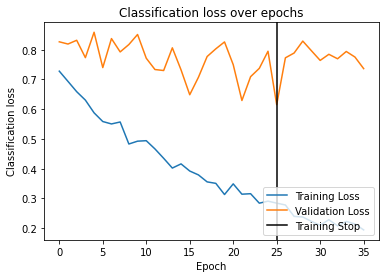

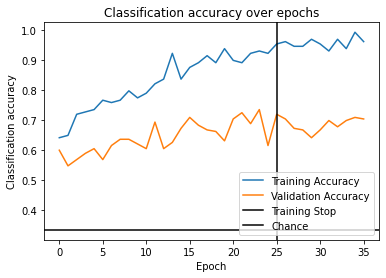

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.6214 - acc: 0.7656 - val_loss: 0.6004 - val_acc: 0.7917
Epoch 2/50 0.234s 	 loss: 0.5496 - acc: 0.7891 - val_loss: 0.5875 - val_acc: 0.7760
Epoch 3/50 0.236s 	 loss: 0.4818 - acc: 0.8125 - val_loss: 0.5638 - val_acc: 0.7760
Epoch 4/50 0.239s 	 loss: 0.3959 - acc: 0.8672 - val_loss: 0.4874 - val_acc: 0.8073
Epoch 5/50 0.234s 	 loss: 0.3550 - acc: 0.8516 - val_loss: 0.5021 - val_acc: 0.8229
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.3310 - acc: 0.9297 - val_loss: 0.5174 - val_acc: 0.7604
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.237s 	 loss: 0.2985 - acc: 0.9062 - val_loss: 0.5160 - val_acc: 0.7448
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.2767 - acc: 0.8984 - val_loss: 0.4661 - val_acc: 0.8281
Epoch 9/50 0.235s 	 loss: 0.2644 - acc: 0.9219 - val_loss: 0.4500 - val_acc: 0.8229
Epoch 10/50 0.248s 	 loss: 0.2422 - acc: 0.9453 - val_loss: 0.4527 - val_acc: 0.8281
EarlyStopping counter

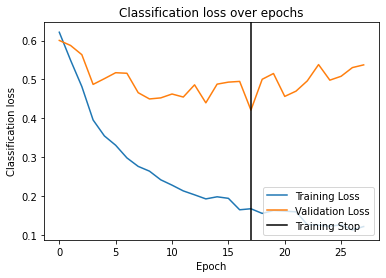

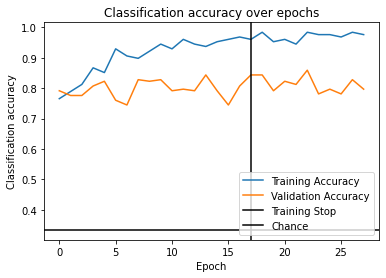

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 0.6287 - acc: 0.7500 - val_loss: 0.5729 - val_acc: 0.7969
Epoch 2/50 0.238s 	 loss: 0.5418 - acc: 0.8125 - val_loss: 0.4993 - val_acc: 0.8385
Epoch 3/50 0.234s 	 loss: 0.5217 - acc: 0.8047 - val_loss: 0.4560 - val_acc: 0.8385
Epoch 4/50 0.237s 	 loss: 0.4362 - acc: 0.8438 - val_loss: 0.4413 - val_acc: 0.8542
Epoch 5/50 0.239s 	 loss: 0.4385 - acc: 0.8281 - val_loss: 0.4433 - val_acc: 0.8229
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.239s 	 loss: 0.3739 - acc: 0.8438 - val_loss: 0.3970 - val_acc: 0.8594
Epoch 7/50 0.248s 	 loss: 0.3559 - acc: 0.8750 - val_loss: 0.4695 - val_acc: 0.7708
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.235s 	 loss: 0.3298 - acc: 0.8672 - val_loss: 0.4127 - val_acc: 0.7917
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.238s 	 loss: 0.3108 - acc: 0.8984 - val_loss: 0.3846 - val_acc: 0.8385
Epoch 10/50 0.238s 	 loss: 0.3024 - acc: 0.8984 - val_loss: 0.380

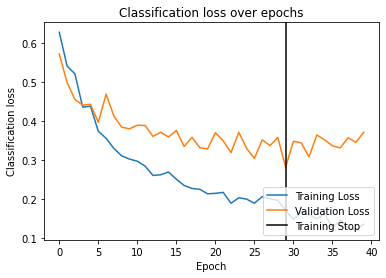

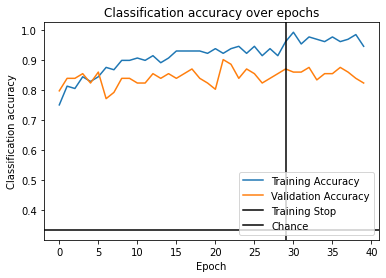

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.6291 - acc: 0.7422 - val_loss: 0.5632 - val_acc: 0.8073
Epoch 2/50 0.235s 	 loss: 0.5272 - acc: 0.7891 - val_loss: 0.5400 - val_acc: 0.8333
Epoch 3/50 0.253s 	 loss: 0.5048 - acc: 0.7891 - val_loss: 0.5191 - val_acc: 0.8490
Epoch 4/50 0.242s 	 loss: 0.4191 - acc: 0.8047 - val_loss: 0.4538 - val_acc: 0.8333
Epoch 5/50 0.233s 	 loss: 0.4137 - acc: 0.8047 - val_loss: 0.4719 - val_acc: 0.8333
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.3872 - acc: 0.8125 - val_loss: 0.4244 - val_acc: 0.8854
Epoch 7/50 0.234s 	 loss: 0.3407 - acc: 0.8906 - val_loss: 0.3756 - val_acc: 0.8542
Epoch 8/50 0.236s 	 loss: 0.3280 - acc: 0.8750 - val_loss: 0.3848 - val_acc: 0.8281
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.3209 - acc: 0.8828 - val_loss: 0.3827 - val_acc: 0.8698
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.236s 	 loss: 0.3054 - acc: 0.8672 - val_loss: 0.362

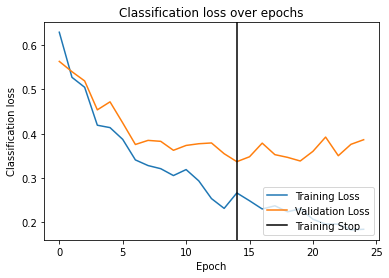

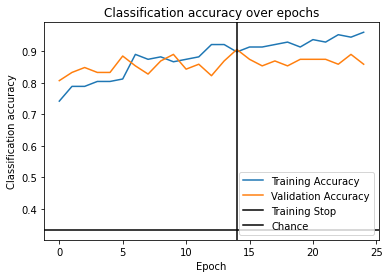

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.243s 	 loss: 0.8272 - acc: 0.6172 - val_loss: 0.6783 - val_acc: 0.7135
Epoch 2/50 0.231s 	 loss: 0.7562 - acc: 0.6953 - val_loss: 0.6074 - val_acc: 0.7135
Epoch 3/50 0.235s 	 loss: 0.7525 - acc: 0.6953 - val_loss: 0.6141 - val_acc: 0.7292
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.6940 - acc: 0.7109 - val_loss: 0.6419 - val_acc: 0.6667
EarlyStopping counter: 2 out of 10
Epoch 5/50 0.238s 	 loss: 0.6773 - acc: 0.7500 - val_loss: 0.5854 - val_acc: 0.7135
Epoch 6/50 0.234s 	 loss: 0.6747 - acc: 0.7344 - val_loss: 0.5813 - val_acc: 0.7500
Epoch 7/50 0.235s 	 loss: 0.5951 - acc: 0.7734 - val_loss: 0.5748 - val_acc: 0.7292
Epoch 8/50 0.240s 	 loss: 0.6219 - acc: 0.7422 - val_loss: 0.6156 - val_acc: 0.7188
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.254s 	 loss: 0.5592 - acc: 0.8047 - val_loss: 0.6360 - val_acc: 0.6979
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.246s 	 loss: 0.5552 - acc: 0.7969 - val_loss: 0.6200 - va

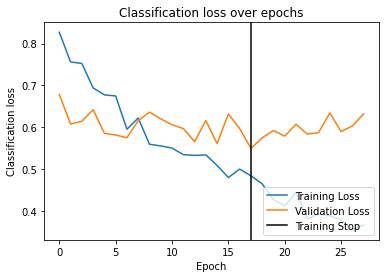

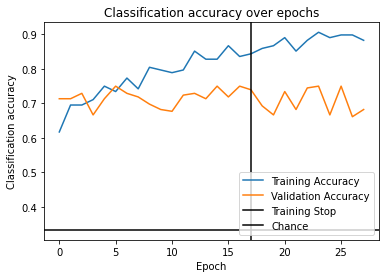

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.237s 	 loss: 0.7660 - acc: 0.6094 - val_loss: 0.8087 - val_acc: 0.6615
Epoch 2/50 0.237s 	 loss: 0.7109 - acc: 0.6641 - val_loss: 0.8135 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.239s 	 loss: 0.6904 - acc: 0.7109 - val_loss: 0.7519 - val_acc: 0.6875
Epoch 4/50 0.238s 	 loss: 0.5923 - acc: 0.7656 - val_loss: 0.7404 - val_acc: 0.7448
Epoch 5/50 0.236s 	 loss: 0.6343 - acc: 0.7188 - val_loss: 0.7341 - val_acc: 0.7083
Epoch 6/50 0.233s 	 loss: 0.5559 - acc: 0.7656 - val_loss: 0.7638 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.5413 - acc: 0.7891 - val_loss: 0.7395 - val_acc: 0.7083
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.237s 	 loss: 0.5261 - acc: 0.7812 - val_loss: 0.7811 - val_acc: 0.6510
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.5033 - acc: 0.8203 - val_loss: 0.7756 - val_acc: 0.6510
EarlyStopping counter: 4 out o

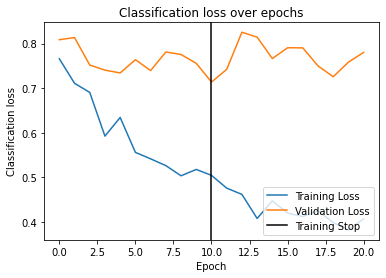

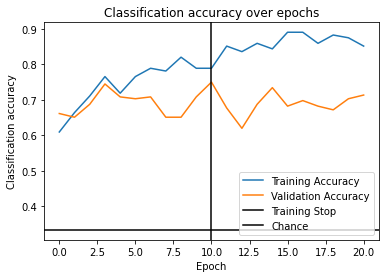

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.253s 	 loss: 0.7361 - acc: 0.6406 - val_loss: 0.8760 - val_acc: 0.6458
Epoch 2/50 0.235s 	 loss: 0.6869 - acc: 0.7500 - val_loss: 0.8412 - val_acc: 0.6406
Epoch 3/50 0.244s 	 loss: 0.6375 - acc: 0.7500 - val_loss: 0.8378 - val_acc: 0.6562
Epoch 4/50 0.236s 	 loss: 0.6373 - acc: 0.7578 - val_loss: 0.8188 - val_acc: 0.5677
Epoch 5/50 0.238s 	 loss: 0.6011 - acc: 0.7656 - val_loss: 0.8450 - val_acc: 0.5938
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6137 - acc: 0.8047 - val_loss: 0.8192 - val_acc: 0.5573
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.241s 	 loss: 0.5892 - acc: 0.7891 - val_loss: 0.7606 - val_acc: 0.6927
Epoch 8/50 0.232s 	 loss: 0.5836 - acc: 0.7578 - val_loss: 0.8054 - val_acc: 0.6042
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.5230 - acc: 0.8203 - val_loss: 0.7495 - val_acc: 0.6927
Epoch 10/50 0.236s 	 loss: 0.5353 - acc: 0.8125 - val_loss: 0.741

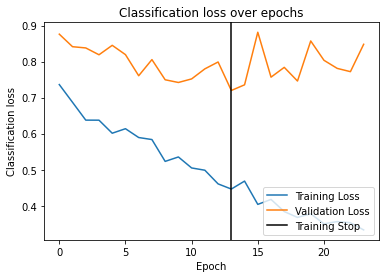

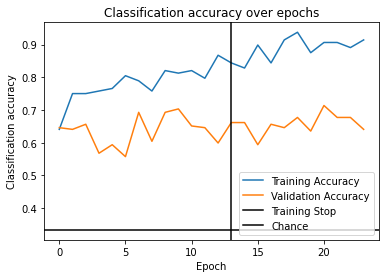

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.236s 	 loss: 1.2542 - acc: 0.4609 - val_loss: 0.9296 - val_acc: 0.5625
Epoch 2/50 0.235s 	 loss: 1.0658 - acc: 0.5703 - val_loss: 0.9321 - val_acc: 0.5677
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.9495 - acc: 0.5938 - val_loss: 0.8977 - val_acc: 0.5417
Epoch 4/50 0.232s 	 loss: 0.8733 - acc: 0.6406 - val_loss: 0.9430 - val_acc: 0.5833
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.246s 	 loss: 0.8211 - acc: 0.6250 - val_loss: 1.0623 - val_acc: 0.5260
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.233s 	 loss: 0.7827 - acc: 0.6562 - val_loss: 0.9583 - val_acc: 0.5938
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.235s 	 loss: 0.7913 - acc: 0.6719 - val_loss: 0.9606 - val_acc: 0.5521
EarlyStopping counter: 4 out of 10
Epoch 8/50 0.238s 	 loss: 0.7730 - acc: 0.6719 - val_loss: 0.9776 - val_acc: 0.5417
EarlyStopping counter: 5 out of 10
Epoch 9/50 0.237s 	 loss: 0.7445 - acc: 0.69

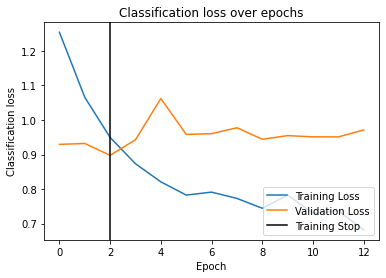

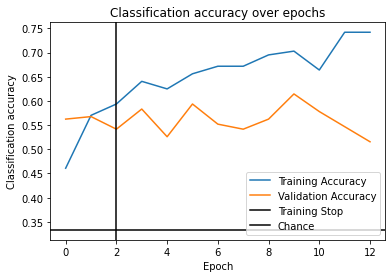

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.246s 	 loss: 0.9606 - acc: 0.5703 - val_loss: 1.7674 - val_acc: 0.3594
Epoch 2/50 0.236s 	 loss: 0.8867 - acc: 0.6172 - val_loss: 1.4062 - val_acc: 0.4010
Epoch 3/50 0.234s 	 loss: 0.7821 - acc: 0.6719 - val_loss: 1.3538 - val_acc: 0.4583
Epoch 4/50 0.236s 	 loss: 0.7267 - acc: 0.6797 - val_loss: 1.2001 - val_acc: 0.4271
Epoch 5/50 0.238s 	 loss: 0.6923 - acc: 0.6953 - val_loss: 1.2633 - val_acc: 0.4062
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.6859 - acc: 0.7344 - val_loss: 1.1592 - val_acc: 0.4688
Epoch 7/50 0.238s 	 loss: 0.6498 - acc: 0.7344 - val_loss: 1.2611 - val_acc: 0.3854
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.234s 	 loss: 0.6023 - acc: 0.7656 - val_loss: 1.2379 - val_acc: 0.3958
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.240s 	 loss: 0.6096 - acc: 0.7500 - val_loss: 1.2112 - val_acc: 0.4583
EarlyStopping counter: 3 out of 10
Epoch 10/50 0.249s 	 loss: 0.5

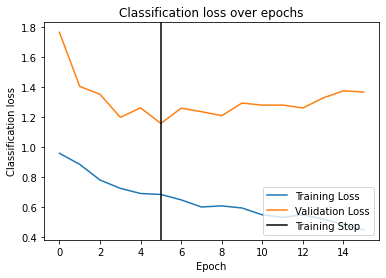

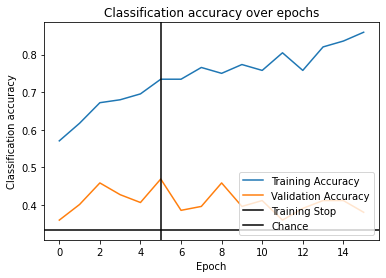

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 1.1735 - acc: 0.4766 - val_loss: 0.9839 - val_acc: 0.5729
Epoch 2/50 0.237s 	 loss: 1.0103 - acc: 0.5703 - val_loss: 0.9345 - val_acc: 0.5729
Epoch 3/50 0.239s 	 loss: 0.9251 - acc: 0.5781 - val_loss: 0.9085 - val_acc: 0.5938
Epoch 4/50 0.235s 	 loss: 0.9134 - acc: 0.6016 - val_loss: 0.9178 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.8129 - acc: 0.6719 - val_loss: 0.8582 - val_acc: 0.6042
Epoch 6/50 0.233s 	 loss: 0.7785 - acc: 0.6562 - val_loss: 0.8244 - val_acc: 0.6042
Epoch 7/50 0.233s 	 loss: 0.7317 - acc: 0.6953 - val_loss: 0.8197 - val_acc: 0.6406
Epoch 8/50 0.235s 	 loss: 0.7097 - acc: 0.6953 - val_loss: 0.8610 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.234s 	 loss: 0.6944 - acc: 0.7188 - val_loss: 0.8310 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.237s 	 loss: 0.7300 - acc: 0.6953 - val_loss: 0.817

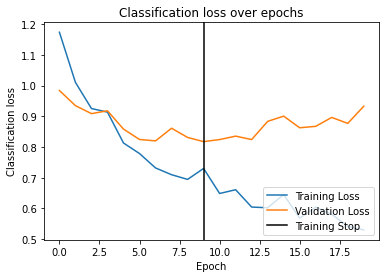

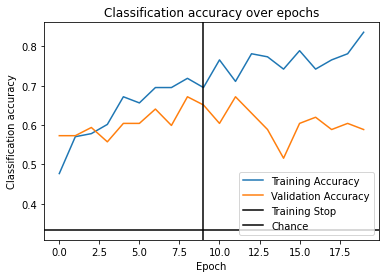

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.8414 - acc: 0.6484 - val_loss: 0.9224 - val_acc: 0.5365
Epoch 2/50 0.248s 	 loss: 0.8036 - acc: 0.6406 - val_loss: 0.9215 - val_acc: 0.5521
Epoch 3/50 0.236s 	 loss: 0.7587 - acc: 0.6016 - val_loss: 0.8126 - val_acc: 0.5625
Epoch 4/50 0.238s 	 loss: 0.7536 - acc: 0.6406 - val_loss: 0.8430 - val_acc: 0.5990
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.239s 	 loss: 0.6913 - acc: 0.7109 - val_loss: 0.8422 - val_acc: 0.6354
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.237s 	 loss: 0.7168 - acc: 0.6797 - val_loss: 0.8439 - val_acc: 0.5365
EarlyStopping counter: 3 out of 10
Epoch 7/50 0.238s 	 loss: 0.6479 - acc: 0.7344 - val_loss: 0.7514 - val_acc: 0.6250
Epoch 8/50 0.232s 	 loss: 0.6407 - acc: 0.6641 - val_loss: 0.8284 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.6473 - acc: 0.7422 - val_loss: 0.8174 - val_acc: 0.6510
EarlyStopping counter: 2 out o

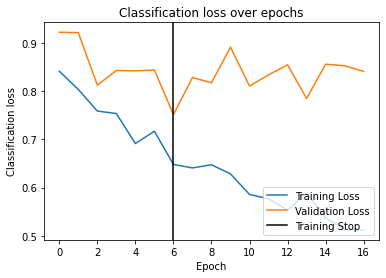

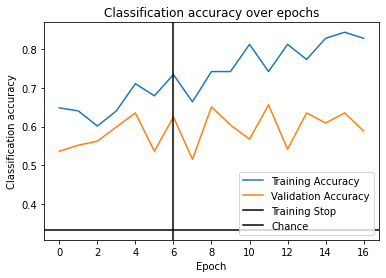

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.232s 	 loss: 0.8714 - acc: 0.5781 - val_loss: 0.8282 - val_acc: 0.6094
Epoch 2/50 0.238s 	 loss: 0.7855 - acc: 0.6172 - val_loss: 0.9477 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.255s 	 loss: 0.7788 - acc: 0.6484 - val_loss: 0.8793 - val_acc: 0.6562
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.245s 	 loss: 0.6863 - acc: 0.6875 - val_loss: 0.9208 - val_acc: 0.5625
EarlyStopping counter: 3 out of 10
Epoch 5/50 0.239s 	 loss: 0.6796 - acc: 0.6719 - val_loss: 0.8109 - val_acc: 0.5781
Epoch 6/50 0.236s 	 loss: 0.6659 - acc: 0.7109 - val_loss: 0.9518 - val_acc: 0.5469
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.235s 	 loss: 0.6764 - acc: 0.6641 - val_loss: 0.8949 - val_acc: 0.5729
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.236s 	 loss: 0.6792 - acc: 0.6953 - val_loss: 0.9105 - val_acc: 0.5573
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.235s 	 loss: 0.5951 - acc: 0.75

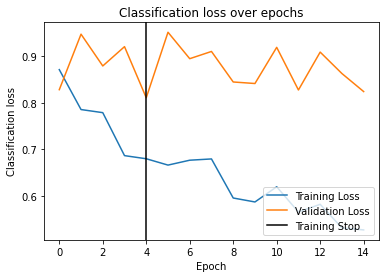

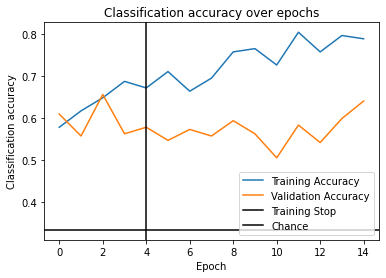

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9544 - acc: 0.5703 - val_loss: 0.7449 - val_acc: 0.6667
Epoch 2/50 0.233s 	 loss: 0.8012 - acc: 0.6406 - val_loss: 0.7917 - val_acc: 0.6250
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.236s 	 loss: 0.7817 - acc: 0.6328 - val_loss: 0.7317 - val_acc: 0.6250
Epoch 4/50 0.237s 	 loss: 0.8267 - acc: 0.6328 - val_loss: 0.7341 - val_acc: 0.6510
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.236s 	 loss: 0.7564 - acc: 0.6250 - val_loss: 0.6975 - val_acc: 0.6667
Epoch 6/50 0.238s 	 loss: 0.6938 - acc: 0.6797 - val_loss: 0.7315 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.263s 	 loss: 0.6501 - acc: 0.7344 - val_loss: 0.7792 - val_acc: 0.6250
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.247s 	 loss: 0.6520 - acc: 0.6719 - val_loss: 0.7432 - val_acc: 0.7083
EarlyStopping counter: 3 out of 10
Epoch 9/50 0.234s 	 loss: 0.7073 - acc: 0.6719 - val_loss: 0.7427 - val_acc: 0.

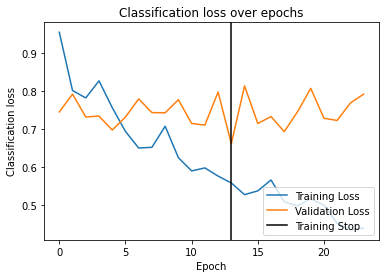

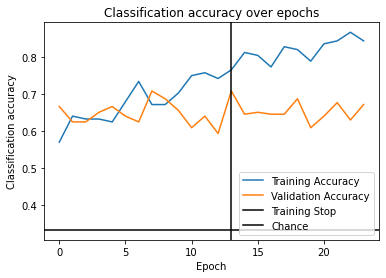

Saving results to .csv file
Loading data


Fetching model
Starting training
Epoch 1/50 0.244s 	 loss: 0.8423 - acc: 0.6797 - val_loss: 0.8999 - val_acc: 0.5469
Epoch 2/50 0.233s 	 loss: 0.7286 - acc: 0.7344 - val_loss: 0.9584 - val_acc: 0.5156
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.7148 - acc: 0.7188 - val_loss: 0.9428 - val_acc: 0.5208
EarlyStopping counter: 2 out of 10
Epoch 4/50 0.238s 	 loss: 0.7172 - acc: 0.6719 - val_loss: 0.8549 - val_acc: 0.5156
Epoch 5/50 0.234s 	 loss: 0.6392 - acc: 0.7500 - val_loss: 0.8866 - val_acc: 0.5312
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.6334 - acc: 0.7422 - val_loss: 0.8104 - val_acc: 0.6458
Epoch 7/50 0.235s 	 loss: 0.6030 - acc: 0.7578 - val_loss: 0.9338 - val_acc: 0.5521
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.251s 	 loss: 0.5125 - acc: 0.8281 - val_loss: 0.9129 - val_acc: 0.5365
EarlyStopping counter: 2 out of 10
Epoch 9/50 0.237s 	 loss: 0.5578 - acc: 0.7812 - val_loss: 0.8681 - val_acc: 0.5677
EarlyStopping counter: 3 out of 10
E

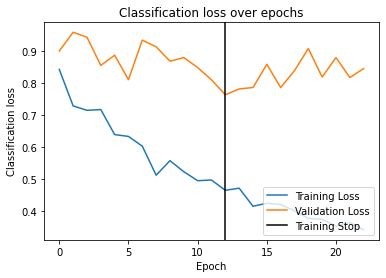

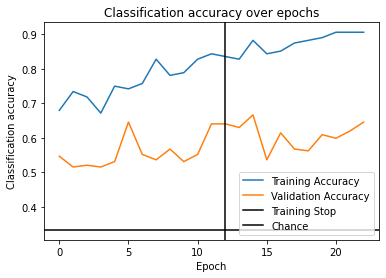

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8665 - acc: 0.6328 - val_loss: 0.9356 - val_acc: 0.5938
Epoch 2/50 0.233s 	 loss: 0.8179 - acc: 0.6406 - val_loss: 0.9208 - val_acc: 0.5625
Epoch 3/50 0.249s 	 loss: 0.7536 - acc: 0.6875 - val_loss: 0.9029 - val_acc: 0.6354
Epoch 4/50 0.239s 	 loss: 0.7198 - acc: 0.6641 - val_loss: 0.8527 - val_acc: 0.6667
Epoch 5/50 0.233s 	 loss: 0.6854 - acc: 0.7188 - val_loss: 0.8474 - val_acc: 0.6042
Epoch 6/50 0.232s 	 loss: 0.6082 - acc: 0.7656 - val_loss: 0.8523 - val_acc: 0.5573
EarlyStopping counter: 1 out of 10
Epoch 7/50 0.234s 	 loss: 0.6006 - acc: 0.6875 - val_loss: 0.8552 - val_acc: 0.6615
EarlyStopping counter: 2 out of 10
Epoch 8/50 0.235s 	 loss: 0.5862 - acc: 0.7500 - val_loss: 0.7845 - val_acc: 0.6406
Epoch 9/50 0.237s 	 loss: 0.5534 - acc: 0.7422 - val_loss: 0.8168 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.234s 	 loss: 0.5650 - acc: 0.7578 - val_loss: 0.745

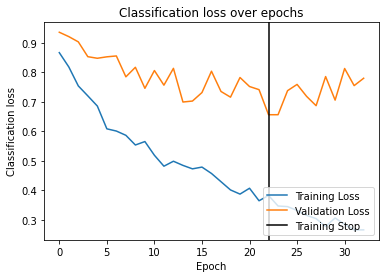

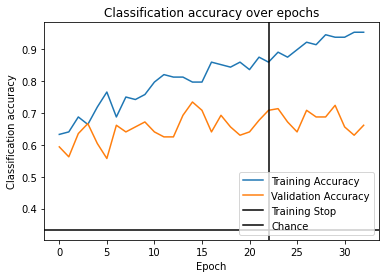

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.9727 - acc: 0.5391 - val_loss: 0.7689 - val_acc: 0.7448
Epoch 2/50 0.240s 	 loss: 0.8463 - acc: 0.6250 - val_loss: 0.7870 - val_acc: 0.6406
EarlyStopping counter: 1 out of 10
Epoch 3/50 0.237s 	 loss: 0.8365 - acc: 0.6016 - val_loss: 0.7413 - val_acc: 0.6719
Epoch 4/50 0.237s 	 loss: 0.7681 - acc: 0.6562 - val_loss: 0.7468 - val_acc: 0.6562
EarlyStopping counter: 1 out of 10
Epoch 5/50 0.254s 	 loss: 0.6912 - acc: 0.7266 - val_loss: 0.7605 - val_acc: 0.7135
EarlyStopping counter: 2 out of 10
Epoch 6/50 0.242s 	 loss: 0.6672 - acc: 0.6719 - val_loss: 0.6985 - val_acc: 0.6719
Epoch 7/50 0.235s 	 loss: 0.6269 - acc: 0.7422 - val_loss: 0.7179 - val_acc: 0.7135
EarlyStopping counter: 1 out of 10
Epoch 8/50 0.239s 	 loss: 0.5997 - acc: 0.7578 - val_loss: 0.6627 - val_acc: 0.7604
Epoch 9/50 0.238s 	 loss: 0.5876 - acc: 0.7578 - val_loss: 0.7553 - val_acc: 0.6615
EarlyStopping counter: 1 out o

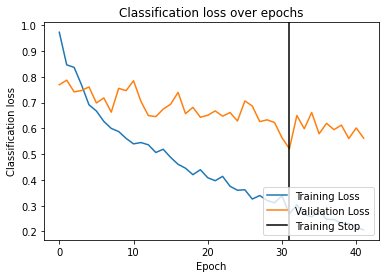

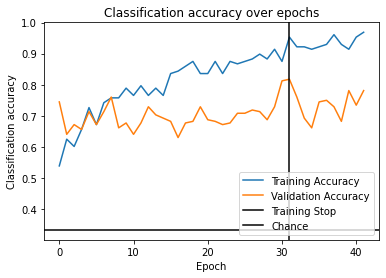

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.8088 - acc: 0.6719 - val_loss: 0.7064 - val_acc: 0.6406
Epoch 2/50 0.232s 	 loss: 0.7286 - acc: 0.6875 - val_loss: 0.6899 - val_acc: 0.6771
Epoch 3/50 0.235s 	 loss: 0.7127 - acc: 0.7188 - val_loss: 0.6700 - val_acc: 0.6615
Epoch 4/50 0.255s 	 loss: 0.6360 - acc: 0.7109 - val_loss: 0.6534 - val_acc: 0.6927
Epoch 5/50 0.232s 	 loss: 0.5973 - acc: 0.7734 - val_loss: 0.6621 - val_acc: 0.6771
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.5884 - acc: 0.7578 - val_loss: 0.6144 - val_acc: 0.7552
Epoch 7/50 0.237s 	 loss: 0.5674 - acc: 0.7578 - val_loss: 0.6139 - val_acc: 0.7552
Epoch 8/50 0.241s 	 loss: 0.5445 - acc: 0.7891 - val_loss: 0.6185 - val_acc: 0.7500
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.237s 	 loss: 0.5110 - acc: 0.8047 - val_loss: 0.6426 - val_acc: 0.7552
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.235s 	 loss: 0.5187 - acc: 0.8203 - val_loss: 0.621

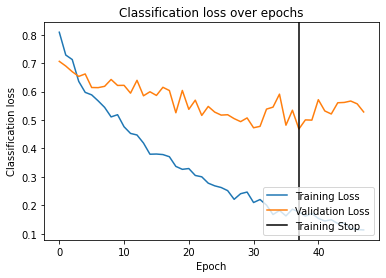

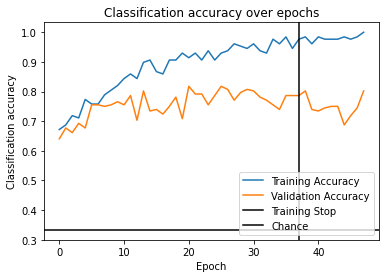

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.233s 	 loss: 0.7580 - acc: 0.6719 - val_loss: 0.9177 - val_acc: 0.5885
Epoch 2/50 0.239s 	 loss: 0.6666 - acc: 0.7109 - val_loss: 0.8321 - val_acc: 0.6302
Epoch 3/50 0.234s 	 loss: 0.6526 - acc: 0.7109 - val_loss: 0.8610 - val_acc: 0.5885
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.240s 	 loss: 0.5943 - acc: 0.7422 - val_loss: 0.7769 - val_acc: 0.6510
Epoch 5/50 0.240s 	 loss: 0.6134 - acc: 0.7656 - val_loss: 0.7958 - val_acc: 0.6354
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.237s 	 loss: 0.5776 - acc: 0.7812 - val_loss: 0.7498 - val_acc: 0.7031
Epoch 7/50 0.235s 	 loss: 0.5434 - acc: 0.8047 - val_loss: 0.7166 - val_acc: 0.7344
Epoch 8/50 0.237s 	 loss: 0.5150 - acc: 0.8125 - val_loss: 0.7516 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 9/50 0.236s 	 loss: 0.5144 - acc: 0.8047 - val_loss: 0.7363 - val_acc: 0.7083
EarlyStopping counter: 2 out of 10
Epoch 10/50 0.238s 	 loss: 0.4

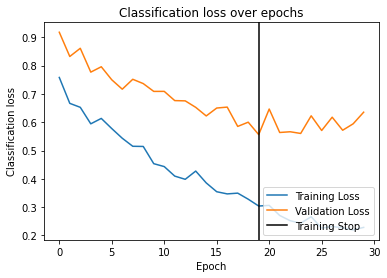

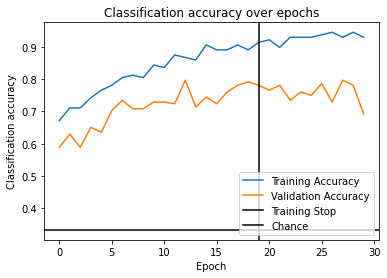

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 0.7496 - acc: 0.6484 - val_loss: 0.7055 - val_acc: 0.7500
Epoch 2/50 0.238s 	 loss: 0.7058 - acc: 0.6797 - val_loss: 0.7015 - val_acc: 0.7552
Epoch 3/50 0.239s 	 loss: 0.6588 - acc: 0.7422 - val_loss: 0.7082 - val_acc: 0.7083
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.252s 	 loss: 0.6166 - acc: 0.7812 - val_loss: 0.6726 - val_acc: 0.7396
Epoch 5/50 0.241s 	 loss: 0.5801 - acc: 0.7500 - val_loss: 0.6728 - val_acc: 0.7031
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.5489 - acc: 0.8203 - val_loss: 0.6922 - val_acc: 0.6719
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.233s 	 loss: 0.5177 - acc: 0.8281 - val_loss: 0.6503 - val_acc: 0.7188
Epoch 8/50 0.234s 	 loss: 0.5160 - acc: 0.8516 - val_loss: 0.5994 - val_acc: 0.7396
Epoch 9/50 0.232s 	 loss: 0.4769 - acc: 0.8438 - val_loss: 0.6119 - val_acc: 0.7656
EarlyStopping counter: 1 out of 10
Epoch 10/50 0.236s 	 loss: 0.4

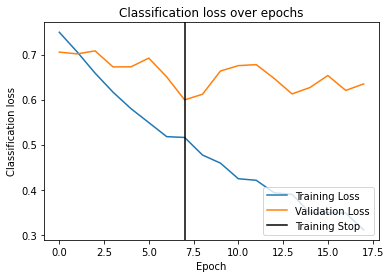

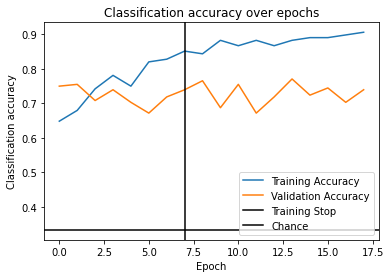

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.234s 	 loss: 0.5810 - acc: 0.7734 - val_loss: 0.6674 - val_acc: 0.7396
Epoch 2/50 0.236s 	 loss: 0.4871 - acc: 0.8359 - val_loss: 0.6552 - val_acc: 0.7604
Epoch 3/50 0.242s 	 loss: 0.4545 - acc: 0.8750 - val_loss: 0.6608 - val_acc: 0.7552
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.239s 	 loss: 0.4158 - acc: 0.8281 - val_loss: 0.6282 - val_acc: 0.7708
Epoch 5/50 0.232s 	 loss: 0.3913 - acc: 0.8984 - val_loss: 0.7045 - val_acc: 0.7396
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.238s 	 loss: 0.3670 - acc: 0.8516 - val_loss: 0.6609 - val_acc: 0.7708
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.3411 - acc: 0.9062 - val_loss: 0.6655 - val_acc: 0.7240
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.236s 	 loss: 0.3350 - acc: 0.9219 - val_loss: 0.7048 - val_acc: 0.7031
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.242s 	 loss: 0.3009 - acc: 0.9297 - val_loss: 0.6941 - val_acc: 0.

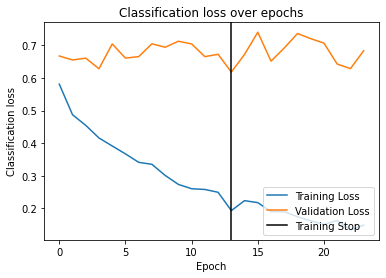

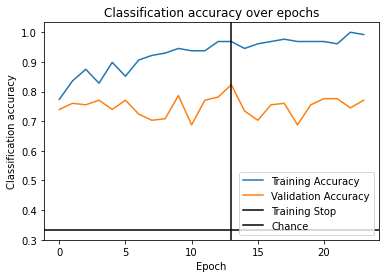

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.250s 	 loss: 0.5840 - acc: 0.7734 - val_loss: 0.5202 - val_acc: 0.8073
Epoch 2/50 0.235s 	 loss: 0.5643 - acc: 0.7891 - val_loss: 0.4950 - val_acc: 0.8385
Epoch 3/50 0.239s 	 loss: 0.5166 - acc: 0.8281 - val_loss: 0.4574 - val_acc: 0.8594
Epoch 4/50 0.235s 	 loss: 0.4728 - acc: 0.8438 - val_loss: 0.3863 - val_acc: 0.8906
Epoch 5/50 0.234s 	 loss: 0.4098 - acc: 0.8828 - val_loss: 0.4486 - val_acc: 0.8438
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.234s 	 loss: 0.4209 - acc: 0.8672 - val_loss: 0.4826 - val_acc: 0.8438
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.236s 	 loss: 0.4346 - acc: 0.8672 - val_loss: 0.4262 - val_acc: 0.8906
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.244s 	 loss: 0.3897 - acc: 0.8984 - val_loss: 0.4141 - val_acc: 0.8750
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.237s 	 loss: 0.3862 - acc: 0.8594 - val_loss: 0.4218 - val_acc: 0.8385
EarlyStopping counter: 5 out o

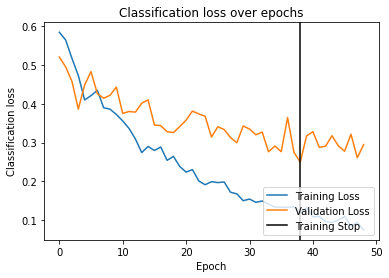

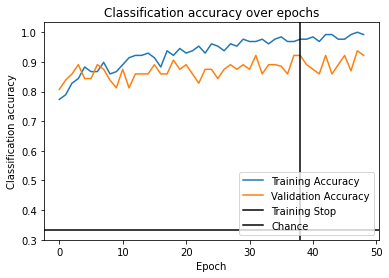

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.242s 	 loss: 0.5550 - acc: 0.7891 - val_loss: 0.5940 - val_acc: 0.8021
Epoch 2/50 0.233s 	 loss: 0.5167 - acc: 0.8359 - val_loss: 0.5634 - val_acc: 0.8177
Epoch 3/50 0.234s 	 loss: 0.4929 - acc: 0.8359 - val_loss: 0.6026 - val_acc: 0.7344
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.234s 	 loss: 0.4564 - acc: 0.8672 - val_loss: 0.5164 - val_acc: 0.8646
Epoch 5/50 0.234s 	 loss: 0.4180 - acc: 0.8672 - val_loss: 0.5719 - val_acc: 0.7604
EarlyStopping counter: 1 out of 10
Epoch 6/50 0.236s 	 loss: 0.4126 - acc: 0.8672 - val_loss: 0.5699 - val_acc: 0.7604
EarlyStopping counter: 2 out of 10
Epoch 7/50 0.240s 	 loss: 0.3994 - acc: 0.8750 - val_loss: 0.5172 - val_acc: 0.8177
EarlyStopping counter: 3 out of 10
Epoch 8/50 0.237s 	 loss: 0.3739 - acc: 0.8750 - val_loss: 0.5506 - val_acc: 0.7656
EarlyStopping counter: 4 out of 10
Epoch 9/50 0.233s 	 loss: 0.3837 - acc: 0.8906 - val_loss: 0.5335 - val_acc: 0.

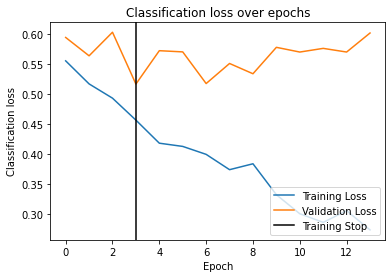

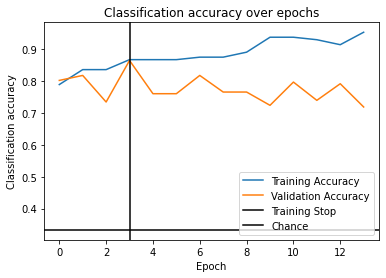

Saving results to .csv file
Loading data
Fetching model
Starting training
Epoch 1/50 0.235s 	 loss: 1.0485 - acc: 0.5547 - val_loss: 1.0484 - val_acc: 0.5000
Epoch 2/50 0.238s 	 loss: 1.0000 - acc: 0.5781 - val_loss: 1.0133 - val_acc: 0.5833
Epoch 3/50 0.240s 	 loss: 1.0208 - acc: 0.5625 - val_loss: 1.0139 - val_acc: 0.4688
EarlyStopping counter: 1 out of 10
Epoch 4/50 0.236s 	 loss: 0.9448 - acc: 0.5781 - val_loss: 0.9777 - val_acc: 0.5573
Epoch 5/50 0.234s 	 loss: 0.9312 - acc: 0.6016 - val_loss: 0.9325 - val_acc: 0.5365
Epoch 6/50 0.238s 	 loss: 0.8575 - acc: 0.6328 - val_loss: 0.9234 - val_acc: 0.5729
Epoch 7/50 0.235s 	 loss: 0.8647 - acc: 0.6484 - val_loss: 0.9143 - val_acc: 0.5885
Epoch 8/50 0.238s 	 loss: 0.8496 - acc: 0.6172 - val_loss: 0.9810 - val_acc: 0.5208
EarlyStopping counter: 1 out of 10


In [ ]:
BATCH_SIZE = 16
N_EPOCHS = 50

run_experiment_2_transfer_learning(
                random_seed=RANDOM_SEED,
                training_epochs=N_EPOCHS,
                use_cuda=USE_CUDA,
                runs=[4, 8, 12],
                batch_size=BATCH_SIZE
                )

In [ ]:
from google.colab import files
files.download('results_experiment_2.csv') 

In [ ]:
BATCH_SIZE = 16
N_EPOCHS = 50
MAX_SUBJECT = 109
RUNS = [4, 8, 12]

run_experiment_3_within(
                random_seed = RANDOM_SEED,
                training_epochs = N_EPOCHS,
                use_cuda = USE_CUDA,
                max_subject = MAX_SUBJECT,
                runs = RUNS,
                batch_size = BATCH_SIZE,
                baseline=False
                )